In [38]:
import datetime
import pandas as pd
import numpy as np
from dateutil import parser 
from matplotlib import pyplot as plt

In [39]:
pd.options.display.max_columns = None

In [40]:
# Here's the column names 
col_raw = """1 CMPLID CHAR(9) NHTSA'S INTERNAL UNIQUE SEQUENCE NUMBER.
2 ODINO CHAR(9) NHTSA'S INTERNAL REFERENCE NUMBER.
3 MFR_NAME CHAR(40) MANUFACTURER'S NAME
4 MAKETXT CHAR(25) VEHICLE/EQUIPMENT MAKE
5 MODELTXT CHAR(256) VEHICLE/EQUIPMENT MODEL
6 YEARTXT CHAR(4) MODEL YEAR, 9999 IF UNKNOWN or N/A
7 CRASH CHAR(1) WAS VEHICLE INVOLVED IN A CRASH, 'Y' OR 'N'
8 FAILDATE CHAR(8) DATE OF INCIDENT (YYYYMMDD)
9 FIRE CHAR(1) WAS VEHICLE INVOLVED IN A FIRE 'Y' OR 'N'
10 INJURED NUMBER(2) NUMBER OF PERSONS INJURED
11 DEATHS NUMBER(2) NUMBER OF FATALITIES
12 COMPDESC CHAR(128) SPECIFIC COMPONENT'S DESCRIPTION
13 CITY CHAR(30) CONSUMER'S CITY
14 STATE CHAR(2) CONSUMER'S STATE CODE
15 VIN CHAR(11) VEHICLE'S VIN#
16 DATEA CHAR(8) DATE ADDED TO FILE (YYYYMMDD)
17 LDATE CHAR(8) DATE COMPLAINT RECEIVED BY NHTSA (YYYYMMDD)
18 MILES NUMBER(7) VEHICLE MILEAGE AT FAILURE
19 OCCURENCES NUMBER(4) NUMBER OF OCCURRENCES
20 CDESCR CHAR(2048) DESCRIPTION OF THE COMPLAINT
21 CMPL_TYPE CHAR(4) SOURCE OF COMPLAINT CODE:
22 POLICE_RPT_YN CHAR(1) WAS INCIDENT REPORTED TO POLICE 'Y' OR 'N'
23 PURCH_DT CHAR(8) DATE PURCHASED (YYYYMMDD)
24 ORIG_OWNER_YN CHAR(1) WAS ORIGINAL OWNER 'Y' OR 'N'
25 ANTI_BRAKES_YN CHAR(1) ANTI-LOCK BRAKES 'Y' OR 'N'
26 CRUISE_CONT_YN CHAR(1) CRUISE CONTROL 'Y' OR 'N'
27 NUM_CYLS NUMBER(2) NUMBER OF CYLINDERS
28 DRIVE_TRAIN CHAR(4) DRIVE TRAIN TYPE [AWD,4WD,FWD,RWD]
29 FUEL_SYS CHAR(4) FUEL SYSTEM CODE:
30 FUEL_TYPE CHAR(4) FUEL TYPE CODE:
31 TRANS_TYPE CHAR(4) VEHICLE TRANSMISSION TYPE [AUTO, MAN]
32 VEH_SPEED NUMBER(3) VEHICLE SPEED
33 DOT CHAR(20) DEPARTMENT OF TRANSPORTATION TIRE IDENTIFIER
34 TIRE_SIZE CHAR(30) TIRE SIZE
35 LOC_OF_TIRE CHAR(4) LOCATION OF TIRE CODE:
36 TIRE_FAIL_TYPE CHAR(4) TYPE OF TIRE FAILURE CODE:
37 ORIG_EQUIP_YN CHAR(1) WAS PART ORIGINAL EQUIPMENT 'Y' OR 'N'
38 MANUF_DT CHAR(8) DATE OF MANUFACTURE (YYYYMMDD)
39 SEAT_TYPE CHAR(4) TYPE OF CHILD SEAT CODE:
40 RESTRAINT_TYPE CHAR(4) INSTALLATION SYSTEM CODE;
41 DEALER_NAME CHAR(40) DEALER'S NAME
42 DEALER_TEL CHAR(20) DEALER'S TELEPHONE NUMBER
43 DEALER_CITY CHAR(30) DEALER'S CITY
44 DEALER_STATE CHAR(2) DEALER'S STATE CODE
45 DEALER_ZIP CHAR(10) DEALER'S ZIPCODE
46 PROD_TYPE CHAR(4) PRODUCT TYPE CODE:
47 REPAIRED_YN CHAR(1) WAS DEFECTIVE TIRE REPAIRED 'Y' OR 'N'
48 MEDICAL_ATTN CHAR(1) WAS MEDICAL ATTENTION REQUIRED 'Y' OR 'N'
49 VEHICLES_TOWED_YN CHAR(1) WAS VEHICLE TOWED 'Y' OR 'N' """
cols = [line.split(' ')[1] for line in col_raw.split('\n')]

In [4]:
df = pd.read_csv('https://static.nhtsa.gov/odi/ffdd/cmpl/FLAT_CMPL.zip', sep='\t' , header=None, names = cols, compression='zip', error_bad_lines=False)  

/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3155: DtypeWarning: Columns (15,16,18,28,31,32,33,34,35,38,39,40,41,42,43,44) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [5]:
df

,CMPLID,ODINO,MFR_NAME,MAKETXT,MODELTXT,YEARTXT,CRASH,FAILDATE,FIRE,INJURED,DEATHS,COMPDESC,CITY,STATE,VIN,DATEA,LDATE,MILES,OCCURENCES,CDESCR,CMPL_TYPE,POLICE_RPT_YN,PURCH_DT,ORIG_OWNER_YN,ANTI_BRAKES_YN,CRUISE_CONT_YN,NUM_CYLS,DRIVE_TRAIN,FUEL_SYS,FUEL_TYPE,TRANS_TYPE,VEH_SPEED,DOT,TIRE_SIZE,LOC_OF_TIRE,TIRE_FAIL_TYPE,ORIG_EQUIP_YN,MANUF_DT,SEAT_TYPE,RESTRAINT_TYPE,DEALER_NAME,DEALER_TEL,DEALER_CITY,DEALER_STATE,DEALER_ZIP,PROD_TYPE,REPAIRED_YN,MEDICAL_ATTN,VEHICLES_TOWED_YN
0,1,958241,"Volvo Car USA, LLC",VOLVO,760,1987.0,N,NaN,N,0,0,ENGINE AND ENGINE COOLING:COOLING SYSTEM:RADIA...,EL CAJON,CA,NaN,19950103,19950103,NaN,NaN,RADIATOR FAILED @ HIGHWAY SPEED OBSTRUCTING DR...,EVOQ,N,NaN,N,N,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,V,N,N,N
1,2,958130,Ford Motor Company,FORD,THUNDERBIRD,1992.0,N,19941222.0,N,0,0,"FUEL SYSTEM, GASOLINE:DELIVERY",CLINTONTOWN,MI,1FAPP6045NH,19950103,19950103,NaN,1.0,"FUEL LEAKED FROM FUEL TANK AREA, EMITTING STRO...",EVOQ,N,NaN,N,N,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,V,N,N,N
2,3,958132,Kia Motors America,KIA,SEPHIA,1994.0,Y,19941230.0,N,0,0,POWER TRAIN:AUTOMATIC TRANSMISSION,SAN FRANCISC,CA,NaN,19950103,19950103,NaN,NaN,SHIFTED INTO REVERSE VEHICLE JERKED VIOLENTLY....,EVOQ,N,NaN,N,N,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,V,N,N,N
3,4,958133,"Chrysler (FCA US, LLC)",DODGE,600,1987.0,N,19941231.0,N,0,0,"FUEL SYSTEM, GASOLINE:STORAGE:TANK ASSEMBLY",MUSKEGON,MI,1B3BE36D4HC,19950103,19950103,NaN,NaN,FUEL TANK ; LEAKS BECAUSE OF RUST GAS LEAK BY ...,EVOQ,N,NaN,N,N,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,V,N,N,N
4,5,958137,"Chrysler (FCA US, LLC)",DODGE,CARAVAN,1991.0,N,19941218.0,N,0,0,SEATS,MESQUITE,TX,2B4GK4535MR,19950103,19950103,NaN,1.0,"DRIVER SIDE SEAT FRAME BROKE IN TWO, CAUSING S...",EVOQ,N,NaN,N,N,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,V,N,N,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1751906,1752818,11437729,"General Motors, LLC",BUICK,LESABRE,2004.0,N,20211021.0,N,0,0,WHEELS,Wilmington,OH,1G4HP52K344,20211021,20211021,NaN,NaN,"Drove to the store, transmission was hard shif...",IVOQ,N,NaN,N,N,N,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,V,N,N,N
1751907,1752819,11437730,Hyundai Motor America,HYUNDAI,SANTA FE,2013.0,N,20211015.0,N,0,0,ENGINE,North Fork,CA,5XYZTDLB7DG,20211021,20211021,NaN,NaN,"October 15, 2021. Driving South on Hwy 99 nea...",IVOQ,N,NaN,N,N,N,NaN,NaN,NaN,NaN,NaN,65.0,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,V,N,N,N
1751908,1752820,11437731,Hyundai Motor America,HYUNDAI,SONATA,2012.0,N,20211001.0,N,0,0,ENGINE,Waukee,IA,5NPEC4AC4CH,20211021,20211021,NaN,NaN,Check engine light blinking and engine acting ...,IVOQ,N,NaN,N,N,N,4.0,FWD,NaN,GS,NaN,30.0,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,V,N,N,N
1751909,1752821,11437732,Toyota Motor Corporation,TOYOTA,TACOMA,2008.0,N,20211021.0,N,0,0,STRUCTURE:BODY,52 Dayton RD.,NJ,5tenx22n88z,20211021,20211021,NaN,NaN,frame is rotting out is there any recall for a...,IVOQ,N,NaN,N,N,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,V,N,N,N


In [72]:
def parse_garbage_datestr(s_):
    s = str(s_)
#     print('s0',s)
    if type(s_) != str: 
        if s_ != s_: 
            return np.nan
    try: 
        s = str(int(float(s))) # no delimiting symbols
#         print('s1',s)
        if len(s) == 8:
            if int(s[:4]) in range(1970,datetime.datetime.now().year+1): 
                if int(s[4:6]) in range(1,13) and int(s[6:]) in range(1,32):
                    return datetime.datetime(int(s[:4]),int(s[4:6]),int(s[6:]))
                elif int(s[4:6]) in range(1,32) and int(s[6:]) in range(1,13):
                    return datetime.datetime(int(s[:4]), int(s[6:]), int(s[4:6]))
                else: 
                    return np.nan
        elif len(s) == 6:
            if int('20'+s[:2]) in range(1970,datetime.datetime.now().year+1):
                if int(s[2:4]) in range(1,13) and int(s[4:]) in range(1,32): 
                    return datetime.datetime(int('20'+s[:2]), int(s[2:4]),int(s[4:]))
                else:
                    return np.nan
            else: 
                return np.nan
        elif (len(s) == 5):
            if int('20'+s[:2]) in range(1970,datetime.datetime.now().year+1):
                if int(s[2:3]) in range(1,13) and int(s[3:]) in range(1,32): 
                    return datetime.datetime(int('20'+s[:2]), int(s[2:3]),int(s[3:]))
                else: 
                    return np.nan
            else: 
                return np.nan
        else: 
            return np.nan
    except: 
        # Try to do it using dateutil.parser. 
        try: 
            return parser.parse(s)
        except: 
            return np.nan

def parse_garbage_datestr_(s): 
    x=parse_garbage_datestr(s)
    if (x!=x): 
        print(s)
    else: 
        print('good',s)

In [74]:
for s in list(df.FAILDATE):
    parse_garbage_datestr_(s)

nan
good 19941222.0
good 19941230.0
good 19941231.0
good 19941218.0
nan
nan
good 19930301.0
good 19930301.0
good 19930301.0
good 19940103.0
good 19941225.0
nan
good 19940101.0
good 19921215.0
good 19941203.0
good 19940324.0
good 19940701.0
good 19950102.0
good 19941222.0
nan
good 19921204.0
good 19941230.0
good 19941230.0
good 19950101.0
good 19941223.0
good 19950101.0
good 19950101.0
good 19941227.0
good 19941223.0
good 19941223.0
good 19941223.0
good 19941222.0
good 19941026.0
good 19941216.0
good 19941119.0
good 19950103.0
good 19941213.0
good 19941111.0
good 19940929.0
good 19940505.0
good 19940505.0
good 19940131.0
good 19940103.0
good 19940112.0
good 19940812.0
good 19950101.0
good 19950101.0
good 19941225.0
good 19940103.0
good 19941223.0
good 19950101.0
good 19941213.0
good 19950102.0
good 19910103.0
good 19941226.0
nan
good 19941231.0
good 19940930.0
good 19940103.0
good 19940102.0
good 19940808.0
good 19940901.0
good 19941221.0
good 19950103.0
good 19950103.0
good 19941223.0


good 19940515.0
good 19950126.0
good 19940116.0
good 19930826.0
good 19950124.0
good 19940724.0
good 19941026.0
good 19950122.0
good 19941202.0
good 19941202.0
nan
good 19941218.0
good 19950119.0
nan
good 19941227.0
good 19940114.0
good 19940114.0
good 19950104.0
nan
good 19950124.0
good 19920701.0
good 19930126.0
good 19941229.0
good 19950120.0
good 19950126.0
good 19941113.0
nan
good 19940905.0
good 19950126.0
good 19941212.0
good 19950122.0
good 19941115.0
good 19941115.0
good 19950122.0
good 19950117.0
good 19950123.0
nan
good 19950126.0
good 19940127.0
good 19940406.0
good 19940527.0
good 19940613.0
nan
good 19950120.0
good 19950126.0
good 19950110.0
good 19940319.0
good 19950126.0
good 19950126.0
good 19940826.0
good 19950101.0
good 19950124.0
nan
good 19950120.0
good 19950126.0
good 19950109.0
good 19950114.0
good 19950117.0
good 19950124.0
good 19950116.0
good 19950126.0
good 19950122.0
good 19950123.0
good 19940627.0
good 19931130.0
good 19940127.0
good 19950123.0
good 1993123

good 19950207.0
good 19950211.0
good 19950211.0
good 19940406.0
good 19950204.0
good 19940908.0
nan
good 19950101.0
good 19950212.0
good 19950210.0
nan
good 19950104.0
nan
nan
good 19941001.0
good 19950101.0
good 19940101.0
good 19940802.0
good 19940203.0
good 19940130.0
good 19890612.0
good 19950123.0
good 19950123.0
good 19940901.0
nan
good 19941013.0
good 19950213.0
good 19940119.0
good 19940101.0
nan
good 19950120.0
good 19950206.0
good 19950213.0
nan
good 19930607.0
good 19941123.0
good 19950213.0
good 19950213.0
good 19950213.0
good 19950213.0
good 19930812.0
good 19941209.0
good 19950213.0
good 19930812.0
good 19950201.0
good 19950201.0
good 19941207.0
good 19941020.0
good 19941114.0
good 19940620.0
good 19941127.0
good 19950123.0
good 19941213.0
good 19950123.0
good 19950126.0
good 19950208.0
nan
good 19950213.0
good 19950205.0
nan
good 19950131.0
nan
nan
good 19950126.0
nan
good 19940530.0
nan
nan
nan
good 19940731.0
good 19950121.0
good 19940922.0
good 19950213.0
good 1995021

good 19950101.0
good 19950222.0
good 19950225.0
good 19950222.0
nan
good 19950109.0
good 19940818.0
good 19950227.0
good 19940808.0
good 19950225.0
good 19940327.0
good 19950227.0
good 19940301.0
good 19940101.0
nan
good 19950227.0
good 19940224.0
good 19941007.0
good 19941127.0
good 19950207.0
nan
good 19950214.0
good 19950227.0
good 19950227.0
good 19950225.0
good 19950225.0
good 19950225.0
nan
nan
good 19941108.0
good 19950225.0
good 19950225.0
good 19950227.0
nan
good 19940314.0
good 19950204.0
good 19950222.0
good 19940227.0
good 19931102.0
nan
nan
nan
good 19950207.0
nan
good 19950227.0
good 19950217.0
good 19950226.0
good 19950227.0
good 19930706.0
good 19941101.0
good 19931225.0
good 19941015.0
good 19940803.0
good 19940328.0
good 19940901.0
good 19950227.0
good 19950227.0
good 19940623.0
good 19931225.0
good 19941107.0
nan
good 19940101.0
good 19941212.0
good 19910515.0
good 19880701.0
good 19880701.0
good 19880701.0
good 19880701.0
good 19880701.0
good 19880701.0
good 1993111

good 19940601.0
good 19950115.0
good 19940910.0
good 19950103.0
good 19931101.0
good 19940515.0
good 19950306.0
good 19941001.0
good 19950302.0
good 19950130.0
good 19950306.0
good 19950305.0
good 19940612.0
good 19950309.0
good 19941123.0
good 19950113.0
good 19950308.0
good 19950309.0
good 19950307.0
good 19940228.0
good 19880401.0
good 19950301.0
good 19950309.0
good 19930601.0
good 19930601.0
good 19940901.0
good 19950301.0
nan
good 19950303.0
good 19950207.0
good 19920416.0
good 19950302.0
good 19940101.0
good 19950310.0
good 19941201.0
good 19950301.0
good 19950307.0
good 19950307.0
good 19950310.0
good 19950310.0
good 19950310.0
good 19950309.0
good 19941109.0
good 19950307.0
good 19940830.0
good 19941208.0
good 19940212.0
good 19940710.0
good 19940901.0
good 19950308.0
good 19930819.0
good 19930819.0
good 19950303.0
good 19930110.0
good 19950210.0
nan
good 19930601.0
good 19941208.0
good 19930304.0
good 19950101.0
good 19950310.0
good 19940310.0
good 19950224.0
good 19920601.0


good 19950110.0
good 19941221.0
good 19950117.0
good 19950128.0
good 19950128.0
good 19950205.0
good 19940706.0
good 19940706.0
good 19940706.0
good 19940706.0
good 19940706.0
good 19950201.0
good 19941201.0
good 19940601.0
good 19950208.0
good 19940419.0
good 19940610.0
good 19950210.0
good 19950210.0
good 19950210.0
good 19941118.0
good 19950103.0
good 19950125.0
good 19950131.0
good 19950121.0
good 19950121.0
good 19941201.0
good 19941001.0
good 19950210.0
good 19941116.0
good 19950205.0
good 19941125.0
good 19930701.0
good 19950104.0
good 19950207.0
good 19941119.0
good 19941119.0
good 19950121.0
good 19930201.0
good 19941205.0
good 19950203.0
good 19950120.0
good 19940329.0
good 19930930.0
good 19950201.0
good 19920731.0
good 19930930.0
good 19941002.0
good 19920501.0
good 19941122.0
good 19941122.0
good 19941201.0
good 19950101.0
good 19941109.0
good 19950111.0
good 19940118.0
good 19940118.0
good 19940118.0
good 19941210.0
good 19950102.0
good 19950102.0
good 19950102.0
good 199

good 19950410.0
good 19950408.0
good 19911226.0
good 19900304.0
good 19900304.0
good 19940207.0
nan
good 19941001.0
good 19950401.0
good 19950122.0
good 19950410.0
good 19950401.0
good 19950330.0
good 19950331.0
good 19950330.0
good 19940601.0
good 19901004.0
good 19950303.0
good 19950303.0
good 19950408.0
good 19941118.0
good 19950407.0
good 19950112.0
good 19950410.0
good 19950406.0
good 19950406.0
good 19941001.0
good 19920410.0
good 19940410.0
good 19940717.0
good 19940717.0
good 19950410.0
good 19950404.0
good 19950201.0
good 19950408.0
good 19950410.0
good 19940501.0
good 19950408.0
good 19940801.0
good 19950410.0
good 19941213.0
good 19941001.0
good 19950408.0
good 19950410.0
good 19950408.0
good 19950404.0
good 19950410.0
good 19950115.0
good 19950409.0
good 19950328.0
good 19941115.0
good 19940109.0
good 19940407.0
good 19950217.0
good 19950104.0
good 19950411.0
good 19950410.0
good 19950410.0
good 19950202.0
good 19941117.0
good 19950409.0
good 19950320.0
good 19911004.0
good

good 19950423.0
good 19940417.0
nan
good 19950423.0
good 19940224.0
good 19941220.0
good 19930309.0
good 19930309.0
good 19930309.0
good 19950417.0
good 19950418.0
good 19950421.0
good 19921205.0
good 19950424.0
good 19950414.0
good 19940423.0
good 19940412.0
good 19940412.0
good 19930827.0
good 19930827.0
good 19930827.0
good 19950401.0
good 19950328.0
good 19950423.0
good 19950421.0
good 19950422.0
good 19950424.0
nan
good 19950424.0
good 19950403.0
nan
good 19950422.0
nan
good 19950101.0
good 19920101.0
good 19940324.0
nan
good 19941215.0
good 19950419.0
good 19940424.0
good 19950329.0
good 19950331.0
good 19950313.0
nan
good 19950324.0
good 19950324.0
good 19950424.0
good 19950303.0
good 19950419.0
good 19950419.0
good 19950101.0
nan
good 19950420.0
nan
good 19950405.0
nan
good 19950420.0
good 19950413.0
good 19941001.0
good 19950422.0
good 19950422.0
good 19920801.0
good 19941101.0
good 19941101.0
good 19930404.0
nan
good 19950323.0
good 19950421.0
nan
nan
good 19950417.0
good 199

good 19950505.0
good 19950428.0
good 19950105.0
good 19930301.0
good 19950501.0
nan
good 19950504.0
good 19950508.0
good 19950508.0
good 19950417.0
good 19940426.0
good 19950418.0
good 19950118.0
good 19930101.0
nan
good 19950508.0
good 19940101.0
good 19950505.0
good 19930502.0
good 19930502.0
good 19950117.0
good 19920109.0
good 19920109.0
good 19920109.0
good 19920109.0
good 19950117.0
good 19950412.0
nan
good 19950412.0
good 19950501.0
good 19950103.0
good 19950505.0
good 19950505.0
nan
good 19941001.0
good 19941001.0
good 19950424.0
good 19950205.0
good 19950108.0
good 19931101.0
good 19950509.0
good 19950426.0
good 19950505.0
good 19950508.0
good 19950422.0
good 19950505.0
good 19950401.0
nan
good 19950301.0
good 19941212.0
nan
good 19950503.0
nan
good 19950404.0
good 19940901.0
good 19940101.0
good 19940101.0
good 19940101.0
good 19950422.0
nan
good 19950318.0
nan
good 19950509.0
good 19950425.0
good 19950508.0
nan
nan
nan
nan
good 19950325.0
nan
good 19950507.0
good 19950505.0


good 19950523.0
nan
nan
good 19950430.0
good 19940901.0
good 19950415.0
good 19950501.0
good 19930201.0
good 19950524.0
nan
good 19940501.0
nan
good 19950419.0
good 19950520.0
good 19950520.0
good 19950520.0
good 19941012.0
good 19950515.0
good 19950512.0
nan
good 19940901.0
good 19950501.0
good 19950522.0
nan
nan
good 19950101.0
good 19940801.0
nan
good 19950428.0
nan
good 19950524.0
good 19950512.0
good 19950524.0
good 19950515.0
nan
nan
good 19950523.0
good 19950522.0
good 19950519.0
good 19950521.0
good 19950518.0
good 19950331.0
good 19941125.0
good 19910524.0
good 19950515.0
good 19950110.0
good 19950110.0
good 19950110.0
good 19950110.0
good 19921015.0
good 19950411.0
good 19940524.0
good 19940306.0
good 19950514.0
nan
good 19870524.0
good 19940525.0
good 19950524.0
good 19940501.0
good 19950524.0
good 19950516.0
good 19950518.0
good 19860101.0
good 19930312.0
good 19941215.0
nan
good 19950401.0
nan
good 19950325.0
nan
good 19950301.0
good 19940415.0
good 19950522.0
nan
nan
nan


good 19950323.0
good 19950302.0
good 19950323.0
good 19950323.0
good 19950302.0
good 19950416.0
good 19950510.0
good 19950315.0
good 19950503.0
good 19950503.0
good 19950503.0
good 19940701.0
good 19950316.0
good 19950327.0
good 19950321.0
good 19950309.0
good 19950413.0
good 19930514.0
good 19950411.0
good 19910901.0
good 19950119.0
good 19950324.0
good 19920101.0
good 19950415.0
good 19950415.0
good 19940601.0
good 19940124.0
good 19950131.0
good 19941201.0
good 19950315.0
good 19950412.0
good 19950314.0
good 19940901.0
good 19940601.0
good 19930701.0
good 19940901.0
good 19940901.0
good 19931001.0
good 19930901.0
good 19940601.0
good 19901101.0
good 19940914.0
good 19950329.0
good 19950421.0
good 19950421.0
good 19950421.0
good 19950407.0
good 19940710.0
good 19950107.0
good 19950424.0
good 19950302.0
good 19950304.0
good 19950111.0
good 19950116.0
good 19950114.0
good 19950324.0
good 19940804.0
good 19950118.0
good 19950128.0
good 19950215.0
good 19950215.0
good 19931018.0
good 199

good 19950420.0
good 19950613.0
good 19950607.0
good 19950515.0
good 19950523.0
good 19950523.0
good 19941020.0
good 19950417.0
good 19950417.0
good 19950619.0
good 19950601.0
good 19950615.0
good 19940601.0
good 19950618.0
good 19950611.0
good 19950101.0
good 19940922.0
good 19891115.0
good 19950101.0
good 19950608.0
good 19940515.0
good 19940515.0
good 19950613.0
good 19950613.0
good 19950611.0
good 19950620.0
nan
good 19950620.0
good 19950613.0
good 19950614.0
good 19950616.0
good 19950601.0
good 19950214.0
good 19950617.0
good 19950620.0
nan
good 19950308.0
good 19950620.0
nan
good 19950601.0
good 19950620.0
good 19950327.0
good 19950613.0
good 19950613.0
good 19950613.0
good 19950615.0
nan
nan
good 19950612.0
good 19950101.0
good 19950615.0
good 19950620.0
good 19950618.0
good 19950505.0
good 19930527.0
good 19950601.0
good 19950303.0
good 19950618.0
good 19950601.0
good 19950614.0
nan
good 19950620.0
good 19950603.0
good 19950603.0
good 19950601.0
good 19950601.0
good 19950601.0


nan
good 19930701.0
good 19950209.0
good 19950301.0
good 19950625.0
nan
good 19950629.0
good 19950605.0
good 19950527.0
good 19950628.0
nan
good 19950630.0
good 19950630.0
good 19950630.0
good 19950630.0
good 19950605.0
good 19940101.0
nan
good 19950301.0
good 19930321.0
good 19950616.0
good 19950616.0
good 19950529.0
good 19941129.0
nan
good 19950501.0
good 19950628.0
good 19950630.0
good 19950630.0
good 19950630.0
good 19950630.0
good 19950630.0
nan
nan
nan
good 19950629.0
good 19950629.0
nan
good 19950625.0
good 19950630.0
good 19950621.0
good 19950605.0
good 19950505.0
good 19950629.0
good 19950529.0
good 19950628.0
good 19950601.0
good 19950520.0
good 19950612.0
good 19950629.0
good 19950417.0
good 19950601.0
good 19941105.0
good 19950630.0
good 19950624.0
good 19950615.0
good 19940906.0
good 19950628.0
good 19950510.0
good 19950625.0
good 19950101.0
nan
good 19950622.0
good 19950630.0
good 19950629.0
good 19950628.0
good 19950630.0
good 19950630.0
good 19950629.0
good 19950630.0


good 19950714.0
good 19950101.0
good 19950713.0
good 19950707.0
good 19950210.0
good 19950614.0
good 19950616.0
good 19950713.0
nan
good 19950712.0
good 19950707.0
good 19950712.0
good 19950712.0
good 19940930.0
good 19950711.0
good 19950710.0
good 19950420.0
good 19950705.0
good 19941221.0
good 19950705.0
good 19950101.0
good 19950616.0
good 19940601.0
good 19930501.0
good 19950615.0
good 19950714.0
good 19950702.0
good 19930912.0
good 19950612.0
good 19950628.0
nan
good 19940609.0
good 19950711.0
nan
good 19950607.0
good 19950626.0
good 19950714.0
good 19950713.0
good 19950711.0
good 19950629.0
good 19950617.0
nan
good 19950714.0
good 19940501.0
good 19950707.0
nan
nan
good 19950714.0
good 19950714.0
nan
good 19950714.0
nan
nan
nan
good 19950613.0
good 19950201.0
nan
nan
good 19950608.0
nan
nan
nan
good 19950704.0
good 19950601.0
good 19950523.0
good 19950523.0
good 19930101.0
good 19940405.0
good 19940603.0
good 19950714.0
good 19950712.0
good 19950717.0
good 19950709.0
good 1995071

good 19950501.0
good 19950807.0
nan
nan
good 19950715.0
good 19950715.0
nan
good 19950806.0
nan
nan
nan
nan
good 19950301.0
good 19950714.0
good 19950714.0
good 19950721.0
good 19950705.0
good 19950727.0
good 19950807.0
good 19950805.0
nan
good 19950501.0
good 19941004.0
nan
good 19950728.0
good 19930615.0
good 19950305.0
good 19950305.0
good 19950719.0
good 19950625.0
good 19950716.0
good 19950723.0
good 19950805.0
good 19950805.0
good 19950712.0
good 19950716.0
good 19950804.0
good 19950701.0
nan
nan
good 19950807.0
good 19941104.0
good 19940821.0
good 19950215.0
nan
good 19950807.0
good 19950801.0
good 19950802.0
good 19950802.0
good 19950728.0
nan
good 19941115.0
good 19940425.0
good 19940425.0
nan
good 19950804.0
nan
nan
good 19950101.0
good 19950506.0
nan
good 19950807.0
good 19950806.0
nan
good 19950601.0
nan
nan
good 19950807.0
good 19950807.0
nan
nan
nan
nan
good 19950804.0
nan
good 19950804.0
good 19950609.0
nan
good 19950804.0
good 19950804.0
good 19950802.0
nan
good 1994060

good 19900915.0
good 19930615.0
good 19930101.0
good 19950818.0
good 19950730.0
good 19950730.0
good 19950821.0
good 19950821.0
good 19950515.0
nan
nan
good 19950722.0
nan
nan
nan
good 19950701.0
good 19950215.0
nan
nan
nan
good 19950819.0
good 19950828.0
good 19950810.0
nan
nan
nan
good 19950816.0
nan
good 19950805.0
nan
nan
nan
nan
nan
nan
nan
good 19940812.0
good 19950615.0
nan
nan
good 19950824.0
nan
good 19950821.0
good 19920115.0
good 19920115.0
good 19950101.0
nan
nan
nan
nan
good 19950801.0
nan
good 19950815.0
good 19950715.0
good 19950815.0
good 19950810.0
nan
good 19950830.0
nan
good 19950830.0
good 19950807.0
good 19950807.0
nan
good 19950830.0
nan
good 19950812.0
good 19950828.0
good 19940322.0
good 19930515.0
good 19930515.0
good 19950831.0
nan
nan
good 19950707.0
good 19950401.0
good 19950830.0
good 19950826.0
good 19950131.0
good 19950822.0
good 19950807.0
nan
good 19941014.0
nan
nan
nan
good 19931230.0
good 19930101.0
good 19941115.0
nan
nan
good 19950823.0
nan
good 199

good 19950921.0
good 19950926.0
good 19950111.0
good 19940109.0
good 19950912.0
good 19950501.0
nan
good 19950901.0
good 19950915.0
good 19950701.0
good 19920115.0
good 19950927.0
good 19950920.0
good 19950908.0
good 19950926.0
good 19950927.0
good 19950927.0
good 19950701.0
good 19950927.0
good 19950108.0
good 19950927.0
good 19950926.0
good 19940909.0
good 19950920.0
good 19950920.0
good 19950926.0
good 19950926.0
good 19950927.0
good 19950927.0
good 19950927.0
good 19950925.0
good 19950926.0
good 19950912.0
good 19950404.0
good 19950919.0
good 19941001.0
good 19950801.0
good 19950914.0
good 19940901.0
good 19950923.0
good 19950923.0
good 19950923.0
good 19950401.0
good 19950801.0
good 19950825.0
good 19950921.0
good 19940101.0
good 19940101.0
nan
nan
good 19950601.0
good 19950601.0
nan
good 19950920.0
good 19950913.0
good 19950920.0
good 19950920.0
good 19940912.0
good 19950925.0
good 19950812.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 19950825.0
nan
nan
nan
good 19950824.0
nan


good 19950804.0
good 19870912.0
good 19950906.0
good 19950913.0
good 19950502.0
good 19950701.0
good 19951015.0
good 19951015.0
good 19951005.0
good 19951005.0
good 19951005.0
good 19940402.0
good 19950305.0
good 19951016.0
good 19940701.0
good 19940701.0
nan
nan
good 19951016.0
nan
nan
good 19951015.0
good 19951010.0
good 19950501.0
good 19951010.0
good 19951016.0
good 19941015.0
good 19951014.0
good 19951013.0
good 19951013.0
nan
nan
good 19951012.0
good 19951010.0
nan
nan
good 19951012.0
good 19951012.0
good 19950324.0
nan
nan
nan
good 19950904.0
good 19951010.0
good 19951018.0
nan
good 19930515.0
nan
good 19951018.0
good 19951001.0
good 19951016.0
good 19950928.0
good 19950826.0
good 19951007.0
good 19951007.0
good 19951007.0
good 19951007.0
good 19951001.0
good 19920809.0
good 19950818.0
good 19941010.0
good 19950923.0
good 19950923.0
good 19950126.0
good 19950126.0
good 19950126.0
good 19950126.0
good 19950126.0
good 19950126.0
good 19950126.0
good 19950126.0
good 19950126.0
good

good 19940815.0
good 19930423.0
good 19951028.0
nan
good 19951012.0
good 19950202.0
nan
good 19950913.0
nan
good 19951013.0
good 19951013.0
nan
nan
nan
good 19930815.0
good 19951030.0
good 19951001.0
good 19930901.0
good 19941205.0
good 19951031.0
good 19950812.0
nan
good 19951001.0
good 19940713.0
good 19940713.0
good 19951028.0
good 19951024.0
good 19930901.0
good 19941116.0
good 19941116.0
good 19951023.0
good 19940427.0
good 19951027.0
good 19951027.0
good 19940101.0
good 19951024.0
good 19951013.0
good 19950301.0
good 19951005.0
good 19951005.0
good 19951005.0
good 19951005.0
good 19951005.0
good 19950904.0
good 19950201.0
good 19950901.0
nan
good 19951015.0
good 19951029.0
nan
good 19940829.0
good 19940829.0
good 19950627.0
good 19951016.0
good 19951001.0
good 19950715.0
good 19950615.0
good 19950818.0
good 19950818.0
good 19950818.0
good 19931115.0
good 19950627.0
good 19940401.0
good 19950501.0
good 19950927.0
good 19950927.0
good 19920708.0
good 19951021.0
good 19950930.0
good

good 19941204.0
good 19950620.0
good 19910612.0
good 19950413.0
good 19950711.0
good 19950521.0
good 19941220.0
good 19940913.0
good 19941220.0
good 19950706.0
good 19950113.0
good 19950708.0
good 19950619.0
good 19950602.0
good 19950602.0
good 19950607.0
good 19950910.0
good 19950910.0
good 19950910.0
good 19950807.0
good 19950807.0
good 19950607.0
good 19950107.0
good 19950815.0
good 19950605.0
good 19950801.0
good 19950609.0
good 19950613.0
good 19950605.0
good 19941024.0
good 19940316.0
good 19931101.0
good 19940204.0
good 19940415.0
good 19941110.0
good 19941110.0
nan
good 19950926.0
good 19950226.0
good 19950918.0
good 19951005.0
good 19950328.0
good 19950328.0
good 19950328.0
good 19950328.0
good 19950608.0
good 19950331.0
good 19950509.0
good 19950509.0
good 19950510.0
good 19950518.0
good 19950518.0
good 19950517.0
good 19950621.0
good 19940901.0
good 19941111.0
good 19950521.0
good 19950901.0
nan
nan
nan
good 19951109.0
good 19950928.0
good 19950928.0
good 19950807.0
good 199

good 19951111.0
good 19951111.0
good 19951111.0
nan
good 19951109.0
good 19951128.0
good 19951128.0
good 19951128.0
good 19950505.0
good 19950505.0
good 19950505.0
good 19950903.0
good 19951115.0
good 19951128.0
nan
good 19951125.0
good 19950920.0
good 19951109.0
good 19951125.0
good 19921103.0
good 19921103.0
nan
nan
nan
good 19951118.0
good 19951031.0
nan
good 19950829.0
good 19951118.0
good 19951128.0
good 19951128.0
nan
good 19950527.0
good 19951019.0
nan
good 19951031.0
good 19950816.0
good 19940703.0
nan
good 19951129.0
nan
good 19951118.0
good 19951129.0
nan
nan
good 19950516.0
good 19951130.0
good 19951130.0
good 19951130.0
good 19951130.0
good 19950808.0
nan
nan
nan
good 19940817.0
good 19950601.0
nan
good 19951111.0
good 19951019.0
good 19950701.0
nan
nan
nan
good 19950907.0
nan
good 19940101.0
good 19951129.0
good 19951129.0
nan
nan
nan
good 19950601.0
good 19940509.0
good 19940509.0
good 19940509.0
good 19940509.0
good 19951130.0
nan
nan
good 19951130.0
nan
good 19951116.0


nan
good 19941121.0
good 19951207.0
good 19951220.0
nan
nan
good 19951220.0
good 19951220.0
good 19951220.0
nan
good 19950620.0
good 19950620.0
good 19950301.0
nan
nan
good 19951219.0
good 19951124.0
good 19951124.0
good 19951213.0
good 19951213.0
good 19950704.0
good 19951219.0
good 19931117.0
good 19950820.0
good 19951101.0
good 19910101.0
good 19910101.0
good 19951124.0
nan
nan
nan
good 19951211.0
nan
good 19951211.0
nan
good 19931117.0
good 19950206.0
good 19951221.0
nan
good 19950612.0
nan
nan
good 19951201.0
good 19951221.0
good 19951217.0
nan
nan
nan
nan
good 19951220.0
good 19951220.0
good 19951201.0
good 19951201.0
good 19951219.0
good 19951211.0
good 19950319.0
nan
good 19951114.0
good 19951217.0
good 19951221.0
good 19901223.0
good 19951221.0
good 19951221.0
nan
good 19951213.0
nan
nan
nan
nan
good 19951216.0
good 19951217.0
good 19951207.0
good 19951218.0
good 19951216.0
good 19951216.0
nan
good 19941001.0
good 19950831.0
good 19951221.0
good 19950901.0
good 19951221.0
good

good 19951201.0
good 19950722.0
good 19950818.0
good 19950528.0
good 19950801.0
good 19950814.0
good 19950812.0
good 19950101.0
good 19950701.0
good 19950820.0
good 19950601.0
good 19951218.0
good 19950802.0
good 19950821.0
good 19951218.0
good 19950224.0
good 19951218.0
good 19951218.0
good 19950601.0
good 19950813.0
good 19950501.0
good 19951218.0
good 19951218.0
good 19950801.0
good 19950807.0
good 19950615.0
good 19951218.0
good 19951218.0
good 19950401.0
good 19950601.0
good 19950705.0
good 19950405.0
good 19950524.0
good 19950524.0
good 19950615.0
good 19950615.0
good 19951218.0
good 19951218.0
good 19950828.0
good 19950201.0
good 19950830.0
good 19950101.0
good 19941211.0
good 19941211.0
good 19950220.0
good 19950701.0
good 19950122.0
good 19950724.0
good 19951218.0
good 19950711.0
nan
nan
nan
nan
good 19940116.0
good 19951113.0
good 19951222.0
good 19960115.0
nan
good 19950615.0
good 19950112.0
good 19930915.0
good 19960111.0
nan
good 19960106.0
good 19950201.0
good 19950116.0


good 19951230.0
good 19960125.0
good 19960120.0
good 19960124.0
good 19951004.0
good 19951004.0
good 19960117.0
good 19950804.0
good 19960119.0
good 19940704.0
good 19951226.0
nan
good 19960126.0
nan
nan
good 19960126.0
good 19960126.0
good 19951215.0
good 19950815.0
nan
good 19960118.0
good 19951118.0
good 19950121.0
nan
good 19960123.0
good 19960114.0
good 19960125.0
good 19950604.0
good 19940101.0
good 19960129.0
good 19960126.0
good 19960126.0
good 19960129.0
good 19951220.0
good 19960124.0
good 19960116.0
nan
good 19951101.0
nan
good 19941021.0
good 19950701.0
nan
nan
good 19960129.0
nan
good 19960129.0
good 19960129.0
good 19960129.0
good 19960103.0
nan
nan
nan
nan
nan
good 19931201.0
nan
good 19960112.0
good 19960102.0
good 19930402.0
good 19900601.0
good 19950102.0
good 19960122.0
good 19960122.0
good 19960117.0
nan
good 19950801.0
good 19960129.0
good 19960126.0
good 19960126.0
good 19960128.0
good 19950901.0
good 19960125.0
good 19920405.0
good 19960119.0
good 19960129.0
good

good 19960220.0
good 19960216.0
good 19960101.0
good 19960201.0
good 19960214.0
good 19960216.0
good 19960216.0
nan
good 19960112.0
good 19960220.0
good 19951004.0
good 19960131.0
good 19960215.0
good 19950904.0
good 19960214.0
nan
good 19960217.0
good 19960204.0
good 19960220.0
good 19951201.0
good 19951215.0
good 19960216.0
good 19960216.0
good 19960212.0
nan
good 19960209.0
good 19910703.0
good 19960207.0
good 19951201.0
good 19960131.0
good 19960117.0
good 19960219.0
good 19960216.0
good 19960126.0
good 19960131.0
good 19950704.0
good 19950903.0
good 19960219.0
good 19960205.0
good 19951220.0
good 19951215.0
good 19951103.0
good 19960203.0
good 19951215.0
good 19950601.0
good 19950203.0
good 19960214.0
good 19951223.0
good 19950115.0
good 19951220.0
good 19960219.0
good 19950101.0
nan
nan
good 19960216.0
nan
nan
nan
nan
good 19960131.0
good 19960211.0
good 19941020.0
nan
good 19960219.0
nan
good 19960210.0
good 19960220.0
nan
good 19951201.0
nan
good 19960216.0
good 19960217.0
good

good 19940713.0
good 19960226.0
good 19960122.0
good 19960101.0
good 19960101.0
good 19960224.0
nan
good 19960123.0
good 19951201.0
good 19950927.0
good 19960227.0
nan
nan
nan
good 19940915.0
good 19960115.0
good 19960227.0
good 19960223.0
nan
good 19960227.0
good 19951228.0
good 19960226.0
good 19960206.0
good 19960225.0
good 19960226.0
good 19960101.0
good 19960215.0
good 19911001.0
nan
good 19950410.0
good 19960213.0
good 19960222.0
good 19950919.0
good 19960225.0
nan
nan
good 19960225.0
good 19960227.0
good 19950227.0
good 19960201.0
good 19950827.0
good 19960223.0
good 19960206.0
good 19960222.0
good 19960217.0
good 19960125.0
good 19940705.0
good 19951004.0
nan
good 19960219.0
good 19960226.0
good 19951011.0
good 19960224.0
nan
good 19960227.0
good 19951003.0
good 19950228.0
good 19960206.0
good 19951223.0
good 19960227.0
good 19960225.0
good 19960222.0
good 19940615.0
good 19920525.0
good 19960101.0
good 19951013.0
good 19951013.0
good 19951013.0
good 19951013.0
good 19951013.0


good 19960207.0
good 19960301.0
good 19951006.0
good 19960108.0
nan
good 19960304.0
nan
good 19960306.0
nan
good 19960101.0
nan
good 19960219.0
good 19960305.0
good 19960302.0
nan
nan
nan
nan
nan
good 19960304.0
good 19960301.0
good 19960119.0
nan
good 19960306.0
nan
good 19960117.0
nan
good 19960306.0
good 19960224.0
good 19960306.0
good 19950601.0
nan
good 19960304.0
nan
good 19960305.0
good 19960203.0
good 19951001.0
good 19960101.0
good 19960213.0
good 19960302.0
good 19960305.0
good 19960301.0
good 19950613.0
nan
good 19951227.0
good 19960131.0
good 19960222.0
good 19960223.0
nan
good 19951010.0
good 19941101.0
good 19960306.0
good 19960221.0
good 19960306.0
good 19960227.0
good 19950206.0
good 19941024.0
good 19960126.0
nan
good 19951013.0
good 19940221.0
good 19960101.0
good 19940206.0
good 19951201.0
good 19960306.0
good 19960221.0
good 19941213.0
good 19960101.0
nan
good 19960303.0
good 19960101.0
good 19960301.0
good 19960207.0
good 19960301.0
good 19951006.0
good 19960108.0


good 19951112.0
good 19951112.0
good 19951112.0
good 19951113.0
good 19951001.0
good 19941215.0
good 19950901.0
good 19951020.0
good 19921222.0
good 19921222.0
good 19951006.0
good 19930617.0
good 19951017.0
good 19950713.0
good 19871114.0
good 19951031.0
good 19850101.0
good 19951109.0
good 19951109.0
good 19940501.0
good 19940501.0
good 19940501.0
good 19951101.0
good 19950918.0
good 19951110.0
good 19940601.0
good 19940627.0
good 19920810.0
good 19950824.0
good 19951105.0
good 19951105.0
good 19951107.0
good 19951107.0
good 19951107.0
good 19951107.0
good 19951107.0
good 19951107.0
good 19951107.0
good 19950131.0
good 19951027.0
good 19950619.0
good 19950920.0
good 19941101.0
good 19950301.0
good 19941218.0
good 19951008.0
good 19951128.0
good 19951101.0
good 19950601.0
good 19951103.0
good 19920701.0
good 19951128.0
good 19950901.0
good 19951111.0
good 19950925.0
good 19951101.0
good 19951122.0
good 19951106.0
good 19940901.0
good 19951122.0
good 19920101.0
good 19951101.0
good 199

good 19960115.0
good 19960403.0
good 19960403.0
good 19960325.0
good 19960403.0
good 19960401.0
good 19960327.0
good 19951204.0
nan
nan
good 19960217.0
good 19960402.0
good 19960302.0
good 19950604.0
nan
good 19951013.0
good 19951201.0
good 19960401.0
good 19951229.0
nan
good 19960403.0
good 19960403.0
nan
good 19960403.0
good 19940501.0
good 19960403.0
good 19960402.0
good 19960403.0
good 19960402.0
good 19960223.0
nan
nan
good 19960221.0
good 19960403.0
good 19960403.0
good 19950101.0
good 19950401.0
good 19950920.0
good 19940617.0
good 19951112.0
good 19940401.0
good 19950513.0
good 19921120.0
good 19941223.0
good 19951001.0
good 19951008.0
good 19950825.0
good 19950713.0
good 19950713.0
good 19950628.0
good 19951207.0
good 19950912.0
good 19960312.0
good 19950426.0
good 19950112.0
good 19950426.0
good 19950801.0
good 19941021.0
good 19950701.0
good 19951214.0
good 19951220.0
good 19951220.0
good 19950912.0
good 19950911.0
good 19951219.0
good 19950514.0
good 19951122.0
good 1995113

good 19910601.0
good 19960206.0
good 19940413.0
good 19960312.0
good 19920601.0
good 19951030.0
good 19960312.0
good 19960312.0
good 19960214.0
good 19951101.0
good 19950711.0
good 19960312.0
good 19951218.0
good 19960207.0
good 19941001.0
good 19951001.0
good 19951001.0
good 19960209.0
good 19940101.0
good 19951001.0
good 19900501.0
good 19951228.0
good 19950601.0
good 19950601.0
good 19960131.0
good 19960220.0
good 19960220.0
good 19960220.0
good 19951012.0
good 19910131.0
good 19950628.0
good 19940822.0
good 19921101.0
good 19941010.0
good 19931206.0
good 19960225.0
good 19960225.0
good 19960225.0
good 19960131.0
good 19960227.0
good 19960219.0
good 19960227.0
good 19960226.0
good 19960213.0
good 19960101.0
good 19960226.0
good 19960301.0
good 19940701.0
good 19960110.0
good 19950908.0
good 19950907.0
good 19950626.0
good 19951201.0
good 19951209.0
good 19960226.0
good 19950501.0
good 19960220.0
good 19960126.0
good 19960126.0
good 19960110.0
good 19940901.0
good 19950814.0
good 199

good 19950501.0
good 19950213.0
good 19950213.0
good 19951027.0
good 19950712.0
good 19950712.0
good 19950712.0
good 19950712.0
good 19950801.0
good 19941101.0
good 19930805.0
good 19930805.0
good 19930805.0
good 19941207.0
good 19951024.0
good 19951024.0
good 19950201.0
good 19950914.0
good 19950914.0
good 19941004.0
good 19941004.0
good 19941004.0
good 19950811.0
good 19881114.0
good 19951030.0
good 19951030.0
good 19950801.0
good 19951024.0
good 19951024.0
good 19951023.0
good 19920428.0
good 19931228.0
good 19941113.0
good 19951001.0
good 19951030.0
good 19951021.0
good 19951021.0
good 19951021.0
good 19951021.0
good 19951021.0
good 19940301.0
good 19950627.0
good 19941208.0
good 19940819.0
good 19940825.0
good 19940819.0
good 19951001.0
good 19941101.0
good 19951014.0
good 19950821.0
good 19950924.0
good 19900301.0
good 19951025.0
good 19951025.0
good 19940501.0
good 19941001.0
good 19951001.0
good 19950501.0
good 19950907.0
good 19950406.0
good 19950827.0
good 19951023.0
good 199

good 19960205.0
nan
good 19960401.0
good 19960430.0
good 19931015.0
good 19950429.0
good 19960425.0
good 19960430.0
good 19951231.0
good 19940915.0
good 19950801.0
good 19960428.0
good 19960430.0
good 19960309.0
nan
good 19960318.0
good 19950501.0
nan
good 19960201.0
good 19960301.0
good 19960401.0
good 19960208.0
good 19960401.0
good 19960428.0
good 19960428.0
good 19960428.0
good 19960109.0
good 19960109.0
nan
good 19940615.0
good 19960105.0
nan
good 19960315.0
good 19950901.0
good 19960425.0
good 19960427.0
good 19960423.0
good 19960430.0
good 19960103.0
good 19960402.0
good 19960429.0
good 19960401.0
good 19960409.0
good 19960430.0
nan
good 19960424.0
good 19960301.0
good 19950112.0
good 19940226.0
good 19960427.0
good 19960403.0
good 19960430.0
good 19951009.0
good 19960405.0
good 19960401.0
good 19960421.0
good 19960324.0
good 19960412.0
nan
good 19950502.0
good 19960415.0
good 19960120.0
good 19951013.0
good 19951013.0
good 19951013.0
good 19951013.0
good 19951013.0
good 1995101

good 19960313.0
good 19960412.0
good 19960202.0
good 19960401.0
good 19951201.0
good 19960510.0
good 19960507.0
nan
nan
good 19951114.0
good 19951205.0
good 19960430.0
good 19890901.0
good 19890901.0
good 19890901.0
good 19960511.0
good 19940101.0
good 19941216.0
good 19941216.0
good 19960414.0
good 19951209.0
good 19920201.0
good 19960510.0
good 19960227.0
nan
good 19960407.0
good 19960502.0
good 19960507.0
good 19960430.0
good 19951015.0
good 19960511.0
good 19960512.0
good 19960509.0
good 19950314.0
good 19960419.0
good 19960510.0
good 19960430.0
good 19960509.0
good 19941203.0
good 19930812.0
good 19960513.0
good 19960513.0
good 19950504.0
good 19960412.0
good 19950627.0
good 19960420.0
good 19960511.0
good 19960512.0
good 19960502.0
good 19960331.0
good 19960504.0
good 19960513.0
good 19960509.0
good 19960501.0
good 19960210.0
good 19950330.0
good 19960513.0
good 19960430.0
good 19920812.0
nan
good 19960513.0
good 19960427.0
good 19960508.0
good 19951013.0
good 19951229.0
good 199

good 19950711.0
good 19950711.0
good 19960501.0
good 19951101.0
good 19950701.0
good 19950301.0
good 19960401.0
good 19950901.0
good 19951101.0
good 19951201.0
good 19960330.0
good 19960506.0
good 19950501.0
good 19940501.0
good 19940422.0
good 19870101.0
good 19940204.0
good 19960316.0
good 19950420.0
good 19960424.0
good 19950816.0
good 19960401.0
good 19960201.0
good 19960116.0
good 19920201.0
good 19940301.0
good 19940201.0
good 19960506.0
good 19960329.0
good 19950907.0
good 19940811.0
good 19950701.0
good 19950701.0
good 19930101.0
good 19950328.0
good 19950701.0
good 19960410.0
good 19940204.0
good 19960103.0
good 19960104.0
good 19960104.0
good 19960418.0
good 19940801.0
good 19960315.0
good 19960325.0
good 19940414.0
good 19860401.0
good 19950801.0
good 19910301.0
good 19950201.0
good 19960401.0
good 19950701.0
good 19920801.0
good 19940101.0
good 19960401.0
good 19960215.0
good 19960315.0
good 19960218.0
good 19960401.0
good 19941110.0
good 19950419.0
good 19960201.0
good 199

good 19931104.0
good 19931104.0
good 19931104.0
good 19931104.0
good 19931104.0
good 19950201.0
good 19921101.0
good 19891101.0
good 19940708.0
good 19940708.0
good 19920429.0
good 19950320.0
good 19950320.0
good 19950320.0
good 19950318.0
good 19910101.0
good 19861217.0
good 19950814.0
good 19950701.0
good 19950829.0
good 19950318.0
good 19950831.0
good 19940413.0
good 19930601.0
good 19950914.0
good 19950914.0
good 19950107.0
good 19940101.0
good 19920301.0
good 19950705.0
good 19940206.0
good 19950401.0
good 19950715.0
good 19930601.0
good 19950427.0
good 19950427.0
good 19950101.0
good 19941118.0
good 19941201.0
good 19940801.0
good 19940801.0
good 19940801.0
good 19940801.0
good 19940801.0
good 19940801.0
good 19950619.0
good 19950613.0
good 19871101.0
good 19950201.0
good 19950601.0
good 19950601.0
good 19950410.0
good 19940901.0
good 19950701.0
good 19950401.0
good 19950401.0
good 19950531.0
good 19950605.0
good 19930630.0
good 19911127.0
good 19950523.0
good 19950607.0
good 199

good 19950817.0
good 19951229.0
good 19950822.0
good 19880101.0
good 19950510.0
good 19960516.0
good 19960214.0
good 19960214.0
good 19940501.0
good 19960523.0
good 19960410.0
good 19960606.0
good 19960517.0
good 19940112.0
good 19960603.0
good 19950101.0
good 19950101.0
good 19960501.0
good 19960515.0
good 19960427.0
good 19960427.0
good 19960607.0
good 19950320.0
good 19960528.0
good 19960606.0
good 19951012.0
good 19951122.0
good 19921001.0
good 19960608.0
good 19960531.0
good 19960605.0
good 19960528.0
good 19960603.0
good 19960428.0
good 19940907.0
good 19960320.0
good 19960510.0
good 19960519.0
good 19950621.0
good 19960508.0
good 19960508.0
good 19960209.0
good 19960501.0
good 19920220.0
good 19960612.0
good 19960201.0
good 19960531.0
good 19890101.0
good 19960425.0
good 19960601.0
good 19960501.0
good 19950708.0
good 19950708.0
good 19960604.0
good 19951101.0
good 19960612.0
good 19960605.0
good 19950130.0
good 19960501.0
good 19941201.0
good 19950630.0
good 19931201.0
good 199

good 19950601.0
good 19960206.0
good 19960206.0
good 19950701.0
good 19960628.0
good 19960625.0
good 19960707.0
nan
good 19950515.0
nan
nan
good 19960707.0
good 19960624.0
good 19940812.0
good 19960224.0
good 19960627.0
good 19960627.0
good 19960711.0
good 19960521.0
good 19950625.0
good 19960710.0
good 19960626.0
good 19960625.0
good 19960606.0
nan
good 19960707.0
nan
nan
good 19960526.0
nan
nan
good 19960619.0
nan
good 19960706.0
nan
good 19960703.0
good 19950215.0
good 19960501.0
good 19960701.0
good 19951006.0
good 19951006.0
good 19960503.0
nan
nan
good 19960321.0
nan
nan
nan
nan
good 19951218.0
good 19960711.0
good 19960711.0
nan
good 19960708.0
good 19960708.0
good 19960708.0
nan
nan
nan
nan
good 19960612.0
good 19960612.0
good 19960401.0
good 19960401.0
nan
nan
nan
nan
good 19920228.0
good 19951107.0
good 19960712.0
nan
nan
nan
good 19960612.0
good 19960708.0
good 19941224.0
nan
nan
good 19960710.0
good 19960617.0
good 19951212.0
good 19960101.0
good 19960711.0
good 19960603.0


good 19960708.0
good 19960710.0
good 19960628.0
good 19960628.0
good 19960710.0
good 19960617.0
good 19960710.0
good 19960601.0
good 19950413.0
good 19960701.0
good 19960615.0
good 19950825.0
good 19951001.0
good 19960101.0
good 19960714.0
good 19960714.0
good 19960714.0
good 19960714.0
good 19940104.0
good 19960601.0
good 19951013.0
good 19960715.0
good 19960427.0
good 19960527.0
good 19960709.0
good 19960719.0
good 19960712.0
good 19960607.0
good 19960627.0
good 19920930.0
good 19960501.0
good 19960307.0
good 19960501.0
good 19960111.0
good 19960719.0
good 19960711.0
good 19960705.0
good 19960717.0
good 19950701.0
good 19960315.0
good 19960713.0
good 19960624.0
good 19960218.0
good 19941018.0
good 19950603.0
good 19951010.0
good 19960111.0
good 19941018.0
good 19960709.0
good 19940926.0
good 19960709.0
good 19950511.0
good 19960709.0
good 19960219.0
good 19960715.0
good 19960627.0
good 19900711.0
good 19960616.0
good 19940927.0
good 19960719.0
good 19960716.0
good 19950708.0
good 199

good 19960729.0
good 19960729.0
good 19960729.0
nan
nan
nan
good 19960513.0
good 19960502.0
good 19960501.0
good 19941201.0
good 19960612.0
good 19960709.0
nan
good 19960714.0
good 19950324.0
good 19960701.0
good 19960415.0
good 19950822.0
good 19950929.0
good 19960423.0
good 19960716.0
nan
good 19960429.0
nan
nan
nan
good 19950101.0
good 19950101.0
good 19940804.0
nan
good 19960423.0
good 19960423.0
good 19960423.0
good 19960423.0
good 19960423.0
good 19960423.0
good 19960707.0
nan
good 19960521.0
good 19960610.0
good 19950921.0
nan
good 19950926.0
good 19931001.0
good 19960624.0
good 19960509.0
good 19960601.0
good 19950724.0
good 19960703.0
good 19950927.0
good 19951021.0
nan
good 19960711.0
good 19960606.0
good 19960415.0
good 19960401.0
good 19960630.0
good 19960629.0
good 19960625.0
good 19960622.0
good 19960619.0
good 19960617.0
good 19960617.0
good 19960614.0
good 19960607.0
good 19960607.0
good 19960613.0
good 19960610.0
good 19960619.0
good 19960624.0
good 19960726.0
good 199

good 19950926.0
good 19960711.0
good 19960615.0
good 19960729.0
good 19960501.0
good 19910701.0
good 19960723.0
good 19960807.0
good 19960807.0
good 19960807.0
good 19860429.0
good 19960807.0
good 19960807.0
good 19960807.0
good 19951001.0
good 19951109.0
good 19960807.0
good 19960301.0
good 19960703.0
good 19960201.0
good 19960731.0
good 19960807.0
good 19950701.0
good 19951221.0
good 19960501.0
good 19960807.0
good 19960628.0
good 19960807.0
good 19960426.0
good 19950601.0
good 19950601.0
good 19960807.0
good 19960719.0
good 19951017.0
good 19951017.0
good 19951103.0
good 19951201.0
good 19960528.0
good 19960308.0
good 19960404.0
good 19950317.0
good 19960415.0
good 19960418.0
good 19960418.0
good 19960418.0
good 19960418.0
good 19960807.0
good 19941107.0
nan
good 19950519.0
good 19950519.0
good 19900908.0
good 19960814.0
good 19960814.0
good 19960814.0
good 19960814.0
good 19960814.0
good 19960814.0
good 19960701.0
good 19960805.0
good 19950201.0
good 19960716.0
good 19960725.0
good

good 19960228.0
good 19960815.0
good 19960714.0
good 19960819.0
good 19920701.0
good 19930701.0
good 19960820.0
good 19960827.0
good 19960715.0
good 19960601.0
good 19960822.0
good 19960701.0
good 19960819.0
good 19950814.0
good 19950814.0
good 19950814.0
good 19950814.0
good 19960817.0
good 19960601.0
good 19960817.0
good 19960817.0
good 19960817.0
good 19960817.0
good 19960827.0
good 19960827.0
good 19960322.0
good 19950322.0
good 19950323.0
good 19960707.0
good 19960805.0
good 19960722.0
good 19960728.0
good 19960715.0
good 19951226.0
good 19960817.0
good 19960817.0
good 19960203.0
good 19960715.0
good 19960203.0
good 19960725.0
good 19960725.0
good 19951201.0
good 19960321.0
good 19940801.0
good 19940801.0
good 19960701.0
good 19960807.0
good 19940201.0
good 19940201.0
good 19940201.0
good 19940201.0
good 19960808.0
good 19960819.0
good 19960811.0
good 19900101.0
good 19900101.0
good 19960823.0
good 19960823.0
good 19940201.0
good 19940201.0
good 19960808.0
good 19960712.0
good 199

good 19960901.0
good 19960901.0
good 19960529.0
good 19960923.0
good 19960923.0
good 19960924.0
good 19961002.0
nan
good 19960904.0
nan
good 19960929.0
good 19960906.0
good 19960524.0
good 19960816.0
nan
nan
good 19961002.0
good 19961002.0
good 19961002.0
good 19961002.0
good 19961001.0
nan
good 19960929.0
good 19960925.0
good 19960905.0
good 19960809.0
good 19940801.0
good 19960915.0
good 19960903.0
nan
good 19950801.0
good 19950801.0
good 19950801.0
good 19950801.0
good 19950801.0
good 19960918.0
good 19960918.0
good 19960505.0
good 19960926.0
good 19960427.0
good 19960427.0
nan
good 19960928.0
good 19910101.0
good 19910101.0
good 19910101.0
good 19960928.0
good 19960922.0
good 19960922.0
good 19961002.0
good 19961002.0
good 19950601.0
nan
good 19920101.0
good 19960921.0
nan
nan
good 19961001.0
good 19950401.0
good 19961003.0
good 19951125.0
good 19951125.0
nan
good 19960923.0
good 19961003.0
good 19960215.0
good 19961003.0
good 19960610.0
good 19960610.0
good 19960813.0
good 1996081

good 19950915.0
good 19961012.0
good 19961012.0
good 19940606.0
nan
nan
good 19960404.0
good 19960701.0
good 19960701.0
good 19921129.0
good 19961024.0
nan
good 19961015.0
good 19961023.0
good 19961016.0
good 19950313.0
good 19961022.0
good 19960601.0
good 19961020.0
nan
nan
good 19960606.0
good 19961024.0
good 19961024.0
good 19961024.0
good 19951024.0
nan
good 19961022.0
nan
good 19961022.0
good 19961022.0
nan
good 19960925.0
nan
good 19960728.0
good 19961017.0
good 19960624.0
good 19960901.0
good 19960701.0
good 19960701.0
good 19960321.0
nan
good 19960815.0
good 19960701.0
nan
nan
nan
good 19961024.0
good 19961024.0
good 19961020.0
good 19930301.0
good 19961014.0
good 19961024.0
nan
nan
nan
nan
nan
nan
good 19960921.0
nan
nan
nan
nan
good 19960401.0
nan
good 19960803.0
good 19960801.0
good 19960813.0
good 19960601.0
good 19930827.0
good 19940828.0
good 19960826.0
nan
good 19951120.0
good 19940514.0
nan
nan
nan
nan
nan
nan
nan
good 19960905.0
good 19960202.0
good 19960202.0
good 199

good 19960404.0
good 19900526.0
good 19900526.0
good 19961003.0
good 19960829.0
good 19960904.0
good 19960930.0
good 19950804.0
good 19950804.0
good 19941220.0
good 19960408.0
good 19950608.0
good 19950707.0
good 19930301.0
good 19930615.0
good 19930615.0
good 19961002.0
good 19900829.0
good 19910515.0
good 19910515.0
good 19930219.0
good 19961002.0
good 19961002.0
good 19961002.0
good 19961002.0
good 19921006.0
good 19900212.0
good 19900212.0
good 19960812.0
good 19951128.0
good 19960815.0
good 19940531.0
good 19960124.0
good 19960124.0
good 19960124.0
good 19960124.0
good 19960124.0
good 19960429.0
good 19960429.0
good 19960429.0
good 19960429.0
good 19950320.0
good 19960901.0
good 19960901.0
good 19951116.0
good 19951116.0
good 19951201.0
good 19960906.0
good 19951123.0
good 19960525.0
good 19961008.0
good 19960711.0
good 19960401.0
good 19951101.0
good 19960501.0
good 19960801.0
good 19960701.0
good 19960801.0
good 19960418.0
good 19960913.0
good 19960901.0
good 19960901.0
good 199

good 19961112.0
good 19960512.0
good 19961111.0
nan
good 19960112.0
nan
good 19960815.0
good 19960313.0
good 19960313.0
good 19960313.0
nan
good 19960503.0
nan
good 19960801.0
good 19950707.0
nan
nan
nan
nan
good 19960901.0
good 19960726.0
good 19961111.0
good 19961111.0
good 19940927.0
good 19960627.0
good 19960627.0
good 19960827.0
good 19960209.0
good 19960921.0
good 19961105.0
good 19960812.0
good 19961113.0
good 19921015.0
good 19961026.0
good 19961003.0
good 19960715.0
good 19961106.0
nan
nan
good 19961109.0
good 19960815.0
nan
nan
nan
nan
nan
good 19960621.0
good 19960621.0
good 19960911.0
good 19961019.0
good 19950901.0
nan
good 19960601.0
good 19961015.0
good 19961116.0
good 19960720.0
good 19961022.0
good 19940512.0
good 19940512.0
good 19940512.0
nan
good 19961111.0
good 19961114.0
good 19951212.0
good 19961115.0
good 19961115.0
good 19960606.0
nan
good 19941201.0
good 19941201.0
nan
good 19960808.0
nan
good 19961116.0
good 19950918.0
good 19960518.0
nan
nan
good 19950202.0


good 19960210.0
good 19940401.0
nan
good 19961210.0
good 19961207.0
good 19910601.0
good 19961126.0
good 19950301.0
good 19911115.0
good 19961031.0
good 19961111.0
nan
good 19960801.0
nan
good 19960801.0
good 19960801.0
good 19961003.0
good 19961118.0
nan
nan
good 19960901.0
good 19961201.0
nan
good 19960601.0
nan
nan
nan
good 19961209.0
good 19960824.0
good 19960824.0
nan
nan
good 19961001.0
good 19961207.0
good 19961202.0
good 19961201.0
nan
nan
good 19960415.0
good 19961106.0
good 19961202.0
nan
good 19960729.0
nan
nan
nan
nan
nan
nan
nan
good 19960601.0
good 19960815.0
good 19940701.0
good 19961101.0
good 19961203.0
good 19961210.0
nan
good 19961209.0
good 19961120.0
nan
nan
good 19961209.0
good 19961201.0
good 19961207.0
good 19961209.0
good 19961126.0
nan
nan
nan
nan
nan
good 19961207.0
nan
good 19961210.0
nan
good 19940601.0
good 19940601.0
good 19940601.0
good 19961025.0
good 19960315.0
good 19960901.0
nan
nan
good 19960924.0
good 19941120.0
good 19961014.0
good 19940215.0
good

good 19961029.0
good 19961007.0
good 19961007.0
good 19930629.0
good 19961002.0
good 19960108.0
good 19960928.0
good 19960928.0
good 19960928.0
good 19960928.0
good 19950601.0
good 19961101.0
good 19961022.0
good 19960905.0
good 19960901.0
good 19950115.0
good 19960901.0
good 19960901.0
good 19931016.0
good 19940504.0
good 19941020.0
good 19950817.0
good 19960309.0
good 19961008.0
good 19941020.0
good 19941020.0
good 19941020.0
good 19961008.0
good 19961008.0
good 19961008.0
good 19961008.0
good 19960910.0
good 19960919.0
good 19961014.0
good 19960507.0
good 19961030.0
good 19961030.0
good 19961030.0
good 19961030.0
good 19960801.0
good 19961025.0
good 19961016.0
good 19960501.0
good 19961028.0
good 19940519.0
good 19940519.0
good 19951122.0
good 19961001.0
good 19940201.0
good 19961028.0
good 19961028.0
good 19960830.0
good 19960801.0
good 19961101.0
good 19960417.0
good 19961015.0
good 19961012.0
good 19961022.0
good 19961022.0
good 19961022.0
good 19961029.0
good 19961015.0
good 199

good 19960116.0
nan
nan
good 19950101.0
nan
nan
nan
nan
nan
nan
good 19961201.0
nan
nan
nan
good 19970104.0
nan
nan
nan
nan
nan
nan
nan
good 19950404.0
good 19961101.0
good 19961211.0
good 19961216.0
good 19961216.0
nan
nan
nan
nan
good 19961226.0
nan
good 19961204.0
nan
good 19950101.0
good 19950101.0
good 19961001.0
nan
nan
good 19960113.0
good 19961115.0
nan
good 19970107.0
good 19970108.0
nan
nan
good 19960101.0
good 19960101.0
nan
nan
good 19961224.0
nan
nan
nan
nan
good 19970115.0
nan
good 19970103.0
good 19961215.0
nan
good 19970109.0
good 19961228.0
nan
nan
good 19961220.0
nan
good 19961101.0
good 19961101.0
good 19961206.0
good 19961127.0
good 19970114.0
good 19960826.0
good 19961225.0
nan
good 19960117.0
good 19961109.0
nan
nan
good 19961224.0
good 19961117.0
good 19970116.0
good 19970116.0
good 19970113.0
good 19970116.0
nan
good 19970110.0
good 19970115.0
good 19961101.0
good 19960211.0
good 19960211.0
nan
nan
nan
good 19961122.0
nan
nan
good 19960701.0
good 19960701.0
good

good 19950228.0
nan
good 19970201.0
good 19970203.0
good 19950801.0
good 19940803.0
good 19970101.0
good 19970116.0
good 19960901.0
good 19960131.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 19970125.0
good 19960815.0
good 19960315.0
good 19961102.0
good 19900815.0
good 19970205.0
good 19970121.0
good 19961215.0
good 19970205.0
good 19960406.0
good 19970101.0
good 19960301.0
good 19961201.0
nan
good 19950627.0
nan
good 19961231.0
good 19941101.0
good 19970201.0
nan
good 19970113.0
good 19970131.0
good 19970106.0
good 19970106.0
good 19961001.0
nan
nan
good 19970101.0
good 19970207.0
good 19960119.0
good 19961229.0
good 19961011.0
good 19960801.0
nan
good 19961008.0
good 19961008.0
good 19961008.0
good 19961016.0
good 19961016.0
good 19970201.0
good 19970115.0
nan
nan
nan
good 19961217.0
good 19960901.0
good 19970203.0
good 19970209.0
nan
nan
good 19960504.0
good 19970102.0
good 19970110.0
nan
nan
nan
nan
nan
good 19970131.0
good 19970208.0
good 19970205.0
good 19970206.0
good 19961215.0


nan
nan
good 19970308.0
good 19970303.0
good 19970306.0
good 19970306.0
good 19970301.0
good 19970227.0
good 19970227.0
good 19970309.0
good 19930311.0
nan
good 19960601.0
good 19970228.0
good 19970310.0
nan
nan
nan
nan
nan
good 19960415.0
good 19970126.0
good 19970128.0
good 19960501.0
good 19970101.0
nan
good 19970107.0
good 19970124.0
good 19970124.0
good 19970201.0
nan
good 19970204.0
nan
good 19960205.0
nan
good 19970304.0
good 19951015.0
good 19970309.0
good 19970304.0
nan
nan
good 19961212.0
good 19961212.0
nan
nan
good 19970311.0
good 19970208.0
nan
nan
nan
nan
nan
good 19970303.0
nan
good 19970129.0
good 19970129.0
good 19970129.0
nan
nan
nan
good 19961111.0
good 19970101.0
nan
good 19961201.0
good 19961112.0
nan
nan
good 19970302.0
good 19960315.0
nan
nan
good 19970228.0
good 19970220.0
nan
good 19970304.0
good 19970306.0
good 19961115.0
good 19970310.0
good 19970301.0
good 19970101.0
good 19970308.0
good 19970301.0
good 19970305.0
good 19970305.0
good 19970305.0
good 1997030

good 19951112.0
nan
good 19970102.0
good 19961002.0
good 19951117.0
good 19961106.0
good 19970110.0
good 19961106.0
good 19961106.0
good 19961106.0
good 19960818.0
good 19960814.0
good 19961227.0
good 19961001.0
nan
good 19960801.0
good 19961223.0
nan
good 19961008.0
good 19961008.0
good 19951118.0
good 19951120.0
good 19951122.0
good 19951130.0
good 19951102.0
good 19950119.0
good 19950118.0
good 19950119.0
good 19950120.0
good 19950402.0
good 19960921.0
good 19950810.0
good 19950826.0
good 19941101.0
good 19941106.0
good 19930501.0
good 19960701.0
good 19960701.0
good 19970124.0
good 19961022.0
good 19960101.0
good 19960301.0
good 19961220.0
good 19970124.0
good 19970124.0
good 19970124.0
good 19961001.0
nan
good 19940801.0
good 19960511.0
good 19960511.0
good 19970107.0
good 19970107.0
nan
good 19950929.0
good 19970122.0
good 19970122.0
good 19960603.0
good 19940613.0
good 19970101.0
nan
good 19961001.0
good 19961201.0
nan
good 19961001.0
good 19961221.0
good 19970101.0
good 1995101

nan
nan
nan
nan
good 19970201.0
nan
good 19970328.0
good 19950901.0
nan
good 19970301.0
good 19970215.0
good 19970323.0
good 19960413.0
good 19960413.0
good 19960413.0
good 19960413.0
good 19970329.0
good 19961204.0
good 19951101.0
good 19970313.0
nan
nan
nan
nan
good 19970310.0
good 19950101.0
good 19961216.0
good 19970101.0
good 19961015.0
good 19961015.0
good 19961015.0
good 19961015.0
good 19961015.0
nan
good 19970327.0
good 19960423.0
good 19970319.0
nan
good 19961119.0
good 19950208.0
good 19950801.0
good 19970102.0
nan
nan
nan
good 19961101.0
good 19961101.0
nan
good 19951001.0
good 19961101.0
good 19970127.0
nan
good 19961219.0
good 19970123.0
nan
nan
good 19961017.0
good 19970115.0
good 19961109.0
good 19951001.0
good 19970227.0
good 19970220.0
good 19970110.0
good 19960613.0
nan
nan
nan
nan
nan
nan
nan
nan
good 19961201.0
good 19961203.0
good 19960528.0
good 19961104.0
good 19961208.0
good 19970329.0
good 19970401.0
nan
nan
good 19960329.0
good 19960920.0
good 19970328.0
good

good 19951029.0
good 19970210.0
good 19970316.0
good 19960816.0
good 19930828.0
good 19960828.0
good 19941019.0
good 19970310.0
good 19940101.0
good 19970308.0
good 19961001.0
good 19970320.0
good 19970125.0
good 19961119.0
good 19970320.0
good 19960917.0
good 19961001.0
good 19960317.0
good 19970318.0
good 19970318.0
good 19970228.0
good 19970318.0
good 19970318.0
good 19970318.0
nan
good 19970201.0
good 19961101.0
good 19961101.0
good 19961101.0
good 19970318.0
good 19970306.0
good 19970102.0
nan
nan
good 19970318.0
good 19970318.0
good 19970318.0
good 19970318.0
good 19970318.0
good 19970319.0
nan
nan
good 19961228.0
good 19950701.0
good 19961115.0
nan
nan
nan
nan
good 19970106.0
good 19970106.0
good 19970106.0
good 19970106.0
good 19970106.0
good 19970106.0
good 19970103.0
good 19960307.0
nan
good 19970205.0
good 19961201.0
good 19970211.0
good 19970211.0
nan
nan
nan
nan
good 19951001.0
nan
nan
nan
nan
good 19970116.0
good 19970116.0
good 19970116.0
good 19950601.0
good 19970311.0


good 19950801.0
good 19970401.0
good 19970404.0
good 19970404.0
good 19970331.0
good 19961218.0
good 19961218.0
good 19951001.0
good 19960201.0
good 19970331.0
good 19970331.0
good 19970402.0
good 19970324.0
good 19970324.0
good 19970324.0
good 19970324.0
good 19970324.0
good 19970324.0
good 19970324.0
good 19970101.0
good 19970114.0
good 19970201.0
good 19970327.0
good 19961101.0
good 19970402.0
good 19960701.0
good 19970304.0
good 19970110.0
good 19970320.0
good 19970107.0
good 19970325.0
good 19970406.0
good 19970205.0
good 19940601.0
good 19970402.0
good 19970402.0
good 19970402.0
good 19970402.0
good 19970402.0
good 19961210.0
good 19970328.0
good 19970220.0
good 19970125.0
good 19960501.0
good 19960701.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 19970404.0
nan
good 19970316.0
good 19970128.0
good 19970226.0
good 19970330.0
good 19970207.0
good 19960601.0
good 19970323.0
nan
good 19961016.0
nan
good 19941101.0
good 19960821.0
nan
nan
good 19960416.0
good 19961204.0
good 19961204.0


good 19970612.0
good 19970515.0
nan
nan
good 19960625.0
nan
good 19970211.0
good 19970512.0
good 19970611.0
good 19960615.0
good 19970610.0
good 19970610.0
good 19970612.0
good 19970606.0
nan
good 19970501.0
nan
good 19970501.0
good 19970101.0
good 19970401.0
nan
good 19970513.0
good 19970412.0
nan
good 19970513.0
nan
good 19970603.0
good 19960620.0
nan
nan
good 19900612.0
good 19900612.0
good 19970401.0
good 19970401.0
good 19970401.0
good 19970608.0
nan
good 19970225.0
nan
good 19970425.0
good 19970110.0
good 19970110.0
good 19970612.0
good 19960804.0
nan
nan
nan
nan
good 19950513.0
good 19950513.0
good 19950513.0
good 19970428.0
good 19960701.0
good 19960701.0
good 19960701.0
nan
good 19970516.0
good 19970516.0
nan
nan
good 19970607.0
good 19930101.0
good 19970410.0
good 19970611.0
nan
nan
good 19970613.0
good 19970610.0
good 19960623.0
nan
good 19970517.0
nan
good 19960610.0
good 19960610.0
good 19960404.0
good 19970601.0
good 19970513.0
good 19970519.0
nan
good 19970606.0
good 199

good 19970227.0
nan
nan
nan
good 19910101.0
nan
nan
nan
nan
nan
nan
nan
nan
good 19970201.0
nan
good 19961010.0
nan
good 19961106.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 19950525.0
good 19961201.0
good 19960601.0
nan
nan
nan
good 19940101.0
nan
nan
good 19950928.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 19961101.0
good 19970313.0
good 19970313.0
good 19970313.0
good 19970313.0
good 19960709.0
good 19961231.0
good 19961231.0
good 19960709.0
good 19960709.0
good 19970116.0
good 19970102.0
good 19970207.0
nan
good 19960906.0
good 19960906.0
nan
nan
nan
good 19970301.0
nan
good 19961219.0
good 19970528.0
nan
good 19970505.0
good 19960509.0
good 19940307.0
good 19950420.0
good 19950427.0
good 19951130.0
good 19951213.0
good 19960112.0
good 19941027.0
good 19941027.0
good 19960717.0
good 19940926.0
good 19940510.0
good 19960730.0
good 19940228.0
good 19940628.0
good 19950310.0
good 19961206.0
good 19960222.0
good

good 19960820.0
good 19970110.0
good 19950203.0
good 19950101.0
nan
good 19950524.0
good 19940212.0
good 19950707.0
good 19950607.0
good 19950606.0
good 19960912.0
good 19951101.0
good 19970519.0
nan
nan
nan
nan
nan
nan
good 19951204.0
good 19961115.0
nan
nan
nan
good 19961014.0
good 19970109.0
nan
nan
nan
nan
nan
nan
good 19961031.0
good 19961003.0
good 19970301.0
good 19970402.0
good 19970530.0
good 19970501.0
nan
nan
nan
good 19960610.0
good 19950503.0
nan
good 19961122.0
good 19960801.0
nan
nan
good 19970327.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 19970123.0
nan
nan
good 19970320.0
nan
nan
good 19960531.0
nan
nan
good 19961001.0
nan
nan
nan
good 19970409.0
good 19970409.0
good 19970409.0
good 19960329.0
good 19961121.0
good 19961121.0
good 19961205.0
good 19970107.0
good 19970114.0
nan
nan
nan
nan
nan
nan
nan
good 19970523.0
nan
good 19970507.0
nan
nan
nan
nan
nan


nan
good 19970716.0
good 19970715.0
good 19970801.0
good 19951201.0
good 19950303.0
good 19960701.0
good 19960704.0
nan
nan
good 19970201.0
good 19970313.0
nan
good 19970804.0
nan
good 19970201.0
nan
good 19970626.0
nan
nan
good 19970805.0
good 19970728.0
good 19970724.0
good 19970724.0
nan
good 19970731.0
good 19970706.0
good 19970722.0
good 19970506.0
good 19970801.0
good 19970804.0
good 19970722.0
good 19970722.0
good 19970715.0
good 19970714.0
good 19970801.0
good 19970721.0
nan
nan
good 19970718.0
nan
nan
good 19970712.0
good 19970718.0
nan
nan
good 19970402.0
nan
good 19970310.0
good 19970519.0
good 19970706.0
good 19970630.0
nan
good 19970207.0
good 19960312.0
good 19970325.0
good 19970325.0
good 19970505.0
good 19970701.0
good 19930402.0
nan
good 19970702.0
good 19970704.0
good 19970610.0
nan
good 19970715.0
good 19970727.0
good 19960803.0
good 19970731.0
good 19970805.0
good 19970802.0
good 19970805.0
good 19950701.0
good 19970728.0
good 19970805.0
nan
good 19970604.0
good 199

good 19970514.0
good 19970525.0
good 19970511.0
good 19970524.0
good 19970511.0
good 19970622.0
nan
nan
nan
nan
nan
nan
nan
good 19970325.0
good 19961003.0
nan
good 19960820.0
good 19961219.0
nan
nan
nan
nan
good 19970515.0
nan
nan
nan
nan
good 19970612.0
good 19970628.0
good 19970626.0
nan
good 19970611.0
good 19970131.0
good 19970414.0
nan
nan
good 19970628.0
nan
good 19970201.0
good 19960721.0
nan
nan
nan
nan
good 19970610.0
good 19970115.0
good 19960317.0
nan
good 19960629.0
nan
nan
nan
nan
nan
good 19970624.0
good 19970619.0
good 19970618.0
good 19961103.0
nan
nan
nan
good 19970414.0
good 19970414.0
nan
good 19970504.0
good 19970313.0
nan
good 19970301.0
nan
good 19961219.0
good 19970402.0
good 19970402.0
good 19970402.0
good 19970328.0
good 19970328.0
good 19970605.0
nan
good 19960222.0
nan
nan
good 19970606.0
nan
nan
nan
nan
nan
good 19970321.0
nan
good 19940401.0
good 19950401.0
good 19950401.0
nan
nan
good 19960301.0
nan
nan
nan
good 19970523.0
good 19941201.0
good 19950401.0


good 19960913.0
good 19960913.0
good 19960913.0
good 19960913.0
good 19970905.0
good 19970821.0
good 19960801.0
good 19970903.0
good 19970204.0
good 19970406.0
good 19970806.0
good 19960909.0
good 19970602.0
good 19970804.0
good 19970804.0
good 19970505.0
good 19970819.0
nan
good 19970908.0
good 19970909.0
good 19960315.0
good 19960315.0
good 19960315.0
good 19960315.0
good 19960315.0
good 19960315.0
good 19960315.0
good 19960315.0
good 19960315.0
good 19970905.0
good 19970906.0
good 19970906.0
good 19970905.0
good 19970801.0
good 19970801.0
good 19970901.0
nan
good 19970601.0
good 19970509.0
good 19970829.0
good 19970712.0
good 19970530.0
nan
nan
nan
good 19970909.0
good 19970909.0
good 19970910.0
good 19970701.0
good 19960101.0
good 19970812.0
nan
good 19970905.0
nan
good 19970829.0
nan
good 19970910.0
good 19970909.0
good 19970908.0
good 19970909.0
nan
good 19970903.0
nan
good 19970101.0
nan
good 19970627.0
nan
good 19970101.0
good 19970201.0
nan
good 19970828.0
good 19970908.0
nan


good 19970702.0
good 19970702.0
good 19961012.0
good 19961001.0
good 19970408.0
good 19970202.0
good 19970716.0
good 19970919.0
good 19970923.0
good 19970919.0
good 19970808.0
good 19970715.0
nan
good 19970609.0
good 19970609.0
good 19970922.0
nan
good 19970923.0
good 19970912.0
good 19970423.0
good 19970627.0
good 19970505.0
good 19940601.0
good 19960901.0
good 19970919.0
nan
good 19970921.0
nan
nan
good 19970808.0
good 19970902.0
nan
good 19970924.0
nan
good 19970915.0
good 19970524.0
good 19920812.0
good 19890505.0
good 19970913.0
good 19970703.0
good 19970823.0
good 19970613.0
nan
good 19951219.0
nan
good 19970627.0
good 19970626.0
good 19970626.0
good 19960729.0
nan
good 19961201.0
good 19970824.0
good 19970101.0
good 19970101.0
good 19970101.0
good 19970924.0
good 19960701.0
nan
good 19970713.0
good 19960901.0
good 19970520.0
good 19970401.0
good 19970401.0
good 19960912.0
good 19970601.0
good 19970611.0
good 19960909.0
good 19970505.0
good 19970707.0
good 19970718.0
good 1997092

good 19971007.0
good 19970810.0
nan
good 19970101.0
good 19950606.0
good 19971002.0
good 19971004.0
good 19970803.0
good 19970902.0
nan
nan
nan
nan
good 19970602.0
good 19970621.0
good 19970620.0
nan
good 19970614.0
nan
good 19970102.0
good 19930429.0
good 19940403.0
nan
good 19960803.0
nan
good 19961217.0
nan
good 19960401.0
nan
good 19970725.0
good 19970401.0
nan
good 19970711.0
good 19970531.0
nan
good 19910101.0
nan
good 19970711.0
good 19951109.0
good 19970722.0
good 19970718.0
good 19970806.0
nan
nan
good 19970726.0
nan
good 19950819.0
good 19960328.0
good 19960515.0
good 19960531.0
good 19960809.0
good 19970412.0
good 19961101.0
good 19970707.0
nan
nan
good 19970728.0
good 19970527.0
nan
good 19970515.0
nan
good 19970331.0
good 19970609.0
nan
good 19970618.0
good 19970805.0
nan
nan
good 19970901.0
good 19970723.0
nan
good 19960605.0
good 19970513.0
good 19960602.0
good 19970724.0
good 19970724.0
nan
nan
nan
good 19970416.0
good 19970416.0
good 19970301.0
good 19970101.0
good 199

good 19970929.0
good 19971029.0
good 19971029.0
good 19970801.0
nan
good 19961218.0
good 19971018.0
good 19970808.0
good 19971029.0
good 19971027.0
good 19971015.0
good 19970303.0
good 19961115.0
good 19971027.0
good 19970227.0
nan
nan
nan
nan
nan
good 19960406.0
good 19960801.0
nan
good 19971028.0
good 19971027.0
good 19960801.0
good 19970801.0
nan
good 19970901.0
good 19971015.0
good 19970901.0
nan
good 19970813.0
nan
good 19970821.0
good 19971025.0
good 19971018.0
good 19971025.0
nan
nan
nan
good 19951212.0
nan
good 19970826.0
good 19961110.0
good 19961110.0
good 19970623.0
nan
good 19971022.0
nan
good 19960630.0
good 19960630.0
good 19960630.0
good 19930606.0
good 19930606.0
good 19930606.0
good 19950630.0
good 19950606.0
good 19971015.0
nan
nan
nan
good 19891030.0
good 19971026.0
good 19971030.0
good 19931212.0
good 19970215.0
nan
nan
good 19971008.0
good 19971008.0
good 19971008.0
good 19951030.0
good 19971029.0
good 19970715.0
nan
good 19971029.0
good 19971029.0
nan
nan
nan
good

good 19971118.0
nan
nan
nan
good 19951019.0
good 19971119.0
nan
good 19971107.0
good 19970417.0
good 19971103.0
good 19970719.0
good 19911215.0
good 19911215.0
good 19911215.0
good 19971101.0
good 19971119.0
good 19971116.0
good 19961201.0
good 19970901.0
good 19961201.0
good 19961201.0
good 19971117.0
good 19971117.0
good 19971117.0
good 19970917.0
good 19971024.0
good 19971024.0
good 19971024.0
good 19970404.0
nan
good 19971118.0
good 19960210.0
nan
good 19971114.0
good 19971020.0
nan
good 19970822.0
good 19970915.0
good 19970915.0
nan
nan
nan
good 19971119.0
good 19961219.0
nan
good 19970101.0
good 19971015.0
nan
good 19970807.0
good 19970810.0
good 19970810.0
nan
nan
nan
nan
nan
good 19970901.0
good 19970923.0
good 19970901.0
good 19970726.0
good 19970901.0
nan
nan
nan
good 19970830.0
good 19970909.0
good 19970909.0
nan
good 19971115.0
good 19971118.0
good 19971118.0
good 19971106.0
good 19971106.0
nan
nan
nan
nan
good 19971021.0
good 19970820.0
good 19961210.0
good 19971120.0
good

good 19971202.0
nan
nan
nan
nan
nan
good 19971119.0
good 19971119.0
good 19971119.0
good 19971119.0
good 19971119.0
good 19970801.0
nan
good 19971201.0
good 19971114.0
good 19971114.0
good 19971202.0
good 19971124.0
nan
good 19970901.0
nan
nan
good 19951124.0
good 19971201.0
good 19971201.0
good 19971107.0
nan
nan
nan
nan
nan
good 19971201.0
nan
good 19970901.0
good 19971006.0
good 19970701.0
good 19970701.0
good 19971128.0
nan
good 19970901.0
good 19970901.0
good 19970901.0
good 19971128.0
good 19970501.0
nan
good 19960701.0
good 19970525.0
good 19970525.0
good 19970816.0
good 19970816.0
nan
good 19960601.0
good 19951026.0
good 19951026.0
nan
nan
nan
nan
good 19970706.0
good 19970729.0
good 19971129.0
good 19971129.0
good 19971129.0
good 19970101.0
good 19971129.0
good 19970101.0
good 19970918.0
good 19971106.0
good 19971106.0
good 19970505.0
good 19970505.0
good 19971201.0
good 19971108.0
good 19971130.0
good 19971206.0
good 19970807.0
good 19971207.0
good 19970808.0
good 19970808.0


nan
nan
nan
nan
good 19970822.0
good 19970818.0
good 19970818.0
good 19970818.0
good 19970726.0
good 19970726.0
good 19971010.0
nan
nan
nan
nan
nan
good 19970919.0
good 19970317.0
good 19960718.0
good 19970102.0
good 19971216.0
good 19960711.0
good 19971117.0
nan
good 19980104.0
nan
good 19970701.0
good 19960307.0
good 19980101.0
good 19971221.0
good 19971215.0
good 19971117.0
nan
nan
good 19971101.0
good 19970721.0
good 19960401.0
good 19951020.0
good 19970203.0
good 19970727.0
good 19971220.0
nan
good 19971229.0
good 19971013.0
good 19971213.0
nan
good 19971229.0
good 19970721.0
good 19961111.0
good 19971027.0
good 19971027.0
good 19971027.0
good 19971027.0
good 19971027.0
good 19971101.0
nan
nan
good 19971121.0
good 19970617.0
good 19970909.0
good 19970909.0
good 19951001.0
good 19960105.0
good 19960201.0
nan
good 19971112.0
good 19971103.0
nan
good 19971125.0
good 19970824.0
good 19971228.0
good 19971228.0
good 19971225.0
nan
good 19970601.0
good 19980102.0
good 19971223.0
nan
good

good 19971212.0
good 19971229.0
good 19971001.0
good 19960416.0
good 19971220.0
good 19970714.0
good 19980101.0
nan
good 19971003.0
good 19971003.0
good 19971003.0
good 19980103.0
good 19980101.0
good 19971216.0
good 19961210.0
good 19961210.0
good 19961024.0
good 19960204.0
nan
nan
good 19961214.0
good 19970307.0
good 19970307.0
good 19970307.0
nan
good 19960801.0
nan
nan
nan
good 19970903.0
good 19970903.0
good 19970903.0
good 19970903.0
good 19970903.0
good 19970903.0
nan
good 19980204.0
nan
good 19970818.0
good 19980202.0
good 19970826.0
good 19980101.0
nan
good 19970908.0
good 19970707.0
good 19970901.0
good 19980204.0
good 19980101.0
good 19980101.0
good 19970819.0
good 19961204.0
good 19961204.0
nan
nan
good 19970905.0
nan
good 19971019.0
good 19971008.0
good 19971205.0
nan
good 19980119.0
good 19860101.0
nan
good 19960918.0
good 19980130.0
good 19970701.0
good 19880511.0
good 19960415.0
good 19980125.0
nan
good 19960429.0
good 19971231.0
good 19880101.0
good 19970721.0
nan
good

good 19971112.0
good 19980116.0
nan
nan
good 19971013.0
nan
nan
nan
good 19960116.0
good 19980131.0
good 19980212.0
good 19961101.0
good 19950925.0
nan
nan
good 19980208.0
good 19961210.0
good 19970501.0
good 19970501.0
good 19971201.0
good 19971201.0
good 19960101.0
nan
good 19980212.0
good 19970904.0
good 19970625.0
nan
good 19971227.0
good 19960923.0
good 19980214.0
nan
good 19971208.0
good 19971001.0
good 19970201.0
good 19971201.0
good 19970801.0
good 19970715.0
good 19970715.0
good 19980216.0
good 19980216.0
good 19980112.0
good 19980112.0
good 19970201.0
good 19970201.0
good 19980214.0
good 19960108.0
good 19971112.0
good 19961001.0
nan
nan
nan
nan
good 19971223.0
good 19950101.0
good 19970401.0
good 19980209.0
good 19980210.0
nan
good 19980205.0
good 19971201.0
good 19980106.0
good 19970915.0
good 19980210.0
good 19970915.0
good 19980110.0
nan
nan
good 19970409.0
good 19971120.0
nan
good 19980114.0
good 19971221.0
nan
good 19980109.0
good 19951206.0
good 19960409.0
nan
nan
nan


good 19980310.0
good 19980310.0
nan
nan
nan
nan
good 19971215.0
good 19980313.0
good 19980314.0
good 19971023.0
good 19971101.0
nan
good 19970415.0
good 19970415.0
good 19970415.0
good 19970415.0
nan
good 19980216.0
good 19980124.0
good 19980124.0
good 19971215.0
good 19980313.0
good 19971127.0
good 19971020.0
good 19971020.0
good 19971020.0
good 19980215.0
good 19980215.0
nan
good 19970901.0
good 19980213.0
good 19980102.0
nan
nan
nan
good 19980314.0
good 19980301.0
nan
good 19971201.0
good 19970720.0
nan
good 19980204.0
good 19980131.0
good 19971201.0
nan
good 19960819.0
good 19971215.0
nan
nan
good 19980308.0
nan
good 19980306.0
good 19970118.0
nan
good 19970801.0
good 19970401.0
good 19970401.0
good 19970401.0
good 19970401.0
good 19970202.0
good 19970101.0
nan
good 19980127.0
good 19980108.0
good 19971218.0
good 19970320.0
good 19970707.0
good 19961001.0
good 19971020.0
good 19970201.0
good 19970611.0
good 19980117.0
good 19971010.0
good 19971010.0
good 19980225.0
good 19971227.0


good 19971018.0
good 19971029.0
good 19971020.0
good 19971028.0
good 19971030.0
good 19970920.0
good 19970928.0
good 19970923.0
good 19970916.0
good 19970919.0
good 19970920.0
good 19970925.0
good 19970921.0
good 19970927.0
good 19970911.0
good 19970810.0
good 19970813.0
good 19970920.0
good 19971226.0
nan
nan
good 19971001.0
good 19971010.0
good 19971115.0
good 19971229.0
good 19960901.0
good 19941101.0
good 19971226.0
good 19970707.0
good 19960501.0
good 19961205.0
nan
good 19871101.0
good 19871101.0
nan
good 19971027.0
good 19980126.0
nan
good 19980116.0
good 19971210.0
good 19961013.0
good 19980110.0
nan
nan
nan
nan
nan
good 19980119.0
good 19970627.0
nan
good 19970612.0
good 19970316.0
nan
nan
good 19970421.0
good 19980130.0
nan
good 19980109.0
good 19970421.0
good 19971001.0
nan
nan
nan
good 19970108.0
nan
good 19980205.0
good 19950909.0
good 19971101.0
good 19971101.0
good 19980115.0
good 19950301.0
good 19960701.0
good 19971219.0
good 19980306.0
good 19980108.0
good 19970831.0


good 19980418.0
good 19980415.0
nan
nan
nan
nan
nan
nan
nan
nan
good 19980424.0
good 19960704.0
good 19970203.0
good 19970908.0
good 19971009.0
good 19950825.0
good 19971023.0
good 19970201.0
nan
good 19961001.0
good 19960601.0
nan
good 19930801.0
good 19971001.0
nan
good 19920101.0
good 19970915.0
good 19970722.0
good 19970601.0
nan
good 19970801.0
good 19971018.0
good 19971020.0
good 19971020.0
good 19880101.0
good 19940101.0
nan
good 19971001.0
good 19971001.0
good 19971212.0
nan
nan
nan
nan
good 19980201.0
good 19980201.0
good 19980330.0
good 19980201.0
good 19980318.0
good 19980320.0
good 19980324.0
good 19980101.0
nan
nan
good 19941101.0
good 19980101.0
good 19980101.0
nan
nan
good 19980221.0
good 19960104.0
good 19960127.0
good 19961212.0
good 19960927.0
good 19970701.0
good 19970319.0
good 19980321.0
nan
nan
nan
good 19920320.0
good 19960202.0
nan
nan
nan
nan
good 19970901.0
nan
nan
good 19960722.0
good 19961001.0
good 19960501.0
nan
nan
good 19970101.0
nan
nan
good 19970101.0


good 19980422.0
good 19980422.0
nan
good 19980422.0
nan
good 19980519.0
good 19980404.0
good 19980404.0
good 19970527.0
nan
nan
nan
nan
good 19980512.0
nan
good 19980404.0
good 19980404.0
nan
good 19980506.0
good 19980519.0
good 19980515.0
nan
nan
good 19940527.0
good 19970901.0
good 19970901.0
good 19971201.0
good 19940101.0
good 19940101.0
good 19980405.0
good 19980517.0
good 19940518.0
good 19960201.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
nan
nan
nan
nan
nan
nan
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19970201.0
good 19970201.0
good 19970201.0
good 19970201.0
good 19970201.0
good 19970201.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 19940527.0
good 199

good 19970512.0
good 19980425.0
good 19980425.0
good 19980409.0
nan
good 19980607.0
good 19980515.0
good 19980605.0
good 19980605.0
nan
good 19980301.0
nan
good 19960728.0
nan
nan
nan
good 19951207.0
good 19960822.0
nan
good 19960308.0
good 19950725.0
good 19950725.0
nan
good 19961009.0
nan
good 19980610.0
nan
good 19970701.0
good 19980606.0
nan
good 19980601.0
nan
nan
good 19980622.0
good 19980622.0
good 19980601.0
good 19980618.0
good 19980618.0
good 19980318.0
nan
good 19980410.0
nan
good 19971101.0
good 19931110.0
good 19931110.0
good 19941105.0
nan
good 19980309.0
good 19960812.0
good 19980305.0
good 19980324.0
good 19980310.0
good 19980326.0
good 19950815.0
good 19950815.0
nan
nan
nan
nan
nan
good 19950815.0
good 19970307.0
good 19971208.0
good 19980415.0
nan
good 19980401.0
good 19980304.0
nan
nan
nan
good 19980109.0
good 19980330.0
nan
good 19980228.0
good 19961223.0
good 19970701.0
good 19950501.0
good 19970201.0
good 19970201.0
nan
nan
nan
nan
nan
nan
nan
good 19940913.0
nan


nan
nan
nan
good 19980723.0
nan
good 19980726.0
good 19960722.0
good 19960125.0
good 19980729.0
good 19980706.0
good 19980706.0
good 19980706.0
good 19980706.0
good 19980706.0
nan
nan
nan
nan
nan
nan
good 19980501.0
nan
good 19960919.0
good 19980101.0
good 19950901.0
nan
nan
good 19980615.0
good 19980615.0
good 19960711.0
nan
good 19950905.0
good 19961104.0
nan
nan
good 19961126.0
good 19961126.0
good 19961126.0
good 19961126.0
good 19961126.0
nan
nan
good 19961015.0
good 19980720.0
nan
good 19980729.0
good 19980717.0
good 19980701.0
good 19980718.0
good 19980729.0
good 19980727.0
nan
nan
good 19980610.0
good 19960909.0
good 19960909.0
good 19960909.0
nan
good 19980630.0
good 19980720.0
good 19980630.0
nan
good 19980430.0
nan
good 19971129.0
good 19980630.0
good 19980729.0
nan
good 19980630.0
good 19980721.0
nan
nan
good 19980730.0
good 19980710.0
good 19961201.0
good 19980703.0
nan
good 19980705.0
good 19980724.0
good 19980619.0
nan
good 19980715.0
good 19980715.0
good 19970701.0
nan


good 19980724.0
nan
good 19980513.0
good 19960701.0
good 19980701.0
nan
good 19890712.0
good 19890712.0
good 19890712.0
good 19890712.0
good 19970701.0
good 19980715.0
good 19980309.0
good 19980601.0
good 19980601.0
good 19980819.0
good 19980804.0
good 19980405.0
good 19980826.0
good 19980814.0
good 19980821.0
good 19980820.0
nan
nan
good 19980615.0
good 19980526.0
good 19980715.0
good 19980825.0
good 19980806.0
good 19970926.0
good 19980530.0
nan
good 19980212.0
good 19980810.0
good 19980801.0
good 19970801.0
good 19980820.0
good 19980825.0
nan
good 19960423.0
good 19970101.0
good 19941101.0
good 19980401.0
good 19980101.0
good 19980807.0
good 19980821.0
good 19980802.0
nan
nan
good 19971020.0
good 19980821.0
nan
good 19980823.0
good 19980601.0
good 19970801.0
good 19970801.0
good 19980814.0
good 19980807.0
good 19980826.0
good 19971001.0
nan
good 19980821.0
good 19980821.0
good 19980827.0
good 19980323.0
good 19980323.0
good 19980323.0
nan
good 19980828.0
good 19980824.0
good 1998082

good 19980915.0
good 19970101.0
good 19970101.0
good 19970101.0
nan
good 19980901.0
good 19980923.0
good 19980820.0
good 19980917.0
good 19980923.0
good 19940601.0
good 19980801.0
good 19980927.0
good 19980903.0
good 19980913.0
good 19980929.0
good 19951115.0
good 19970416.0
good 19960201.0
good 19980928.0
good 19980925.0
good 19980925.0
good 19980925.0
good 19980801.0
good 19980811.0
good 19981001.0
good 19980701.0
good 19980701.0
good 19970901.0
good 19980223.0
good 19980704.0
good 19980704.0
good 19980905.0
good 19980905.0
good 19980928.0
good 19980802.0
good 19980925.0
good 19980901.0
good 19980701.0
good 19980701.0
good 19980701.0
good 19950905.0
good 19980602.0
good 19980602.0
good 19960708.0
good 19980726.0
nan
good 19980920.0
good 19980901.0
good 19980625.0
good 19980901.0
nan
good 19980816.0
good 19980901.0
good 19980506.0
good 19980506.0
good 19980820.0
good 19980820.0
good 19980501.0
good 19980728.0
good 19980818.0
good 19980110.0
good 19980926.0
good 19980326.0
good 1998091

good 19971201.0
good 19960924.0
good 19961111.0
good 19971028.0
good 19971028.0
good 19980303.0
nan
good 19961009.0
good 19980602.0
good 19980602.0
nan
nan
nan
good 19980619.0
good 19980619.0
nan
nan
nan
good 19980613.0
good 19980307.0
good 19980703.0
good 19980703.0
good 19980703.0
good 19980703.0
good 19980703.0
good 19980703.0
good 19940901.0
good 19940901.0
good 19961101.0
nan
nan
nan
nan
nan
nan
nan
nan
good 19951011.0
good 19970612.0
good 19970612.0
good 19980615.0
good 19980615.0
good 19980622.0
good 19980619.0
nan
nan
good 19980624.0
good 19980624.0
good 19970629.0
good 19970609.0
good 19970603.0
good 19970601.0
good 19970621.0
nan
good 19971101.0
good 19970703.0
good 19980619.0
good 19980616.0
nan
nan
good 19980626.0
good 19980519.0
good 19961101.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 19971201.0
good 19971201.0
nan
nan
good 19980330.0
nan
good 19971207.0
nan
good 19980301.0
nan
nan
nan
nan
nan
good 19970801.0
good 19980515.0
nan
nan
nan


good 19981001.0
nan
good 19980422.0
good 19980422.0
good 19980601.0
nan
good 19981020.0
good 19980815.0
good 19981018.0
good 19981024.0
nan
good 19981001.0
good 19980801.0
nan
good 19980712.0
good 19980712.0
good 19980712.0
good 19980812.0
good 19980812.0
good 19980501.0
good 19980912.0
good 19981026.0
good 19980501.0
good 19981016.0
good 19981016.0
good 19980912.0
good 19981001.0
good 19980910.0
good 19960606.0
good 19960606.0
good 19980601.0
good 19981015.0
good 19980405.0
good 19981026.0
good 19980928.0
good 19981025.0
good 19981015.0
good 19950701.0
good 19980601.0
good 19951212.0
good 19951212.0
good 19980728.0
good 19980830.0
good 19981028.0
good 19970922.0
good 19981029.0
good 19961212.0
good 19981028.0
good 19981024.0
good 19981012.0
good 19970212.0
good 19970212.0
good 19970212.0
good 19970212.0
nan
nan
nan
good 19981017.0
good 19981029.0
good 19981029.0
good 19981029.0
good 19980929.0
nan
good 19980607.0
nan
nan
nan
nan
nan
good 19961229.0
good 19961227.0
good 19961219.0
good

good 19971114.0
good 19971114.0
good 19980225.0
nan
good 19980904.0
good 19980904.0
good 19980904.0
good 19980904.0
good 19980901.0
good 19980721.0
good 19980302.0
good 19980302.0
good 19980904.0
good 19980910.0
good 19970923.0
good 19980923.0
good 19981023.0
good 19981026.0
good 19981001.0
good 19980601.0
good 19980601.0
nan
good 19981012.0
nan
nan
nan
nan
nan
good 19981017.0
good 19981026.0
good 19970720.0
good 19981010.0
nan
good 19980902.0
good 19980501.0
good 19980501.0
good 19981029.0
good 19980902.0
good 19981112.0
good 19981106.0
good 19981106.0
nan
good 19981020.0
nan
nan
good 19980127.0
good 19981103.0
good 19981103.0
nan
good 19980921.0
good 19981108.0
good 19981108.0
good 19981110.0
good 19980414.0
good 19970201.0
good 19971113.0
good 19971113.0
good 19970423.0
good 19980101.0
good 19980101.0
good 19981113.0
good 19951104.0
good 19981110.0
good 19981110.0
good 19981014.0
good 19980917.0
good 19980901.0
good 19981030.0
good 19980912.0
good 19981112.0
good 19930402.0
good 199

good 19981016.0
good 19950628.0
good 19981007.0
nan
nan
nan
good 19970714.0
nan
good 19940909.0
good 19980807.0
good 19950706.0
good 19951004.0
good 19960718.0
good 19960412.0
good 19961203.0
good 19971002.0
good 19971112.0
good 19971211.0
good 19981007.0
good 19981007.0
good 19981007.0
good 19980630.0
nan
nan
nan
nan
good 19970923.0
good 19970923.0
good 19981124.0
good 19970311.0
good 19970311.0
good 19970311.0
good 19970311.0
good 19970314.0
good 19970729.0
good 19970729.0
good 19980822.0
good 19980213.0
nan
good 19970615.0
good 19970615.0
nan
good 19980520.0
good 19981115.0
good 19980801.0
good 19981120.0
nan
nan
good 19981124.0
good 19980901.0
good 19970901.0
good 19970901.0
good 19981002.0
nan
nan
good 19981015.0
good 19981015.0
nan
good 19970801.0
nan
good 19981124.0
good 19981126.0
nan
good 19980625.0
good 19981103.0
good 19931114.0
good 19931114.0
good 19981125.0
nan
good 19981117.0
nan
nan
good 19970303.0
good 19970303.0
good 19980910.0
good 19981123.0
good 19980827.0
good 199

good 19971222.0
good 19971222.0
good 19980529.0
good 19970801.0
good 19980515.0
good 19980513.0
good 19980513.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 19980326.0
good 19980326.0
good 19980326.0
good 19971224.0
good 19971224.0
good 19970120.0
good 19980925.0
good 19980925.0
good 19961009.0
good 19970815.0
good 19970623.0
good 19970911.0
good 19981108.0
good 19981006.0
good 19971021.0
good 19980929.0
good 19981007.0
nan
good 19981117.0
good 19980211.0
nan
good 19980223.0
good 19981205.0
good 19981205.0
good 19981110.0
good 19981101.0
nan
good 19980801.0
nan
good 19981208.0
good 19980815.0
good 19980715.0
nan
nan
nan
nan
good 19981206.0
nan
good 19981208.0
good 19981205.0
good 19980901.0
good 19981205.0
good 19981207.0
nan
good 19981120.0
good 19981113.0
good 19981208.0
good 19971215.0
good 19980912.0
good 19980912.0
good 19980912.0
good 19980912.0
nan
good 19981130.0
good 19971215.0
good 19980616.0
good 19981120.0
good 19981208.0
good 19981208.0
nan
good 19980909.0
good 19971210.0


good 19980612.0
good 19980612.0
good 19980612.0
good 19980612.0
good 19980612.0
good 19980612.0
good 19980612.0
good 19980612.0
good 19980612.0
good 19980612.0
good 19980612.0
good 19980612.0
nan
nan
good 19981223.0
good 19980918.0
good 19981201.0
good 19981004.0
good 19981004.0
good 19990102.0
nan
good 19981028.0
good 19981115.0
good 19981115.0
good 19981221.0
good 19981228.0
good 19981215.0
good 19981215.0
good 19981215.0
good 19971130.0
good 19981020.0
good 19980828.0
good 19981226.0
nan
nan
good 19971001.0
good 19981101.0
good 19981221.0
good 19981115.0
good 19990103.0
good 19961012.0
good 19961012.0
good 19980801.0
good 19980801.0
good 19980801.0
good 19980801.0
good 19981217.0
good 19990102.0
good 19981129.0
nan
good 19981205.0
nan
nan
good 19981226.0
good 19981210.0
good 19981221.0
good 19981212.0
good 19980101.0
nan
good 19981231.0
good 19990101.0
nan
good 19981231.0
good 19981118.0
good 19971021.0
nan
good 19980901.0
good 19980901.0
good 19981218.0
good 19950615.0
good 1995061

good 19981103.0
good 19981103.0
good 19980621.0
good 19990113.0
good 19971217.0
good 19971217.0
good 19971217.0
good 19980703.0
good 19980703.0
good 19970226.0
good 19970212.0
good 19970802.0
good 19981115.0
good 19971210.0
good 19971210.0
good 19981223.0
good 19971108.0
good 19981127.0
good 19981115.0
good 19980106.0
good 19980827.0
good 19990107.0
good 19970717.0
good 19970717.0
good 19980901.0
good 19980826.0
good 19980826.0
good 19980826.0
good 19980826.0
good 19980826.0
good 19980714.0
good 19980714.0
good 19980714.0
good 19980714.0
nan
good 19990113.0
good 19980216.0
good 19970116.0
good 19970116.0
good 19970116.0
good 19970116.0
good 19980907.0
nan
good 19981228.0
good 19981228.0
nan
good 19990110.0
good 19980324.0
good 19980601.0
good 19980606.0
good 19981220.0
good 19990112.0
good 19970622.0
good 19970622.0
good 19981022.0
good 19981030.0
good 19980704.0
good 19981022.0
good 19990113.0
nan
good 19990109.0
nan
good 19990113.0
good 19981228.0
good 19980910.0
good 19980910.0
good

good 19980801.0
good 19981005.0
good 19980322.0
good 19980823.0
good 19990101.0
good 19981207.0
good 19981001.0
good 19981001.0
good 19980715.0
good 19970202.0
good 19960612.0
good 19960612.0
good 19960612.0
good 19980412.0
good 19981218.0
good 19981118.0
good 19981207.0
good 19981217.0
nan
good 19981212.0
good 19990125.0
good 19980601.0
good 19990125.0
good 19990125.0
nan
good 19971217.0
nan
good 19990101.0
good 19981229.0
good 19981201.0
nan
good 19980901.0
nan
nan
good 19981010.0
good 19981223.0
good 19960701.0
nan
nan
nan
good 19941101.0
good 19990116.0
nan
nan
good 19990111.0
good 19981106.0
nan
good 19990201.0
good 19990129.0
good 19990202.0
nan
nan
good 19980712.0
nan
nan
nan
good 19990202.0
good 19990202.0
good 19990125.0
nan
nan
nan
nan
nan
good 19981201.0
good 19960315.0
good 19981201.0
nan
nan
nan
good 19981129.0
nan
good 19990129.0
good 19990129.0
nan
good 19930612.0
good 19930612.0
good 19930612.0
good 19990116.0
good 19990116.0
good 19990122.0
nan
good 19980424.0
good 199

good 19980701.0
nan
nan
nan
good 19970901.0
nan
good 19920404.0
good 19980628.0
good 19980628.0
nan
good 19970101.0
good 19970101.0
good 19970101.0
good 19970808.0
good 19980625.0
good 19980625.0
good 19980625.0
good 19980625.0
good 19980625.0
nan
nan
good 19980630.0
nan
good 19980101.0
good 19980320.0
nan
good 19980531.0
good 19980625.0
good 19980630.0
good 19980625.0
good 19961101.0
good 19980101.0
good 19980628.0
nan
nan
nan
good 19920701.0
good 19980701.0
nan
nan
nan
nan
good 19980701.0
good 19980701.0
good 19980629.0
good 19980628.0
good 19980628.0
good 19980625.0
nan
good 19980628.0
good 19980527.0
nan
nan
good 19980601.0
good 19980420.0
good 19980628.0
nan
good 19980627.0
good 19980628.0
good 19980616.0
good 19980628.0
good 19980701.0
good 19980630.0
good 19980702.0
good 19980529.0
nan
nan
nan
good 19970701.0
good 19980705.0
good 19980704.0
good 19980531.0
nan
good 19971101.0
nan
good 19980405.0
nan
good 19980704.0
nan
good 19950606.0
good 19950606.0
good 19950606.0
good 1995060

good 19980515.0
good 19980515.0
good 19990203.0
nan
good 19990201.0
good 19990208.0
good 19980219.0
good 19990125.0
good 19990125.0
nan
good 19980101.0
good 19950101.0
good 19950201.0
good 19981219.0
good 19970101.0
good 19980201.0
good 19980201.0
good 19980201.0
good 19980201.0
good 19980201.0
good 19980201.0
good 19981112.0
good 19940101.0
good 19980901.0
nan
good 19981201.0
good 19980201.0
nan
good 19970101.0
nan
good 19981204.0
good 19981112.0
good 19981112.0
good 19990216.0
good 19981111.0
good 19990115.0
good 19990203.0
good 19971212.0
good 19971212.0
good 19971212.0
good 19970217.0
good 19990218.0
nan
good 19970701.0
nan
good 19971229.0
good 19971229.0
good 19971215.0
nan
nan
nan
nan
good 19980919.0
good 19990120.0
good 19901005.0
good 19981229.0
good 19980722.0
good 19980722.0
good 19990127.0
nan
good 19981219.0
good 19980714.0
good 19990202.0
good 19981115.0
nan
nan
nan
nan
nan
good 19980704.0
good 19990101.0
nan
nan
good 19990126.0
good 19990126.0
good 19990119.0
good 1999012

good 19990302.0
good 19980304.0
nan
good 19990111.0
good 19990111.0
good 19990222.0
good 19990222.0
good 19990304.0
good 19990301.0
nan
good 19970906.0
good 19990101.0
good 19990101.0
good 19981210.0
good 19981210.0
good 19990101.0
nan
nan
nan
good 19990225.0
good 19990305.0
nan
nan
nan
nan
nan
nan
nan
nan
good 19961101.0
good 19961115.0
nan
nan
good 19951101.0
nan
nan
good 19950301.0
good 19961101.0
good 19961015.0
good 19960201.0
good 19930617.0
nan
nan
nan
nan
nan
good 19950725.0
good 19960426.0
good 19960827.0
good 19960827.0
good 19970327.0
nan
good 19961023.0
good 19960809.0
good 19970117.0
good 19970117.0
nan
good 19970620.0
good 19971014.0
nan
nan
nan
nan
nan
good 19970826.0
nan
nan
good 19970721.0
good 19980517.0
good 19971001.0
nan
nan
good 19980517.0
nan
good 19950831.0
good 19980517.0
good 19970919.0
good 19980517.0
nan
nan
nan
good 19950810.0
nan
nan
good 19980517.0
good 19970718.0
good 19970802.0
nan
good 19970801.0
good 19920706.0
nan
good 19960925.0
good 19960925.0
nan


good 19990306.0
good 19990306.0
good 19990318.0
good 19990318.0
good 19990308.0
good 19990107.0
nan
good 19990305.0
good 19990225.0
good 19980115.0
good 19990312.0
good 19970801.0
good 19970801.0
good 19970801.0
good 19981108.0
good 19960101.0
good 19981001.0
good 19990302.0
good 19990311.0
good 19990311.0
good 19980202.0
good 19981218.0
good 19990122.0
good 19990206.0
nan
good 19990105.0
good 19981130.0
good 19950504.0
good 19980518.0
good 19981201.0
good 19970305.0
good 19970305.0
good 19980421.0
good 19990114.0
good 19990310.0
good 19990316.0
nan
good 19980901.0
good 19990316.0
nan
nan
good 19950601.0
nan
nan
nan
nan
good 19980701.0
good 19971205.0
good 19990209.0
good 19981222.0
good 19981222.0
good 19960401.0
nan
good 19990301.0
good 19990118.0
nan
good 19990302.0
good 19990211.0
good 19960801.0
good 19960801.0
nan
nan
nan
good 19980903.0
nan
good 19990218.0
good 19990218.0
good 19990301.0
good 19990301.0
good 19990301.0
good 19990301.0
good 19990301.0
good 19990319.0
good 1997111

nan
good 19990201.0
good 19990318.0
good 19990101.0
good 19970130.0
good 19981124.0
good 19990219.0
nan
good 19980928.0
good 19981223.0
good 19990115.0
good 19990219.0
good 19990219.0
good 19990219.0
nan
nan
nan
nan
nan
nan
good 19980731.0
nan
good 19990219.0
nan
good 19950502.0
nan
good 19980527.0
good 19980527.0
good 19980527.0
good 19980527.0
good 19980529.0
good 19980630.0
good 19980630.0
good 19980630.0
nan
good 19981102.0
good 19981124.0
good 19981124.0
good 19990127.0
nan
nan
nan
good 19990307.0
nan
nan
good 19990224.0
good 19981205.0
good 19971226.0
good 19980430.0
good 19990126.0
nan
nan
nan
nan
good 19980924.0
good 19980616.0
good 19980807.0
good 19980616.0
good 19980616.0
good 19971229.0
good 19970503.0
good 19970314.0
good 19980720.0
good 19970314.0
good 19970314.0
nan
good 19981206.0
nan
nan
nan
good 19990115.0
good 19990115.0
good 19990115.0
good 19980309.0
nan
nan
nan
nan
good 19980703.0
good 19980703.0
good 19980703.0
good 19980703.0
good 19980328.0
good 19980328.0
good

good 19981228.0
good 19981228.0
good 19981228.0
good 19990115.0
good 19990115.0
good 19990115.0
good 19990115.0
good 19981208.0
good 19981212.0
good 19981001.0
good 19990409.0
good 19990409.0
good 19990302.0
good 19990302.0
good 19960601.0
good 19990329.0
good 19990409.0
good 19990115.0
good 19990115.0
good 19990115.0
good 19990115.0
good 19980720.0
good 19990410.0
good 19990228.0
nan
good 19950611.0
good 19990202.0
good 19980126.0
good 19990214.0
good 19980414.0
good 19990314.0
good 19990201.0
good 19990325.0
good 19990410.0
nan
good 19990326.0
good 19981115.0
good 19980401.0
good 19980301.0
good 19990405.0
good 19950328.0
good 19990403.0
good 19990403.0
good 19981120.0
good 19981101.0
good 19980201.0
good 19981230.0
good 19981201.0
nan
nan
nan
good 19990331.0
good 19980201.0
good 19981219.0
good 19981219.0
good 19990209.0
good 19981121.0
good 19990409.0
good 19990409.0
good 19990401.0
good 19990324.0
good 19990301.0
good 19970314.0
good 19981029.0
good 19950108.0
good 19961204.0
good

good 19990405.0
nan
good 19970717.0
good 19970717.0
good 19970717.0
good 19990422.0
good 19990222.0
good 19990222.0
good 19980829.0
nan
good 19990404.0
good 19990404.0
good 19981201.0
nan
good 19981124.0
good 19981115.0
good 19981115.0
good 19981115.0
good 19981115.0
good 19981115.0
good 19990503.0
good 19990504.0
good 19990115.0
good 19990115.0
good 19980901.0
good 19990405.0
good 19981201.0
good 19990404.0
good 19990401.0
good 19990401.0
good 19990428.0
good 19990201.0
good 19980815.0
good 19980815.0
good 19980815.0
good 19980815.0
good 19990425.0
good 19980901.0
good 19990503.0
good 19990415.0
good 19990502.0
good 19990427.0
good 19990427.0
nan
nan
good 19981019.0
good 19970201.0
good 19970201.0
good 19990425.0
good 19990401.0
good 19981012.0
nan
nan
good 19990422.0
good 19990207.0
nan
good 19990419.0
nan
good 19971003.0
nan
good 19981101.0
nan
nan
good 19980201.0
nan
good 19990329.0
nan
good 19990128.0
good 19990403.0
good 19990420.0
good 19990420.0
good 19990301.0
good 19990401.0


nan
good 19990504.0
nan
nan
nan
good 19990410.0
good 19990515.0
good 19990515.0
nan
good 19990403.0
nan
nan
good 19990420.0
good 19990412.0
good 19980101.0
nan
nan
nan
good 19970101.0
good 19970101.0
nan
good 19990524.0
nan
nan
good 19990510.0
good 19990329.0
good 19990308.0
good 19990524.0
good 19990323.0
good 19990323.0
good 19990323.0
good 19961212.0
good 19990423.0
good 19990423.0
good 19940501.0
good 19990326.0
good 19990315.0
good 19990501.0
nan
nan
nan
nan
good 19990430.0
good 19990430.0
good 19981013.0
good 19980217.0
good 19990301.0
good 19980101.0
good 19980615.0
good 19990512.0
good 19990521.0
nan
good 19950515.0
nan
good 19990515.0
good 19990515.0
good 19990515.0
good 19990515.0
good 19990517.0
good 19990519.0
good 19990519.0
good 19990112.0
nan
nan
good 19981201.0
good 19981201.0
good 19981201.0
good 19981201.0
nan
good 19990517.0
good 19980618.0
good 19971027.0
good 19971027.0
good 19971027.0
good 19971027.0
good 19971027.0
good 19990525.0
good 19990425.0
good 19990425.0


good 19990501.0
good 19990501.0
good 19990501.0
good 19980601.0
good 19980601.0
good 19990501.0
nan
good 19990525.0
good 19990512.0
good 19990601.0
good 19990601.0
good 19990601.0
good 19990103.0
good 19990103.0
good 19990103.0
good 19990413.0
good 19990501.0
good 19971201.0
good 19990601.0
good 19990603.0
good 19990603.0
good 19990201.0
good 19990126.0
good 19990403.0
good 19990608.0
good 19990505.0
good 19970606.0
good 19970606.0
good 19970606.0
good 19970606.0
good 19970606.0
good 19970606.0
good 19970606.0
good 19990604.0
good 19990508.0
nan
nan
nan
nan
good 19990201.0
nan
nan
nan
good 19990602.0
good 19990604.0
good 19990608.0
nan
good 19990319.0
good 19990515.0
nan
good 19960101.0
nan
nan
nan
nan
nan
nan
good 19960301.0
good 19960301.0
good 19990527.0
good 19970301.0
good 19970301.0
good 19990601.0
good 19990611.0
good 19990603.0
good 19990603.0
good 19990603.0
good 19990610.0
nan
nan
nan
nan
nan
good 19990609.0
nan
nan
nan
nan
good 19990202.0
nan
good 19990609.0
good 19990609.0


good 19981204.0
good 19980215.0
good 19990125.0
good 19990125.0
good 19990125.0
good 19990125.0
good 19990125.0
good 19990125.0
good 19981111.0
good 19981111.0
good 19990622.0
good 19990622.0
good 19981101.0
good 19990501.0
good 19990501.0
good 19990320.0
good 19990320.0
good 19990320.0
good 19990320.0
good 19990518.0
good 19990518.0
good 19940901.0
good 19940901.0
nan
good 19990401.0
good 19990401.0
good 19980709.0
good 19980709.0
good 19980709.0
good 19980709.0
good 19980709.0
good 19990621.0
nan
nan
good 19990618.0
good 19990618.0
good 19990621.0
good 19990621.0
good 19930301.0
good 19930301.0
good 19990515.0
good 19990621.0
good 19961201.0
good 19990619.0
good 19990401.0
good 19990401.0
good 19990401.0
good 19990611.0
good 19990519.0
good 19990519.0
good 19980626.0
good 19990620.0
good 19990620.0
good 19990620.0
good 19990620.0
good 19990620.0
good 19980315.0
good 19980315.0
good 19980601.0
good 19990621.0
good 19990621.0
good 19990619.0
good 19990509.0
good 19990622.0
nan
nan
good

good 19981216.0
good 19981216.0
good 19981216.0
good 19981216.0
good 19990615.0
good 19990615.0
good 19990615.0
good 19990615.0
good 19990707.0
good 19990522.0
good 19990701.0
good 19980601.0
good 19990630.0
good 19990527.0
good 19990527.0
good 19990527.0
good 19990618.0
good 19990618.0
good 19990126.0
nan
good 19951124.0
good 19990628.0
good 19990701.0
good 19990308.0
good 19990429.0
good 19990707.0
good 19990701.0
nan
nan
good 19990625.0
good 19980101.0
nan
good 19980412.0
nan
nan
nan
nan
nan
nan
nan
good 19990507.0
good 19990702.0
good 19990702.0
good 19990702.0
nan
good 19961204.0
good 19980101.0
good 19990419.0
good 19990419.0
good 19990512.0
good 19990628.0
nan
good 19990310.0
good 19990411.0
good 19990411.0
good 19990503.0
good 19980907.0
nan
good 19990106.0
good 19990106.0
good 19970411.0
good 19990616.0
good 19960716.0
good 19980412.0
good 19990404.0
nan
nan
nan
good 19990628.0
good 19990302.0
good 19980708.0
good 19990708.0
good 19980628.0
good 19981215.0
good 19981215.0
good

good 19990723.0
nan
good 19971101.0
good 19990704.0
good 19990704.0
good 19990704.0
good 19990704.0
good 19990704.0
good 19981001.0
nan
good 19990503.0
good 19990713.0
good 19990723.0
good 19990226.0
good 19990718.0
nan
good 19990725.0
good 19931216.0
good 19990710.0
good 19990723.0
good 19981101.0
good 19971101.0
good 19990724.0
good 19990724.0
good 19990719.0
good 19971121.0
good 19971121.0
good 19990724.0
good 19990724.0
good 19990701.0
good 19980601.0
good 19980601.0
nan
nan
nan
nan
nan
nan
good 19990504.0
good 19990522.0
nan
good 19990604.0
nan
good 19990707.0
nan
nan
good 19990530.0
good 19990530.0
good 19961211.0
nan
good 19950101.0
good 19990606.0
good 19990606.0
nan
nan
good 19980112.0
nan
nan
good 19990712.0
good 19990620.0
good 19990101.0
good 19990716.0
nan
good 19980412.0
nan
good 19981115.0
good 19980806.0
nan
nan
nan
good 19990403.0
good 19990705.0
good 19990723.0
good 19990723.0
good 19990723.0
good 19990724.0
nan
nan
good 19970401.0
good 19960905.0
good 19990724.0
nan


good 19990710.0
good 19990728.0
good 19990703.0
good 19990730.0
nan
good 19970829.0
good 19990501.0
nan
nan
good 19990729.0
good 19941116.0
good 19980601.0
good 19990423.0
good 19990724.0
good 19990224.0
good 19990224.0
good 19990224.0
good 19990721.0
good 19990723.0
good 19990730.0
good 19990721.0
good 19990716.0
nan
nan
good 19990104.0
good 19990729.0
good 19990727.0
nan
good 19980715.0
good 19980715.0
good 19980715.0
good 19990630.0
good 19990724.0
good 19990729.0
nan
good 19980915.0
good 19981101.0
nan
good 19990426.0
good 19990601.0
good 19990715.0
good 19990715.0
good 19990710.0
good 19990731.0
good 19990315.0
nan
good 19990701.0
good 19990726.0
nan
nan
good 19980801.0
good 19980801.0
good 19980801.0
good 19980801.0
nan
good 19980617.0
good 19990606.0
nan
good 19990515.0
good 19990726.0
nan
good 19990720.0
good 19980101.0
good 19990513.0
good 19970506.0
nan
nan
nan
good 19990716.0
good 19990301.0
good 19990728.0
good 19940409.0
good 19940409.0
good 19940409.0
good 19971029.0
nan


good 19980812.0
good 19990810.0
nan
good 19990621.0
good 19990807.0
good 19990620.0
good 19990620.0
good 19990620.0
good 19980821.0
good 19980817.0
good 19990214.0
good 19990214.0
good 19990817.0
nan
nan
good 19990817.0
good 19990802.0
good 19990707.0
good 19990707.0
good 19980814.0
good 19980814.0
good 19980814.0
good 19990705.0
good 19990705.0
good 19971201.0
nan
nan
good 19990420.0
good 19990812.0
good 19990509.0
good 19990625.0
good 19990815.0
good 19990501.0
good 19990405.0
nan
good 19990701.0
good 19990201.0
good 19990626.0
good 19980901.0
good 19990808.0
good 19980122.0
nan
good 19990814.0
nan
good 19990723.0
good 19980523.0
good 19990817.0
good 19990811.0
good 19990804.0
good 19990811.0
nan
good 19950222.0
good 19950222.0
good 19950222.0
good 19950222.0
good 19990815.0
good 19981221.0
good 19990601.0
good 19990813.0
good 19980801.0
good 19990814.0
good 19960610.0
good 19990815.0
nan
good 19990703.0
good 19990703.0
good 19990703.0
good 19990606.0
good 19990808.0
good 19990615.0


good 19990324.0
good 19990324.0
good 19990823.0
good 19990823.0
nan
good 19990101.0
good 19980824.0
good 19990717.0
nan
good 19990820.0
good 19990820.0
good 19990725.0
good 19990319.0
good 19990821.0
good 19990821.0
good 19990821.0
good 19990821.0
good 19990820.0
good 19990616.0
nan
good 19990710.0
nan
good 19990711.0
good 19990711.0
good 19990822.0
nan
nan
good 19990622.0
good 19990525.0
nan
good 19990825.0
good 19990716.0
nan
good 19980601.0
good 19990717.0
good 19990823.0
good 19990705.0
good 19990705.0
good 19990705.0
nan
good 19990615.0
good 19990825.0
nan
nan
good 19990719.0
good 19990804.0
good 19990606.0
good 19960925.0
nan
nan
nan
nan
good 19980811.0
nan
good 19990225.0
good 19990630.0
good 19990814.0
good 19990820.0
good 19990823.0
good 19990823.0
good 19990825.0
good 19990823.0
good 19990819.0
good 19990202.0
good 19990501.0
nan
nan
nan
nan
nan
good 19990601.0
nan
nan
nan
nan
good 19990401.0
good 19980901.0
good 19980901.0
good 19980901.0
good 19980901.0
good 19990814.0
good

nan
good 19990209.0
nan
nan
good 19990828.0
good 19990827.0
nan
good 19990826.0
good 19960619.0
nan
nan
nan
nan
good 19990727.0
good 19990901.0
good 19990728.0
good 19990728.0
nan
nan
nan
good 19990902.0
good 19990902.0
nan
good 19990807.0
nan
nan
good 19990815.0
nan
nan
good 19990606.0
nan
nan
good 19990813.0
good 19990813.0
good 19990727.0
nan
nan
nan
good 19990101.0
good 19990101.0
nan
good 19990221.0
nan
nan
nan
nan
nan
good 19990628.0
nan
nan
good 19990623.0
nan
good 19990612.0
good 19990612.0
nan
good 19990514.0
nan
good 19990902.0
good 19990901.0
nan
good 19990801.0
good 19990801.0
nan
nan
good 19970101.0
nan
good 19990429.0
good 19990429.0
good 19990611.0
nan
good 19980101.0
good 19990722.0
good 19990612.0
nan
nan
good 19990801.0
good 19990801.0
nan
good 19990215.0
good 19990215.0
nan
nan
good 19990728.0
nan
nan
good 19990816.0
good 19990712.0
good 19990902.0
good 19990806.0
nan
good 19990719.0
nan
good 19990130.0
good 19990723.0
nan
nan
good 19990715.0
nan
good 19990812.0
good

good 19990115.0
good 19990801.0
good 19990914.0
good 19990605.0
good 19990806.0
good 19990701.0
nan
good 19990101.0
good 19990101.0
good 19990914.0
good 19990914.0
good 19981231.0
good 19981231.0
nan
nan
good 19990912.0
good 19981109.0
good 19981109.0
good 19990819.0
good 19990708.0
good 19990909.0
good 19990704.0
good 19990704.0
good 19990704.0
good 19990704.0
good 19990704.0
good 19990704.0
good 19990704.0
good 19990704.0
good 19990904.0
good 19990906.0
good 19990515.0
good 19990515.0
good 19990515.0
good 19990914.0
good 19990905.0
good 19990905.0
good 19990905.0
good 19990906.0
good 19990906.0
good 19990906.0
good 19990906.0
good 19990913.0
good 19990423.0
good 19990423.0
good 19990423.0
good 19990423.0
good 19990305.0
good 19990827.0
good 19970930.0
good 19990601.0
good 19990828.0
good 19990704.0
good 19990718.0
good 19990305.0
nan
good 19990701.0
good 19990621.0
nan
nan
nan
good 19990810.0
good 19990906.0
good 19990913.0
good 19990909.0
nan
good 19990908.0
good 19990911.0
nan
nan


nan
good 19980609.0
good 19971006.0
good 19980120.0
good 19980609.0
good 19980801.0
good 19980601.0
nan
good 19970331.0
good 19970726.0
nan
nan
good 19990713.0
good 19980724.0
good 19981110.0
good 19981110.0
good 19990625.0
good 19990630.0
good 19981218.0
nan
nan
good 19971209.0
good 19980216.0
good 19971222.0
good 19981101.0
good 19980216.0
good 19980216.0
good 19980411.0
good 19981116.0
good 19990120.0
good 19990120.0
good 19981116.0
good 19981007.0
good 19990218.0
nan
good 19981101.0
nan
good 19981223.0
good 19981223.0
good 19981201.0
good 19990807.0
good 19990717.0
good 19940923.0
good 19990820.0
good 19940707.0
good 19990728.0
good 19990728.0
good 19990728.0
good 19990728.0
good 19970901.0
good 19960101.0
good 19990809.0
good 19990514.0
good 19960118.0
good 19990526.0
good 19960118.0
good 19960118.0
nan
good 19990301.0
good 19960219.0
nan
good 19960422.0
good 19981020.0
good 19970807.0
good 19961223.0
nan
nan
good 19801021.0
nan
nan
nan
nan
good 19870619.0
good 19870619.0
good 198

good 19990910.0
good 19990928.0
good 19990928.0
good 19980815.0
good 19980815.0
good 19980815.0
good 19990918.0
good 19990906.0
nan
good 19990923.0
good 19970604.0
good 19970604.0
good 19970604.0
good 19990927.0
good 19980101.0
good 19960916.0
good 19990418.0
good 19960622.0
good 19960212.0
nan
good 19990823.0
good 19990823.0
good 19990820.0
good 19990801.0
nan
nan
good 19990301.0
good 19990902.0
good 19990401.0
good 19981201.0
good 19990303.0
good 19990824.0
good 19990801.0
good 19951219.0
good 19951219.0
good 19990901.0
nan
nan
good 19990924.0
nan
nan
nan
good 19990814.0
good 19990914.0
good 19990825.0
nan
good 19990921.0
good 19990623.0
nan
nan
nan
good 19990724.0
good 19990919.0
nan
nan
nan
nan
nan
good 19990101.0
good 19990101.0
good 19990101.0
good 19990101.0
good 19990301.0
nan
nan
nan
nan
nan
good 19990924.0
nan
good 19990716.0
good 19960611.0
nan
nan
good 19990716.0
nan
good 19980915.0
nan
good 19990903.0
nan
nan
good 19990921.0
nan
nan
good 19990830.0
nan
good 19990828.0
good

good 19950915.0
good 19950915.0
good 19950915.0
good 19950915.0
good 19950915.0
good 19950915.0
good 19990601.0
good 19991001.0
good 19990511.0
good 19990511.0
good 19990511.0
nan
good 19991006.0
good 19990501.0
good 19991006.0
good 19990820.0
good 19990820.0
good 19990820.0
good 19970927.0
good 19990129.0
good 19990910.0
good 19960531.0
good 19991009.0
good 19991009.0
good 19991009.0
nan
good 19990731.0
good 19981218.0
good 19990825.0
good 19980603.0
nan
nan
nan
nan
nan
nan
good 19991005.0
nan
good 19991008.0
good 19991008.0
good 19981030.0
good 19990618.0
good 19990618.0
good 19941201.0
good 19990923.0
good 19980930.0
good 19990911.0
good 19990724.0
good 19990501.0
nan
nan
nan
good 19990315.0
good 19990830.0
nan
good 19990608.0
good 19990320.0
good 19990320.0
good 19991001.0
good 19990815.0
good 19990226.0
good 19990825.0
good 19980603.0
nan
nan
nan
good 19980708.0
good 19980708.0
good 19980708.0
good 19980708.0
good 19980708.0
good 19980708.0
nan
good 19991001.0
nan
nan
good 1996111

good 19990810.0
good 19990810.0
good 19990810.0
nan
nan
good 19990917.0
good 19990905.0
nan
nan
nan
nan
nan
nan
nan
good 19991018.0
nan
nan
good 19981001.0
good 19981001.0
good 19981001.0
good 19981001.0
good 19990730.0
good 19990913.0
nan
nan
good 19981212.0
nan
nan
good 19991021.0
good 19991003.0
nan
good 19990129.0
nan
good 19991024.0
good 19991022.0
good 19991010.0
good 19990716.0
good 19990517.0
good 19990412.0
good 19990412.0
good 19990412.0
good 19990412.0
good 19990828.0
nan
good 19991021.0
good 19991025.0
nan
good 19991023.0
good 19991018.0
nan
nan
good 19990601.0
good 19990601.0
nan
nan
good 19991022.0
good 19991022.0
good 19991022.0
good 19991011.0
nan
good 19980301.0
nan
good 19990119.0
nan
nan
good 19990519.0
nan
good 19990929.0
good 19990929.0
nan
nan
good 19950101.0
good 19991025.0
nan
nan
nan
nan
nan
nan
nan
good 19991015.0
nan
nan
good 19991021.0
good 19990415.0
nan
nan
good 19991012.0
good 19991012.0
nan
good 19990428.0
good 19990929.0
nan
good 19991027.0
nan
good 199

nan
good 19990301.0
good 19990301.0
good 19991107.0
nan
nan
nan
good 19991106.0
good 19990815.0
nan
good 19991107.0
nan
good 19981101.0
good 19981101.0
nan
good 19990205.0
good 19991108.0
good 19991104.0
good 19991104.0
good 19991104.0
good 19991105.0
nan
good 19990827.0
good 19990827.0
good 19991104.0
good 19990908.0
nan
nan
nan
good 19991026.0
good 19991026.0
good 19991102.0
good 19991105.0
nan
nan
good 19991101.0
nan
good 19991025.0
good 19991106.0
good 19991016.0
good 19990907.0
good 19991106.0
good 19960101.0
good 19991101.0
good 19991029.0
good 19990707.0
good 19990707.0
good 19990707.0
good 19990915.0
good 19990915.0
good 19990915.0
good 19980525.0
good 19980501.0
good 19980501.0
good 19980501.0
good 19991025.0
nan
good 19991105.0
good 19990506.0
nan
good 19990901.0
good 19991106.0
good 19991106.0
good 19981118.0
good 19991106.0
good 19991028.0
good 19990804.0
good 19990804.0
good 19990804.0
good 19960901.0
good 19960901.0
good 19960901.0
good 19991105.0
nan
good 19991105.0
good

good 19991111.0
good 19991111.0
good 19991124.0
nan
nan
good 19991120.0
good 19991125.0
nan
good 19991120.0
good 19991126.0
good 19991126.0
nan
nan
good 19991122.0
good 19990706.0
nan
good 19990902.0
good 19990331.0
good 19991119.0
good 19990724.0
good 19981229.0
nan
nan
good 19991126.0
good 19990704.0
good 19991117.0
good 19990906.0
good 19990906.0
good 19990906.0
good 19940313.0
good 19990205.0
good 19990205.0
good 19991119.0
good 19990520.0
nan
good 19960710.0
good 19960710.0
good 19960710.0
good 19960710.0
good 19991119.0
good 19990912.0
good 19990912.0
good 19991010.0
good 19991010.0
good 19991010.0
nan
nan
good 19991128.0
nan
good 19980708.0
nan
good 19990901.0
good 19991125.0
good 19991127.0
good 19991127.0
good 19990818.0
good 19991110.0
good 19991111.0
good 19970411.0
good 19970411.0
good 19970411.0
nan
nan
nan
good 19970520.0
good 19970520.0
good 19970520.0
good 19990501.0
good 19991015.0
good 19991015.0
good 19990801.0
good 19990522.0
good 19990802.0
good 19990504.0
good 199

good 19991020.0
good 19991208.0
good 19991101.0
good 19991101.0
good 19991101.0
nan
good 19980426.0
good 19990307.0
good 19991030.0
good 19991201.0
good 19991201.0
good 19991201.0
good 19991201.0
good 19991208.0
good 19991125.0
nan
good 19980311.0
good 19991206.0
good 19990122.0
good 19990122.0
good 19990122.0
good 19990911.0
good 19991105.0
good 19950505.0
good 19991001.0
good 19990621.0
good 19991030.0
good 19991030.0
good 19991128.0
nan
nan
good 19980910.0
good 19980630.0
good 19950301.0
good 19960216.0
good 19981001.0
good 19980910.0
good 19980910.0
good 19980910.0
good 19981005.0
good 19981015.0
good 19981015.0
good 19981015.0
good 19950818.0
good 19970901.0
good 19970901.0
good 19980712.0
good 19980712.0
good 19981104.0
good 19980301.0
good 19980417.0
good 19980417.0
good 19980801.0
good 19971010.0
good 19971010.0
good 19971010.0
good 19971010.0
nan
good 19981114.0
good 19980621.0
good 19981004.0
good 19981130.0
good 19981208.0
good 19981108.0
good 19981209.0
good 19981118.0
good

good 19981227.0
nan
nan
good 19970301.0
good 19981112.0
good 19971229.0
good 19981210.0
nan
nan
nan
good 19981204.0
nan
nan
nan
good 19950301.0
good 19971012.0
nan
good 19981225.0
good 19981228.0
good 19980901.0
good 19981218.0
good 19981218.0
nan
nan
good 19981012.0
nan
good 19980820.0
good 19981220.0
good 19981220.0
good 19981201.0
good 19981124.0
good 19980915.0
good 19971031.0
good 19971229.0
nan
good 19971012.0
good 19981229.0
good 19981218.0
good 19980515.0
good 19950514.0
good 19980831.0
good 19980927.0
good 19980915.0
good 19970115.0
good 19970411.0
nan
good 19980516.0
good 19980701.0
good 19981111.0
nan
good 19950725.0
good 19950725.0
nan
nan
good 19981215.0
good 19970702.0
good 19970702.0
good 19970702.0
good 19970702.0
nan
good 19981012.0
good 19981222.0
good 19980515.0
good 19981101.0
good 19981101.0
good 19981101.0
good 19981101.0
good 19981031.0
nan
good 19980115.0
good 19961117.0
good 19981020.0
good 19961111.0
good 19970512.0
good 19970512.0
good 19981217.0
good 1998031

good 19990930.0
good 20000114.0
good 20000114.0
good 20000114.0
good 19991213.0
good 19991213.0
good 19991213.0
nan
good 19970115.0
good 19990113.0
good 19990113.0
good 19990606.0
good 19990606.0
good 19990606.0
good 19990606.0
good 19990606.0
good 19990611.0
good 19990611.0
good 19990611.0
good 19991215.0
good 19990301.0
good 19991214.0
nan
good 20000115.0
good 19990901.0
nan
nan
good 19980601.0
good 19980601.0
good 19980601.0
good 19980601.0
good 19980601.0
good 19980601.0
good 19981105.0
good 19981105.0
good 19980901.0
good 19980901.0
good 19991227.0
good 20000110.0
good 20000110.0
good 19991212.0
good 19991203.0
good 19991203.0
good 19991222.0
good 19991010.0
good 19991010.0
good 20000114.0
good 19960923.0
nan
good 19991222.0
good 19981201.0
good 19981201.0
good 20000115.0
good 19990901.0
good 19991227.0
nan
nan
good 19990920.0
good 19980701.0
good 19971009.0
nan
good 20000104.0
good 20000104.0
good 19991206.0
good 19991110.0
good 20000116.0
good 19991215.0
good 19940514.0
good 199

nan
nan
good 19990801.0
good 19980101.0
nan
nan
good 19980918.0
good 19991203.0
nan
nan
nan
nan
good 19980616.0
good 19990726.0
nan
nan
nan
nan
good 19991001.0
nan
good 19991202.0
nan
good 19990901.0
good 19990801.0
good 19990801.0
nan
nan
nan
good 19990603.0
good 19990603.0
good 19990511.0
nan
good 19990527.0
nan
nan
nan
good 19990803.0
good 19990801.0
nan
nan
good 19991104.0
good 19991201.0
nan
nan
good 19991017.0
good 19991124.0
nan
nan
nan
good 19991018.0
good 19991001.0
good 19990929.0
good 19991222.0
good 19990222.0
good 19980901.0
good 19980901.0
nan
nan
good 19990303.0
good 19990722.0
good 19981012.0
good 19981012.0
good 19991001.0
good 19990408.0
nan
good 19990825.0
good 19981012.0
good 19991109.0
nan
good 19990505.0
nan
good 19991201.0
good 19980615.0
good 19981029.0
good 19990701.0
good 19990913.0
good 19990913.0
good 19991021.0
good 19991110.0
nan
nan
nan
good 19990818.0
good 19990818.0
nan
good 19980930.0
nan
good 19990827.0
good 19990827.0
good 19991012.0
good 19980413.0


good 19991123.0
nan
good 19990901.0
nan
nan
good 19990901.0
good 19990901.0
good 20000207.0
good 19990901.0
good 19990614.0
good 20000210.0
good 19991229.0
good 19991229.0
good 19971001.0
nan
nan
good 19971001.0
nan
nan
good 19971001.0
good 19971001.0
good 19971001.0
good 20000131.0
nan
nan
good 20000211.0
good 20000211.0
good 20000101.0
good 19971101.0
good 19990901.0
nan
good 19990901.0
nan
good 19990301.0
nan
nan
nan
nan
nan
nan
good 19991128.0
nan
nan
nan
nan
nan
nan
nan
good 20000210.0
good 19960712.0
nan
nan
nan
nan
good 20000110.0
good 20000201.0
good 19991210.0
good 19991210.0
good 20000112.0
good 20000104.0
nan
good 19991108.0
good 20000211.0
good 20000211.0
good 20000211.0
nan
nan
nan
good 19991212.0
good 20000205.0
good 20000209.0
nan
nan
nan
good 19980801.0
good 19980801.0
good 19980801.0
good 20000208.0
good 20000203.0
nan
nan
nan
good 20000204.0
good 20000204.0
nan
nan
good 20000101.0
good 19991226.0
good 19991226.0
nan
nan
good 20000210.0
good 19991026.0
good 19971128.0


good 19960325.0
good 19990603.0
good 19991205.0
good 19991111.0
nan
good 20000221.0
good 20000221.0
nan
nan
nan
good 19921030.0
good 19991110.0
nan
good 20000204.0
good 20000110.0
nan
nan
good 20000216.0
good 20000216.0
good 20000124.0
good 19980225.0
good 19980225.0
good 20000101.0
good 19990712.0
good 19990712.0
good 19960315.0
good 19960315.0
good 19940615.0
good 20000115.0
good 20000115.0
good 20000115.0
good 20000115.0
good 20000207.0
good 20000225.0
good 20000219.0
good 20000219.0
good 20000214.0
good 19990615.0
good 20000224.0
good 19990401.0
good 20000219.0
good 19980630.0
nan
good 20000125.0
good 19951101.0
good 20000115.0
good 20000223.0
nan
good 19990104.0
good 19990104.0
good 19990915.0
good 19971001.0
good 19971001.0
nan
good 20000203.0
good 20000206.0
nan
good 20000225.0
good 19991223.0
good 20000225.0
good 20000225.0
good 20000116.0
good 20000116.0
good 20000116.0
good 20000116.0
good 20000116.0
good 20000101.0
good 19990801.0
good 19990801.0
good 19990801.0
good 1999080

good 20000216.0
good 20000216.0
good 19991215.0
good 19991115.0
good 19991115.0
good 20000304.0
good 20000228.0
good 19991015.0
good 20000302.0
good 20000219.0
good 20000301.0
good 20000221.0
good 20000311.0
good 20000113.0
good 20000113.0
good 20000113.0
nan
good 20000203.0
good 20000217.0
good 19991016.0
good 20000222.0
good 20000114.0
good 20000305.0
good 19971120.0
good 19990130.0
good 20000216.0
good 20000301.0
good 20000313.0
good 20000301.0
good 20000229.0
good 19990501.0
good 19970819.0
good 19970819.0
good 19970819.0
good 19970819.0
good 20000307.0
good 19970610.0
good 19990312.0
good 19981231.0
nan
nan
good 20000104.0
nan
good 20000311.0
good 20000226.0
good 20000226.0
good 20000226.0
nan
good 20000206.0
good 20000306.0
good 19970915.0
good 19970915.0
good 19990701.0
good 19990701.0
good 20000222.0
nan
nan
good 19990801.0
good 19990801.0
good 19970924.0
good 19970924.0
good 20000312.0
nan
good 19990702.0
good 20000310.0
nan
good 19990601.0
good 20000115.0
good 20000115.0
good

good 20000201.0
good 20000324.0
good 20000201.0
good 20000317.0
good 20000324.0
good 20000324.0
good 20000303.0
good 20000303.0
good 20000324.0
good 20000323.0
good 20000225.0
nan
nan
good 19991101.0
nan
good 20000303.0
good 19991028.0
good 19991028.0
good 19991028.0
good 20000229.0
good 19991215.0
good 19980315.0
good 19980315.0
good 20000108.0
good 20000108.0
good 20000108.0
good 20000310.0
good 19990315.0
good 19990114.0
good 19990114.0
good 20000110.0
nan
good 20000311.0
good 20000324.0
nan
good 19991015.0
good 19991015.0
nan
good 20000302.0
good 20000322.0
good 19991125.0
good 19980601.0
good 20000212.0
good 20000323.0
nan
good 20000323.0
good 20000115.0
good 19980707.0
good 20000201.0
good 20000315.0
good 19990903.0
nan
good 20000317.0
good 20000310.0
good 19990123.0
good 19990123.0
good 20000302.0
good 19970806.0
good 19991001.0
good 19991001.0
good 20000129.0
good 19991015.0
good 19991015.0
good 19990610.0
good 19990210.0
good 19990210.0
nan
nan
good 20000323.0
good 19990815.0


good 19971201.0
good 19971201.0
nan
nan
nan
nan
nan
good 20000324.0
good 20000331.0
good 20000315.0
nan
good 20000310.0
nan
good 20000404.0
good 20000404.0
good 19990802.0
good 19991025.0
good 19991025.0
good 20000228.0
good 19980126.0
good 20000404.0
good 19980328.0
good 19980328.0
nan
nan
nan
nan
nan
nan
nan
good 19970403.0
good 19970403.0
good 19970403.0
good 19970403.0
good 19960813.0
good 19950315.0
good 20000401.0
good 20000223.0
good 19990501.0
good 19990901.0
good 19971005.0
good 20000401.0
good 20000403.0
good 20000403.0
good 20000403.0
good 20000329.0
good 19980415.0
good 20000404.0
good 19991010.0
good 20000115.0
good 20000201.0
good 20000316.0
good 20000401.0
good 19991220.0
good 20000320.0
good 19921014.0
good 20000305.0
good 20000221.0
good 20000221.0
good 20000201.0
good 19990201.0
good 20000330.0
good 20000404.0
good 20000404.0
good 20000102.0
good 20000404.0
good 20000404.0
good 20000405.0
good 20000405.0
good 19950601.0
good 20000404.0
good 19991230.0
good 20000404.0


good 20000407.0
good 20000303.0
good 19980427.0
good 20000304.0
good 19990427.0
good 20000227.0
good 20000227.0
good 19980727.0
nan
nan
good 20000127.0
good 20000422.0
good 20000422.0
good 20000316.0
good 20000426.0
good 20000420.0
good 19970801.0
nan
good 20000417.0
nan
nan
nan
good 20000420.0
good 20000427.0
good 20000328.0
good 20000427.0
good 20000427.0
good 20000422.0
good 20000422.0
good 19981208.0
good 19981208.0
good 20000208.0
good 19970623.0
good 20000315.0
good 20000301.0
good 19991001.0
good 20000410.0
good 19990911.0
good 19990911.0
good 19990911.0
nan
good 20000315.0
nan
good 20000330.0
good 20000415.0
good 20000415.0
good 20000402.0
good 20000402.0
good 20000413.0
good 20000308.0
good 20000308.0
nan
good 20000103.0
good 20000427.0
good 20000318.0
good 20000415.0
nan
good 19980730.0
good 20000324.0
good 19991228.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 20000402.0
good 19990528.0
nan
nan
nan
nan
nan
good 19990702.0
good 19990702.0
good 19990702.0
good 19990702.0
good 199

good 20000403.0
good 19990904.0
good 20000401.0
good 20000504.0
good 20000427.0
good 20000430.0
good 20000504.0
good 20000504.0
good 20000504.0
good 20000504.0
good 20000402.0
good 20000410.0
good 20000412.0
nan
nan
good 20000428.0
good 19990719.0
good 20000405.0
good 20000501.0
good 20000326.0
good 20000326.0
good 20000326.0
nan
nan
nan
good 20000403.0
good 19990407.0
good 20000407.0
good 19991001.0
good 19991001.0
good 19990909.0
good 19990905.0
good 19991101.0
good 20000504.0
good 20000504.0
nan
good 20000504.0
good 20000430.0
good 20000430.0
good 20000430.0
good 19990410.0
good 20000402.0
good 20000101.0
good 20000505.0
good 19990810.0
nan
nan
good 20000505.0
nan
good 20000504.0
good 20000422.0
nan
good 20000502.0
good 20000504.0
good 20000504.0
nan
nan
good 20000411.0
good 19981111.0
good 19981106.0
good 19981106.0
good 19981219.0
nan
good 19980101.0
nan
good 20000505.0
good 20000505.0
nan
good 20000504.0
nan
good 19990701.0
good 19980101.0
good 20000329.0
good 20000429.0
good 200

nan
nan
good 20000429.0
good 19990102.0
good 19990105.0
good 19990621.0
good 19990721.0
nan
nan
nan
good 19991217.0
nan
nan
nan
good 20000508.0
nan
nan
nan
good 20000308.0
good 20000308.0
good 20000308.0
good 20000209.0
good 19990413.0
nan
good 19990802.0
good 19990816.0
good 19990816.0
nan
good 19981124.0
good 19981124.0
good 19981124.0
good 19990205.0
good 19990205.0
good 19990205.0
good 19980826.0
good 19980826.0
nan
good 20000209.0
good 20000209.0
good 20000209.0
good 20000426.0
good 20000426.0
good 20000426.0
good 20000426.0
good 20000426.0
nan
nan
good 19990607.0
good 19990607.0
good 19991222.0
nan
good 19990607.0
nan
good 19990305.0
nan
nan
good 19970521.0
good 20000223.0
good 19990901.0
good 20000324.0
good 20000324.0
good 20000222.0
good 20000407.0
good 20000407.0
good 20000321.0
good 19990120.0
good 19990901.0
good 19990528.0
good 19990609.0
good 19990609.0
good 19990609.0
good 20000321.0
good 19980609.0
good 19980609.0
good 19980609.0
good 19981207.0
good 19990125.0
good 199

good 20000608.0
good 20000602.0
good 20000602.0
good 20000602.0
nan
good 20000609.0
good 19990727.0
good 20000613.0
good 20000603.0
nan
good 19961223.0
good 20000607.0
good 20000607.0
good 20000612.0
good 20000612.0
good 20000612.0
good 20000501.0
good 20000501.0
good 19990609.0
good 19990609.0
good 19990609.0
good 19990609.0
good 19990609.0
good 19990609.0
good 19990609.0
good 19990609.0
good 20000613.0
good 20000613.0
good 20000613.0
good 19991007.0
good 20000613.0
good 20000613.0
nan
good 20000613.0
good 20000613.0
good 20000612.0
good 20000401.0
good 20000529.0
good 20000529.0
good 20000613.0
good 20000607.0
good 20000602.0
good 20000228.0
good 20000611.0
good 20000611.0
good 20000611.0
nan
nan
good 20000612.0
nan
nan
good 20000611.0
nan
good 19990801.0
good 20000512.0
good 20000512.0
good 20000519.0
good 20000523.0
good 20000507.0
good 20000507.0
good 20000507.0
good 20000507.0
good 20000507.0
nan
nan
good 19991001.0
good 19991001.0
good 20000412.0
good 20000613.0
good 20000613.0


good 20000623.0
good 19991223.0
good 20000611.0
good 20000604.0
good 20000621.0
good 20000622.0
good 20000622.0
good 20000610.0
good 20000610.0
nan
good 20000622.0
nan
nan
good 20000624.0
nan
good 20000609.0
nan
nan
good 20000616.0
good 20000625.0
good 20000601.0
good 20000615.0
good 20000615.0
good 20000615.0
good 20000605.0
nan
good 20000323.0
good 19990909.0
nan
nan
good 20000625.0
good 20000625.0
nan
good 20000623.0
good 20000623.0
good 20000622.0
nan
good 20000625.0
good 20000617.0
good 20000617.0
good 20000623.0
good 20000622.0
nan
good 20000101.0
good 20000101.0
good 20000101.0
good 20000229.0
good 20000229.0
nan
nan
good 20000623.0
good 20000619.0
good 20000623.0
good 20000626.0
good 20000626.0
good 19980316.0
good 19980316.0
good 19980316.0
good 19980316.0
good 19990501.0
good 20000601.0
good 20000614.0
good 19990101.0
good 19990101.0
good 19990101.0
good 20000626.0
good 20000626.0
nan
good 20000406.0
good 20000624.0
good 19960626.0
good 20000602.0
good 20000602.0
nan
good 200

nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 19990717.0
good 19990717.0
nan
nan
nan
good 20000522.0
good 20000522.0
good 20000405.0
nan
nan
nan
nan
good 19991109.0
nan
nan
nan
nan
good 20000522.0
good 19991005.0
good 19981117.0
good 19990805.0
good 20000520.0
nan
good 19970121.0
nan
good 19960221.0
good 19961004.0
nan
good 20000603.0
good 20000603.0
good 19990401.0
nan
good 20000106.0
good 20000417.0
nan
nan
nan
good 20000318.0
good 20000408.0
good 20000408.0
good 20000408.0
good 20000501.0
nan
good 20000607.0
nan
good 19991104.0
nan
nan
nan
good 20000617.0
nan
good 19991201.0
nan
nan
nan
good 19990506.0
good 20000306.0
good 20000316.0
good 20000330.0
good 20000330.0
nan
nan
nan
nan
good 19980401.0
good 20000101.0
good 19990501.0
good 19990322.0
good 19970709.0
good 19990928.0
nan
nan
nan
good 20000222.0
nan
nan
good 19990505.0
good 19991028.0
nan
good 19991028.0
nan
nan
nan
nan
nan
good 20000526.0
nan
good 20000412.0
good 19981201.0
nan
good 20000208.0
nan
nan
good 20000412.0
nan
nan


nan
nan
good 20000731.0
good 20000801.0
nan
nan
nan
nan
nan
good 20000716.0
good 19991001.0
nan
nan
good 20000505.0
nan
nan
good 20000801.0
nan
nan
nan
good 20000730.0
nan
good 19981001.0
good 20000801.0
good 20000702.0
good 20000305.0
nan
good 20000726.0
good 20000722.0
good 20000722.0
good 20000803.0
good 20000625.0
good 20000712.0
nan
good 20000802.0
good 20000724.0
good 20000410.0
good 20000701.0
good 20000701.0
good 20000728.0
good 20000731.0
nan
good 20000517.0
good 20000528.0
nan
good 20000802.0
nan
good 19990801.0
good 20000515.0
nan
good 20000720.0
good 20000720.0
good 20000612.0
good 20000721.0
good 20000520.0
good 20000520.0
nan
good 20000720.0
good 20000703.0
nan
nan
nan
nan
good 19980715.0
good 20000611.0
nan
good 20000716.0
nan
good 20000802.0
nan
good 20000101.0
good 20000803.0
good 20000514.0
good 19991223.0
good 20000530.0
good 20000422.0
good 19990901.0
good 20000712.0
good 20000729.0
good 20000415.0
good 19970213.0
good 20000803.0
good 20000802.0
good 20000515.0
nan


good 20000612.0
nan
good 20000818.0
good 20000818.0
good 20000515.0
nan
good 19990701.0
good 20000505.0
good 20000818.0
good 20000807.0
good 20000812.0
good 20000807.0
good 20000818.0
good 19980815.0
good 20000801.0
good 19990101.0
good 19990101.0
good 19990101.0
good 20000814.0
good 19991101.0
good 20000609.0
good 20000524.0
good 20000810.0
good 19980101.0
good 19990310.0
good 19990310.0
good 19990310.0
good 20000818.0
good 20000818.0
good 20000818.0
good 20000721.0
good 19970601.0
good 19991101.0
good 19980815.0
good 19991101.0
good 20000618.0
good 20000810.0
good 20000404.0
nan
nan
nan
good 20000524.0
good 19991001.0
good 20000218.0
good 19990528.0
good 20000818.0
nan
good 20000815.0
nan
nan
good 20000321.0
good 20000821.0
good 20000613.0
good 20000101.0
good 20000820.0
good 20000820.0
nan
good 20000819.0
good 20000607.0
good 20000607.0
nan
good 20000615.0
good 20000621.0
nan
good 20000721.0
good 20000818.0
good 20000703.0
good 20000619.0
nan
nan
nan
nan
nan
nan
good 19980309.0
good

good 20000213.0
good 20000213.0
good 20000213.0
nan
nan
nan
good 20000501.0
good 20000401.0
good 20000401.0
good 20000401.0
good 20000401.0
good 20000726.0
good 20000714.0
good 20000719.0
good 19981001.0
good 19981001.0
good 19981001.0
good 20000728.0
good 20000728.0
good 20000604.0
good 19991104.0
good 19991104.0
nan
good 20000721.0
nan
good 19970527.0
good 19981229.0
good 20000714.0
nan
good 20000715.0
good 20000701.0
good 19990401.0
good 19940701.0
good 20000729.0
good 20000730.0
good 20000701.0
good 20000420.0
good 19980901.0
good 20000715.0
good 19991118.0
nan
nan
good 20000730.0
good 20000730.0
good 20000329.0
good 20000611.0
good 20000727.0
good 20000610.0
good 19990401.0
good 19990915.0
good 19990915.0
good 20000522.0
nan
good 20000713.0
nan
nan
good 19990512.0
nan
good 20000729.0
good 20000712.0
good 20000710.0
good 19990918.0
good 20000729.0
good 20000701.0
good 20000727.0
good 20000707.0
good 20000630.0
nan
nan
good 19990621.0
good 20000727.0
good 20000707.0
good 19980803.0


good 20000801.0
good 20000801.0
good 19990117.0
good 20000802.0
nan
good 19950626.0
good 20000401.0
good 20000401.0
good 20000401.0
good 20000401.0
good 19991001.0
good 20000708.0
good 19991030.0
good 20000730.0
good 20000707.0
good 20000721.0
good 20000426.0
good 19990324.0
good 19990324.0
good 19990324.0
good 20000611.0
good 19990501.0
good 20000308.0
nan
good 20000513.0
good 19990801.0
good 20000709.0
good 20000130.0
good 20000423.0
good 20000719.0
good 20000719.0
good 20000801.0
good 20000620.0
good 20000713.0
good 20000330.0
good 20000630.0
good 20000630.0
good 20000703.0
good 20000401.0
good 20000624.0
good 19980805.0
good 19980816.0
good 19970601.0
good 20000731.0
good 20000723.0
good 19981130.0
good 19990615.0
good 19991001.0
nan
good 19980110.0
good 19980710.0
good 20000427.0
good 19980615.0
good 20000719.0
good 19990925.0
good 20000704.0
good 20000501.0
good 20000615.0
good 19980710.0
good 20000715.0
good 20000701.0
good 20000602.0
good 20000202.0
good 19930701.0
nan
good 200

good 20000822.0
good 20000801.0
good 19991125.0
good 20000502.0
good 19990309.0
nan
good 20000517.0
good 20000327.0
good 19981014.0
good 20000613.0
good 20000425.0
good 20000805.0
good 20000301.0
good 20000727.0
good 20000228.0
good 20000803.0
nan
good 20000728.0
good 20000405.0
good 20000705.0
good 20000720.0
good 19970801.0
nan
good 20000712.0
good 20000117.0
nan
good 19990305.0
good 20000624.0
good 20000528.0
nan
nan
good 20000521.0
good 20000107.0
nan
good 19991015.0
good 19991015.0
good 20000809.0
good 20000119.0
good 20000809.0
good 20000809.0
good 20000820.0
nan
good 19990505.0
nan
good 20000720.0
good 20000731.0
good 20000814.0
good 20000801.0
good 20000801.0
nan
good 20000404.0
good 20000318.0
good 20000801.0
nan
good 19990401.0
good 19990401.0
good 20000901.0
nan
good 19980501.0
good 20000827.0
good 20000501.0
good 20000904.0
good 19990508.0
nan
good 20000501.0
good 20000501.0
good 20000815.0
good 20000814.0
nan
nan
good 20000520.0
good 20000815.0
good 20000905.0
good 2000081

nan
nan
good 20000907.0
good 19990105.0
good 19990105.0
nan
nan
nan
nan
nan
nan
good 19990801.0
good 19990801.0
good 19990801.0
good 20000725.0
nan
good 20000811.0
good 20000911.0
good 20000905.0
nan
good 19970714.0
good 20000701.0
nan
good 19980101.0
good 20000822.0
good 20000730.0
good 20000908.0
good 20000822.0
good 20000620.0
good 20000715.0
good 20000816.0
nan
good 20000423.0
good 20000708.0
good 20000703.0
good 20000808.0
good 20000510.0
good 20000726.0
nan
good 19990510.0
good 19991010.0
nan
nan
good 20000801.0
good 20000823.0
nan
good 19990911.0
good 20000804.0
good 20000804.0
good 20000608.0
nan
nan
nan
good 20000401.0
nan
good 20000715.0
good 19980920.0
good 20000501.0
good 20000501.0
good 19990611.0
good 20000501.0
good 19990901.0
nan
nan
good 19981120.0
nan
good 19990917.0
good 20000615.0
good 19971101.0
good 20000727.0
good 20000710.0
good 20000705.0
good 20000201.0
good 20000201.0
nan
good 20000504.0
nan
good 20000403.0
good 20000711.0
good 20000715.0
good 20000811.0
good

nan
good 20000914.0
good 20000719.0
nan
nan
good 20000914.0
good 19981201.0
nan
good 19990905.0
good 20000801.0
good 20000913.0
good 19980606.0
nan
nan
good 20000915.0
nan
good 20000913.0
good 20000915.0
nan
good 19971001.0
nan
good 20000915.0
good 20000422.0
good 20000915.0
nan
good 20000908.0
good 20000906.0
nan
good 20000818.0
good 20000914.0
good 20000915.0
good 20000901.0
good 20000915.0
good 20000907.0
good 20000907.0
good 20000901.0
good 20000904.0
nan
nan
good 20000915.0
good 20000106.0
good 20000815.0
good 20000813.0
good 20000601.0
good 20000907.0
good 20000801.0
good 20000915.0
good 20000915.0
good 20000817.0
good 20000817.0
good 20000701.0
good 20000701.0
good 20000901.0
nan
good 20000501.0
nan
good 19990908.0
nan
nan
good 20000902.0
good 20000901.0
good 20000901.0
good 20000915.0
nan
good 20000904.0
good 20000821.0
good 20000702.0
nan
good 20000705.0
good 20000822.0
good 20000914.0
good 20000914.0
nan
nan
good 20000721.0
good 20000801.0
good 20000915.0
nan
good 20000826.0


good 20000801.0
nan
nan
good 20000905.0
good 20000905.0
good 20000905.0
good 20000801.0
nan
good 20000615.0
nan
good 20000505.0
good 19990901.0
good 19970725.0
good 20000902.0
good 20000901.0
good 20000526.0
good 19991125.0
good 20000725.0
good 19970607.0
nan
nan
good 19990530.0
good 20000902.0
nan
good 20000903.0
good 20000903.0
nan
good 20000520.0
good 19980701.0
nan
good 20000903.0
good 19990901.0
good 19990812.0
good 20000202.0
good 19990527.0
good 20000225.0
good 20000801.0
good 20000905.0
good 20000903.0
nan
good 20000811.0
good 20000808.0
good 20000904.0
good 20000629.0
good 19970717.0
good 19990803.0
good 20000601.0
good 19980404.0
good 20000807.0
good 20000201.0
good 20000702.0
good 19980201.0
good 20000901.0
good 20000905.0
good 20000825.0
good 20000212.0
good 20000804.0
good 20000905.0
good 20000901.0
nan
nan
good 19951201.0
good 20000901.0
good 20000901.0
good 20000907.0
good 20000414.0
good 19990914.0
good 20000909.0
good 20000220.0
good 19991001.0
good 19991104.0
good 199

good 20000625.0
good 20000625.0
good 20000625.0
good 20000625.0
nan
good 20000909.0
nan
good 20000815.0
good 20000913.0
good 20000611.0
good 20000611.0
good 20000510.0
good 20000416.0
good 20000725.0
good 20000909.0
good 20000802.0
good 20000913.0
good 19950815.0
good 20000919.0
good 20000920.0
good 20000818.0
nan
nan
good 20000821.0
good 20000918.0
good 20000920.0
good 20000920.0
good 20000531.0
good 20000818.0
nan
good 20000214.0
good 20000115.0
good 20000920.0
good 19990416.0
good 20000817.0
nan
good 19991203.0
good 20000501.0
good 19980916.0
nan
nan
good 20000920.0
good 20000622.0
good 20000820.0
good 19980401.0
good 19980401.0
good 19980401.0
good 19980701.0
good 20000920.0
good 20000108.0
good 19991225.0
good 19990930.0
good 20000819.0
good 19990702.0
good 20000817.0
good 20000904.0
good 20000715.0
good 20000715.0
good 20000715.0
good 20000919.0
good 20000820.0
nan
good 20000831.0
good 19990420.0
good 19990420.0
good 19990420.0
good 20000605.0
good 20000916.0
good 20000601.0
good

nan
nan
good 20000925.0
nan
good 20000930.0
good 20000803.0
good 20000901.0
nan
good 20000820.0
good 20000926.0
good 20000926.0
nan
good 20000825.0
good 20000825.0
good 20000920.0
good 19991115.0
nan
nan
good 20000920.0
good 20000501.0
good 19980701.0
good 20001005.0
good 20000926.0
nan
good 20000301.0
good 20000929.0
nan
nan
good 20001003.0
good 20001003.0
good 20000913.0
good 20000913.0
good 20001005.0
good 19970101.0
good 20000901.0
good 20001005.0
good 20001005.0
good 20000811.0
good 20000819.0
good 19981201.0
good 19981201.0
good 19981201.0
good 19981201.0
good 19981201.0
good 19990928.0
nan
nan
good 20001005.0
good 20001005.0
good 20001001.0
nan
good 20000911.0
good 20000301.0
good 20000901.0
good 20000819.0
good 19980701.0
nan
good 20000819.0
good 20000915.0
good 20000915.0
good 20000923.0
good 20000920.0
good 19980601.0
good 19990929.0
good 20001001.0
good 20000907.0
nan
nan
nan
nan
good 19991218.0
good 20000821.0
good 20001006.0
nan
nan
nan
nan
nan
nan
nan
good 20001006.0
good

good 19981101.0
good 19981101.0
good 20001016.0
good 20001009.0
good 20001009.0
good 20001009.0
nan
nan
nan
good 20001015.0
good 20001015.0
nan
good 19960101.0
good 20000301.0
nan
nan
good 20001014.0
good 20000706.0
good 20000527.0
nan
good 19970101.0
good 20000915.0
good 20001011.0
good 19991101.0
good 20000924.0
good 20000211.0
nan
good 20000128.0
good 20000804.0
good 20000804.0
good 20000616.0
good 20000215.0
nan
good 19990724.0
good 20000916.0
nan
nan
nan
nan
good 20000916.0
nan
good 19981217.0
good 19980601.0
good 20000624.0
good 20001003.0
good 19981001.0
nan
good 19990101.0
good 19970101.0
good 19970101.0
good 20001013.0
good 20001001.0
nan
good 20000401.0
good 20000924.0
good 20000924.0
good 20000801.0
good 20000816.0
good 20000611.0
good 20000607.0
good 20000826.0
good 20000830.0
good 20000904.0
good 20000724.0
good 20000717.0
good 20000310.0
good 20000818.0
good 20000401.0
good 20001015.0
good 19980830.0
good 20001013.0
good 20001001.0
good 20000830.0
good 19990903.0
good 200

good 20001001.0
good 20001001.0
good 20000825.0
good 20000925.0
good 20000813.0
good 19971112.0
good 19971112.0
good 19971112.0
nan
good 20000615.0
good 19990519.0
nan
nan
nan
nan
good 19990701.0
good 20000301.0
good 19991001.0
good 20000923.0
good 20000515.0
good 20000701.0
good 20001011.0
good 20000825.0
good 20001010.0
good 20000212.0
good 20000212.0
good 20000724.0
good 19980601.0
good 20000605.0
good 20000704.0
good 20000601.0
good 19990506.0
good 19991124.0
good 20000813.0
good 20000927.0
good 20000927.0
good 20000825.0
good 20000920.0
good 19990907.0
good 20000917.0
good 20000917.0
good 20000320.0
good 20000808.0
good 20001008.0
good 20000920.0
good 20000114.0
good 19880808.0
good 20001001.0
good 20000719.0
good 20001010.0
good 19990601.0
good 19990601.0
good 19990101.0
good 20001009.0
good 20001009.0
good 20000801.0
nan
good 20000928.0
good 20000930.0
nan
good 20000924.0
good 20001008.0
good 20001009.0
good 20001009.0
good 20001010.0
good 20001008.0
good 20001011.0
good 2000091

good 20000101.0
good 20000101.0
good 20000101.0
good 20000101.0
good 20001015.0
good 20001015.0
good 20000912.0
good 20000912.0
good 19990517.0
good 20001014.0
good 20001014.0
nan
nan
good 20001015.0
good 20001015.0
nan
nan
nan
nan
good 19980303.0
good 19980303.0
good 20001010.0
good 20001010.0
good 20000818.0
good 20000610.0
good 20000718.0
good 20000825.0
good 20000410.0
nan
nan
good 19991101.0
good 20000907.0
nan
good 20001007.0
good 20001017.0
good 20001015.0
good 20000815.0
nan
good 20001014.0
nan
good 19990715.0
good 20000604.0
good 20000411.0
good 20000411.0
good 20000310.0
nan
good 20000425.0
good 20000827.0
good 20000602.0
good 19970824.0
good 20000514.0
good 20000826.0
nan
good 19991105.0
good 20001014.0
nan
good 20000514.0
good 19981003.0
good 20001014.0
good 19990629.0
good 20000707.0
good 19991020.0
nan
good 20000915.0
good 20000601.0
good 20001018.0
good 20000924.0
good 20000901.0
nan
good 19971228.0
good 20001015.0
good 20001001.0
good 20000619.0
good 20000801.0
good 200

good 20000915.0
good 20001027.0
good 20000505.0
good 19990101.0
good 19990101.0
good 19990101.0
good 19990101.0
good 19990101.0
good 19980827.0
good 20000921.0
good 19990512.0
good 20001030.0
good 19990901.0
nan
good 20000629.0
good 20001010.0
good 20001010.0
good 20001010.0
nan
good 20001028.0
good 19990501.0
good 20001030.0
good 19990610.0
nan
good 20001022.0
good 19991201.0
good 19990910.0
good 20000615.0
good 20000927.0
good 20000916.0
good 20001014.0
good 20001005.0
good 20001005.0
good 20001026.0
good 20000318.0
good 20001028.0
good 20001011.0
good 20001031.0
good 20000110.0
good 20001101.0
good 20001101.0
nan
nan
nan
nan
nan
nan
nan
nan
good 20001015.0
good 20001015.0
good 20000831.0
good 19990801.0
good 20001030.0
good 20000401.0
good 19980501.0
nan
nan
good 19990610.0
good 20001022.0
good 20001026.0
good 20001028.0
good 20001031.0
good 20001030.0
good 20001030.0
good 20001028.0
good 20001028.0
good 20001019.0
good 20001019.0
good 20000901.0
good 20000901.0
good 20001026.0
good

good 20000801.0
nan
nan
good 19990505.0
good 19990505.0
good 19981101.0
good 20000801.0
nan
good 19990621.0
nan
nan
good 20000721.0
good 20000721.0
good 20000203.0
nan
nan
nan
nan
good 19990801.0
good 19990801.0
good 19990801.0
good 19990801.0
good 20000810.0
good 20000810.0
nan
good 20000808.0
good 20000808.0
good 19991215.0
nan
nan
nan
nan
nan
nan
nan
good 20000907.0
good 20000907.0
good 19990528.0
good 20000831.0
good 20000831.0
good 20000223.0
good 20000223.0
good 20000223.0
good 20000918.0
nan
nan
nan
good 20000918.0
good 20000927.0
good 20000902.0
good 20000902.0
nan
nan
nan
nan
good 20000908.0
good 20000812.0
nan
good 20000812.0
nan
nan
good 20000906.0
good 20000829.0
good 20000820.0
nan
nan
good 20000820.0
good 20000726.0
good 20000328.0
nan
good 20000701.0
good 20000619.0
nan
good 20000201.0
good 20001026.0
good 20000901.0
good 20000901.0
good 20000901.0
good 20000901.0
good 20000901.0
good 20000601.0
good 20001109.0
good 20001109.0
good 20001109.0
good 20001109.0
good 2000071

good 20001121.0
good 19990617.0
nan
nan
good 20001115.0
good 20001021.0
good 20000811.0
good 20000921.0
good 20000921.0
good 20001120.0
good 20001120.0
good 20001121.0
nan
nan
good 20001103.0
good 19990906.0
good 20001125.0
good 20001127.0
good 20001127.0
good 20001110.0
nan
good 19991030.0
good 19991030.0
good 19991030.0
good 20000701.0
nan
nan
nan
nan
good 20001117.0
nan
good 20001001.0
nan
good 20001102.0
good 20000630.0
good 20000706.0
good 19960601.0
good 20001104.0
good 20001029.0
good 19981001.0
nan
nan
good 20001125.0
good 20001125.0
good 20000501.0
good 20000909.0
good 20001110.0
nan
good 20001117.0
good 19990401.0
nan
good 20001122.0
good 19981101.0
good 20001027.0
good 19971220.0
good 20000101.0
good 20000101.0
good 20001027.0
good 20001015.0
good 19981230.0
good 20000826.0
good 20001126.0
good 20001123.0
good 20000913.0
good 20000701.0
good 20000701.0
good 20001125.0
good 20001125.0
good 20000913.0
good 20000913.0
good 20000913.0
good 20001127.0
good 20001101.0
good 2000091

good 20001203.0
good 20001203.0
good 20001203.0
good 20000902.0
good 20000902.0
good 20000902.0
good 20001110.0
good 20001201.0
good 20001031.0
nan
nan
good 20001203.0
good 20001206.0
nan
good 19990307.0
nan
good 19850527.0
nan
good 20000518.0
good 20000715.0
good 20000715.0
good 20001130.0
good 20001126.0
good 20001206.0
good 19980828.0
good 19980828.0
good 19980828.0
nan
good 20001206.0
good 20001202.0
good 20001206.0
good 20001201.0
nan
good 20001128.0
good 20000201.0
good 20001125.0
good 20001001.0
good 19990310.0
good 20001205.0
nan
good 20001203.0
good 20001120.0
good 20001205.0
good 20001001.0
good 19880615.0
nan
good 20000901.0
good 20000901.0
good 20001119.0
good 20001130.0
good 20000810.0
good 20001206.0
good 19991212.0
good 20001202.0
nan
good 20001205.0
good 20001202.0
good 20000708.0
good 19981215.0
good 19990224.0
nan
good 20000919.0
good 20000919.0
good 20001201.0
good 20001110.0
nan
good 20000801.0
good 20001015.0
good 20001207.0
good 20001121.0
good 19980502.0
good 200

good 19991201.0
good 20001220.0
good 20001220.0
good 20001220.0
good 20001001.0
good 20000909.0
good 20001129.0
good 20001101.0
good 19941220.0
good 20001220.0
good 20001010.0
good 20001010.0
good 20001010.0
good 20001010.0
good 20001010.0
good 20001214.0
good 20000801.0
good 20001219.0
nan
good 20001220.0
good 20001214.0
good 20001215.0
good 19991229.0
good 20001027.0
good 20001216.0
good 20001218.0
good 20001207.0
good 20001209.0
good 20001209.0
good 20001214.0
good 20001101.0
good 20001101.0
good 20001127.0
good 20000923.0
good 20001215.0
nan
nan
good 20001219.0
good 20000901.0
good 19991221.0
good 20001216.0
good 20001220.0
good 20001218.0
nan
good 20000901.0
good 20001217.0
good 20001219.0
good 20001219.0
good 20001201.0
good 20001220.0
good 20001215.0
good 19990317.0
good 20000601.0
good 20000601.0
good 20000620.0
good 19970601.0
good 20001221.0
good 20001221.0
good 20001221.0
good 20001212.0
good 20001220.0
good 20001221.0
good 20000815.0
nan
good 20001015.0
nan
nan
good 2000112

good 20001214.0
nan
nan
nan
good 20001127.0
nan
nan
good 20001124.0
good 20001124.0
good 20001124.0
good 20001214.0
good 20010117.0
good 20001111.0
nan
good 20010116.0
nan
good 20010115.0
good 20000801.0
good 20000901.0
nan
good 20001128.0
good 20000909.0
nan
good 20000116.0
good 20001217.0
good 20010117.0
good 20010117.0
good 20000313.0
good 20000313.0
good 20001110.0
good 20001110.0
good 20010102.0
good 19981201.0
good 19981201.0
good 20010114.0
good 20010116.0
good 20000501.0
nan
nan
good 20000101.0
nan
nan
nan
good 20001225.0
good 20000919.0
good 20010102.0
good 20010102.0
nan
good 20000823.0
good 20000823.0
nan
good 20001201.0
nan
good 20001226.0
nan
nan
good 20010117.0
good 19980715.0
good 20000712.0
good 20010110.0
nan
good 20000116.0
nan
nan
nan
good 20001101.0
good 20001101.0
good 20010117.0
nan
nan
good 20010101.0
nan
good 20001201.0
good 20000918.0
good 20000918.0
good 20000918.0
good 20000918.0
good 20010113.0
nan
good 19990423.0
nan
nan
good 20010117.0
good 20001216.0
good

good 20001216.0
good 19980601.0
nan
nan
good 20000809.0
good 20000809.0
good 20000915.0
good 20000624.0
good 20000624.0
nan
nan
nan
good 20000723.0
good 20001114.0
nan
good 20001210.0
nan
nan
nan
good 20001107.0
good 20000723.0
good 20000901.0
good 20000901.0
good 20001026.0
good 20001026.0
good 20000922.0
good 20000922.0
nan
nan
good 20001001.0
good 20001001.0
nan
nan
good 19991029.0
good 19991029.0
good 20001103.0
good 20000901.0
good 20000901.0
nan
nan
good 19981001.0
good 19981001.0
nan
nan
nan
nan
nan
nan
nan
good 19970821.0
good 19970821.0
nan
good 19980901.0
good 19980901.0
good 20001120.0
good 20001206.0
good 20001206.0
nan
good 20000601.0
good 20000601.0
good 20001120.0
good 20001130.0
good 20001130.0
good 20001024.0
good 20001024.0
good 20001015.0
good 20001015.0
good 20001015.0
nan
nan
good 20000929.0
good 20001008.0
good 20001008.0
good 20001020.0
good 20001020.0
nan
good 19990401.0
nan
nan
nan
nan
good 19970618.0
good 19970929.0
good 20001102.0
good 20001102.0
good 1999092

good 20000101.0
good 20000901.0
good 20001207.0
nan
nan
good 19990819.0
good 20001218.0
good 19990819.0
good 20001218.0
good 20001117.0
good 20001121.0
good 20000613.0
good 20001218.0
nan
good 19960802.0
good 19960802.0
good 20001026.0
good 20000401.0
good 20000401.0
good 19980216.0
good 20000929.0
good 20001225.0
good 20001225.0
nan
nan
nan
nan
nan
nan
nan
nan
good 20001108.0
good 20001108.0
nan
nan
good 19970707.0
nan
nan
good 20000731.0
good 20001101.0
nan
good 19970707.0
good 20000701.0
nan
good 19990701.0
good 20000721.0
good 20000721.0
nan
nan
nan
nan
nan
good 20001002.0
good 19990321.0
good 19990321.0
nan
good 20000624.0
good 19970501.0
good 20000624.0
good 19970501.0
nan
good 19990501.0
good 19990501.0
good 20001110.0
good 20000619.0
good 20000618.0
good 20000618.0
good 20000618.0
good 20000322.0
good 20000322.0
nan
nan
good 20000106.0
good 19930901.0
good 19930401.0
nan
good 20000127.0
good 20000127.0
good 20000626.0
nan
nan
good 19990401.0
good 20001116.0
good 20001116.0
good

good 20010205.0
good 19980601.0
good 19980601.0
nan
nan
good 20000531.0
good 20000531.0
good 20000531.0
good 20000531.0
good 20000531.0
nan
nan
nan
nan
good 20001101.0
good 20001015.0
nan
nan
good 20001101.0
nan
good 20010208.0
good 20010110.0
nan
nan
nan
nan
nan
nan
good 20010202.0
nan
nan
nan
nan
good 19980701.0
good 19970616.0
good 20010212.0
nan
good 20001205.0
good 20001205.0
good 20010205.0
good 20010205.0
nan
good 20010208.0
nan
good 20010209.0
good 20010209.0
good 20010201.0
good 20010206.0
nan
good 20010129.0
good 20001109.0
good 20010110.0
good 19970201.0
nan
good 20010210.0
good 20010210.0
good 20000424.0
good 20000215.0
good 20010124.0
good 20000915.0
nan
good 20001215.0
good 20001215.0
good 20010209.0
good 20001226.0
good 20010208.0
good 20000201.0
good 20000201.0
good 20000201.0
good 20010207.0
good 20010212.0
good 19991215.0
good 20010204.0
good 20001226.0
good 20010209.0
good 20010209.0
good 20010212.0
good 20010210.0
good 20010210.0
good 20010212.0
good 20010212.0
good

good 19970201.0
good 19970201.0
good 20001016.0
good 20001227.0
good 20001227.0
good 20010120.0
good 20010120.0
good 20010120.0
good 20010222.0
good 20001205.0
good 20010101.0
good 20010228.0
good 20001221.0
good 20010203.0
good 20010226.0
good 20010224.0
good 20010210.0
good 20000701.0
nan
good 20000701.0
good 20010205.0
good 20010227.0
good 20010201.0
good 20010201.0
good 20010206.0
good 20000902.0
good 20010215.0
good 20001206.0
good 20010210.0
good 20010212.0
nan
nan
good 20000708.0
good 20000708.0
good 20000708.0
good 20000708.0
good 20000708.0
good 20001101.0
good 20001101.0
good 20001101.0
good 20001101.0
good 20001101.0
good 20001101.0
good 20001101.0
nan
nan
good 20010215.0
good 20001202.0
good 20001202.0
nan
nan
good 19991101.0
good 20010201.0
good 20000911.0
good 20000911.0
good 20000318.0
good 20000215.0
good 20000215.0
good 20000813.0
good 20000813.0
good 20000811.0
good 20001114.0
good 20001114.0
good 20001114.0
good 20001114.0
good 20001114.0
good 20000224.0
good 2000112

good 20010303.0
good 20010216.0
nan
nan
good 20010225.0
good 20010225.0
nan
good 20000808.0
good 20010306.0
good 20010306.0
nan
good 19980601.0
nan
nan
nan
nan
good 20010222.0
good 20000512.0
good 20000512.0
good 20010308.0
good 20010307.0
good 20001004.0
nan
good 19990301.0
good 20000115.0
good 20010210.0
good 20010226.0
nan
nan
good 20010305.0
good 20010226.0
good 20010226.0
good 20010305.0
good 20010305.0
good 20010308.0
good 20010222.0
good 20001001.0
good 20001001.0
good 20010221.0
good 20010307.0
good 20000901.0
good 20010301.0
good 20000515.0
good 19991103.0
good 20010308.0
nan
good 20010115.0
good 20010115.0
good 20010308.0
good 19990415.0
good 19990415.0
nan
good 20010305.0
good 20010131.0
good 20010131.0
good 20010308.0
good 20010115.0
good 20010115.0
good 20000901.0
nan
good 20010308.0
good 20000601.0
good 20000601.0
good 20010222.0
good 20010305.0
good 20010222.0
good 20010303.0
nan
nan
nan
good 20010308.0
good 20010302.0
nan
nan
nan
good 20010109.0
good 20010301.0
nan
nan


good 20010115.0
good 20000101.0
good 20000901.0
good 20010228.0
good 20010321.0
nan
nan
nan
nan
nan
good 19970701.0
good 20010315.0
nan
nan
nan
nan
nan
good 20000601.0
good 20010321.0
good 20010321.0
good 20010321.0
good 20000921.0
good 20010310.0
good 20010310.0
good 20010310.0
good 20010310.0
good 20001101.0
good 20001101.0
good 20010301.0
good 20000701.0
good 20000403.0
good 20000403.0
good 19970601.0
good 20010321.0
nan
good 20010101.0
good 20010205.0
good 20001101.0
good 20010305.0
nan
nan
good 19970601.0
good 19970601.0
good 19970601.0
good 19970601.0
nan
good 20010319.0
good 20010319.0
good 20001209.0
nan
nan
nan
good 20001001.0
good 20001001.0
good 20001129.0
nan
nan
nan
good 20010308.0
good 20010130.0
nan
good 20010131.0
nan
good 20001230.0
good 20010307.0
good 20010307.0
nan
good 20000411.0
good 20010321.0
good 20001208.0
good 20001208.0
good 20010108.0
good 19990801.0
good 20010214.0
nan
nan
good 20010321.0
good 20010222.0
good 20001024.0
good 20001024.0
good 20010322.0
good

good 20010314.0
good 20010401.0
good 20010301.0
good 20010325.0
good 20010216.0
good 19950401.0
good 20010320.0
good 20010321.0
good 20010401.0
nan
nan
nan
nan
good 20010401.0
good 20010401.0
good 19980522.0
good 20010313.0
nan
good 20000502.0
good 20010402.0
good 19970101.0
good 19980101.0
good 20010330.0
nan
good 20010330.0
good 20010401.0
good 20010319.0
nan
good 20010228.0
good 20000901.0
good 20000901.0
nan
good 20010329.0
good 20010329.0
good 20010321.0
good 20010110.0
nan
good 20010325.0
good 20010325.0
good 20010325.0
good 20010325.0
good 20010401.0
good 20000710.0
good 20010201.0
good 20010330.0
good 20001006.0
good 20001006.0
good 20001006.0
nan
good 20010315.0
good 20010315.0
good 20010315.0
good 20010324.0
good 20010324.0
good 20001101.0
good 20000301.0
good 20000301.0
nan
nan
good 20010330.0
good 20010330.0
good 20010301.0
good 20010115.0
nan
good 20010201.0
nan
good 20010328.0
good 20010328.0
nan
nan
good 20010301.0
nan
nan
nan
good 20010402.0
good 20010327.0
good 2001010

good 20001001.0
good 20001001.0
good 20001001.0
good 20001001.0
good 20001001.0
good 20010415.0
good 20010217.0
good 20010201.0
good 20010401.0
good 20010401.0
good 20010401.0
good 20010401.0
good 20010301.0
good 20010413.0
good 20010415.0
good 20010303.0
good 20010408.0
good 20010408.0
good 20010416.0
good 20010101.0
good 20010101.0
good 19991101.0
nan
good 20010416.0
good 20010416.0
good 20010416.0
good 20000615.0
good 20010318.0
good 20010318.0
good 20010415.0
good 20010227.0
good 20000301.0
nan
nan
good 20010315.0
nan
good 20000801.0
good 20000801.0
good 20000801.0
good 20000501.0
good 20010212.0
good 20010212.0
good 20000724.0
good 20010201.0
good 20000915.0
good 20000915.0
good 20010416.0
good 20010325.0
good 20010325.0
good 19991101.0
good 19991101.0
good 19991101.0
good 20010417.0
good 20001122.0
good 20010407.0
good 19981101.0
good 20010401.0
good 19990401.0
good 19990401.0
good 20010417.0
good 20010415.0
good 20010410.0
good 20010417.0
good 20010401.0
good 20010401.0
good 200

good 20010401.0
good 20010401.0
good 20010424.0
good 20010426.0
good 20010201.0
good 20010406.0
good 20010325.0
good 20010426.0
good 20010201.0
good 20010201.0
good 20010403.0
good 20010403.0
good 20010426.0
good 20010315.0
good 20010408.0
good 20010426.0
good 20010425.0
good 20010422.0
good 20010421.0
good 20010426.0
good 20010424.0
good 20010426.0
good 20010404.0
good 20010407.0
good 20010426.0
good 20010426.0
good 20000825.0
good 20010425.0
good 20010426.0
nan
nan
good 20010423.0
good 20010423.0
good 20010423.0
nan
nan
nan
good 20010325.0
nan
nan
nan
good 20000112.0
nan
good 20010419.0
nan
nan
good 19960601.0
nan
nan
good 20000801.0
nan
nan
good 19990501.0
good 19990501.0
good 20010313.0
nan
nan
good 20010201.0
good 20010315.0
good 20010419.0
nan
good 20010424.0
good 20010424.0
good 20010411.0
good 20010223.0
good 20010223.0
good 20010214.0
good 20010416.0
good 19990401.0
good 20010315.0
good 20001001.0
good 20001001.0
good 20010408.0
good 20010408.0
good 20010408.0
good 20010408.0


good 20000811.0
good 20010115.0
good 20010416.0
good 20010416.0
good 20001001.0
good 20010504.0
good 20010501.0
good 20010501.0
good 20010505.0
good 20010506.0
good 20010424.0
good 20010503.0
good 20010505.0
good 20010505.0
good 20010505.0
good 20010505.0
nan
nan
nan
nan
good 20010506.0
nan
good 20010424.0
good 20010424.0
good 20010424.0
good 20000301.0
good 20010506.0
good 20010307.0
good 20010307.0
good 20010415.0
good 20000501.0
good 20010501.0
good 20010302.0
nan
good 20010503.0
good 19990801.0
good 19990801.0
good 19991027.0
good 20010423.0
good 20010423.0
good 19990601.0
good 20010401.0
nan
good 20010505.0
nan
good 20010106.0
good 20010106.0
good 20010508.0
good 20010101.0
good 20000701.0
good 20010430.0
good 20010501.0
good 20010423.0
good 20010301.0
good 20010416.0
good 20010425.0
good 20010509.0
good 20010509.0
good 20010507.0
nan
good 20010301.0
good 20010430.0
good 20010415.0
good 20010214.0
good 19981201.0
good 20010420.0
good 20010426.0
good 20010310.0
nan
nan
nan
good 200

good 20010523.0
good 20010516.0
good 20010412.0
good 20010412.0
good 20010501.0
good 20010501.0
nan
good 20010428.0
good 20010428.0
good 20010506.0
good 20010101.0
good 20010101.0
good 20010522.0
good 20000115.0
good 20010101.0
good 19971201.0
good 19971201.0
good 19971201.0
good 20010514.0
good 20010514.0
good 20000501.0
good 20000501.0
good 20000501.0
good 20000501.0
good 20010321.0
good 20010510.0
good 20010525.0
good 20010501.0
good 20010521.0
good 20010519.0
good 20010517.0
good 20010501.0
good 20010512.0
good 19990101.0
good 20010328.0
good 20010521.0
good 20010504.0
good 20010504.0
good 20000501.0
good 20010420.0
good 20010524.0
good 20010524.0
good 20010524.0
good 20010507.0
good 20010525.0
good 20010525.0
nan
good 20000101.0
good 20010225.0
good 20000601.0
good 20010523.0
good 20000201.0
good 20010423.0
good 20010115.0
good 20010510.0
good 20010525.0
good 20010525.0
good 20010525.0
good 20010517.0
good 20000527.0
nan
good 20010525.0
good 20010501.0
good 20010501.0
nan
good 200

good 20001111.0
good 20001111.0
good 20010520.0
good 20010520.0
good 20010518.0
good 20010310.0
nan
good 20010410.0
good 20010516.0
good 20010402.0
good 19990818.0
good 19991015.0
good 20000711.0
good 20000611.0
good 19990118.0
good 20010501.0
nan
nan
good 20010526.0
good 20001005.0
good 20000520.0
nan
good 20010527.0
good 19970601.0
good 20010501.0
good 20010601.0
good 20010515.0
good 20010515.0
good 20010515.0
good 20010604.0
nan
nan
good 20010426.0
good 19971201.0
good 20010501.0
good 20010522.0
good 20010521.0
good 20010604.0
good 20010115.0
good 20010516.0
nan
nan
good 19990601.0
good 20010301.0
good 20010522.0
good 20010522.0
good 20010525.0
good 20010301.0
good 20010515.0
good 20010301.0
good 20010301.0
good 20010501.0
nan
nan
good 20010501.0
good 20001115.0
good 20001115.0
good 20010601.0
good 20010603.0
nan
good 20010401.0
good 20010320.0
good 20000501.0
nan
good 20010601.0
good 20010501.0
good 20010604.0
good 20010405.0
good 20010405.0
good 20010528.0
good 19990501.0
good 199

good 20010220.0
good 20010614.0
good 20010621.0
good 20010620.0
nan
good 20010605.0
good 20010605.0
good 20010401.0
good 20010617.0
good 20010616.0
good 20010601.0
good 20010601.0
good 20010601.0
good 20010618.0
good 20010605.0
good 20010618.0
good 20010618.0
good 20010602.0
good 20010101.0
good 20000701.0
good 20000701.0
good 20010401.0
good 20000724.0
good 20010515.0
good 20010621.0
good 20010609.0
good 20010621.0
good 20010101.0
good 20010101.0
good 20010622.0
good 20010614.0
good 20010615.0
good 20010202.0
good 20000720.0
good 20010618.0
good 20010415.0
good 20010129.0
good 20010621.0
good 20010301.0
good 19990601.0
good 20001101.0
good 20010601.0
good 20001101.0
good 20010422.0
good 20010621.0
good 20000601.0
nan
good 20010101.0
good 20010618.0
good 20010501.0
good 20010611.0
good 20010612.0
good 20000601.0
good 20000601.0
good 20000601.0
good 20000601.0
good 20010613.0
good 20010613.0
good 20010615.0
good 20010607.0
good 20010615.0
good 20010615.0
good 20010615.0
good 20010615.0


good 20010706.0
good 20010625.0
good 19990203.0
good 19961114.0
good 20010704.0
nan
nan
nan
good 20000201.0
good 20010627.0
good 20010505.0
good 19991001.0
good 20010606.0
good 20010505.0
good 20010619.0
good 20010619.0
good 19990627.0
good 20010704.0
good 20010622.0
good 20010501.0
good 20000501.0
good 20010626.0
good 20010620.0
good 20010620.0
good 20010621.0
good 20010702.0
good 20010630.0
good 20010223.0
good 20010611.0
good 20010611.0
good 20010622.0
nan
nan
good 20010614.0
good 20010628.0
nan
good 20010703.0
good 20010704.0
good 20010703.0
good 20010628.0
good 20010628.0
good 20010704.0
good 20010520.0
good 20010601.0
good 20010612.0
good 20010704.0
good 20010614.0
good 20010505.0
good 20000501.0
nan
nan
nan
nan
good 20010706.0
good 19991021.0
good 19991021.0
good 19981201.0
good 19981201.0
good 20010601.0
nan
good 20010708.0
nan
good 20010601.0
good 20010426.0
good 20010426.0
good 20010426.0
good 20010426.0
good 20010426.0
good 20010426.0
good 20010426.0
good 20010426.0
good 200

good 20010713.0
nan
good 20010713.0
good 20010713.0
good 20010713.0
good 20010713.0
good 20010701.0
good 20010713.0
nan
nan
good 20010601.0
good 20010615.0
good 20010615.0
good 20010415.0
good 20010625.0
good 20010713.0
good 20000901.0
good 20000901.0
good 20010715.0
good 20000701.0
nan
nan
good 20010515.0
good 20010618.0
good 20010714.0
good 20010714.0
good 20010602.0
nan
nan
nan
nan
good 20010501.0
good 20010201.0
good 20010706.0
good 20000618.0
good 20010705.0
nan
nan
good 20010503.0
good 20010705.0
nan
good 20010616.0
good 20010630.0
good 20000615.0
good 20000615.0
good 19980715.0
good 20010601.0
good 20010601.0
good 20000630.0
good 20010424.0
good 20010210.0
good 20010325.0
good 20010709.0
good 20010709.0
nan
good 20010502.0
good 19990201.0
good 20010707.0
good 19990210.0
good 20010707.0
good 20010703.0
good 20001117.0
good 20010705.0
good 20000112.0
nan
good 20010706.0
good 19981201.0
good 20010710.0
good 20010618.0
good 20010705.0
good 20010702.0
nan
good 20010710.0
good 2001071

good 20010705.0
good 20010705.0
good 20010727.0
good 19911001.0
good 20010731.0
good 20010709.0
good 20010706.0
good 20010802.0
good 20010607.0
good 20010725.0
good 20010710.0
good 20010729.0
good 20010726.0
good 19981201.0
good 20010717.0
good 20000630.0
good 20000101.0
good 20001201.0
good 20010701.0
good 20010727.0
good 19980805.0
good 20010701.0
good 20010505.0
nan
nan
nan
good 20010726.0
good 20010627.0
nan
nan
nan
good 20010505.0
good 20010720.0
good 20010701.0
nan
nan
nan
good 20010715.0
nan
good 20010201.0
nan
good 20010301.0
nan
nan
good 19991001.0
good 20010802.0
good 19990803.0
nan
nan
good 19961101.0
good 19961101.0
nan
good 19980101.0
good 20010601.0
nan
good 20001101.0
good 20010303.0
good 20010303.0
good 20010303.0
good 20010303.0
good 20010303.0
good 20010303.0
good 20010303.0
good 20010630.0
good 20000201.0
nan
good 19990301.0
good 20000121.0
good 20001101.0
good 19990114.0
good 20000301.0
good 20010731.0
good 20010301.0
nan
nan
good 20010706.0
good 20010727.0
good 200

good 20010717.0
good 20010322.0
good 20010601.0
good 20010811.0
good 20010811.0
good 20010601.0
good 20010515.0
nan
nan
nan
nan
good 20010815.0
good 20010808.0
nan
nan
good 20010601.0
good 20010721.0
good 20010801.0
good 20010814.0
good 20010707.0
good 19980401.0
good 20010807.0
good 19970101.0
good 20010101.0
good 20010101.0
good 20010401.0
good 20000615.0
good 20000615.0
good 20010801.0
good 20010803.0
good 20010803.0
nan
nan
good 20010812.0
good 20010801.0
good 20010801.0
good 20010801.0
nan
nan
good 20010811.0
good 20010807.0
good 20010803.0
good 20010803.0
good 20010809.0
good 20010809.0
good 20010809.0
good 20010809.0
good 20010810.0
good 20010810.0
good 20010529.0
good 20010806.0
good 20010806.0
good 20010801.0
good 20010108.0
good 20010108.0
good 20010108.0
good 20010108.0
good 20010108.0
good 20010108.0
good 20010108.0
good 20010108.0
good 20010710.0
good 20010710.0
good 20010801.0
good 20010806.0
good 20010814.0
good 20010801.0
good 20010801.0
good 20010815.0
good 20010804.0


good 20010618.0
good 19990820.0
good 19990820.0
nan
good 20010602.0
nan
good 19921010.0
good 20000403.0
good 20000403.0
good 20010703.0
good 20010703.0
good 20010703.0
good 20010603.0
nan
good 20010202.0
good 20000711.0
good 20000711.0
good 20000711.0
good 20000711.0
good 19991202.0
good 19991202.0
good 19991202.0
nan
nan
good 19990613.0
good 20010304.0
good 20010304.0
good 20010626.0
nan
good 20010625.0
good 19971101.0
nan
good 19971101.0
good 20000802.0
good 20010330.0
good 20010202.0
good 20010509.0
nan
nan
good 20000705.0
good 20000705.0
good 20000705.0
good 20000705.0
nan
good 20000429.0
nan
good 20000429.0
nan
good 20010219.0
nan
nan
nan
nan
nan
good 20010423.0
nan
nan
nan
nan
nan
nan
nan
good 20010401.0
good 19990610.0
good 20010401.0
nan
good 19971124.0
good 19971124.0
nan
nan
nan
nan
good 20010626.0
nan
good 20000831.0
good 20000831.0
good 20010610.0
good 20010216.0
good 20010216.0
good 19980625.0
good 19980625.0
good 19980625.0
good 19980625.0
good 20010417.0
good 20010417.0


good 20010715.0
good 20010715.0
good 20010715.0
good 20010606.0
good 20000801.0
good 20000801.0
nan
nan
good 20010905.0
good 20000604.0
nan
good 20001226.0
good 20010710.0
good 19991003.0
good 20010831.0
good 20010724.0
good 20010724.0
good 20010724.0
good 20010515.0
good 20000925.0
good 20010803.0
good 20010301.0
good 20010903.0
good 20010805.0
nan
good 20010808.0
good 20010728.0
good 20010728.0
nan
nan
nan
nan
good 20010812.0
good 20010601.0
good 20010601.0
good 20010601.0
good 20010719.0
good 20010804.0
good 20010804.0
good 20010804.0
good 20010712.0
good 20000919.0
good 20010828.0
good 20010828.0
good 20010828.0
good 20010828.0
good 20010802.0
good 20000630.0
good 20000630.0
nan
good 20010724.0
good 19990727.0
good 19990727.0
good 19990727.0
nan
good 20010830.0
good 19950120.0
good 20010904.0
nan
nan
nan
nan
nan
good 20010903.0
good 20010903.0
good 20010903.0
good 20010903.0
good 20010903.0
good 20010905.0
good 20010615.0
good 20010823.0
good 20010824.0
good 20010601.0
good 2001090

good 20010917.0
good 20010918.0
good 20010918.0
good 20010915.0
good 20010922.0
good 20010825.0
good 20010825.0
good 20010920.0
good 20010917.0
good 20010901.0
good 20010415.0
good 20010415.0
good 20010901.0
nan
nan
good 20010924.0
good 20010903.0
good 20010903.0
good 20010201.0
good 19990901.0
good 19990901.0
good 20010801.0
good 20010915.0
good 20010829.0
good 20010924.0
good 20010810.0
good 20010301.0
good 20010301.0
good 20010301.0
good 20010920.0
nan
good 20010901.0
nan
good 20010919.0
good 20010814.0
good 20010901.0
good 20010923.0
good 20010622.0
good 20010801.0
good 20010801.0
good 20010906.0
good 20010829.0
nan
nan
nan
good 20010923.0
nan
good 19990801.0
good 20010920.0
good 20010401.0
good 20010401.0
good 20010721.0
good 19940601.0
good 19940601.0
good 20001101.0
good 20010612.0
good 19990501.0
good 19990501.0
good 20010922.0
good 20010922.0
good 19960731.0
good 19960731.0
good 19960731.0
good 20010925.0
good 20010925.0
good 20010926.0
nan
good 20010917.0
good 19980301.0
nan


good 19980628.0
good 19980628.0
good 20001101.0
good 20001101.0
good 20001101.0
good 20001101.0
good 20001101.0
good 20010915.0
nan
nan
nan
nan
nan
nan
nan
good 20011003.0
good 20010928.0
good 20011007.0
good 20011007.0
good 20011010.0
good 20010813.0
good 20010813.0
good 20010813.0
good 20011001.0
good 20011001.0
good 20011001.0
good 20010801.0
good 20010401.0
good 20010401.0
good 20010401.0
nan
good 20011008.0
good 20011008.0
good 20011008.0
good 20011009.0
good 20011009.0
good 20011009.0
good 20010619.0
good 20011004.0
good 20011008.0
good 20011008.0
good 19980427.0
good 20011010.0
good 20010909.0
good 20010909.0
good 20010909.0
good 20010909.0
nan
good 20010622.0
good 20011010.0
good 20010502.0
good 20010502.0
good 20010502.0
good 20011002.0
good 20011005.0
good 20011005.0
good 20010101.0
good 20010828.0
good 20010828.0
good 20010901.0
nan
nan
good 20001201.0
good 20000701.0
good 20010804.0
nan
good 20011010.0
nan
good 20011010.0
nan
good 20011011.0
good 20011011.0
nan
good 2001080

good 20010802.0
good 20010802.0
good 20010802.0
good 20010802.0
nan
good 20010910.0
nan
nan
good 20010914.0
good 20010417.0
good 20000126.0
good 20000126.0
good 20000919.0
good 20000919.0
good 20001206.0
good 20001206.0
nan
good 20010302.0
good 20010302.0
good 20001115.0
good 20001115.0
good 20010825.0
good 20010418.0
good 20010418.0
good 20010823.0
good 20001107.0
good 20001107.0
nan
good 20000912.0
good 20000912.0
good 20010208.0
good 20010208.0
good 20000822.0
good 20010119.0
nan
nan
good 20000107.0
good 20000107.0
good 20010725.0
nan
good 20011001.0
good 20010425.0
good 20010425.0
nan
nan
good 19981226.0
good 19981226.0
good 19990611.0
good 19990611.0
good 19990611.0
good 19990624.0
good 19990624.0
good 19990817.0
good 19991014.0
good 20000221.0
good 20000413.0
good 20000515.0
good 20000515.0
good 20001130.0
good 20001215.0
good 20010508.0
good 19990901.0
good 20010925.0
good 20010925.0
good 20011020.0
good 20011020.0
good 20011020.0
good 20011019.0
good 19970710.0
good 20010701.0


nan
nan
nan
nan
nan
good 19980601.0
nan
good 20010215.0
good 20011101.0
good 20011101.0
good 20011101.0
good 20011101.0
good 20011101.0
good 20011101.0
good 20011115.0
good 20011020.0
good 20011101.0
good 20011019.0
good 20000101.0
good 19991101.0
good 19991101.0
good 20010605.0
good 20010701.0
good 20011008.0
good 20011101.0
good 20011114.0
good 20011101.0
nan
good 20011109.0
good 20001215.0
good 20010911.0
good 20001116.0
good 20011114.0
nan
good 20010415.0
good 20011116.0
good 19900928.0
good 20011025.0
good 20010701.0
good 19990616.0
good 20011109.0
good 20010201.0
good 20011101.0
good 20011114.0
good 20011118.0
good 20011101.0
good 20011001.0
good 19960801.0
good 19960801.0
good 19960801.0
good 20011001.0
nan
good 19981001.0
good 20010606.0
nan
nan
good 20001009.0
good 20010829.0
good 19991126.0
good 20010818.0
nan
good 20011116.0
good 20011116.0
good 20011115.0
nan
good 20010606.0
good 20010606.0
good 20011113.0
good 20010919.0
good 20011114.0
good 20010830.0
nan
good 20011101.0


good 20011101.0
good 20011201.0
good 20011211.0
nan
good 20010525.0
nan
nan
good 20011211.0
good 20000810.0
good 20000810.0
nan
good 20010801.0
good 20010801.0
good 20010801.0
good 20011201.0
good 20011201.0
good 20001101.0
good 20010902.0
nan
nan
nan
good 20010830.0
good 20010830.0
nan
good 20010924.0
good 20010810.0
good 20010810.0
good 20011205.0
good 20011210.0
good 20011210.0
good 20011210.0
good 20011211.0
good 20011206.0
good 20010602.0
good 20010602.0
good 20010415.0
good 20011211.0
good 20010729.0
good 20010721.0
nan
good 20010213.0
good 20011205.0
good 20011201.0
good 20011001.0
good 20011205.0
good 20000115.0
good 20011202.0
nan
nan
good 20001212.0
good 20011209.0
good 20011209.0
good 20010701.0
good 20011101.0
good 20011001.0
good 20011112.0
good 20011101.0
good 20011212.0
good 20000301.0
good 20000301.0
good 20000301.0
good 20000101.0
good 20011115.0
good 20011115.0
good 20011115.0
good 20011115.0
good 20011001.0
good 20011201.0
good 20000101.0
good 20010115.0
good 2001120

good 20011213.0
good 20011223.0
good 20011221.0
good 20011220.0
nan
good 20011224.0
good 20011223.0
good 20011215.0
nan
nan
nan
nan
good 20011213.0
good 20011213.0
nan
nan
good 20011127.0
good 20011127.0
good 20011224.0
good 20011221.0
nan
good 20011220.0
good 20011224.0
good 20010101.0
nan
good 19980525.0
good 20011103.0
good 20011215.0
good 20011224.0
good 20011221.0
good 20011224.0
good 20011020.0
nan
nan
nan
good 20011121.0
nan
nan
nan
good 20010824.0
good 20011001.0
nan
good 20011226.0
good 20010225.0
good 20011226.0
nan
nan
good 20011015.0
good 20011222.0
good 20011222.0
good 20011219.0
good 20011023.0
good 20011226.0
good 20011201.0
good 20001214.0
good 20011214.0
good 20010202.0
good 20010202.0
good 20010202.0
good 20010202.0
nan
nan
nan
nan
nan
nan
good 20001223.0
nan
nan
good 20001220.0
good 19900810.0
good 20011222.0
good 20001214.0
good 20011129.0
good 20000301.0
good 20011224.0
good 20011202.0
good 20000411.0
good 20000411.0
good 20000411.0
good 20000411.0
good 20011226.0


good 20020113.0
good 20020110.0
good 20020101.0
good 20020114.0
good 20020114.0
good 20000330.0
good 20000330.0
good 20000330.0
good 20000330.0
good 20000330.0
good 20000330.0
good 20000330.0
good 20000330.0
good 20000330.0
good 20000330.0
good 20020109.0
good 20011215.0
good 20011224.0
good 20011124.0
good 20020124.0
good 20020109.0
good 20010110.0
good 20011001.0
good 20010101.0
good 20011005.0
good 20010124.0
good 20020115.0
good 20020117.0
good 20020116.0
good 20020116.0
good 20011201.0
nan
nan
nan
nan
nan
nan
nan
nan
good 20011101.0
good 20011229.0
nan
nan
nan
good 20010615.0
good 20010104.0
good 20011201.0
good 20020101.0
good 20011101.0
good 20011101.0
nan
nan
good 20011217.0
good 20011217.0
good 20011226.0
good 20011209.0
good 20011209.0
good 20020101.0
good 20011201.0
good 20020101.0
good 20010124.0
good 20010721.0
good 20020101.0
good 20020124.0
good 20020101.0
good 20000714.0
good 20011201.0
good 20020124.0
good 20020124.0
good 20020121.0
good 20020119.0
good 20020123.0
nan


good 20010808.0
nan
good 20011201.0
good 20020205.0
nan
nan
nan
good 20010201.0
good 20010201.0
good 20010201.0
good 20000720.0
good 20010402.0
good 20020125.0
good 20011104.0
good 20000229.0
good 20000229.0
good 20000101.0
good 20010625.0
good 20020109.0
good 20020202.0
good 20020202.0
good 20020202.0
good 20001203.0
good 20020131.0
good 20020131.0
good 20020113.0
good 20020113.0
good 20020202.0
good 19930630.0
good 20000520.0
good 20010812.0
nan
nan
nan
nan
good 20011101.0
nan
good 20020202.0
good 20011021.0
good 20010801.0
good 20020202.0
good 20020106.0
nan
good 20020129.0
good 20020203.0
nan
good 20011120.0
good 19940212.0
nan
good 20001123.0
nan
good 20011201.0
good 20020125.0
good 20020125.0
good 19970709.0
good 20010901.0
good 20020115.0
good 20020123.0
nan
good 19990830.0
good 19990830.0
good 20000531.0
good 20020105.0
good 20020105.0
good 20011202.0
nan
nan
nan
good 20020130.0
good 20020130.0
good 20020130.0
good 20020130.0
nan
nan
good 19991129.0
good 19991129.0
good 2002012

good 20020221.0
good 20011129.0
good 20000714.0
good 20000714.0
good 20000714.0
good 20020210.0
good 20020215.0
good 19990913.0
good 20020131.0
good 20020218.0
good 20011018.0
good 20020222.0
nan
nan
nan
nan
nan
good 20010101.0
good 20011117.0
good 20020210.0
good 20010118.0
good 20020102.0
good 19990429.0
good 19990429.0
good 19990429.0
good 20011106.0
good 20010621.0
good 20020117.0
good 20020117.0
good 20020117.0
good 20020117.0
good 20020205.0
good 20020205.0
good 20020219.0
nan
nan
nan
good 20020222.0
nan
good 20020208.0
good 20020208.0
good 20020220.0
good 20020118.0
good 20020118.0
nan
good 20010105.0
good 20020202.0
good 20010221.0
good 20010721.0
good 20011212.0
good 20011212.0
nan
good 20020114.0
good 20020114.0
good 20020115.0
good 20020115.0
good 20020115.0
good 20000201.0
nan
good 20020223.0
nan
nan
good 20011212.0
good 20010727.0
nan
nan
good 20010901.0
good 20010901.0
good 20010901.0
good 19930101.0
good 20011201.0
good 20020211.0
good 20011224.0
nan
good 19990419.0
nan


good 20020301.0
good 20020221.0
good 20020221.0
good 20020221.0
good 20020221.0
good 20020224.0
good 20020224.0
good 20010813.0
good 20010813.0
good 20010813.0
good 20010813.0
good 20020218.0
nan
good 20020308.0
good 20010323.0
good 20010722.0
good 20020311.0
good 20020312.0
nan
nan
good 19981230.0
good 20010308.0
good 20020122.0
good 20020308.0
good 20020308.0
good 20020308.0
good 20020310.0
good 19970222.0
good 19970222.0
good 19970222.0
good 20010701.0
nan
nan
nan
good 20011101.0
good 20011101.0
good 20011101.0
good 20010129.0
nan
nan
good 20010901.0
nan
good 20010801.0
good 20020310.0
good 20010227.0
good 19960827.0
good 20011221.0
nan
nan
good 20020222.0
good 20020222.0
good 20020226.0
good 20020308.0
good 20020308.0
good 20020312.0
good 20020312.0
good 20020313.0
good 20020313.0
nan
good 20020301.0
good 20020301.0
good 20020301.0
nan
good 20020310.0
good 19960328.0
good 19960328.0
nan
nan
nan
good 20010810.0
good 20020110.0
good 20020110.0
good 20020301.0
good 20020218.0
good 200

good 20020323.0
good 20020327.0
nan
good 20020329.0
good 20020329.0
good 20020329.0
good 20020329.0
good 20020329.0
good 19991022.0
good 20010826.0
good 20020325.0
good 20020325.0
good 20020328.0
good 20020305.0
good 20020218.0
good 20020212.0
nan
good 20020327.0
good 20011014.0
good 20020215.0
good 20020215.0
good 20020328.0
good 20001115.0
good 19990101.0
good 20020328.0
good 20001016.0
good 20020327.0
good 20020302.0
good 20010901.0
good 20020318.0
nan
good 20010501.0
good 20011101.0
good 20010322.0
good 20010322.0
good 20010322.0
good 20020329.0
good 20020329.0
good 20020329.0
good 20010601.0
good 20010113.0
nan
good 20020320.0
nan
good 20000526.0
good 20020101.0
good 20020101.0
good 20020101.0
good 20020329.0
good 20020316.0
good 20011003.0
good 20010712.0
good 20010717.0
good 20011019.0
good 20020219.0
good 20020209.0
good 20020330.0
nan
good 20000401.0
nan
nan
good 20010615.0
good 20010615.0
good 20020225.0
good 20020329.0
good 20010915.0
good 20010915.0
nan
good 20020330.0
good

nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 20020417.0
good 20020416.0
good 20010315.0
good 20020417.0
good 20020415.0
good 20020201.0
good 20020417.0
good 20020221.0
good 20020416.0
good 20010515.0
good 20010515.0
good 20020108.0
good 20010615.0
nan
good 19991128.0
good 20010701.0
good 20010101.0
good 20020412.0
nan
nan
good 20020401.0
good 20020401.0
good 20020412.0
good 19980925.0
good 20010201.0
good 20020104.0
good 20020415.0
good 20011208.0
good 20020411.0
good 20020330.0
good 20020219.0
good 20020415.0
good 20020415.0
good 19911212.0
good 20020315.0
good 20020401.0
nan
nan
nan
nan
good 19990615.0
good 20020301.0
good 20020417.0
good 20020416.0
good 20020316.0
good 20011001.0
good 20000127.0
good 20020409.0
good 20020409.0
nan
good 20010820.0
good 20020401.0
good 20020415.0


good 20010619.0
good 20010414.0
good 20010312.0
good 19990713.0
good 20010818.0
good 20001218.0
good 20000904.0
good 20000701.0
good 20000701.0
good 20000701.0
good 20000701.0
good 20000219.0
good 20000411.0
good 20010208.0
good 20000728.0
good 20011207.0
good 20010329.0
good 20011014.0
good 20020104.0
good 20010426.0
good 20000724.0
good 20000724.0
good 20010103.0
good 20000712.0
good 20001117.0
good 19991227.0
good 20000403.0
good 20000607.0
nan
good 20010808.0
good 20011025.0
good 20000716.0
good 20000919.0
good 20010719.0
good 20010819.0
good 20000915.0
good 20010331.0
good 20000711.0
good 20000711.0
good 20000330.0
good 20000325.0
good 19991230.0
good 19991230.0
good 20011103.0
good 20010619.0
good 20010104.0
good 20001208.0
good 20010422.0
good 20011029.0
good 20020113.0
good 20000727.0
good 20011013.0
good 20001019.0
good 20010805.0
good 20000709.0
good 20011108.0
good 20010209.0
good 20011015.0
good 20011015.0
good 20000928.0
good 20010707.0
good 20000811.0
good 20001030.0
good

good 20011225.0
good 20011225.0
good 20010702.0
good 20011001.0
good 20010927.0
good 20010823.0
good 19991220.0
good 20011001.0
good 20010222.0
good 20000730.0
good 20000420.0
good 20010727.0
good 20010727.0
good 20010327.0
good 19950227.0
good 19950227.0
good 20010816.0
good 20010727.0
good 20000712.0
good 19991017.0
good 20010531.0
good 19980715.0
good 19990814.0
good 20010507.0
good 20010711.0
good 20010714.0
good 19980811.0
good 19971007.0
good 19971007.0
good 19960501.0
good 19960607.0
good 19960607.0
good 19960607.0
good 19980310.0
good 19980310.0
good 19980310.0
good 19980310.0
good 19990711.0
good 20001113.0
good 20001113.0
good 20010217.0
good 20010319.0
good 19990122.0
good 20010817.0
good 20010510.0
good 20010707.0
good 20010707.0
good 20000725.0
good 20010106.0
good 20010106.0
good 20010814.0
good 20010814.0
good 20010402.0
good 20000421.0
good 20000421.0
good 20000829.0
good 20000829.0
good 20001023.0
good 20000829.0
good 20000421.0
good 20000829.0
good 20000829.0
good 200

nan
nan
good 20010106.0
nan
good 20010312.0
nan
good 20010105.0
good 20020301.0
good 20000620.0
good 20010905.0
nan
good 20000204.0
good 20000512.0
good 20010323.0
nan
good 20010801.0
nan
nan
nan
nan
nan
nan
good 20000905.0
nan
nan
nan
nan
nan
good 19970601.0
good 19970601.0
nan
nan
nan
nan
nan
nan
good 20000801.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 20011212.0
nan
nan
nan
nan
nan
nan
nan
nan
good 20000712.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 20000403.0
good 20010901.0
good 20010301.0
good 20010701.0
good 20010401.0
good 20010401.0
good 20010401.0
good 20010401.0
good 20010401.0
nan
good 20010901.0
nan
nan
nan
nan
nan
good 20000512.0
good 20000620.0
good 20000512.0
nan
nan
nan
nan
good 20011216.0
good 20020305.0
good 20020305.0
nan
nan
nan
good 20001221.0
nan
nan
nan
nan
nan
nan
nan
good 19911012.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 20011206.0
good 20011206.0
good 20011206.0
nan
good 20000101.0


good 20020427.0
nan
good 20020513.0
good 20001201.0
good 20020517.0
good 20020517.0
good 20020517.0
good 20020517.0
good 20020517.0
good 20020510.0
good 20020510.0
good 20020510.0
good 20020207.0
good 20020501.0
good 20010630.0
good 20020429.0
good 20020228.0
good 20020228.0
nan
nan
nan
good 20020301.0
nan
nan
good 20020416.0
good 20020509.0
good 20020507.0
good 20020506.0
good 20011128.0
good 20020518.0
nan
good 20020501.0
good 20020430.0
good 20020430.0
good 20011214.0
nan
good 20020521.0
nan
good 20020520.0
good 20020124.0
nan
nan
good 20020521.0
good 20020521.0
good 20020519.0
good 20020521.0
good 20020413.0
good 20010821.0
good 20020517.0
good 20020517.0
good 20020306.0
good 20020313.0
nan
good 20020518.0
good 20020516.0
good 20011205.0
good 20020415.0
nan
good 20010614.0
good 20020512.0
good 20020508.0
good 20020521.0
nan
good 20020520.0
good 19991021.0
good 19991021.0
good 20020225.0
good 20011201.0
good 20001108.0
good 20001108.0
good 20001108.0
good 20020401.0
nan
good 2002051

good 20020609.0
good 20020608.0
good 20010715.0
good 20020601.0
good 20020606.0
nan
good 20020510.0
good 20020610.0
good 20020422.0
good 20020524.0
good 20020608.0
good 20020602.0
nan
good 20020531.0
good 20020607.0
nan
nan
nan
nan
nan
nan
good 20020607.0
good 20020607.0
nan
nan
nan
good 20010531.0
nan
good 20020610.0
good 20020501.0
good 20020607.0
good 20011224.0
good 20020527.0
good 20020601.0
good 20020601.0
good 20020607.0
good 20020607.0
nan
good 20020210.0
good 20020501.0
good 20020610.0
good 19990619.0
nan
good 20001117.0
good 20020519.0
good 20020501.0
good 20020607.0
good 19980611.0
good 20020501.0
nan
good 20011001.0
nan
nan
good 20010810.0
nan
good 20020529.0
nan
good 20020426.0
good 20020426.0
good 19991020.0
good 19991020.0
good 20020319.0
good 20010510.0
good 20020604.0
good 20020503.0
good 20020531.0
good 20020501.0
good 20020501.0
good 20020530.0
good 20020530.0
good 20020601.0
good 20020606.0
good 20020512.0
good 20020515.0
good 20020524.0
good 20020524.0
good 2002052

good 20010808.0
good 20020415.0
good 20020612.0
good 20020302.0
good 20020622.0
good 20020621.0
good 20020601.0
good 20020621.0
good 20020405.0
good 20020414.0
good 20020414.0
good 19990801.0
good 20020515.0
good 20010602.0
good 20010701.0
good 20020613.0
good 20020617.0
good 20020622.0
good 20010601.0
good 20020510.0
good 20020621.0
good 19950602.0
nan
nan
good 20020624.0
good 20020624.0
good 20020624.0
good 20020624.0
good 20010215.0
good 20010215.0
good 20020613.0
good 20020501.0
good 20011115.0
good 19970509.0
good 19970509.0
good 19970509.0
good 19970509.0
good 19970509.0
good 19970509.0
good 19970509.0
good 19970509.0
good 19970509.0
good 19970509.0
good 20020116.0
good 20020501.0
good 20020622.0
good 20020601.0
good 20020625.0
nan
nan
good 20011018.0
good 20020102.0
good 20020102.0
good 20020102.0
good 20020602.0
good 20020620.0
good 20020622.0
nan
good 20020622.0
good 20020105.0
good 20020623.0
good 20020102.0
good 20020601.0
good 20020601.0
good 20020415.0
good 20020420.0
good

good 20020626.0
good 20020524.0
good 20020626.0
good 20020628.0
good 20010804.0
nan
good 20020531.0
nan
nan
good 20020101.0
good 20020622.0
good 20020622.0
good 20020622.0
good 20020622.0
good 20020627.0
good 20020606.0
good 20020606.0
good 20020221.0
nan
good 20020629.0
good 20020628.0
good 20020628.0
good 20020501.0
nan
good 20020515.0
good 20020626.0
good 20001226.0
good 20020401.0
good 20000515.0
good 20020210.0
good 20020525.0
good 20020601.0
nan
good 20020531.0
good 20020626.0
nan
good 20020601.0
good 20020601.0
good 20020611.0
good 20020629.0
good 20020515.0
good 20020408.0
good 20020408.0
good 20020627.0
nan
good 20020311.0
good 20010530.0
good 20020629.0
good 20020501.0
good 20020516.0
good 20020516.0
good 20020626.0
good 20020626.0
good 20011215.0
good 20020628.0
good 20020630.0
good 20020514.0
good 19990301.0
good 20020501.0
good 20020307.0
good 20020307.0
good 20020307.0
good 20020307.0
nan
good 20010621.0
good 20010621.0
good 20020510.0
good 19990530.0
good 19990530.0
good

good 20010421.0
nan
nan
good 20011201.0
good 20020710.0
good 20020612.0
good 20020612.0
nan
good 20011019.0
nan
nan
nan
good 20001112.0
nan
nan
nan
nan
nan
nan
good 19990609.0
nan
good 20000410.0
good 20000410.0
good 20011121.0
good 20011121.0
nan
nan
good 20020410.0
good 20020403.0
good 20010718.0
good 20010730.0
nan
nan
good 20010730.0
good 20010730.0
nan
good 20010730.0
good 20010920.0
good 20010718.0
good 20010718.0
good 19991101.0
nan
nan
nan
nan
nan
nan
nan
good 20020302.0
good 20020528.0
good 20020528.0
good 20011230.0
good 20010824.0
good 20010824.0
good 19970301.0
good 19970301.0
good 20020531.0
good 20010921.0
good 20010701.0
good 20010701.0
nan
good 20020625.0
good 20020410.0
good 20020410.0
nan
good 20020304.0
nan
good 20020402.0
good 20020402.0
good 20020514.0
good 20020314.0
good 20020506.0
good 20020529.0
nan
nan
nan
nan
good 20020602.0
good 20020602.0
nan
good 19970217.0
good 19970217.0
good 19970217.0
good 19970217.0
good 19970217.0
good 19970217.0
good 19970217.0
nan


good 20010824.0
nan
good 20001021.0
good 20001021.0
good 20020526.0
nan
good 20020725.0
good 20010821.0
good 20010821.0
good 20020417.0
good 20020721.0
good 20020101.0
good 20020101.0
good 20020101.0
good 20020715.0
good 20010602.0
good 20020514.0
good 20020722.0
good 20020722.0
good 20020726.0
good 20020714.0
good 20020524.0
good 20020524.0
good 20020524.0
good 20020524.0
good 20020725.0
good 20020320.0
good 20020720.0
good 20020726.0
good 20020629.0
good 20020420.0
good 20020725.0
nan
good 20020710.0
good 20020710.0
good 20020710.0
good 20000726.0
good 20000726.0
good 20020706.0
good 20020727.0
good 20020727.0
good 20020727.0
good 20020727.0
good 20020726.0
good 20020724.0
good 20020724.0
good 20020725.0
good 20020719.0
good 20020727.0
good 20020723.0
nan
good 20020723.0
good 20020710.0
good 20020531.0
good 20020727.0
nan
good 20020708.0
nan
good 20001220.0
nan
nan
nan
good 20020727.0
good 20020725.0
good 20020725.0
good 20020721.0
nan
good 20000720.0
nan
good 20020701.0
good 2002050

good 20020702.0
good 20020719.0
nan
nan
good 20020801.0
good 20020715.0
good 20020802.0
good 20020625.0
good 20020725.0
good 20020802.0
good 20020802.0
good 20020802.0
good 20020802.0
good 20020802.0
good 20020802.0
good 20020802.0
good 20020806.0
good 20020805.0
good 20020805.0
good 20020525.0
good 20020725.0
good 20020605.0
good 20020605.0
good 20020805.0
good 20020330.0
good 20020705.0
good 20020226.0
good 20020715.0
good 20020727.0
good 20020714.0
good 20020714.0
good 20020719.0
good 20020712.0
good 20020725.0
good 20020609.0
good 20020406.0
good 20020729.0
good 20010825.0
good 20020501.0
good 20020719.0
good 20020719.0
good 20020209.0
good 20020712.0
good 20010809.0
good 20010809.0
good 20020720.0
good 19950303.0
good 20011015.0
good 20020101.0
good 20020809.0
good 20020809.0
good 20020705.0
good 20020705.0
good 20020809.0
good 20020809.0
good 20020809.0
good 20020708.0
good 20020812.0
good 20020602.0
good 20020808.0
good 20020808.0
good 20020808.0
good 20020810.0
good 20011115.0


good 20020801.0
good 20020817.0
good 20020817.0
good 20020806.0
good 20020326.0
good 20020326.0
good 20020326.0
good 20020805.0
good 20020801.0
good 20020819.0
good 20020814.0
good 20020801.0
good 20020725.0
good 20020729.0
good 20020814.0
good 20020820.0
good 20020802.0
nan
good 20020802.0
good 20020821.0
good 20020802.0
good 20011015.0
good 20011015.0
good 20011015.0
good 20020530.0
nan
good 20020812.0
good 20020811.0
good 20020728.0
good 20020805.0
good 20010113.0
good 20010113.0
good 20020809.0
good 20020804.0
good 20020715.0
good 20020614.0
good 20020802.0
good 20020814.0
good 20020814.0
good 20020720.0
good 20020815.0
good 20020816.0
good 20020530.0
good 20020530.0
good 20020708.0
good 20020807.0
good 20020815.0
good 20020809.0
good 20020809.0
good 20020802.0
good 20020818.0
nan
good 19990823.0
good 20020601.0
good 20000823.0
nan
good 20020821.0
good 20010623.0
good 20020615.0
nan
good 20020802.0
good 20020629.0
good 20020816.0
good 20020819.0
good 20020819.0
good 20020818.0
good

good 20000103.0
good 20000103.0
good 20000103.0
good 20000103.0
good 20000103.0
good 20000103.0
good 20000103.0
good 19990601.0
nan
nan
good 20020715.0
good 20020731.0
good 20010910.0
good 20010910.0
good 20020829.0
good 20010825.0
good 20020812.0
good 20020807.0
good 20020807.0
good 20011215.0
good 20020501.0
good 20020904.0
nan
good 20020821.0
good 20020902.0
good 20020406.0
good 20020406.0
good 20020406.0
good 20020406.0
good 20020406.0
nan
nan
good 20020905.0
good 20020905.0
nan
nan
nan
good 20020814.0
good 20020902.0
good 20020902.0
good 20020828.0
good 20020826.0
good 20020805.0
good 20020805.0
good 20020905.0
good 20010606.0
good 20010606.0
good 20010606.0
good 20020822.0
good 20020820.0
good 20020806.0
good 20020823.0
nan
nan
nan
good 20020827.0
good 20010501.0
good 20010501.0
nan
nan
good 20020818.0
nan
good 20020827.0
good 20020827.0
good 20020826.0
good 20020905.0
good 20020825.0
good 20020620.0
good 20020620.0
good 20020828.0
good 20020822.0
good 20011018.0
good 20020823.0


good 19980919.0
good 19980919.0
good 20020918.0
nan
good 20020819.0
good 20020719.0
good 20020902.0
good 20020914.0
nan
good 20020819.0
good 20020905.0
nan
nan
good 20011014.0
good 20010202.0
good 20020730.0
good 20020801.0
good 20020919.0
good 20000510.0
good 20020811.0
nan
good 20020817.0
good 20020819.0
good 20020719.0
good 20020914.0
nan
good 20020917.0
good 20020913.0
good 20020901.0
good 20020901.0
good 20020911.0
good 20020420.0
good 20020901.0
good 20020901.0
good 20020801.0
good 20020801.0
good 20020801.0
good 20020801.0
good 20020915.0
good 20020905.0
good 20020905.0
good 20020905.0
good 20020829.0
good 20020707.0
good 20020901.0
good 20020902.0
good 20020901.0
good 20020115.0
good 20020910.0
good 20020902.0
nan
good 20020917.0
good 20020915.0
nan
good 20020902.0
good 20020817.0
good 20020902.0
good 20020901.0
good 20020901.0
good 20020916.0
good 20020902.0
nan
good 20020908.0
good 20000501.0
good 20020907.0
nan
good 20020302.0
good 20020717.0
good 20020313.0
good 20020915.0


good 20000615.0
nan
nan
good 20020913.0
nan
good 20021008.0
good 20021008.0
good 20020930.0
good 20011206.0
good 20021006.0
good 20020712.0
good 20021001.0
good 20020715.0
good 20021002.0
good 20021009.0
good 20020925.0
good 20021005.0
good 20020911.0
good 20020911.0
good 20020709.0
good 20021003.0
good 20021009.0
good 20021008.0
good 20021008.0
nan
good 20021001.0
nan
nan
good 20021001.0
good 20021001.0
good 20020715.0
good 20020902.0
good 20021008.0
good 20021008.0
good 20021008.0
good 20021008.0
nan
good 20021003.0
nan
good 20020911.0
good 20020810.0
good 20020905.0
good 20020927.0
nan
nan
good 20021010.0
good 20021008.0
good 20020910.0
good 20010817.0
good 20020602.0
good 20020707.0
good 20020912.0
good 20021003.0
good 20020215.0
good 20020918.0
good 20020918.0
good 20010310.0
good 19990930.0
good 20021006.0
good 20021006.0
nan
good 20020923.0
good 20020602.0
good 20020903.0
good 20010407.0
good 20020731.0
good 20020602.0
nan
good 20021009.0
good 20020904.0
good 20020915.0
nan
nan


good 20021025.0
good 20021023.0
good 20021001.0
good 20000727.0
good 20021024.0
good 20021020.0
good 20021019.0
good 20021030.0
good 20020715.0
good 20021003.0
good 20021018.0
good 20020701.0
good 20021001.0
good 20021017.0
good 20021001.0
good 20020830.0
good 20021022.0
good 20020903.0
good 20020701.0
good 19980312.0
good 20021025.0
good 20021023.0
good 20020404.0
good 20020701.0
good 20020701.0
good 20020701.0
good 20021026.0
good 20011015.0
good 20021021.0
good 20020913.0
good 20021001.0
good 20021030.0
good 20020501.0
good 20021027.0
good 20020819.0
good 20021019.0
nan
good 19991205.0
good 20020103.0
good 20021022.0
nan
good 20021023.0
good 20021022.0
nan
nan
good 20021024.0
good 20021026.0
good 20021024.0
good 20021024.0
good 20020701.0
good 20020801.0
good 20020928.0
good 20021018.0
nan
good 20021026.0
nan
good 20021026.0
nan
good 20021014.0
good 20020131.0
nan
nan
good 20021029.0
nan
nan
good 20020924.0
good 20021026.0
good 20020831.0
good 20021020.0
nan
good 20021015.0
good 200

good 20001225.0
good 20021112.0
good 20021108.0
nan
good 20021111.0
nan
good 20020831.0
good 20020831.0
good 20011112.0
good 20020922.0
good 20010328.0
good 20000901.0
nan
nan
good 20021021.0
good 20021101.0
good 20010810.0
good 19990830.0
good 19980929.0
good 20020915.0
nan
good 20021007.0
good 20011001.0
good 20020201.0
good 20020920.0
good 20020901.0
good 20021001.0
good 20021020.0
good 20021022.0
nan
nan
nan
good 20021113.0
good 20020426.0
good 20021107.0
nan
nan
good 20021101.0
good 20021028.0
2001027.0
nan
good 20021029.0
good 20021015.0
good 20021101.0
good 20021010.0
good 20021114.0
good 20021101.0
good 20021101.0
good 20021101.0
good 20021101.0
good 20021025.0
good 20021114.0
good 20021002.0
good 20021017.0
good 20021028.0
good 20021020.0
good 20021010.0
good 20021030.0
good 20020910.0
good 20000601.0
good 20021029.0
good 20021030.0
good 19980315.0
good 20021112.0
good 20021112.0
good 20021114.0
good 20021112.0
good 20021030.0
nan
nan
good 20021029.0
good 20021026.0
good 20021

good 20011115.0
good 20021003.0
good 20000310.0
good 20020610.0
good 20020929.0
good 20021122.0
good 20021129.0
good 20021129.0
good 20020812.0
good 20020812.0
good 20020812.0
good 20020812.0
good 20021126.0
good 20021130.0
good 20021129.0
good 20021016.0
good 20021025.0
good 20021112.0
good 20021130.0
good 20020601.0
good 20021201.0
good 20011110.0
good 20021118.0
good 20021015.0
good 20021112.0
good 20021127.0
good 20021202.0
good 20020702.0
good 20021201.0
good 20020831.0
good 20010522.0
good 20021118.0
good 20021128.0
good 20021130.0
good 20020727.0
nan
good 20021128.0
good 20020701.0
nan
good 20020901.0
good 20020406.0
good 20021129.0
good 20021129.0
good 20021129.0
good 20021129.0
good 20021129.0
good 20010705.0
good 20010801.0
good 20021129.0
nan
nan
nan
good 20021102.0
good 20020728.0
good 20021207.0
nan
good 20021026.0
good 20020701.0
nan
good 20021102.0
good 20021015.0
good 20010101.0
good 19991003.0
good 20020811.0
good 20020926.0
good 20021021.0
good 20021021.0
good 2002102

good 20021223.0
good 20021129.0
good 20020301.0
good 20020301.0
good 20021201.0
good 20020817.0
good 20021223.0
good 20021123.0
nan
good 20021218.0
good 20021205.0
nan
good 20021212.0
good 20021206.0
good 20021208.0
good 20020715.0
nan
good 20021119.0
nan
good 20020911.0
good 20021224.0
good 20021125.0
nan
good 20021227.0
good 20021219.0
good 20021201.0
good 20021227.0
good 20021216.0
good 20021216.0
good 20021216.0
good 20021216.0
good 20021207.0
good 20021209.0
good 20021001.0
good 20021208.0
good 20021208.0
good 20021210.0
good 20021126.0
good 20021208.0
good 20021007.0
good 20021210.0
good 20021206.0
good 20021125.0
nan
good 20021210.0
nan
nan
good 20021206.0
good 20021206.0
good 20010101.0
good 20021004.0
good 20021223.0
good 20021223.0
good 20021205.0
good 20021202.0
good 20021224.0
good 20021122.0
good 20021227.0
good 20020601.0
good 20020601.0
good 20021224.0
good 20021227.0
good 20021203.0
good 20021227.0
nan
good 20021127.0
good 20021101.0
good 20021017.0
good 20021017.0
good

good 20030110.0
good 20030107.0
nan
good 20030110.0
good 20020619.0
good 20020619.0
good 20020619.0
good 20030111.0
good 20030106.0
nan
good 20030111.0
good 20030111.0
good 20030111.0
good 20030112.0
good 20030111.0
good 20021201.0
good 20030113.0
good 20021126.0
good 20021215.0
good 20021221.0
good 20030112.0
good 20030114.0
good 20030114.0
good 20020130.0
good 20030106.0
good 20030114.0
nan
good 20030108.0
good 20021208.0
nan
good 20021118.0
good 20030113.0
good 20030114.0
good 20020101.0
good 20010715.0
good 20030105.0
good 20030107.0
good 20030115.0
good 20030115.0
good 20030115.0
good 20030115.0
good 20000102.0
good 20000102.0
good 20000102.0
good 20000102.0
good 20030114.0
good 20030113.0
good 20011116.0
good 20011116.0
good 20020116.0
good 20030115.0
good 20020119.0
good 20020129.0
good 19991101.0
good 20020716.0
good 20021022.0
good 20021229.0
good 20030116.0
good 20030116.0
good 20030111.0
good 20021226.0
good 20021214.0
good 20030115.0
good 20030115.0
good 20030110.0
good 200

good 20010801.0
good 20030131.0
good 20030131.0
good 20021115.0
good 20021115.0
good 20030116.0
good 20021130.0
good 20030131.0
good 20030124.0
good 20030110.0
good 20030129.0
good 20030109.0
good 20021210.0
good 20030129.0
good 20021115.0
good 20031123.0
good 20030113.0
good 20021230.0
good 20030124.0
good 20021126.0
good 20030201.0
good 20030201.0
good 20021126.0
good 20010917.0
good 20030101.0
good 20030129.0
good 20030201.0
good 20030201.0
good 20020315.0
good 20020315.0
good 20020315.0
good 20030115.0
good 20030127.0
good 20020908.0
good 20001112.0
good 20020101.0
good 20020101.0
good 20020101.0
good 20030201.0
good 20021219.0
good 20030130.0
good 20030122.0
good 20021230.0
good 20030101.0
good 20030131.0
good 20030131.0
good 20030131.0
good 20030131.0
good 20030119.0
good 20030131.0
good 20021014.0
good 20021226.0
good 20030117.0
good 20030117.0
good 20030125.0
good 20030131.0
good 20030131.0
good 20030131.0
good 20030127.0
good 20030130.0
good 20020902.0
good 20030103.0
good 200

good 20030215.0
good 20030215.0
good 20020901.0
good 20030128.0
good 20021114.0
good 20010201.0
good 20021228.0
good 20021228.0
good 20010801.0
good 20030215.0
good 20020901.0
good 20030215.0
good 20010907.0
good 20020813.0
good 20030215.0
good 20030212.0
good 20030112.0
good 20030204.0
good 20020924.0
good 20030116.0
good 20010107.0
good 20030214.0
good 20010820.0
good 20010820.0
good 20030210.0
good 20030131.0
good 20030131.0
good 20030215.0
good 20030101.0
good 20030101.0
good 20010901.0
good 20020817.0
good 20030214.0
good 20001213.0
good 20030105.0
good 20021105.0
good 20021105.0
good 20030215.0
good 20030211.0
good 20020620.0
good 20030214.0
good 20030214.0
good 20030214.0
good 20030216.0
good 20030209.0
good 20020827.0
good 20030211.0
good 20010615.0
good 20030203.0
good 20030215.0
good 20020704.0
good 20021220.0
good 20030128.0
good 20030117.0
good 20030215.0
good 20030215.0
good 20020524.0
good 20030215.0
good 20030215.0
good 20021107.0
good 20021227.0
good 20001222.0
good 200

good 20030303.0
good 20030228.0
good 20030303.0
nan
nan
nan
nan
good 20030225.0
good 20030304.0
good 20030303.0
good 20021102.0
good 20030301.0
good 20030206.0
good 20021101.0
good 20021101.0
good 20020301.0
good 20030204.0
good 20030220.0
good 20030306.0
good 20020304.0
good 20020304.0
good 20020304.0
good 20030225.0
good 20030225.0
good 20030305.0
good 20020320.0
good 20030225.0
good 20030306.0
good 20021225.0
good 19990728.0
good 20021002.0
good 20020901.0
nan
good 20030305.0
good 20030305.0
good 20030306.0
good 20030306.0
good 20030306.0
good 19980701.0
good 20030306.0
good 20030305.0
good 20030305.0
good 20030305.0
nan
nan
good 20030204.0
good 20030204.0
good 20030214.0
good 20030213.0
nan
nan
nan
good 20030224.0
good 19980101.0
nan
good 20030303.0
nan
good 20021211.0
nan
good 20020726.0
nan
good 20021227.0
nan
good 20030303.0
nan
good 20030306.0
nan
good 20020623.0
good 20020623.0
good 20020623.0
nan
good 20010602.0
nan
good 20030305.0
good 20020709.0
nan
nan
nan
nan
nan
good 200

good 20010915.0
nan
good 20030315.0
good 20030316.0
good 20030320.0
good 20010908.0
good 20030320.0
good 20030320.0
nan
good 20030321.0
good 20030323.0
good 20030309.0
good 20030221.0
good 20030221.0
good 20030106.0
nan
good 20030322.0
good 20030113.0
good 20030113.0
good 20030303.0
good 20030303.0
nan
good 20030316.0
good 20020218.0
good 20030301.0
nan
nan
good 20030324.0
good 20030324.0
good 20020501.0
nan
nan
good 20030324.0
good 20030320.0
good 20030320.0
good 20030320.0
good 20030320.0
good 20030207.0
good 20030207.0
good 20030318.0
good 20030323.0
good 20030318.0
good 20030228.0
good 20020228.0
good 20030323.0
good 20020903.0
good 20021003.0
nan
nan
good 20010924.0
good 20030320.0
good 20031116.0
good 20030308.0
nan
nan
nan
good 20030210.0
nan
good 20030210.0
nan
good 20030303.0
good 20030111.0
good 20030324.0
nan
nan
good 20030213.0
good 20030323.0
good 20030317.0
good 20030324.0
good 20030323.0
nan
nan
good 20030311.0
good 20030324.0
nan
nan
good 20030321.0
good 20030310.0
good

good 20020410.0
good 20020410.0
good 20020410.0
good 20020410.0
good 20021013.0
good 20030123.0
good 20021127.0
good 20021127.0
good 20030408.0
nan
nan
nan
nan
nan
good 20030406.0
good 20030314.0
good 20030406.0
good 20020515.0
good 20030117.0
nan
nan
good 20020703.0
good 20021015.0
nan
nan
nan
nan
nan
good 20030408.0
good 20020919.0
nan
good 20021115.0
good 20030407.0
good 20030408.0
good 20030108.0
good 20030408.0
nan
good 20030407.0
good 20030106.0
good 20030106.0
nan
nan
nan
nan
good 20021215.0
nan
good 20021006.0
good 20021006.0
good 20030408.0
nan
good 20010910.0
nan
nan
nan
good 20020902.0
good 20021008.0
good 19991201.0
nan
good 20021115.0
nan
good 20020901.0
good 20030404.0
good 20020607.0
good 20030408.0
good 20030407.0
good 20030408.0
good 20030405.0
good 20030326.0
good 20030303.0
good 20030319.0
good 20030316.0
good 20030408.0
good 20030403.0
good 20030407.0
good 20030117.0
good 20030211.0
good 20030211.0
good 20030211.0
nan
nan
nan
good 20030406.0
good 20030301.0
good 200

good 20020416.0
good 20021229.0
good 20030418.0
nan
good 20020403.0
good 20020403.0
good 20021208.0
good 20030419.0
good 20030410.0
good 20030424.0
good 20030410.0
good 20021101.0
good 20010405.0
good 20010405.0
good 20010405.0
good 20010405.0
good 20020423.0
good 20020423.0
good 20020423.0
good 20020423.0
good 20020423.0
nan
good 20030419.0
good 20030414.0
nan
nan
nan
nan
good 20030425.0
good 20010315.0
nan
good 20010822.0
good 20020420.0
good 20020415.0
good 20021209.0
nan
nan
nan
nan
good 20010913.0
good 20021224.0
good 20030330.0
good 20030424.0
good 20030204.0
good 20030423.0
good 20030425.0
good 20021105.0
good 20010801.0
good 20000918.0
good 20010701.0
nan
good 20020108.0
good 20030423.0
good 20030423.0
good 20030318.0
good 20030425.0
good 20030419.0
good 20030422.0
good 20030422.0
good 20030424.0
good 20020202.0
good 20020126.0
good 20020131.0
nan
good 20030203.0
good 20030419.0
good 20030418.0
good 20030420.0
good 20030420.0
good 20010601.0
good 20030411.0
good 20030425.0
good

good 20030511.0
good 20030327.0
good 20030327.0
good 20030327.0
good 20030327.0
good 20030327.0
good 20030327.0
good 20030327.0
good 20030327.0
good 20030510.0
good 20030430.0
good 20030305.0
good 20030512.0
good 20030512.0
good 20030511.0
good 20020601.0
good 20021029.0
good 20030506.0
good 20030214.0
good 20021102.0
good 20020729.0
good 20020820.0
nan
good 20030506.0
nan
nan
good 20030506.0
nan
good 20021029.0
good 20030429.0
good 20030425.0
good 20030425.0
nan
nan
nan
good 20030507.0
nan
good 20020512.0
good 20030512.0
good 20030512.0
good 20030512.0
good 20030512.0
good 20030512.0
good 20030512.0
good 20030401.0
good 20030513.0
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
good 20030509.0
good 20010713.0
good 20030208.0
good 20030228.0
good 20030228.0
good 20020421.0
good 20030512.0
good 20021012.0
good 20030408.0
good 20030503.0
good 20030503.0
good 20030417.0
good 20030511.0
good 20030512.0
nan
good 20020202.0
nan
good 20030301.0
nan
good 20030512.0
good 20030510.0
good 200

good 20021201.0
good 20030528.0
nan
good 20030528.0
good 20030528.0
good 19010101.0
good 20030427.0
good 20030706.0
good 20030528.0
good 20030528.0
nan
good 20030527.0
good 20021115.0
good 20021115.0
good 20021115.0
good 20021115.0
good 20030424.0
good 20030527.0
good 20011127.0
good 20011127.0
good 20011127.0
good 20011127.0
good 20011127.0
good 20011127.0
good 20011127.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20010802.0
good 20030419.0
good 20021213.0
good 20021213.0
good 20030521.0
good 20030419.0
good 20030523.0
good 20030517.0
good 20030507.0
good 20030523.0
good 20021224.0
good 20021224.0
good 20030526.0
good 20030320.0
good 20030521.0
good 20030526.0
good 20010520.0
good 20010520.0
good 20010520.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030528.0
good 20030510.0
good 20030523.0


good 20030611.0
good 20030611.0
good 20030611.0
good 20030611.0
good 20030611.0
good 20030611.0
good 20030611.0
good 20030611.0
good 20030611.0
good 20030611.0
good 20030611.0
good 20030609.0
good 20030501.0
good 20030501.0
good 20030517.0
good 20030607.0
good 20030204.0
good 20030204.0
good 20030601.0
good 20020810.0
good 20030525.0
good 20030607.0
good 20030401.0
good 20031220.0
good 20031220.0
good 20030610.0
good 20000616.0
good 20000616.0
good 20000616.0
good 20030611.0
good 20030611.0
good 20030509.0
good 20030509.0
good 20030513.0
good 20030611.0
good 20030601.0
good 20030602.0
good 20020517.0
good 20030612.0
good 20030612.0
good 20030612.0
good 20030612.0
good 20030612.0
good 20030612.0
good 20030517.0
good 20030612.0
good 20030216.0
good 20030216.0
good 20030216.0
good 20020101.0
good 20030401.0
nan
good 20030612.0
nan
nan
nan
good 20030401.0
good 20030612.0
nan
nan
good 20030529.0
nan
good 19960401.0
good 19960401.0
good 19960401.0
good 19960401.0
good 20030528.0
good 2003061

good 20030625.0
good 20030625.0
good 20030625.0
good 20030515.0
good 20030515.0
nan
nan
good 20020615.0
good 19980620.0
good 20020920.0
nan
good 20030624.0
good 20030627.0
good 20030627.0
good 20030624.0
good 20030626.0
good 20010810.0
good 20010810.0
good 20010810.0
good 20010810.0
nan
good 20010312.0
good 20010312.0
good 20010312.0
good 20030626.0
good 20030626.0
good 20030627.0
nan
nan
good 20030609.0
good 20030628.0
good 20030627.0
nan
good 20030607.0
nan
nan
good 20030321.0
good 20030612.0
good 20030625.0
good 20030625.0
good 20030626.0
good 20020824.0
nan
nan
nan
good 20030627.0
good 20011010.0
good 20030627.0
good 20030627.0
nan
good 20030627.0
good 20030419.0
nan
good 20030627.0
good 20030520.0
good 20030627.0
good 20030407.0
good 20030627.0
good 20030626.0
good 20030515.0
good 20030627.0
good 20030626.0
good 20030515.0
good 20030515.0
good 20030515.0
good 20030515.0
good 20030515.0
good 20030515.0
nan
good 20030617.0
good 20030617.0
good 20030627.0
good 20020924.0
good 2002092

good 20010710.0
good 20030702.0
good 20030702.0
good 20030702.0
good 20030710.0
good 20030415.0
good 20030415.0
good 20030325.0
good 20030708.0
good 19990609.0
good 20030707.0
good 20030707.0
good 20030701.0
good 20030624.0
good 20030107.0
good 20030107.0
good 20030107.0
good 20030627.0
good 20030711.0
good 20030709.0
good 20030711.0
nan
good 20030710.0
good 20030710.0
good 20030710.0
good 20030417.0
nan
nan
good 20030711.0
good 20030711.0
good 20030702.0
good 20021013.0
good 20030709.0
good 20030704.0
good 20030701.0
good 20030711.0
good 20030702.0
nan
good 20030711.0
nan
good 20030101.0
nan
good 20021210.0
good 20021210.0
good 20030325.0
good 20030325.0
good 20030325.0
good 20030325.0
good 20030127.0
good 20030209.0
good 20030710.0
good 20030617.0
good 20030710.0
good 20030704.0
nan
nan
nan
good 20030706.0
good 20030706.0
good 20030706.0
good 20030706.0
good 20030701.0
good 20030629.0
good 20030624.0
good 20030707.0
good 20030710.0
good 20030709.0
good 20030709.0
good 20030702.0
good

good 20030724.0
nan
good 20030618.0
good 20030618.0
good 20030616.0
nan
nan
good 20030618.0
good 20030618.0
good 20030618.0
good 20030722.0
good 20030722.0
good 20020202.0
good 20020202.0
good 20030723.0
good 20030627.0
good 20030501.0
nan
good 20030812.0
good 20030812.0
nan
good 20000711.0
good 20000711.0
nan
nan
good 20001120.0
good 20030723.0
good 20021113.0
good 20021113.0
good 20021113.0
good 20021113.0
nan
nan
nan
good 20030723.0
good 20030717.0
good 20030723.0
good 20030317.0
good 20030415.0
good 20010630.0
good 20030721.0
good 20030721.0
good 20030520.0
good 20030616.0
good 20030718.0
good 20030724.0
good 20030724.0
good 20030724.0
good 20030718.0
good 20030724.0
nan
nan
nan
nan
good 20030701.0
good 20030701.0
good 20030724.0
good 20030717.0
good 20030717.0
good 20030723.0
good 20030601.0
good 20030601.0
good 20030601.0
good 20030724.0
good 20030627.0
good 20030627.0
nan
nan
good 20030720.0
good 20030703.0
nan
nan
nan
good 20030722.0
good 20030722.0
good 20030425.0
good 2003070

good 20011004.0
nan
good 20030708.0
good 20030801.0
good 20010807.0
good 20030801.0
good 20030616.0
good 20030413.0
good 20030801.0
nan
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030428.0
good 20030801.0
good 20030801.0
good 20030801.0
nan
nan
good 20030718.0
good 20020801.0
good 20020801.0
good 20030801.0
good 20010507.0
good 20011016.0
nan
nan
good 20030513.0
good 20030723.0
good 20030801.0
good 20030801.0
good 20030731.0
good 20030801.0
nan
nan
good 20030801.0
good 20030721.0
good 20030721.0
good 20030727.0
good 20011211.0
good 20030730.0
good 20030730.0
good 20030801.0
good 20030512.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030710.0
good 20030710.0
good 20030721.0
good 20030731.0
good 20030701.0
good 20030708.0
good 20030708.0
good 20030608.0
good 20030801.0
nan
good 20030615.0
nan
good 20030707.0
good 20030801.0


good 20030709.0
good 20030807.0
good 20030807.0
good 20030807.0
good 20010515.0
good 20030101.0
good 20030327.0
good 20030327.0
good 20010101.0
good 20030806.0
good 20030808.0
good 20030807.0
good 20030807.0
good 20030808.0
good 20030808.0
good 20030808.0
good 20030808.0
good 20030808.0
good 20030807.0
good 20030801.0
good 20030808.0
good 20000127.0
good 20030803.0
good 20030808.0
good 20030805.0
good 20030807.0
good 20030620.0
good 20030729.0
good 20030729.0
good 20030731.0
good 20030804.0
good 20030107.0
good 20030808.0
good 20030808.0
good 20030808.0
good 20030808.0
good 20030808.0
good 20030807.0
good 20001001.0
good 20030809.0
good 20030809.0
good 20030725.0
good 20030807.0
good 20030728.0
good 20030606.0
good 20030726.0
good 20030606.0
good 20030807.0
good 20030807.0
good 20030807.0
good 20010528.0
good 20020701.0
good 20020701.0
good 20020701.0
good 20030626.0
good 20020930.0
good 20020525.0
good 20030601.0
good 20030824.0
good 20030711.0
good 20021206.0
good 20030607.0
good 200

good 20011126.0
good 19980702.0
good 19980702.0
good 19980702.0
good 20030817.0
good 20021126.0
good 20030820.0
good 20021125.0
good 20030815.0
good 20030820.0
good 20030501.0
good 20030222.0
good 20030222.0
good 20030222.0
good 20030222.0
good 20030222.0
good 20010120.0
good 20030401.0
good 20030710.0
good 20030710.0
good 20030821.0
good 20030727.0
good 20021012.0
good 20021012.0
good 20021012.0
good 20021012.0
good 20021012.0
good 20010317.0
good 20030820.0
good 20010426.0
good 20030607.0
good 20030607.0
good 20030821.0
good 20030821.0
good 20030810.0
good 20030502.0
good 20030718.0
good 20030801.0
good 20030716.0
good 20030103.0
good 20030802.0
good 20030802.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030820.0
good 20030820.0
good 20030820.0
good 20030808.0
good 20030808.0
good 20030820.0
good 20030701.0
good 20030708.0
good 20030708.0
good 20030708.0
good 200

good 20020520.0
good 20020520.0
good 20020917.0
good 20030901.0
good 20030901.0
good 19950902.0
good 20010828.0
good 20030727.0
good 20020921.0
good 20020921.0
good 20030824.0
good 20030901.0
good 20030902.0
good 20030808.0
good 20030425.0
nan
good 20030828.0
good 20030805.0
good 20030902.0
good 20030101.0
good 20030828.0
good 20030828.0
good 20030902.0
good 20030820.0
nan
good 20030727.0
good 20030601.0
good 20030901.0
good 20030901.0
good 20030901.0
good 20030901.0
good 20030901.0
good 20030901.0
good 20030901.0
good 20030901.0
good 20030805.0
good 20030902.0
good 20030601.0
good 20030601.0
good 20030825.0
good 20030825.0
good 20030825.0
good 20030825.0
good 20030827.0
good 20030714.0
good 20030902.0
good 20030825.0
good 20030902.0
nan
good 20030823.0
good 20030902.0
good 20030901.0
good 20030830.0
good 20030702.0
good 20030815.0
good 20030902.0
good 20030101.0
good 20030825.0
good 20030823.0
good 20030825.0
good 20030723.0
good 20030818.0
good 20030902.0
good 20030915.0
good 2003082

good 20030902.0
good 20030705.0
good 20030908.0
good 20030901.0
good 20030826.0
good 20030915.0
good 20030722.0
good 20030722.0
good 20030916.0
good 20030915.0
good 20020512.0
good 20030708.0
good 20030831.0
good 20030831.0
good 20030916.0
good 20030810.0
good 20020830.0
good 20030915.0
good 20030915.0
good 20030916.0
good 20030916.0
good 20030916.0
good 20030916.0
good 20030916.0
good 20030916.0
good 20030830.0
good 19930914.0
good 20030816.0
good 20030727.0
good 20030916.0
good 20030915.0
good 20030916.0
good 20030916.0
good 20030916.0
good 20030916.0
good 20030301.0
good 20021105.0
good 20020902.0
good 20030819.0
good 20030914.0
good 20030914.0
nan
good 20030915.0
good 20030905.0
good 20030828.0
good 20030904.0
nan
nan
nan
nan
nan
good 20030908.0
nan
nan
nan
nan
nan
good 20030917.0
nan
good 20030216.0
good 20030216.0
good 20030915.0
nan
nan
good 20020916.0
nan
nan
good 20030909.0
good 20030912.0
good 20030911.0
nan
good 20030829.0
good 20030917.0
nan
good 20030917.0
good 20030912.0


good 20030606.0
good 20030903.0
good 20020310.0
good 20030915.0
good 20030915.0
good 20030915.0
good 20030915.0
good 20030816.0
good 20030614.0
good 20030930.0
good 20030501.0
good 20030929.0
good 20001215.0
nan
good 20031001.0
good 20030728.0
good 20031001.0
good 20030922.0
good 20020509.0
nan
nan
nan
good 20030914.0
good 20031002.0
nan
nan
nan
good 20030920.0
nan
good 20030912.0
good 20030913.0
good 19980101.0
good 20031002.0
good 20030929.0
good 20030926.0
good 20030926.0
good 20031001.0
good 20031002.0
good 20031002.0
good 20030901.0
good 20030922.0
good 20030925.0
good 20030430.0
good 20030703.0
good 19930805.0
good 20030922.0
good 20030915.0
good 20021001.0
nan
good 20031002.0
good 20030930.0
good 20031002.0
good 20030930.0
good 20030801.0
good 20031002.0
good 20030929.0
good 20031002.0
good 19010101.0
good 19010101.0
good 20031002.0
good 20030926.0
good 20031002.0
good 20031002.0
good 20030928.0
good 20030924.0
nan
good 20031002.0
good 20030929.0
good 20030604.0
good 20030604.0


good 20030926.0
good 20031014.0
good 20021016.0
good 20021016.0
good 20021016.0
good 20021016.0
good 20021016.0
good 20021016.0
good 20030420.0
good 20031017.0
good 20031015.0
good 20030301.0
good 20031017.0
good 20030606.0
good 20030606.0
good 20030606.0
good 20031018.0
good 20031018.0
good 20030619.0
good 20030619.0
good 20031017.0
good 20030508.0
good 20031018.0
good 20031018.0
good 20031018.0
good 20031018.0
good 20030901.0
good 20031009.0
good 20031013.0
good 20031012.0
good 20030203.0
good 20031018.0
good 20030928.0
good 20030901.0
good 20030901.0
good 20030901.0
good 20031010.0
good 20031018.0
good 20031018.0
good 20031017.0
good 20031017.0
good 20030920.0
good 20030920.0
good 20031003.0
good 20031015.0
good 19991229.0
good 19991229.0
good 19991229.0
good 20030601.0
good 20030601.0
good 20030601.0
good 20020403.0
good 20020403.0
good 20031006.0
good 20031019.0
good 20031019.0
good 20031019.0
good 20031019.0
good 20030712.0
good 20030712.0
good 20000812.0
good 20030513.0
good 200

good 20031103.0
nan
good 20031031.0
good 20030803.0
good 20030803.0
good 20031026.0
good 20031021.0
good 20031023.0
good 20031024.0
good 20031102.0
good 20031102.0
good 20030221.0
nan
nan
good 20031031.0
good 20031103.0
good 20031026.0
good 20031031.0
nan
nan
nan
good 20031031.0
good 20030819.0
good 20031103.0
good 20031103.0
nan
good 20031103.0
nan
good 20031018.0
good 20031101.0
good 20031103.0
good 20031029.0
nan
nan
good 20031103.0
good 20031103.0
good 20031026.0
nan
nan
good 20031023.0
good 20031103.0
good 20031103.0
good 20031029.0
good 20031029.0
good 20031103.0
good 20031103.0
good 20031030.0
nan
nan
nan
nan
good 20031103.0
nan
good 20031021.0
nan
nan
nan
nan
nan
good 20031103.0
good 19980601.0
good 19980601.0
good 20000401.0
good 20031028.0
nan
good 20031022.0
nan
nan
nan
nan
nan
nan
nan
good 20031027.0
nan
good 20031023.0
good 20031019.0
nan
good 20031028.0
nan
nan
good 20030920.0
good 20030612.0
good 20031021.0
good 20031030.0
nan
good 20031102.0
nan
good 20030822.0
nan
good

good 20030707.0
good 20031114.0
good 20030830.0
good 20001114.0
good 20030622.0
good 20030622.0
good 20030622.0
good 20030622.0
good 20031110.0
good 20020701.0
good 20030918.0
good 20031108.0
nan
nan
good 20031105.0
good 20031105.0
good 20031110.0
nan
nan
nan
good 20031101.0
good 20030915.0
good 20031113.0
good 19990729.0
nan
good 20031113.0
nan
good 20031104.0
good 20030924.0
good 20030924.0
good 20030924.0
good 20031110.0
nan
good 20031117.0
good 20030717.0
good 20030717.0
good 20030815.0
good 20030904.0
good 20031117.0
good 20030728.0
nan
good 20031117.0
nan
nan
nan
good 20031117.0
good 20030723.0
good 20031117.0
good 20031117.0
nan
nan
good 20031117.0
good 20031016.0
good 20030819.0
good 20031114.0
good 20030606.0
good 20031117.0
good 20031117.0
good 20031117.0
good 20031115.0
nan
nan
good 20031112.0
good 20031115.0
good 20031113.0
good 20031112.0
good 20031117.0
nan
good 20031117.0
good 20031117.0
good 20030716.0
nan
good 20031019.0
good 20031114.0
good 20021118.0
nan
good 2003061

good 20031128.0
good 20031203.0
good 20031125.0
good 20031203.0
good 20031203.0
good 20030413.0
nan
nan
nan
nan
nan
good 20031203.0
nan
good 20031203.0
good 20031203.0
nan
nan
good 20031120.0
good 20031203.0
good 20031203.0
good 20031202.0
good 19990101.0
good 20030410.0
good 20031203.0
good 20031203.0
good 20030819.0
good 20031001.0
good 20031203.0
good 20031203.0
good 20031203.0
nan
good 20031124.0
good 20031124.0
good 20031124.0
good 20031124.0
nan
nan
nan
good 20031127.0
good 20031122.0
good 20031130.0
good 20031118.0
good 20031121.0
good 20031203.0
nan
good 20031201.0
good 20030311.0
good 20031001.0
good 20031201.0
good 20031201.0
good 20031102.0
good 20031003.0
good 20031003.0
good 20031202.0
good 20031202.0
good 20030707.0
good 20031102.0
good 20031202.0
good 20031203.0
good 20031203.0
nan
good 20030708.0
nan
nan
nan
good 20000815.0
good 20031203.0
good 20031120.0
good 20031203.0
good 20031203.0
good 20031011.0
good 20031203.0
good 20031203.0
good 20031202.0
good 20030823.0
good

good 20031219.0
good 20031219.0
good 20031221.0
good 20030710.0
good 20031219.0
good 20031221.0
good 20031221.0
good 20030601.0
good 20031215.0
good 19980429.0
good 20030409.0
good 20031014.0
good 20030519.0
good 20001206.0
good 20001206.0
good 20001206.0
good 20001206.0
good 20001206.0
good 20031012.0
good 20031221.0
good 20031221.0
good 20031221.0
good 20031221.0
good 20020515.0
good 20020515.0
good 20031221.0
good 20031221.0
good 20031209.0
good 20031219.0
good 20031205.0
good 20000610.0
good 20000610.0
good 20000610.0
good 20031025.0
nan
good 20031219.0
good 20031219.0
good 20031211.0
good 20030820.0
good 20031114.0
good 20031215.0
good 20010924.0
nan
good 20031204.0
good 20031212.0
good 20031016.0
good 20031217.0
good 20030501.0
good 20030910.0
good 20031215.0
good 20031222.0
good 20030808.0
good 20030808.0
good 20030808.0
good 20031222.0
good 20031222.0
good 20031222.0
good 20031222.0
good 20031222.0
good 20031219.0
nan
good 20031221.0
nan
nan
good 20030322.0
good 20030322.0
nan


good 20040106.0
good 20030920.0
good 20030920.0
good 20040105.0
good 20040105.0
good 20031101.0
good 20040104.0
good 20040104.0
good 20040106.0
good 20040108.0
nan
good 20040108.0
good 20040109.0
good 20040109.0
good 20040109.0
good 20040108.0
good 20021115.0
good 20030106.0
good 20040108.0
good 20040105.0
good 20031017.0
good 20031017.0
good 20030801.0
good 20040104.0
good 20040104.0
good 20040104.0
good 20040104.0
good 20030810.0
good 20030810.0
good 20030810.0
good 20021012.0
good 20040109.0
good 20031204.0
good 20030305.0
good 20030305.0
good 20030305.0
good 20031219.0
good 20031219.0
nan
good 20031220.0
good 20030202.0
good 20031219.0
good 20030107.0
good 20031224.0
good 20031231.0
good 20040103.0
good 20030815.0
good 20031015.0
nan
good 20040109.0
nan
good 20040109.0
good 20010904.0
good 20040108.0
nan
good 20040109.0
nan
good 20040106.0
good 20030827.0
good 20040109.0
good 20030828.0
good 20040107.0
nan
good 20030118.0
good 20030829.0
good 20031110.0
good 20040109.0
nan
nan
good

nan
nan
good 20040117.0
good 20030913.0
nan
good 20040116.0
nan
good 20020626.0
good 20040121.0
good 20040121.0
good 20040119.0
good 20030216.0
nan
good 20030622.0
good 20020522.0
nan
nan
nan
good 20040120.0
good 20031220.0
good 20040120.0
good 20040120.0
nan
good 20040101.0
good 20040121.0
good 20040121.0
good 20031029.0
good 20040119.0
good 20040119.0
good 20040114.0
good 20040116.0
good 20040121.0
good 20040121.0
good 20040121.0
good 20040101.0
good 20040102.0
good 20040121.0
good 20040121.0
good 20031005.0
good 20030619.0
good 20020715.0
good 20020715.0
good 20040119.0
good 20040121.0
good 20021214.0
good 20040121.0
good 20020607.0
good 20031222.0
good 20040121.0
good 20031201.0
good 20040119.0
good 20040111.0
good 20031221.0
good 20040109.0
good 20030906.0
good 20030906.0
nan
nan
good 20040116.0
nan
nan
good 20031105.0
nan
nan
nan
good 20040121.0
nan
nan
nan
nan
nan
nan
nan
nan
good 20031215.0
nan
nan
nan
good 20031114.0
good 20040111.0
good 20040111.0
good 20040111.0
nan
nan
good

nan
good 20031114.0
nan
good 19010101.0
good 19990121.0
nan
nan
good 20040125.0
good 19981017.0
good 20030128.0
good 20040102.0
good 20040205.0
good 20040205.0
nan
nan
good 20040205.0
good 20040205.0
good 20030901.0
good 20040205.0
good 20040205.0
good 20040205.0
good 20010908.0
nan
good 20040205.0
nan
nan
good 20030826.0
good 20030826.0
good 20040123.0
good 20031129.0
good 20031129.0
good 20040204.0
good 20030601.0
good 20040206.0
good 20040202.0
good 19010101.0
good 19010101.0
good 20030902.0
good 20040123.0
good 20040204.0
good 20031112.0
good 20031112.0
good 20031110.0
good 20031110.0
good 20040201.0
good 20040131.0
good 20030701.0
good 20030701.0
good 20040205.0
nan
nan
good 20040120.0
good 20040124.0
good 20040204.0
good 20011103.0
good 20040131.0
good 20040204.0
good 20040205.0
good 20031118.0
good 20040204.0
good 20020705.0
good 20030617.0
nan
nan
nan
nan
good 20040123.0
good 20040204.0
good 20040204.0
good 20031220.0
good 20031220.0
good 20040203.0
good 20040204.0
good 2003120

good 20040123.0
good 20040218.0
good 20040213.0
good 20040214.0
good 20030118.0
good 20030118.0
good 20030118.0
good 20030118.0
good 20030118.0
good 20010720.0
good 20010720.0
good 20010720.0
good 20040206.0
good 20040206.0
good 20040206.0
good 20040214.0
good 20031222.0
good 20031222.0
good 20040215.0
good 20030801.0
good 20031005.0
good 20040220.0
good 20040220.0
good 20040113.0
good 20040108.0
good 20040219.0
good 20040219.0
good 20040219.0
good 20040204.0
good 20040220.0
good 20020618.0
good 20020618.0
good 20031011.0
good 20040220.0
good 20031118.0
good 20040203.0
good 20040219.0
good 20020301.0
good 20020301.0
good 20020301.0
good 20040202.0
good 20040217.0
good 20040220.0
good 20040210.0
good 20030614.0
good 20040220.0
good 20040105.0
good 20040211.0
nan
nan
good 20040220.0
nan
good 20040120.0
good 20040202.0
nan
good 20040220.0
good 20040212.0
good 20031107.0
good 20040208.0
nan
good 20040211.0
good 20031010.0
good 20001008.0
good 20040217.0
good 20040217.0
good 20040220.0
good

good 20030731.0
good 20030731.0
good 20020926.0
good 20020124.0
good 20040226.0
good 20040226.0
good 20040226.0
good 20030409.0
good 20031210.0
good 20030215.0
good 20030215.0
good 20031221.0
good 20020927.0
good 20040303.0
good 20040303.0
good 20040204.0
good 20031112.0
good 20031214.0
good 20031214.0
good 20040304.0
good 20040116.0
good 20040116.0
good 20040304.0
good 20040304.0
good 20040217.0
good 20040217.0
good 20040217.0
good 20040304.0
good 20030218.0
good 20030218.0
good 20040101.0
good 20040101.0
good 20040204.0
good 20040204.0
good 20040226.0
good 20040201.0
good 20040206.0
good 20030303.0
good 20030303.0
good 20031015.0
good 20031015.0
good 20020701.0
good 20040127.0
good 19980314.0
good 19980314.0
good 20040128.0
good 20040304.0
good 20030722.0
good 20030722.0
good 20010313.0
good 20040303.0
good 20040226.0
good 20010301.0
good 20040223.0
good 20040304.0
good 20040101.0
good 20040101.0
good 20040109.0
good 20040225.0
good 20040225.0
good 20031203.0
good 20031203.0
good 200

good 20031209.0
good 20031209.0
good 20031209.0
good 20031209.0
good 20031209.0
good 20031209.0
good 20031209.0
good 20040315.0
good 20040303.0
good 20040313.0
good 20040305.0
good 20040301.0
good 20040313.0
good 20040313.0
good 20040101.0
good 20040101.0
good 20040311.0
good 20040315.0
good 20040315.0
good 20040209.0
good 20040310.0
good 20040310.0
good 20030826.0
good 20030216.0
good 20040315.0
good 20040314.0
good 20040314.0
good 20040315.0
good 20040210.0
good 20040314.0
good 20040315.0
nan
good 20040315.0
good 20040315.0
good 20030922.0
good 20040314.0
good 20030415.0
good 20011108.0
good 20040308.0
good 20040306.0
good 20040101.0
good 20040312.0
good 20030109.0
good 20040315.0
nan
good 20020712.0
good 20031001.0
good 20040311.0
good 20030915.0
good 20040315.0
good 20040306.0
good 20030923.0
good 20030923.0
good 20040315.0
good 20040101.0
good 20040218.0
good 20040106.0
good 20040309.0
good 20040115.0
good 20040315.0
good 20040315.0
good 20030422.0
good 20040215.0
good 20040315.0


good 20040326.0
good 20040324.0
good 20030413.0
good 20040326.0
good 20031110.0
good 20030219.0
good 20040317.0
good 20040124.0
good 20040320.0
nan
good 20020319.0
good 20030811.0
good 20040205.0
good 20040309.0
good 20021023.0
good 20010822.0
good 20040326.0
good 20040326.0
good 20031001.0
good 20031015.0
good 20040209.0
good 20040209.0
good 20040209.0
good 20040119.0
nan
good 20040324.0
nan
good 20040318.0
good 19981012.0
good 20040324.0
nan
nan
good 20040201.0
good 20040303.0
good 20040326.0
good 20020705.0
good 20040301.0
good 20040324.0
good 20020320.0
good 20020320.0
good 20040326.0
good 20040326.0
good 20040326.0
good 20040326.0
good 20040326.0
nan
good 19010101.0
good 20040123.0
nan
good 20040326.0
good 20040326.0
good 20040323.0
good 20040205.0
good 20030901.0
good 20040325.0
good 20040325.0
good 20040325.0
good 20010424.0
good 20040326.0
nan
good 20040326.0
good 20040326.0
good 20040326.0
good 20040326.0
good 20040326.0
good 20040312.0
good 20030117.0
good 20030117.0
good 200

good 20040412.0
good 20040401.0
good 20040401.0
good 20040407.0
good 20040404.0
good 19010101.0
good 20010605.0
nan
nan
good 20040112.0
good 20040402.0
good 20040412.0
good 20040412.0
good 20040412.0
good 20040302.0
nan
nan
good 20040412.0
good 20031102.0
good 20040412.0
nan
nan
nan
nan
good 20040412.0
good 20040312.0
good 20040329.0
good 20040406.0
good 20040412.0
good 20030610.0
good 20030610.0
good 20030610.0
good 20030610.0
good 20030610.0
good 20031220.0
good 20040329.0
good 20040410.0
good 20040412.0
good 20040412.0
good 20031109.0
good 20031109.0
good 20031212.0
good 20030810.0
good 20040101.0
good 20040411.0
good 20040410.0
good 20031211.0
good 20040405.0
good 20040408.0
good 20040408.0
nan
good 20040412.0
good 20040409.0
nan
nan
good 20040321.0
good 20040410.0
nan
nan
nan
nan
good 20040317.0
good 20040317.0
good 20040412.0
nan
good 20040409.0
good 20040412.0
good 20040406.0
good 20040412.0
good 20040412.0
good 20040412.0
good 20040412.0
good 20040407.0
nan
nan
good 20040210.0


good 20021115.0
good 20021115.0
good 20031015.0
good 19960915.0
good 19960915.0
good 20030515.0
good 20030915.0
good 20030915.0
good 20030915.0
good 20030915.0
good 20030915.0
good 20030915.0
good 20030915.0
good 20031115.0
good 20030115.0
good 20030115.0
good 20030115.0
good 20030115.0
good 20030115.0
good 20030115.0
good 20030115.0
good 20031015.0
good 20030415.0
good 20030415.0
good 20030315.0
good 20030315.0
good 20030615.0
good 20030615.0
good 20021115.0
good 20030815.0
good 20030815.0
good 20030715.0
good 20021215.0
good 20021215.0
good 20030715.0
good 20030715.0
good 20030215.0
good 20010315.0
good 20010315.0
good 20010315.0
good 20010315.0
good 20030715.0
good 20030715.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20030615.0
good 20011215.0
good 20030915.0
good 20031015.0
good 20031015.0
good 20031015.0
good 20031015.0
good 20031015.0
good 20031015.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20021015.0
good 20021015.0
good 200

good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20021215.0
good 20021215.0
good 20021215.0
good 20030315.0
good 20030315.0
good 20010815.0
good 20010815.0
good 20010815.0
good 20021015.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20021215.0
good 20021215.0
good 20021215.0
good 20020815.0
good 20020815.0
good 20020815.0
good 20020815.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20030315.0
good 20020515.0
good 20020515.0
nan
nan
good 20030215.0
good 20030215.0
good 20030215.0
good 20030415.0
good 20030415.0
good 20030415.0
good 20021215.0
good 20030315.0
good 20030315.0
good 20010715.0
good 20010715.0
good 20010715.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0


good 20021215.0
good 20030115.0
good 20030115.0
good 20020815.0
good 20040422.0
good 20021115.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20021015.0
good 20021015.0
good 20021015.0
good 20021015.0
good 20030815.0
good 20030815.0
good 20030815.0
good 20030915.0
good 20030915.0
good 20030915.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030315.0
good 20030415.0
good 20030515.0
good 20030515.0
good 20030515.0
good 20030515.0
good 20021115.0
good 20030615.0
good 20020915.0
good 20030615.0
good 20021015.0
good 20030315.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20031015.0
good 20030615.0
good 20030615.0
good 20030615.0
good 20030615.0
nan
nan
good 20030715.0
good 20030715.0
good 20030715.0
good 20030715.0
good 20030715.0
good 20030715.0
good 20030715.0
good 20030715.0
good 20030715.0
good 20030715.0
good 20030715.0
good 20030715.0


good 20040423.0
good 20040423.0
good 20040507.0
nan
good 20040507.0
good 20040301.0
good 20040507.0
good 20040505.0
good 20040507.0
good 20040507.0
good 20040601.0
good 20040601.0
nan
nan
nan
good 20040507.0
good 20040501.0
good 20040601.0
good 20000201.0
good 20040502.0
good 20040413.0
good 20030610.0
good 20020904.0
good 20030310.0
good 20030310.0
good 20040501.0
good 20040427.0
good 20040505.0
good 20040507.0
good 20040313.0
good 20041210.0
good 20040505.0
good 20040428.0
good 20040503.0
good 20020612.0
good 20040507.0
good 20040401.0
good 20040408.0
good 20040420.0
good 20040507.0
good 20040420.0
good 20040420.0
good 20040901.0
good 20031127.0
good 20040218.0
good 20040508.0
good 20031231.0
good 20040401.0
good 20040401.0
good 20040401.0
good 20040108.0
good 20030922.0
good 20040506.0
good 20040508.0
good 20040508.0
good 20031101.0
good 20040507.0
good 20030408.0
good 20030408.0
good 20040430.0
good 20040430.0
good 20040508.0
good 20040508.0
good 20040410.0
good 20040407.0
good 200

good 20040524.0
good 20030525.0
good 20040601.0
good 20040525.0
good 20040524.0
good 20040525.0
good 20040525.0
good 19010101.0
good 20040504.0
good 20040504.0
nan
good 20030318.0
good 20040525.0
good 20040525.0
good 20040425.0
good 20040430.0
good 20040430.0
good 20040430.0
good 20040430.0
good 20040522.0
good 20040520.0
good 20040201.0
good 20040201.0
good 20040201.0
good 20040525.0
good 20040525.0
good 20040509.0
good 20031223.0
good 20031223.0
good 20031223.0
good 20040525.0
good 20040101.0
nan
good 20040525.0
good 20031215.0
good 20031215.0
good 20040422.0
good 20040422.0
good 20040422.0
good 20040422.0
good 20040422.0
good 20040422.0
good 20040422.0
good 20040422.0
good 20030807.0
good 20040525.0
nan
nan
good 20040525.0
good 20040522.0
good 20040522.0
good 20040521.0
good 20040501.0
nan
good 20040523.0
good 20040512.0
good 20040512.0
good 20040305.0
good 20040505.0
good 20040408.0
good 20040408.0
good 20040408.0
good 20040508.0
good 20040525.0
good 20040525.0
good 20040525.0
good

good 20040429.0
good 20020305.0
good 20040609.0
good 20040506.0
good 19990801.0
good 19990801.0
good 20040402.0
good 20040509.0
good 20000816.0
good 20040405.0
good 20040608.0
good 19010101.0
good 20021130.0
good 20021130.0
good 20021130.0
good 20040609.0
good 20040602.0
good 20040602.0
good 20000829.0
good 20000829.0
good 20000829.0
good 20040608.0
good 20040608.0
good 20040608.0
good 20040420.0
good 20040420.0
good 20040523.0
good 20030313.0
good 20040530.0
good 20040609.0
good 20040609.0
good 19010101.0
good 20040608.0
good 20040312.0
good 20040526.0
good 19010101.0
good 20040401.0
good 20040603.0
good 20040603.0
good 20040608.0
good 20040608.0
good 20040204.0
good 20040407.0
good 20030131.0
good 20040520.0
good 20040601.0
good 20040601.0
good 20040601.0
good 20040601.0
good 20040605.0
good 20031102.0
good 20031102.0
good 20031102.0
good 20031102.0
good 20031102.0
good 20031102.0
good 20040609.0
good 20030109.0
good 20030109.0
good 20030109.0
good 20040609.0
good 20040609.0
good 200

good 20040607.0
good 20040607.0
good 20040317.0
good 20000701.0
good 20040520.0
good 20040622.0
good 20040511.0
good 19010101.0
good 20020919.0
good 20040527.0
good 20030726.0
good 20040507.0
good 20040415.0
good 20030201.0
good 20030201.0
good 20040421.0
good 20040301.0
good 20040530.0
good 20040621.0
good 20040621.0
good 20030905.0
good 20030905.0
good 20040624.0
good 20040622.0
good 20040202.0
good 20040622.0
good 20040622.0
good 20040622.0
good 20040622.0
good 20040622.0
good 20040527.0
good 20040601.0
good 20030820.0
good 20040622.0
good 20040622.0
good 20040622.0
good 20040622.0
good 20040621.0
good 20030312.0
good 20030312.0
good 20040601.0
good 20040622.0
good 20040606.0
good 20040305.0
good 20040619.0
good 20040619.0
good 20000101.0
good 20040118.0
good 20040604.0
good 20040612.0
good 20030228.0
good 20040621.0
good 20040622.0
good 20040620.0
good 20040620.0
good 20040622.0
good 20040415.0
good 20030820.0
good 20040622.0
good 20030820.0
good 20040622.0
good 20040622.0
good 200

good 20040523.0
good 20040601.0
good 20040705.0
good 20040630.0
good 20040201.0
good 20040704.0
good 20040704.0
good 20040117.0
good 19010101.0
good 20040407.0
good 20040407.0
good 20040407.0
good 20040407.0
good 20040624.0
good 20030921.0
good 20030921.0
good 20040706.0
good 20040603.0
good 20040603.0
good 20040628.0
good 19010101.0
good 20040607.0
good 20040628.0
good 20031001.0
good 20040703.0
good 20040410.0
good 20040629.0
good 20040610.0
good 20040705.0
good 20040705.0
good 20040703.0
good 20030916.0
good 20020503.0
good 20040226.0
good 20040611.0
good 20040611.0
good 20040611.0
good 20040611.0
good 20040706.0
good 20040706.0
good 20040215.0
good 20040610.0
good 20040703.0
good 20040625.0
good 20040704.0
good 20040702.0
good 20040701.0
good 20040611.0
good 20040706.0
good 20040616.0
good 20040706.0
good 20040706.0
good 20040706.0
good 20040514.0
good 20040701.0
good 20040701.0
good 20040706.0
good 20040706.0
good 20030717.0
good 20030717.0
good 20030717.0
good 20030717.0
good 200

good 20040710.0
good 20040709.0
good 20040604.0
good 20040625.0
good 20040625.0
good 20040714.0
good 20040618.0
good 20031115.0
good 20040714.0
good 20040714.0
good 20040208.0
good 20040208.0
good 20040601.0
good 20040612.0
good 20040714.0
good 20040325.0
good 20040715.0
good 20031004.0
good 20040715.0
good 20040701.0
good 20040715.0
good 20040615.0
good 20040707.0
good 20040706.0
good 20031204.0
good 20040715.0
good 20040706.0
good 20040701.0
good 20040625.0
good 20040715.0
good 20040701.0
good 20040713.0
good 20040701.0
good 20040601.0
good 20040616.0
good 20040601.0
good 20040705.0
good 20040715.0
good 20040601.0
good 20040601.0
good 20040712.0
good 20040623.0
good 20040715.0
good 20040601.0
good 20040709.0
good 20030322.0
good 20030322.0
good 20040715.0
good 20040601.0
good 20040619.0
good 20040601.0
good 20040715.0
good 20040610.0
good 20040705.0
good 20040708.0
good 20040628.0
good 20030901.0
good 20040715.0
good 20010421.0
good 20040615.0
good 20040619.0
good 20040112.0
good 200

good 20040527.0
good 20040527.0
good 20040527.0
good 20040210.0
good 20040210.0
good 20040714.0
good 20040714.0
good 20031102.0
good 19010101.0
good 20040701.0
good 20001201.0
good 20031001.0
good 20020722.0
good 20040515.0
good 20030913.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20040726.0
good 20031105.0
good 20020731.0
good 19010101.0
good 20040101.0
good 19010101.0
good 20040717.0
good 19010101.0
good 20020325.0
good 20040315.0
good 20040315.0
good 20040315.0
good 20040315.0
good 20040315.0
good 20040315.0
good 20040724.0
good 20030702.0
good 20030702.0
good 20040702.0
good 20040727.0
good 20040727.0
good 20040415.0
good 20031101.0
good 20040723.0
good 20040724.0
good 20040717.0
good 20040727.0
good 20040727.0
good 20040727.0
good 20040727.0
good 20040714.0
good 20040220.0
good 20030416.0
good 20040701.0
good 20040701.0
good 20040723.0
good 20040701.0
good 20040701.0
good 19010101.0
good 20030408.0
good 20040301.0
good 20040701.0
good 20040701.0
good 200

good 20040211.0
good 20040510.0
good 20040726.0
good 20040726.0
good 20040722.0
good 20040607.0
good 20040607.0
good 20040607.0
good 20040803.0
good 20040719.0
good 20040108.0
good 20040408.0
good 20030628.0
good 20040806.0
good 20020525.0
good 20040326.0
good 20040615.0
good 20040721.0
good 20031201.0
good 20040707.0
good 20040806.0
good 20040806.0
good 20040728.0
good 20040728.0
good 20040806.0
good 20040712.0
good 20040712.0
good 20040712.0
good 20040712.0
good 20040806.0
good 20031008.0
good 20040806.0
good 20040806.0
good 20040806.0
good 20040723.0
good 20040723.0
good 20020915.0
good 20020915.0
good 20020915.0
good 20040605.0
good 20040310.0
good 20040804.0
good 20040601.0
good 20040806.0
good 20040730.0
good 20040701.0
good 20040701.0
good 20031205.0
good 20040731.0
good 20040401.0
good 20040706.0
good 20040515.0
good 20040202.0
good 20040302.0
good 20040701.0
good 20011213.0
good 20040806.0
good 20040517.0
good 20040517.0
good 20040517.0
good 20040302.0
good 20040727.0
good 200

good 20040802.0
good 20040507.0
good 20040712.0
good 20040712.0
good 20040713.0
good 20040812.0
good 20040812.0
good 20040813.0
good 20040802.0
good 20040813.0
good 20040809.0
good 20040809.0
good 20040809.0
good 20040813.0
good 20040812.0
good 20040812.0
good 20040330.0
good 20040813.0
good 20031117.0
good 20031117.0
good 20031117.0
good 20040624.0
good 20040624.0
good 20031025.0
good 20040808.0
good 20040808.0
good 20040721.0
good 20040721.0
good 20040812.0
good 20040812.0
good 20040813.0
good 20040813.0
good 20040621.0
good 20040812.0
good 20040813.0
good 20040706.0
good 19010101.0
good 20040812.0
good 20040810.0
good 20040813.0
good 20040709.0
good 20040812.0
good 20040413.0
good 20040226.0
good 20040202.0
good 20040202.0
good 20040811.0
good 20040706.0
good 20031217.0
good 20031222.0
good 20011115.0
good 20011115.0
good 20011115.0
good 20011115.0
good 20011115.0
good 20040716.0
good 20040716.0
good 20040716.0
good 20040717.0
good 20040717.0
good 20040717.0
good 20031125.0
good 200

good 20040120.0
good 20030324.0
good 20030324.0
good 20030324.0
good 20040701.0
good 20030129.0
good 20030129.0
good 20030129.0
good 20040821.0
good 20040824.0
good 20040824.0
good 20030802.0
good 20040731.0
good 20040601.0
good 20040601.0
good 20040601.0
good 20040711.0
good 20040711.0
good 20040823.0
good 20040823.0
good 20040823.0
good 20040823.0
good 20020101.0
good 20040801.0
good 20031203.0
good 20040816.0
good 20040822.0
good 20040812.0
good 20040811.0
good 20040805.0
good 20040723.0
good 20040601.0
good 20040703.0
good 20040824.0
good 20040819.0
good 20040818.0
good 20040814.0
good 20040801.0
good 20040823.0
good 20040804.0
good 20040804.0
good 20040823.0
good 20040712.0
good 20040801.0
good 20040820.0
good 20040801.0
good 20040801.0
good 20040816.0
good 20040824.0
good 20040626.0
good 20040513.0
good 20040513.0
good 20040513.0
good 20040820.0
good 20040817.0
good 20030606.0
good 20030606.0
good 20030606.0
good 20030115.0
good 20040805.0
good 20040501.0
good 20040802.0
good 200

good 20040823.0
good 20040720.0
good 20040826.0
good 20040903.0
good 20040903.0
good 20040810.0
good 20040902.0
good 20040905.0
good 20040804.0
good 20040711.0
good 20040902.0
good 20040818.0
good 20040818.0
good 20040723.0
good 20040723.0
good 20031119.0
good 20031115.0
good 20040904.0
good 20030820.0
good 20040901.0
good 20040108.0
good 20040614.0
good 20031231.0
good 20040808.0
good 20040904.0
good 20040730.0
good 20040330.0
good 20040808.0
good 20040808.0
good 20040905.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20000216.0
good 20040902.0
good 20040805.0
good 20040720.0
good 20040807.0
good 20040807.0
good 20040807.0
good 20040902.0
good 20040902.0
good 20040801.0
good 20040905.0
good 20040905.0
good 20040809.0
good 20040706.0
good 20040905.0
good 20040619.0
good 20030601.0
good 200

good 20040911.0
good 20040915.0
good 20040820.0
good 20040915.0
good 20040915.0
good 20040512.0
good 20040915.0
good 20040807.0
good 20040807.0
good 20040910.0
good 20040915.0
good 20040915.0
good 20040915.0
good 20040714.0
good 20040714.0
good 20040906.0
good 20040906.0
good 20040915.0
good 20040915.0
good 20040915.0
good 20040915.0
good 20040615.0
good 20040615.0
good 20040615.0
good 20040915.0
good 20040915.0
good 20040915.0
good 20021127.0
good 20040914.0
good 20040915.0
good 20040726.0
good 20040726.0
good 20040915.0
good 20040731.0
good 20040731.0
good 20040901.0
good 20040901.0
good 20040715.0
good 20040715.0
good 20040916.0
good 20040916.0
good 20040916.0
good 20040916.0
good 20040916.0
good 20040909.0
good 20040910.0
good 20040916.0
good 20020116.0
good 20040916.0
good 20040201.0
good 20040306.0
good 20040911.0
good 20040402.0
good 20040729.0
good 20040916.0
good 20030601.0
good 20030601.0
good 20040915.0
good 20020910.0
good 20040916.0
good 20040916.0
good 20040916.0
good 200

good 20040807.0
good 20040924.0
good 20040801.0
good 20040911.0
good 20040928.0
good 20040924.0
good 20040924.0
good 20040605.0
good 20021205.0
good 20021205.0
good 20040928.0
good 20040913.0
good 20040914.0
good 20040928.0
good 20040624.0
good 20040624.0
good 20040624.0
good 20020101.0
good 20040607.0
good 20040928.0
good 20040525.0
good 20040928.0
good 20030303.0
good 20040901.0
good 20040928.0
good 20030916.0
good 20040925.0
good 20040920.0
good 20040920.0
good 20040926.0
good 20040922.0
good 20040818.0
good 20040830.0
good 20040830.0
good 20031103.0
good 20031103.0
good 20040928.0
good 20040907.0
good 20040901.0
good 20040615.0
good 20040412.0
good 20040927.0
good 20040924.0
good 20040501.0
good 20040928.0
good 20040820.0
good 20040901.0
good 20040926.0
good 20040928.0
good 20040429.0
good 20021115.0
good 20040924.0
good 20040928.0
good 20030901.0
good 20010710.0
good 20040928.0
good 20040310.0
good 20040915.0
good 20040915.0
good 19990816.0
good 20040909.0
good 20040909.0
good 200

good 20040911.0
good 20040911.0
good 20041007.0
good 20040924.0
good 20040802.0
good 20041006.0
good 20041001.0
good 20040911.0
good 20040612.0
good 20041006.0
good 20040501.0
good 20040501.0
good 20011029.0
good 20040708.0
good 20040923.0
good 20041007.0
good 20041002.0
good 20031213.0
good 20020801.0
good 20041005.0
good 20041007.0
good 20041007.0
good 20041007.0
good 20041007.0
good 20041007.0
good 20030710.0
good 20040826.0
good 20041007.0
good 20041007.0
good 20041007.0
good 20041007.0
good 20040304.0
good 20040919.0
good 20041007.0
good 20040813.0
good 20041007.0
good 20040915.0
good 20040915.0
good 20040806.0
good 20041007.0
good 20041007.0
good 20041003.0
good 20040808.0
good 20040808.0
good 20040808.0
good 20040808.0
good 20040808.0
good 20040808.0
good 20040808.0
good 20040808.0
good 20040808.0
good 20040808.0
good 20040808.0
good 20040320.0
good 20040320.0
good 20040320.0
good 20040320.0
good 20040320.0
good 20041007.0
good 20040928.0
good 20041007.0
good 20040914.0
good 200

good 20041016.0
good 20041009.0
good 20041019.0
good 20020715.0
good 20041016.0
good 20040925.0
good 20040925.0
good 20040715.0
good 20041017.0
good 20041017.0
good 20041005.0
good 20041005.0
good 20040821.0
good 20041019.0
good 20041019.0
good 20041019.0
good 20041019.0
good 20041019.0
good 20041019.0
good 20040901.0
good 20041014.0
good 20041019.0
good 20041019.0
good 20041019.0
good 20041019.0
good 19981111.0
good 20041017.0
good 20040817.0
good 20040915.0
good 20040915.0
good 20041019.0
good 20041019.0
good 20041007.0
good 20040803.0
good 20040803.0
good 20040803.0
good 20040505.0
good 20040919.0
good 20040410.0
good 20041010.0
good 20041014.0
good 20041019.0
good 20041017.0
good 20041014.0
good 20041014.0
good 20041014.0
good 20041005.0
good 20041014.0
good 20040820.0
good 20040901.0
good 20040901.0
good 20030720.0
good 20040901.0
good 20041011.0
good 20041011.0
good 20041015.0
good 20041018.0
good 20041019.0
good 20040901.0
good 20040901.0
good 20040901.0
good 20041019.0
good 200

good 20040729.0
good 20040828.0
good 20040815.0
good 20040830.0
good 20040904.0
good 20040608.0
good 20041030.0
good 20041001.0
good 20041025.0
good 20040510.0
good 20041008.0
good 20041008.0
good 20041008.0
good 20041008.0
good 20041015.0
good 20040913.0
good 20041001.0
good 20041021.0
good 20041021.0
good 20041021.0
good 20041008.0
good 20041022.0
good 20040909.0
good 20021112.0
good 20041101.0
good 20041001.0
good 20041029.0
good 20020718.0
good 20041101.0
good 20041021.0
good 20041101.0
good 20020228.0
good 20031103.0
good 20040427.0
good 20041001.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20040907.0
good 20041001.0
good 20040926.0
good 20041101.0
good 20040510.0
good 20041101.0
good 20041101.0
good 20041028.0
good 20041101.0
good 20041101.0
good 20040820.0
good 20000131.0
good 20041001.0
good 20041001.0
good 20041101.0
good 20041021.0
good 20041018.0
good 20041101.0
good 200

good 20041112.0
good 20041020.0
good 20041112.0
good 20041112.0
good 20041112.0
good 20041112.0
good 20041112.0
good 20041112.0
good 20041001.0
good 20000818.0
good 20021112.0
good 20021112.0
good 20041102.0
good 20041028.0
good 20041112.0
good 20041108.0
good 20041030.0
good 20021112.0
good 20021112.0
good 20041112.0
good 20041112.0
good 20040724.0
good 20041112.0
good 20041025.0
good 20041105.0
good 20041105.0
good 20031217.0
good 20031217.0
good 20041113.0
good 20041108.0
good 20040812.0
good 20041113.0
good 20041112.0
good 20041024.0
good 20041015.0
good 20031010.0
good 20041010.0
good 20041106.0
good 20040601.0
good 20041110.0
good 20041112.0
good 20030901.0
good 20041110.0
good 20041113.0
good 20041113.0
good 20041015.0
good 20041105.0
good 20040430.0
good 20041108.0
good 20041108.0
good 20010101.0
good 20041113.0
good 20040309.0
good 20040810.0
good 20040712.0
good 20040712.0
good 20040120.0
good 20040120.0
good 20040120.0
good 20041108.0
good 20040901.0
good 20041101.0
good 200

good 20040801.0
good 20040801.0
good 20041126.0
good 20041126.0
good 20041126.0
good 20040820.0
good 20041122.0
good 20040520.0
good 20040920.0
good 20041126.0
good 20041126.0
good 20041125.0
good 20040915.0
good 20041124.0
good 20041126.0
good 20030101.0
good 20041125.0
good 20041126.0
good 20041126.0
good 20041021.0
good 20041021.0
good 20041126.0
good 20041126.0
good 20041126.0
good 20040229.0
good 20041126.0
good 20031005.0
good 20041126.0
good 20020817.0
good 20020817.0
good 20020817.0
good 20020817.0
good 20040802.0
good 20041126.0
good 20041126.0
good 20041126.0
good 20041123.0
good 20041109.0
good 20041109.0
good 20041109.0
good 20030821.0
good 20030821.0
good 20041110.0
good 20041110.0
good 20041124.0
good 20010412.0
good 20010412.0
good 20010412.0
good 20030702.0
good 19961126.0
good 20040701.0
good 20031204.0
good 20040707.0
good 20041118.0
good 20041118.0
good 20041118.0
good 20041126.0
good 20040713.0
good 20040713.0
good 20040428.0
good 20041126.0
good 20041126.0
good 200

good 20041205.0
good 20041205.0
good 20041102.0
good 20041102.0
good 20031111.0
good 20041206.0
good 20040907.0
good 20040823.0
good 20041101.0
good 20041206.0
good 20040901.0
good 20041204.0
good 20020813.0
good 20041206.0
good 20041203.0
good 20041203.0
good 20040117.0
good 20040405.0
good 20040401.0
good 20041206.0
good 20041125.0
good 20041206.0
good 20041206.0
good 20040101.0
good 20040101.0
good 20040101.0
good 20040101.0
good 20040101.0
good 20040101.0
good 20040101.0
good 20040101.0
good 20041106.0
good 20040101.0
good 20040101.0
good 20041115.0
good 20041204.0
good 20041206.0
good 20041115.0
good 20041115.0
good 20021115.0
good 20041201.0
good 20040417.0
good 20041204.0
good 20041204.0
good 20030918.0
good 20030918.0
good 20041204.0
good 20041201.0
good 20041130.0
good 20040916.0
good 20041206.0
good 20030101.0
good 20021028.0
good 20021028.0
good 20021028.0
good 20021028.0
good 20041128.0
good 20041126.0
good 20041126.0
good 20040917.0
good 20040917.0
good 20040917.0
good 200

good 20041214.0
good 20041214.0
good 20041214.0
good 20040820.0
good 20040820.0
good 20041207.0
good 20040715.0
good 20040715.0
good 20041207.0
good 20041213.0
good 20041213.0
good 20041126.0
good 20041213.0
good 20041213.0
good 20041207.0
good 20041207.0
good 20021212.0
good 20021212.0
good 20041214.0
good 20041214.0
good 20040925.0
good 20041129.0
good 20041214.0
good 20021204.0
good 20040614.0
good 20040614.0
good 20040614.0
good 20040614.0
good 20040714.0
good 20041214.0
good 20041213.0
good 20041213.0
good 20020503.0
good 20020503.0
good 20041202.0
good 20040814.0
good 20030301.0
good 20030301.0
good 20041214.0
good 20041214.0
good 20041214.0
good 20040614.0
good 20040614.0
good 20040614.0
good 20040614.0
good 20040614.0
good 20040614.0
good 20041007.0
good 20041007.0
good 20041213.0
good 20020103.0
good 20041211.0
good 20041112.0
good 20041120.0
good 20041120.0
good 20041120.0
good 20040718.0
good 20040718.0
good 20041125.0
good 20041008.0
good 20041206.0
good 20041208.0
good 200

good 20041222.0
good 20041227.0
good 20041213.0
good 20041227.0
good 20041227.0
good 20041224.0
good 20041202.0
good 20041220.0
good 20041119.0
good 20041220.0
good 19990406.0
good 20041207.0
good 20040830.0
good 20041229.0
good 20041201.0
good 20041201.0
good 20031219.0
good 20031210.0
good 20041207.0
good 20041223.0
good 20031229.0
good 20041116.0
good 20041228.0
good 20041101.0
good 20040904.0
good 20041229.0
good 20041229.0
good 20040114.0
good 20041117.0
good 20041220.0
good 20040910.0
good 20041006.0
good 20041229.0
good 20041229.0
good 20041229.0
good 20030723.0
good 20041229.0
good 19010101.0
good 20041006.0
good 20041223.0
good 20041223.0
good 20041220.0
good 20041227.0
good 20041227.0
good 20040216.0
good 19010101.0
good 20041209.0
good 20041130.0
good 20040805.0
good 20040408.0
good 20040408.0
good 20040408.0
good 20040408.0
good 20041216.0
good 20030616.0
good 20041229.0
good 20041220.0
good 20041201.0
good 20041228.0
good 20041017.0
good 20041116.0
good 20041116.0
good 200

good 20050106.0
good 20041108.0
good 20050102.0
good 20050101.0
good 20040504.0
good 20040504.0
good 20041115.0
good 20050109.0
good 20050109.0
good 20050107.0
good 20041201.0
good 20041119.0
good 20040913.0
good 20050105.0
good 20041229.0
good 20050109.0
good 20050105.0
good 20050105.0
good 20040901.0
good 20041219.0
good 20041215.0
good 20050107.0
good 20050103.0
good 20031228.0
good 20050109.0
good 20030409.0
good 20040623.0
good 20041222.0
good 20041217.0
good 20041228.0
good 20050108.0
good 20041207.0
good 20050107.0
good 20050107.0
good 20050107.0
good 20050108.0
good 20041018.0
good 20041018.0
good 20040909.0
good 19981111.0
good 20040820.0
good 20020205.0
good 20050107.0
good 20050105.0
good 20050107.0
good 20041215.0
good 20041215.0
good 20041213.0
good 20040108.0
good 20040108.0
good 20050109.0
good 20050106.0
good 20050109.0
good 20050108.0
good 20050109.0
good 20041119.0
good 20041111.0
good 20041012.0
good 20040808.0
good 20041213.0
good 20041115.0
good 20041030.0
good 200

good 20050122.0
good 20050122.0
good 20041117.0
good 20030201.0
good 20030201.0
good 20030201.0
good 20040615.0
good 20050112.0
good 20050112.0
good 20050112.0
good 20050112.0
good 20050112.0
good 20050112.0
good 20020203.0
good 20020505.0
good 20040818.0
good 20041117.0
good 19940325.0
good 20050107.0
good 20050107.0
good 20041218.0
good 20050121.0
good 20050114.0
good 20041226.0
good 20050120.0
good 20040123.0
good 20040123.0
good 20040123.0
good 20050114.0
good 19991021.0
good 20050118.0
good 20040915.0
good 20050117.0
good 20040122.0
good 20040122.0
good 20030601.0
good 20050103.0
good 20050107.0
good 20050117.0
good 20050117.0
good 20050117.0
good 20050117.0
good 20050117.0
good 20041013.0
good 20041013.0
good 20050112.0
good 20050112.0
good 20031115.0
good 20031115.0
good 20041227.0
good 20050121.0
good 20040811.0
good 20040811.0
good 20040811.0
good 20040615.0
good 20041129.0
good 20050108.0
good 20050108.0
good 20040405.0
good 20050122.0
good 20030825.0
good 20030825.0
good 200

good 20041201.0
good 20041201.0
good 20041201.0
good 20041201.0
good 20041201.0
good 20050201.0
good 20041201.0
good 20040819.0
good 20050202.0
good 20050129.0
good 20050202.0
good 20041228.0
good 20041228.0
good 20050201.0
good 20040601.0
good 20050202.0
good 20050118.0
good 20040420.0
good 20050103.0
good 20050103.0
good 20050128.0
good 20041122.0
good 20041122.0
good 20041122.0
good 20041001.0
good 20050103.0
good 20041206.0
good 20050201.0
good 20050103.0
good 20050103.0
good 20030829.0
good 20050202.0
good 20040404.0
good 20030409.0
good 20030409.0
good 20030409.0
good 20041006.0
good 20020611.0
good 20050105.0
good 20050202.0
good 20041110.0
good 20040101.0
good 20050101.0
good 20041021.0
good 20040813.0
good 20041103.0
good 20050101.0
good 20050110.0
good 20050110.0
good 20041115.0
good 20050130.0
good 20041201.0
good 20050202.0
good 20041205.0
good 20041205.0
good 20050131.0
good 20050124.0
good 20040809.0
good 20050202.0
good 20050202.0
good 20050202.0
good 20050202.0
good 200

good 20050211.0
good 20050204.0
good 20050209.0
good 20030128.0
good 20050212.0
good 20050212.0
good 20050212.0
good 20050103.0
good 20050211.0
good 20050210.0
good 20041115.0
good 20050212.0
good 20050212.0
good 20041201.0
good 20030213.0
good 20040109.0
good 20040407.0
good 20040407.0
good 20040407.0
good 20040407.0
good 20040407.0
good 20050204.0
good 20041224.0
good 20040120.0
good 20040120.0
good 20040120.0
good 20050206.0
good 20040823.0
good 20040823.0
good 20041230.0
good 20050131.0
good 20050213.0
good 20050204.0
good 20050211.0
good 20050122.0
good 20041024.0
good 20050211.0
good 20040202.0
good 20050210.0
good 20040809.0
good 20041221.0
good 20041031.0
good 20050213.0
good 20050213.0
good 20050211.0
good 20020701.0
good 20050212.0
good 20040813.0
good 20050212.0
good 20050113.0
good 20030512.0
good 20041128.0
good 20050210.0
good 20050107.0
good 20050212.0
good 20040110.0
good 20050212.0
good 20050210.0
good 20050213.0
good 20050211.0
good 20010512.0
good 20010512.0
good 200

good 20050221.0
good 20021001.0
good 20021001.0
good 20050223.0
good 20040920.0
good 20050128.0
good 20021114.0
good 20050222.0
good 20040803.0
good 20041201.0
good 20050224.0
good 20050224.0
good 20050224.0
good 20041001.0
good 20040401.0
good 20050209.0
good 20040801.0
good 20041213.0
good 20041115.0
good 20050222.0
good 20041117.0
good 20050223.0
good 20050223.0
good 20050223.0
good 20050223.0
good 20040419.0
good 20040419.0
good 20050224.0
good 20041213.0
good 19010101.0
good 20050224.0
good 20050101.0
good 20050107.0
good 20050208.0
good 20050112.0
good 20050210.0
good 20050222.0
good 20030101.0
good 20050218.0
good 20031105.0
good 20050217.0
good 20050101.0
good 20050217.0
good 19010101.0
good 19010101.0
good 20050213.0
good 19010101.0
good 19010101.0
good 20040512.0
good 20050130.0
good 20050205.0
good 20050205.0
good 20050224.0
good 20050210.0
good 20050220.0
good 20030416.0
good 20050220.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 190

good 20041215.0
good 20050308.0
good 20041201.0
good 20041201.0
good 20041201.0
good 20050301.0
good 20050308.0
good 20041101.0
good 20040101.0
good 20050309.0
good 20040303.0
good 20040303.0
good 20050307.0
good 20050307.0
good 20050201.0
good 20040401.0
good 20040401.0
good 20040401.0
good 20050128.0
good 20050224.0
good 20050214.0
good 20050208.0
good 20050307.0
good 20050308.0
good 20050304.0
good 20050207.0
good 20050207.0
good 20041110.0
good 20050309.0
good 20040602.0
good 20050210.0
good 20050303.0
good 20041220.0
good 20041220.0
good 20041220.0
good 20041220.0
good 20050216.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20050306.0
good 20050306.0
good 20050109.0
good 20050305.0
good 20050104.0
good 20050113.0
good 20050113.0
good 20050113.0
good 20050113.0
good 20050307.0
good 20050309.0
good 20040706.0
good 20050309.0
good 20040910.0
good 20050309.0
good 20050309.0
good 20050309.0
good 20050302.0
good 20050201.0
good 20050201.0
good 20050308.0
good 200

good 20050320.0
good 20010504.0
good 20050315.0
good 20050220.0
good 20050318.0
good 20040510.0
good 20050307.0
good 20050201.0
good 20050112.0
good 20041110.0
good 20050103.0
good 20050108.0
good 20050319.0
good 20031121.0
good 20031121.0
good 20031121.0
good 20050307.0
good 20050307.0
good 20050302.0
good 20050201.0
good 20050201.0
good 20040815.0
good 20040412.0
good 20040412.0
good 20040412.0
good 20050321.0
good 20050321.0
good 20050129.0
good 20050311.0
good 20050321.0
good 20040101.0
good 20040601.0
good 20050207.0
good 20050311.0
good 20050307.0
good 20050228.0
good 20050205.0
good 20041217.0
good 20041217.0
good 20040321.0
good 20010201.0
good 20050301.0
good 20050301.0
good 20050312.0
good 20040604.0
good 20050308.0
good 20050309.0
good 20050131.0
good 20050315.0
good 20050315.0
good 20040814.0
good 20040814.0
good 20050322.0
good 20050120.0
good 20041223.0
good 20041011.0
good 20041011.0
good 20041011.0
good 20041011.0
good 20050110.0
good 20050131.0
good 20050315.0
good 200

good 20040422.0
good 20050331.0
good 20050320.0
good 20050331.0
good 20050215.0
good 20050331.0
good 20050325.0
good 20030801.0
good 20050301.0
good 20050330.0
good 20050301.0
good 20050201.0
good 20050322.0
good 20050301.0
good 20050301.0
good 20050301.0
good 20040510.0
good 20040510.0
good 20050328.0
good 20050328.0
good 20010201.0
good 20010201.0
good 20041020.0
good 20041108.0
good 20050316.0
good 20050328.0
good 20050328.0
good 20050329.0
good 20050223.0
good 20050223.0
good 20040320.0
good 20050328.0
good 20050327.0
good 20050327.0
good 20041021.0
good 20050120.0
good 20050127.0
good 20050223.0
good 20050307.0
good 20050307.0
good 20050327.0
good 20030331.0
good 20050225.0
good 20050225.0
good 20050331.0
good 20050212.0
good 20050222.0
good 20040425.0
good 20050212.0
good 20050210.0
good 20050220.0
good 20050317.0
good 20050201.0
good 20050201.0
good 20050219.0
good 20050219.0
good 20050311.0
good 20041007.0
good 20050301.0
good 20050301.0
good 20050320.0
good 20050228.0
good 200

good 20050415.0
good 20050315.0
good 20050411.0
good 20041101.0
good 20040505.0
good 20040505.0
good 20041227.0
good 20050415.0
good 20050220.0
good 20050414.0
good 20050413.0
good 20050415.0
good 20050218.0
good 20040916.0
good 20040916.0
good 20040916.0
good 20040916.0
good 20041119.0
good 20041119.0
good 20050416.0
good 20050416.0
good 20050403.0
good 20050416.0
good 20050414.0
good 20050302.0
good 20050416.0
good 20050415.0
good 20050228.0
good 20050208.0
good 20050328.0
good 20050414.0
good 20050414.0
good 20050414.0
good 20030109.0
good 20050413.0
good 20041121.0
good 20041219.0
good 20041219.0
good 20050329.0
good 20050207.0
good 20050207.0
good 20050404.0
good 20021208.0
good 20050401.0
good 20040920.0
good 20040920.0
good 20040901.0
good 20050105.0
good 20050105.0
good 20050105.0
good 20050409.0
good 20041115.0
good 20050412.0
good 20050323.0
good 20020310.0
good 20050320.0
good 20050408.0
good 20050415.0
good 20041112.0
good 20050416.0
good 20050413.0
good 20040517.0
good 200

good 20050413.0
good 20050209.0
good 20050309.0
good 20050309.0
good 20050427.0
good 19970115.0
good 20050425.0
good 20041001.0
good 20040405.0
good 20050412.0
good 20050501.0
good 20050501.0
good 20050501.0
good 20041215.0
good 20040510.0
good 20050502.0
good 20050429.0
good 20050422.0
good 20050401.0
good 20050401.0
good 20050401.0
good 20050401.0
good 20041223.0
good 20050325.0
good 20050325.0
good 20050502.0
good 20021201.0
good 20050101.0
good 20041206.0
good 20050423.0
good 20040928.0
good 20050503.0
good 20050407.0
good 20050429.0
good 20050421.0
good 20040913.0
good 20041109.0
good 20050502.0
good 20041115.0
good 20010301.0
good 20040915.0
good 20050401.0
good 20050401.0
good 20050401.0
good 20050401.0
good 20050401.0
good 20050401.0
good 20050401.0
good 20040724.0
good 20050402.0
good 20050414.0
good 20041119.0
good 20050503.0
good 20041110.0
good 20040502.0
good 20050427.0
good 20040730.0
good 20040730.0
good 20050403.0
good 20050410.0
good 20021201.0
good 20050502.0
good 200

good 20050122.0
good 20050511.0
good 20050507.0
good 20050511.0
good 20030501.0
good 20030501.0
good 20030501.0
good 20030501.0
good 20050507.0
good 20050510.0
good 20040511.0
good 20050509.0
good 20050511.0
good 20041201.0
good 20050425.0
good 20050425.0
good 20050507.0
good 20050511.0
good 20050110.0
good 20050507.0
good 20050506.0
good 20050414.0
good 20050418.0
good 20040623.0
good 20050510.0
good 20050511.0
good 20040417.0
good 20040417.0
good 20040417.0
good 20040417.0
good 20050507.0
good 20050228.0
good 20050415.0
good 20050509.0
good 20050507.0
good 20050508.0
good 20050511.0
good 19990701.0
good 20050509.0
good 20050502.0
good 20050509.0
good 20040714.0
good 20040714.0
good 20050321.0
good 20050501.0
good 20050512.0
good 20050317.0
good 20040515.0
good 20050430.0
good 20050510.0
good 20050507.0
good 20050512.0
good 20050430.0
good 20050430.0
good 20050506.0
good 20050505.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 190

good 20050405.0
good 20010215.0
good 20031015.0
good 20050520.0
good 20041101.0
good 20050301.0
good 20050507.0
good 20050501.0
good 20050510.0
good 20050525.0
good 20050505.0
good 20050505.0
good 20050525.0
good 20040820.0
good 20050302.0
good 20040915.0
good 20040915.0
good 20050514.0
good 20041215.0
good 20041215.0
good 20050525.0
good 20050501.0
good 20050501.0
good 20050501.0
good 20040601.0
good 20040601.0
good 20050408.0
good 20050520.0
good 20050223.0
good 20050524.0
good 20050524.0
good 20050518.0
good 20050518.0
good 20050518.0
good 20050525.0
good 20050501.0
good 20050513.0
good 20050501.0
good 20050501.0
good 20050501.0
good 20050501.0
good 20000201.0
good 20050518.0
good 20050518.0
good 20050519.0
good 20041009.0
good 20041009.0
good 20041009.0
good 20041009.0
good 20050526.0
good 20050524.0
good 20050524.0
good 20040101.0
good 20050501.0
good 20050501.0
good 20050523.0
good 20050523.0
good 20050501.0
good 20050501.0
good 20050501.0
good 20050327.0
good 20050327.0
good 200

good 20050501.0
good 20010901.0
good 20010901.0
good 20010901.0
good 20010901.0
good 20050518.0
good 20050605.0
good 20050602.0
good 20050602.0
good 20050602.0
good 20050505.0
good 20050608.0
good 20050513.0
good 20050608.0
good 20050606.0
good 20050606.0
good 20050603.0
good 20050608.0
good 20050530.0
good 20050608.0
good 20050526.0
good 20050605.0
good 20050201.0
good 20050603.0
good 20050603.0
good 20050512.0
good 20050502.0
good 20050603.0
good 20050608.0
good 20050608.0
good 20050501.0
good 20050501.0
good 20050608.0
good 20050606.0
good 20050606.0
good 20050606.0
good 20050103.0
good 20030607.0
good 20030607.0
good 20050417.0
good 20050417.0
good 20050606.0
good 20050606.0
good 20050603.0
good 20050502.0
good 20050603.0
good 20050603.0
good 20050601.0
good 20050603.0
good 20040630.0
good 20050602.0
good 20050601.0
good 20050415.0
good 20041101.0
good 20050401.0
good 20050608.0
good 20050604.0
good 20050608.0
good 20050313.0
good 20050430.0
good 20050608.0
good 20050608.0
good 200

good 20050323.0
good 20050617.0
good 20050616.0
good 20050620.0
good 20050614.0
good 20050530.0
good 20041218.0
good 20050512.0
good 20050619.0
good 20050620.0
good 20030215.0
good 20030215.0
good 20030215.0
good 20050520.0
good 20050520.0
good 20050621.0
good 20041230.0
good 20050610.0
good 20050606.0
good 20040801.0
good 20050620.0
good 20050517.0
good 20050131.0
good 20050523.0
good 20041125.0
good 20041125.0
good 20050620.0
good 20040415.0
good 20050402.0
good 20050620.0
good 20050615.0
good 20050615.0
good 20040620.0
good 20050621.0
good 20050615.0
good 20050501.0
good 20050515.0
good 20050515.0
good 20050620.0
good 20020919.0
good 20020919.0
good 20030701.0
good 20050101.0
good 20050520.0
good 20050401.0
good 20050516.0
good 20050607.0
good 20050528.0
good 20041207.0
good 20050612.0
good 20050514.0
good 20050621.0
good 20050401.0
good 20050618.0
good 20050406.0
good 20050620.0
good 20050616.0
good 20050618.0
good 20050512.0
good 20050115.0
good 20050115.0
good 20050115.0
good 200

good 20050620.0
good 20050620.0
good 20050620.0
good 20050611.0
good 20050613.0
good 20050509.0
good 20050630.0
good 20050630.0
good 20020801.0
good 20050211.0
good 20040926.0
good 20040926.0
good 20050609.0
good 20050601.0
good 20050620.0
good 20050630.0
good 20040915.0
good 20050615.0
good 20050615.0
good 20050622.0
good 20050612.0
good 20050107.0
good 20050624.0
good 20050630.0
good 20050115.0
good 20050530.0
good 20040722.0
good 20050521.0
good 20050401.0
good 20050628.0
good 20050629.0
good 20050615.0
good 20050629.0
good 20050101.0
good 20020820.0
good 20040101.0
good 20050616.0
good 20050630.0
good 20041021.0
good 20050614.0
good 20050210.0
good 20050517.0
good 20050517.0
good 20050517.0
good 20050517.0
good 20050630.0
good 20050629.0
good 20050630.0
good 20050606.0
good 20050624.0
good 20050609.0
good 19970628.0
good 20020715.0
good 20020715.0
good 20020715.0
good 20050629.0
good 20050628.0
good 20050514.0
good 20050514.0
good 20050625.0
good 20040902.0
good 20040902.0
good 200

good 20050616.0
good 20050616.0
good 20050616.0
good 20050616.0
good 20050706.0
good 20050713.0
good 20050613.0
good 20050626.0
good 20050712.0
good 20040701.0
good 20050625.0
good 20050711.0
good 20050712.0
good 20050702.0
good 20050415.0
good 20050706.0
good 20050611.0
good 20050613.0
good 20050514.0
good 20050101.0
good 20050709.0
good 20030418.0
good 20050710.0
good 20050707.0
good 20050705.0
good 20050705.0
good 20050702.0
good 20050705.0
good 20040719.0
good 20050603.0
good 20050712.0
good 20050514.0
good 20041001.0
good 20041001.0
good 20050615.0
good 20050615.0
good 20040725.0
good 20050713.0
good 20050713.0
good 20050713.0
good 20050713.0
good 20050702.0
good 20050629.0
good 20050711.0
good 20050711.0
good 20050711.0
good 20050710.0
good 20050101.0
good 20050706.0
good 20040302.0
good 20050712.0
good 20050713.0
good 20050710.0
good 20050523.0
good 20050701.0
good 20041101.0
good 20050520.0
good 20050613.0
good 20050613.0
good 20050713.0
good 20050713.0
good 20050620.0
good 200

good 20050702.0
good 20050201.0
good 20050201.0
good 20050201.0
good 20050721.0
good 20011220.0
good 20011220.0
good 20011220.0
good 20011220.0
good 20050724.0
good 20050722.0
good 20050722.0
good 20030902.0
good 20030902.0
good 20030902.0
good 20030902.0
good 20050724.0
good 19940630.0
good 20020221.0
good 20050725.0
good 20050204.0
good 20050626.0
good 20050715.0
good 20050716.0
good 20050202.0
good 20050501.0
good 20050723.0
good 20050715.0
good 20050114.0
good 20050715.0
good 20050715.0
good 20050724.0
good 20040207.0
good 20050725.0
good 20050723.0
good 20050628.0
good 20050722.0
good 20050722.0
good 20050725.0
good 20050701.0
good 20050724.0
good 20050606.0
good 20050717.0
good 20050722.0
good 20050624.0
good 20050415.0
good 20040318.0
good 20050725.0
good 20050405.0
good 20050605.0
good 20050722.0
good 20050723.0
good 20050713.0
good 20050623.0
good 20050617.0
good 20050618.0
good 20020815.0
good 20040415.0
good 20040415.0
good 20040415.0
good 20040415.0
good 20040415.0
good 200

good 20050728.0
good 20050708.0
good 20050803.0
good 20050515.0
good 20050515.0
good 20050730.0
good 20050803.0
good 20041126.0
good 20050722.0
good 20050804.0
good 20020119.0
good 20020119.0
good 20050601.0
good 20050601.0
good 20050601.0
good 20050601.0
good 20050601.0
good 20050801.0
good 20050724.0
good 20050724.0
good 20050707.0
good 20050524.0
good 20020112.0
good 20050801.0
good 20050725.0
good 20050729.0
good 20050729.0
good 20050101.0
good 20050727.0
good 20050705.0
good 20050705.0
good 20010620.0
good 20010620.0
good 20010620.0
good 20050617.0
good 20040904.0
good 20040616.0
good 20050714.0
good 20050622.0
good 20050803.0
good 20050803.0
good 20050722.0
good 20050722.0
good 20050730.0
good 20050802.0
good 20050802.0
good 20050804.0
good 20050509.0
good 20050725.0
good 20050801.0
good 19990205.0
good 19990205.0
good 20030904.0
good 20050726.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20050801.0
good 20050801.0
good 20050525.0
good 19010101.0
good 190

good 20050811.0
good 20050301.0
good 20031006.0
good 20050715.0
good 20050715.0
good 20040826.0
good 20050801.0
good 20040730.0
good 20040730.0
good 20040730.0
good 20050810.0
good 20050724.0
good 20041126.0
good 20040711.0
good 20050812.0
good 20050809.0
good 20050715.0
good 20040516.0
good 20050809.0
good 20020330.0
good 20050806.0
good 20050504.0
good 20050504.0
good 20050504.0
good 20050504.0
good 20050418.0
good 20041127.0
good 20050805.0
good 20050809.0
good 20050810.0
good 20050808.0
good 20050806.0
good 20050105.0
good 20050810.0
good 20041110.0
good 20041110.0
good 20041110.0
good 20050805.0
good 20020722.0
good 20050811.0
good 20050507.0
good 20050812.0
good 20050616.0
good 20050722.0
good 20050812.0
good 20050701.0
good 20050812.0
good 20050810.0
good 20041001.0
good 20031101.0
good 20050729.0
good 20050729.0
good 20050812.0
good 20050810.0
good 20030706.0
good 20050811.0
good 20050811.0
good 20050811.0
good 20020512.0
good 20050812.0
good 20020101.0
good 20050802.0
good 200

good 20050823.0
good 20050823.0
good 20050814.0
good 20011215.0
good 20020720.0
good 20050613.0
good 20050822.0
good 20050822.0
good 20050804.0
good 20050715.0
good 20050715.0
good 20050715.0
good 20050715.0
good 20050815.0
good 20050630.0
good 20050120.0
good 20030210.0
good 20030210.0
good 20050821.0
good 20050822.0
good 20050808.0
good 20050821.0
good 20050809.0
good 20041119.0
good 20050815.0
good 20050820.0
good 20050310.0
good 20050712.0
good 20050712.0
good 20050818.0
good 20040416.0
good 20050824.0
good 20050806.0
good 20050816.0
good 20000601.0
good 20050824.0
good 20050824.0
good 20050824.0
good 20050822.0
good 20050501.0
good 20050501.0
good 20050817.0
good 20050823.0
good 20050715.0
good 20050715.0
good 20050718.0
good 20050823.0
good 20050824.0
good 20050823.0
good 20040501.0
good 20050822.0
good 20050515.0
good 20050825.0
good 20050625.0
good 20050625.0
good 20050824.0
good 20050706.0
good 20050601.0
good 20050715.0
good 20040825.0
good 20040825.0
good 19961001.0
good 200

good 20050906.0
good 20050906.0
good 20050730.0
good 20050904.0
good 20050905.0
good 20050801.0
good 20050901.0
good 20050906.0
good 20050906.0
good 20050817.0
good 20050906.0
good 20040923.0
good 20050807.0
good 20050824.0
good 20050906.0
good 20050906.0
good 20050902.0
good 20050801.0
good 20050801.0
good 20050515.0
good 20050907.0
good 20050810.0
good 20050810.0
good 20050810.0
good 20050801.0
good 20050902.0
good 20050903.0
good 20050107.0
good 20050107.0
good 20050107.0
good 20050107.0
good 20050316.0
good 20030715.0
good 20030715.0
good 20031124.0
good 20050731.0
good 20050615.0
good 20050102.0
good 20050903.0
good 20050824.0
good 20050824.0
good 20050808.0
good 20050903.0
good 20050906.0
good 20050905.0
good 20050831.0
good 20050907.0
good 20050813.0
good 20050525.0
good 20050906.0
good 20050906.0
good 20050811.0
good 20050828.0
good 20050601.0
good 20050601.0
good 20050901.0
good 20030503.0
good 20050408.0
good 20050601.0
good 20050902.0
good 20050907.0
good 20050901.0
good 200

good 20050919.0
good 20050919.0
good 20050919.0
good 20050919.0
good 20050919.0
good 20050919.0
good 20050201.0
good 20050201.0
good 20050903.0
good 20050916.0
good 20050916.0
good 20050916.0
good 20050916.0
good 20050913.0
good 20050920.0
good 20050426.0
good 20050720.0
good 20050911.0
good 20050911.0
good 20050911.0
good 20050911.0
good 20050822.0
good 20050920.0
good 20050919.0
good 20050901.0
good 20050829.0
good 19010101.0
good 19010101.0
good 20050627.0
good 20050610.0
good 20050123.0
good 20050912.0
good 20050917.0
good 20050914.0
good 20050607.0
good 20050701.0
good 20050826.0
good 20050605.0
good 20050918.0
good 20030920.0
good 20050917.0
good 20050919.0
good 20050901.0
good 20050901.0
good 20050918.0
good 20050918.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20050629.0
good 20050918.0
good 20041001.0
good 20050919.0
good 20040930.0
good 20040101.0
good 20050920.0
good 20050920.0
good 20050815.0
good 19010901.0
good 19010101.0
good 20050828.0
good 20050901.0
good 200

good 20050610.0
good 20050930.0
good 20050815.0
good 20050830.0
good 20040404.0
good 20040404.0
good 20040404.0
good 20050825.0
good 20050825.0
good 20050920.0
good 20050920.0
good 20050925.0
good 20050925.0
good 20051004.0
good 20050515.0
good 20050824.0
good 20050715.0
good 20050305.0
good 19010101.0
good 19010101.0
good 20050901.0
good 20050320.0
good 20050320.0
good 20050320.0
good 20050320.0
good 20050320.0
good 20050120.0
good 20050510.0
good 20050510.0
good 20050917.0
good 20031012.0
good 20050930.0
good 20000801.0
good 20050921.0
good 20051003.0
good 20050623.0
good 20050816.0
good 20050816.0
good 20050816.0
good 20051003.0
good 20050901.0
good 20050901.0
good 20050818.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20051002.0
good 20040804.0
good 20040804.0
good 20040804.0
good 20040804.0
good 20040804.0
good 20040804.0
good 20040804.0
good 20040804.0
good 20050620.0
good 20040715.0
good 20050816.0
good 20031006.0
good 20051002.0
good 200

good 20050905.0
good 20051014.0
good 20051015.0
good 20050915.0
good 20050915.0
good 20051006.0
good 20051015.0
good 20051010.0
good 20051004.0
good 20051004.0
good 20050902.0
good 20050805.0
good 20050903.0
good 20050515.0
good 20050930.0
good 20050407.0
good 20051002.0
good 20051017.0
good 20050922.0
good 20050731.0
good 20050731.0
good 20051015.0
good 20050617.0
good 20051007.0
good 20051007.0
good 20050801.0
good 20051017.0
good 20050910.0
good 20051017.0
good 20051010.0
good 20051010.0
good 20041208.0
good 20041208.0
good 20041208.0
good 20051016.0
good 20051016.0
good 20051010.0
good 20050803.0
good 20051003.0
good 20050801.0
good 20051017.0
good 20051010.0
good 20051010.0
good 20050924.0
good 20051016.0
good 20051015.0
good 20041019.0
good 20041019.0
good 20051014.0
good 20051003.0
good 20050907.0
good 20050907.0
good 20051015.0
good 20051014.0
good 20050903.0
good 20051001.0
good 20050430.0
good 20051017.0
good 20051006.0
good 20051006.0
good 20051010.0
good 20051010.0
good 200

good 20050928.0
good 20050816.0
good 20050101.0
good 20050831.0
good 19991215.0
good 19991215.0
good 19991215.0
good 19991215.0
good 19991215.0
good 19991215.0
good 19991215.0
good 20051025.0
good 20040901.0
good 20020430.0
good 20050406.0
good 20051001.0
good 20040905.0
good 20050820.0
good 20050929.0
good 20030501.0
good 20041001.0
good 20021101.0
good 20030601.0
good 20051015.0
good 20051001.0
good 20050604.0
good 20051024.0
good 20041002.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20041101.0
good 20051019.0
good 20050626.0
good 20050626.0
good 20050701.0
good 20050701.0
good 20051028.0
good 20050701.0
good 20051020.0
good 20051020.0
good 20051028.0
good 20051028.0
good 20050325.0
good 20050325.0
good 20050325.0
good 20050325.0
good 20050819.0
good 20050819.0
good 20041101.0
good 20041101.0
good 20040920.0
good 20050701.0
good 20050701.0
good 20051020.0
good 20051025.0
good 20040503.0
good 20051028.0
good 20051028.0
good 20051005.0
good 20040722.0
good 200

good 20051115.0
good 20030912.0
good 20051020.0
good 20051109.0
good 20051020.0
good 20051114.0
good 20051114.0
good 20040610.0
good 20021209.0
good 20021209.0
good 20051115.0
good 20051115.0
good 20051115.0
good 20050214.0
good 20050214.0
good 20051028.0
good 20051108.0
good 20051020.0
good 20051026.0
good 20051026.0
good 20050928.0
good 20051110.0
good 20051114.0
good 20051111.0
good 20051114.0
good 20051018.0
good 20051027.0
good 20051110.0
good 20011119.0
good 20011119.0
good 20011119.0
good 20011119.0
good 20011119.0
good 20051114.0
good 20051114.0
good 20050501.0
good 20051101.0
good 20051112.0
good 20051115.0
good 20051115.0
good 20051102.0
good 20051109.0
good 20041204.0
good 20050527.0
good 20031209.0
good 20051114.0
good 20050917.0
good 20050917.0
good 20051112.0
good 20050620.0
good 20050620.0
good 20050620.0
good 20051116.0
good 20030621.0
good 20050901.0
good 20030414.0
good 20030414.0
good 20051110.0
good 20050706.0
good 20051108.0
good 20041021.0
good 20051112.0
good 200

good 20051119.0
good 20051202.0
good 20051119.0
good 20051204.0
good 20051201.0
good 20051204.0
good 20051204.0
good 20051202.0
good 20051202.0
good 20051204.0
good 20051204.0
good 20050910.0
good 20051003.0
good 20050810.0
good 20050810.0
good 20050715.0
good 20051203.0
good 20051116.0
good 20051130.0
good 20051203.0
good 20051203.0
good 20051203.0
good 20051204.0
good 20051118.0
good 20051110.0
good 20051202.0
good 20051202.0
good 20050815.0
good 20051204.0
good 20051128.0
good 20051123.0
good 20050330.0
good 20051114.0
good 20041101.0
good 19950824.0
good 19950824.0
good 19950824.0
good 19950824.0
good 19950824.0
good 19950824.0
good 20040505.0
good 20040505.0
good 20040505.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20030801.0
good 20051130.0
good 20051130.0
good 20051201.0
good 20051007.0
good 20051201.0
good 20051121.0
good 20051005.0
good 20050701.0
good 19010101.0
good 19010101.0
good 19010101.0
good 190

good 19960715.0
good 20051107.0
good 20051219.0
good 20051001.0
good 20051022.0
good 20051121.0
good 20051029.0
good 19990101.0
good 20051214.0
good 20051221.0
good 20051221.0
good 20051220.0
good 20051220.0
good 20051201.0
good 20051220.0
good 20051221.0
good 20050901.0
good 20041001.0
good 20050720.0
good 20051125.0
good 20051001.0
good 20051221.0
good 20051215.0
good 20051210.0
good 20040101.0
good 20051130.0
good 20050510.0
good 20051222.0
good 20051219.0
good 20051214.0
good 20050710.0
good 20051214.0
good 20031222.0
good 20031222.0
good 20050108.0
good 20051118.0
good 20051118.0
good 20051118.0
good 20051219.0
good 20050930.0
good 20041209.0
good 20041209.0
good 20041209.0
good 20041209.0
good 20051221.0
good 20030907.0
good 20041006.0
good 20040804.0
good 20051220.0
good 20041222.0
good 20051208.0
good 20051208.0
good 20051208.0
good 20051208.0
good 20051208.0
good 20051121.0
good 20040303.0
good 20051208.0
good 20051215.0
good 20051219.0
good 20051122.0
good 20051222.0
good 200

good 20060108.0
good 20060105.0
good 20060109.0
good 20060107.0
good 20060109.0
good 20051021.0
good 20051021.0
good 20050109.0
good 20050109.0
good 20050109.0
good 20050109.0
good 20050901.0
good 20051206.0
good 20051229.0
good 20051229.0
good 20060108.0
good 20051212.0
good 20051208.0
good 20051230.0
good 20060101.0
good 20051101.0
good 20060105.0
good 20060105.0
good 20051212.0
good 20060109.0
good 20060103.0
good 20060103.0
good 20060103.0
good 20060103.0
good 20060107.0
good 20051120.0
good 20060107.0
good 20051203.0
good 20060104.0
good 20060104.0
good 20050817.0
good 20060107.0
good 20050501.0
good 20051201.0
good 20051215.0
good 20060107.0
good 20051228.0
good 20051227.0
good 20060105.0
good 20060109.0
good 20051231.0
good 20051009.0
good 20050923.0
good 20060105.0
good 20051223.0
good 20060109.0
good 20060105.0
good 20060105.0
good 20051228.0
good 20051231.0
good 20051212.0
good 20051230.0
good 20051227.0
good 20051222.0
good 20060101.0
good 20060109.0
good 20060102.0
good 200

good 20051204.0
good 20050125.0
good 20050125.0
good 20050708.0
good 20060110.0
good 20051115.0
good 20050315.0
good 20050125.0
good 20050914.0
good 20050211.0
good 20050211.0
good 20060106.0
good 20040515.0
good 20040515.0
good 20051210.0
good 20040328.0
good 20040328.0
good 20060106.0
good 20051017.0
good 20060120.0
good 20051126.0
good 20050505.0
good 20060118.0
good 20050825.0
good 20051223.0
good 20050623.0
good 20050623.0
good 20050623.0
good 20050623.0
good 20050623.0
good 20031014.0
good 20060105.0
good 20060123.0
good 20060119.0
good 20040724.0
good 20040724.0
good 20040724.0
good 20060122.0
good 20051210.0
good 20060101.0
good 20050730.0
good 20001209.0
good 20060125.0
good 20060125.0
good 20060111.0
good 20060111.0
good 20050125.0
good 20060115.0
good 20060115.0
good 20060118.0
good 20051101.0
good 20020320.0
good 20060121.0
good 20030801.0
good 20051123.0
good 20051219.0
good 20060123.0
good 20060115.0
good 20041201.0
good 20051110.0
good 20060124.0
good 20060112.0
good 200

good 20050201.0
good 20060212.0
good 20060112.0
good 20051203.0
good 20060211.0
good 20060211.0
good 20050831.0
good 20060212.0
good 20050815.0
good 20051104.0
good 20060213.0
good 20060125.0
good 20060210.0
good 20050104.0
good 20060211.0
good 20060211.0
good 20060205.0
good 20060211.0
good 20060209.0
good 20060209.0
good 20060118.0
good 20051001.0
good 20051001.0
good 20051001.0
good 20060127.0
good 20060211.0
good 20060208.0
good 20040824.0
good 20060213.0
good 20051213.0
good 20060113.0
good 20060213.0
good 20051115.0
good 20051115.0
good 20060212.0
good 20060210.0
good 20060213.0
good 20060126.0
good 20060212.0
good 20060212.0
good 20060207.0
good 20060127.0
good 20060211.0
good 20060205.0
good 20060206.0
good 20060206.0
good 20060213.0
good 20060213.0
good 20060213.0
good 20060213.0
good 20060213.0
good 20060213.0
good 20060213.0
good 20060213.0
good 20060203.0
good 20060203.0
good 20060213.0
good 20060213.0
good 20060213.0
good 20060213.0
good 20060213.0
good 20050710.0
good 200

good 20060113.0
good 20060224.0
good 20060225.0
good 20041030.0
good 20060227.0
good 20050401.0
good 20060227.0
good 20040726.0
good 20040726.0
good 20060227.0
good 20050627.0
good 20060131.0
good 20051201.0
good 20051201.0
good 20051201.0
good 20060210.0
good 20040426.0
good 20060227.0
good 20060116.0
good 20060227.0
good 20060227.0
good 20060227.0
good 20060226.0
good 20060210.0
good 20050710.0
good 20060213.0
good 20020827.0
good 20050510.0
good 20060216.0
good 20050401.0
good 20060224.0
good 20051121.0
good 20051121.0
good 20051121.0
good 20051121.0
good 20060125.0
good 20040911.0
good 20040911.0
good 20051211.0
good 20060226.0
good 20060227.0
good 20060227.0
good 20060223.0
good 20060126.0
good 20050923.0
good 20060228.0
good 20050601.0
good 20060101.0
good 20050228.0
good 20060228.0
good 20040113.0
good 20060125.0
good 20060228.0
good 20051115.0
good 20060228.0
good 20060213.0
good 20060224.0
good 20040601.0
good 20060225.0
good 20060227.0
good 20050915.0
good 20050915.0
good 200

good 20060315.0
good 20060219.0
good 20060303.0
good 20060303.0
good 20060303.0
good 20060206.0
good 20060206.0
good 20060315.0
good 20060314.0
good 20060314.0
good 20060225.0
good 20051122.0
good 20051122.0
good 20051122.0
good 20060315.0
good 20060313.0
good 20060313.0
good 20060313.0
good 20060313.0
good 20060315.0
good 20060312.0
good 20060314.0
good 20060314.0
good 20060313.0
good 20060315.0
good 20051213.0
good 20060305.0
good 20060315.0
good 20050808.0
good 20060312.0
good 20060312.0
good 20060309.0
good 20060309.0
good 20060309.0
good 20060309.0
good 20060212.0
good 19960101.0
good 19960101.0
good 19960101.0
good 20060316.0
good 20050209.0
good 20060305.0
good 20060311.0
good 20060311.0
good 20060311.0
good 20060130.0
good 20060120.0
good 20060224.0
good 20060316.0
good 20060316.0
good 20060316.0
good 20060316.0
good 20060316.0
good 20060226.0
good 20060314.0
good 20060314.0
good 20060316.0
good 20050803.0
good 20060313.0
good 20060316.0
good 20060316.0
good 20060316.0
good 200

good 20060206.0
good 20060331.0
good 20060403.0
good 20060317.0
good 20060301.0
good 20060301.0
good 20050308.0
good 20050308.0
good 20051127.0
good 20051128.0
good 20051101.0
good 20060210.0
good 20060401.0
good 20060403.0
good 20060224.0
good 20060331.0
good 20060318.0
good 20060331.0
good 20050706.0
good 20051129.0
good 20060403.0
good 20060301.0
good 20050820.0
good 20060403.0
good 20060403.0
good 20060331.0
good 20060401.0
good 20060401.0
good 20060402.0
good 20050218.0
good 20060403.0
good 20060402.0
good 20060331.0
good 20060331.0
good 20060331.0
good 20060331.0
good 20060301.0
good 20060401.0
good 20060402.0
good 20060403.0
good 20060403.0
good 20060403.0
good 20060330.0
good 20060301.0
good 20060301.0
good 20060301.0
good 20060403.0
good 20060401.0
good 20060321.0
good 20060310.0
good 20060328.0
good 20060226.0
good 20060226.0
good 20060101.0
good 20051208.0
good 20060403.0
good 20060403.0
good 20051203.0
good 20060328.0
good 20060403.0
good 20060324.0
good 20060324.0
good 200

good 20060420.0
good 20060414.0
good 20060414.0
good 20060326.0
good 20060420.0
good 20060420.0
good 20060420.0
good 20050910.0
good 20060420.0
good 20060420.0
good 20050413.0
good 20060415.0
good 20060309.0
good 20060407.0
good 20060407.0
good 20060407.0
good 20060419.0
good 20060419.0
good 20040220.0
good 20060420.0
good 20060420.0
good 20060419.0
good 20060419.0
good 20060419.0
good 20060105.0
good 20051218.0
good 20060321.0
good 20060420.0
good 20060420.0
good 20060315.0
good 20060412.0
good 20060420.0
good 20060420.0
good 20051113.0
good 20060414.0
good 20060420.0
good 20060317.0
good 20050514.0
good 20060419.0
good 20060108.0
good 20060414.0
good 20060118.0
good 20060420.0
good 20060421.0
good 20060401.0
good 20050711.0
good 20050711.0
good 20060420.0
good 20060418.0
good 20060421.0
good 20060419.0
good 20050101.0
good 20050101.0
good 20060420.0
good 20060420.0
good 20050101.0
good 20060421.0
good 20060420.0
good 20060419.0
good 20060421.0
good 20060421.0
good 20060421.0
good 200

good 20050501.0
good 20050501.0
good 20060510.0
good 20060410.0
good 20060430.0
good 20060510.0
good 20060510.0
good 20060509.0
good 20060506.0
good 20060215.0
good 20060207.0
good 20060510.0
good 20060508.0
good 20060508.0
good 20060419.0
good 20060510.0
good 20060505.0
good 20060510.0
good 20060510.0
good 20060510.0
good 20060510.0
good 20060118.0
good 20060415.0
good 20060503.0
good 20050101.0
good 20050101.0
good 20060309.0
good 20060309.0
good 20060509.0
good 20060509.0
good 20060501.0
good 20060507.0
good 20060510.0
good 20060414.0
good 20040101.0
good 20060506.0
good 20060306.0
good 20060504.0
good 20060315.0
good 20060315.0
good 20060429.0
good 20060429.0
good 20000801.0
good 20060504.0
good 20060510.0
good 20060501.0
good 20060501.0
good 20050816.0
good 19010101.0
good 19010101.0
good 20060507.0
good 20060510.0
good 20060510.0
good 20060511.0
good 20051216.0
good 20060502.0
good 20060427.0
good 20060502.0
good 20060420.0
good 20060511.0
good 20060511.0
good 20060301.0
good 200

good 20051201.0
good 20060506.0
good 20040101.0
good 20060505.0
good 20060505.0
good 20060530.0
good 20040926.0
good 20040926.0
good 20040926.0
good 20060524.0
good 20060513.0
good 20060530.0
good 20060530.0
good 20060310.0
good 20060310.0
good 20060430.0
good 20060530.0
good 20030330.0
good 20060516.0
good 20060530.0
good 20060530.0
good 20060408.0
good 20050806.0
good 20060530.0
good 20060323.0
good 20060301.0
good 20060526.0
good 20060530.0
good 20050729.0
good 20060527.0
good 20060520.0
good 20030901.0
good 20060527.0
good 20060530.0
good 20060309.0
good 20060525.0
good 20060525.0
good 20030122.0
good 20031201.0
good 20041124.0
good 20060528.0
good 20051201.0
good 20051201.0
good 20060528.0
good 20060528.0
good 20060528.0
good 20040527.0
good 20060530.0
good 20060530.0
good 20060514.0
good 20060525.0
good 20060326.0
good 20060530.0
good 20060530.0
good 20060530.0
good 20060323.0
good 20060513.0
good 20060531.0
good 20050512.0
good 20060528.0
good 20060528.0
good 20051031.0
good 200

good 20060620.0
good 20060620.0
good 20050901.0
good 20060617.0
good 20060606.0
good 20050601.0
good 20060525.0
good 20050816.0
good 20060620.0
good 20060618.0
good 20060613.0
good 20060205.0
good 20051021.0
good 20060204.0
good 20060204.0
good 20060601.0
good 20060618.0
good 20060605.0
good 20060614.0
good 20060201.0
good 20060501.0
good 20060620.0
good 20051205.0
good 20060530.0
good 20060618.0
good 20060614.0
good 20060620.0
good 20060619.0
good 20040317.0
good 20060614.0
good 20060619.0
good 20060619.0
good 20060620.0
good 20060613.0
good 20060617.0
good 20060601.0
good 20060418.0
good 20060620.0
good 20060620.0
good 20010710.0
good 20041130.0
good 20060608.0
good 20060601.0
good 20060601.0
good 20050531.0
good 20060428.0
good 20060610.0
good 20040615.0
good 20060620.0
good 20060514.0
good 20060620.0
good 20060619.0
good 20060524.0
good 20060125.0
good 20060601.0
good 20060601.0
good 20060601.0
good 20060601.0
good 20060505.0
good 20060505.0
good 19010101.0
good 20060601.0
good 200

good 20060702.0
good 20060305.0
good 20060703.0
good 20050101.0
good 20060130.0
good 20060130.0
good 20060403.0
good 20060711.0
good 20060530.0
good 20060530.0
good 20060711.0
good 20060711.0
good 20060710.0
good 20060705.0
good 20060620.0
good 20060611.0
good 20060219.0
good 20060702.0
good 20060120.0
good 20060701.0
good 20060628.0
good 20060711.0
good 20060111.0
good 20060710.0
good 20060705.0
good 20060705.0
good 20060709.0
good 20060711.0
good 20060610.0
good 20060707.0
good 20040601.0
good 20060710.0
good 20060610.0
good 20060707.0
good 20060707.0
good 20060707.0
good 20060709.0
good 20060621.0
good 20060707.0
good 20060602.0
good 20060704.0
good 20030830.0
good 20030830.0
good 20060226.0
good 20060619.0
good 20060601.0
good 20060711.0
good 20060708.0
good 20060711.0
good 20060711.0
good 20060710.0
good 20060623.0
good 20060711.0
good 20060623.0
good 20060604.0
good 20060708.0
good 20060711.0
good 20060709.0
good 20060711.0
good 20060711.0
good 20060707.0
good 20060707.0
good 200

good 20060728.0
good 20060720.0
good 20060726.0
good 20060601.0
good 20060717.0
good 20040801.0
good 20060704.0
good 20060724.0
good 20060728.0
good 20060725.0
good 20060723.0
good 20060728.0
good 20060728.0
good 20060727.0
good 20060712.0
good 20060712.0
good 20060712.0
good 20060515.0
good 20060728.0
good 20060201.0
good 20060718.0
good 20060609.0
good 20060626.0
good 20060113.0
good 20030101.0
good 20060710.0
good 20060611.0
good 20060728.0
good 20050815.0
good 20050815.0
good 20060401.0
good 20060726.0
good 20060727.0
good 20060727.0
good 20060727.0
good 20060727.0
good 20060724.0
good 20060719.0
good 20060728.0
good 20060109.0
good 20060109.0
good 20060726.0
good 20060728.0
good 20060728.0
good 20060715.0
good 20060715.0
good 20060622.0
good 20060714.0
good 20050501.0
good 20060724.0
good 20060724.0
good 20060721.0
good 20060721.0
good 20060721.0
good 20060721.0
good 20060721.0
good 20060721.0
good 20050826.0
good 20050610.0
good 20050610.0
good 20060724.0
good 19990901.0
good 200

good 20050905.0
good 20060814.0
good 20060503.0
good 20060803.0
good 20060226.0
good 20060814.0
good 20060702.0
good 20060809.0
good 20060812.0
good 20060814.0
good 20060721.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20060814.0
good 20060814.0
good 20050115.0
good 20060814.0
good 20060814.0
good 20060810.0
good 20060814.0
good 20060701.0
good 20060813.0
good 20060814.0
good 20060401.0
good 19010101.0
good 20060730.0
good 20060814.0
good 20060803.0
good 20060803.0
good 20060805.0
good 20060805.0
good 20060722.0
good 20060814.0
good 20060804.0
good 20060811.0
good 20060814.0
good 20060809.0
good 20060803.0
good 20060814.0
good 20060517.0
good 20060814.0
good 20060813.0
good 20060814.0
good 20060323.0
good 20060323.0
good 20060809.0
good 20060627.0
good 20060627.0
good 20060627.0
good 20060627.0
good 20060703.0
good 20060727.0
good 20060728.0
good 20060807.0
good 20060807.0
good 20060810.0
good 20060814.0
good 20060814.0
good 20060814.0
good 20060803.0
good 20060814.0
good 200

good 20060829.0
good 20060829.0
good 20060829.0
good 20060827.0
good 20060704.0
good 20060828.0
good 20060518.0
good 20060518.0
good 20060825.0
good 20060829.0
good 20060605.0
good 20050701.0
good 20060829.0
good 20060829.0
good 20060825.0
good 20060828.0
good 20060820.0
good 20060810.0
good 20060805.0
good 20060827.0
good 20060820.0
good 20060701.0
good 20060829.0
good 20060828.0
good 20060826.0
good 20060826.0
good 20060814.0
good 20060825.0
good 20060825.0
good 20060810.0
good 20060829.0
good 20060301.0
good 20060315.0
good 20060821.0
good 20060813.0
good 20060731.0
good 20060731.0
good 20060801.0
good 20050813.0
good 20050813.0
good 20050813.0
good 20050813.0
good 20060624.0
good 20060426.0
good 20060416.0
good 20060717.0
good 20040401.0
good 20060111.0
good 20060111.0
good 20060828.0
good 20060701.0
good 20050820.0
good 20060208.0
good 20060208.0
good 20060820.0
good 20060820.0
good 20060820.0
good 20060820.0
good 20060820.0
good 20060820.0
good 20060820.0
good 20060820.0
good 200

good 19010101.0
good 20060221.0
good 20060809.0
good 20060809.0
good 20060919.0
good 20060916.0
good 20060919.0
good 20060218.0
good 20060218.0
good 20060816.0
good 20060919.0
good 20020628.0
good 20060917.0
good 20060918.0
good 20060918.0
good 20060918.0
good 20060918.0
good 20060918.0
good 20040616.0
good 20060918.0
good 20060908.0
good 20060919.0
good 20060915.0
good 20030615.0
good 20060910.0
good 20050601.0
good 20050601.0
good 20050601.0
good 20050601.0
good 20050601.0
good 20050601.0
good 20050601.0
good 20060918.0
good 20060918.0
good 20060918.0
good 20060918.0
good 20060918.0
good 20060908.0
good 20060915.0
good 20060919.0
good 20060528.0
good 20060916.0
good 20030701.0
good 20051121.0
good 20060322.0
good 20060919.0
good 20060919.0
good 20060914.0
good 20060902.0
good 20060902.0
good 20060919.0
good 20060919.0
good 20060601.0
good 20060919.0
good 20060919.0
good 20060918.0
good 20060918.0
good 20060919.0
good 20060918.0
good 20060708.0
good 20060708.0
good 20060918.0
good 200

good 20061009.0
good 20060910.0
good 20061008.0
good 20060923.0
good 20061008.0
good 20061007.0
good 20061007.0
good 20061007.0
good 20061009.0
good 20020830.0
good 20061006.0
good 20061009.0
good 20060826.0
good 20061006.0
good 20061006.0
good 20061009.0
good 20060901.0
good 20061008.0
good 20060928.0
good 20041210.0
good 20061001.0
good 20060910.0
good 20061008.0
good 20060902.0
good 20061009.0
good 20060522.0
good 20060817.0
good 20060908.0
good 20061009.0
good 20060921.0
good 20060923.0
good 20050525.0
good 20060901.0
good 20040510.0
good 20060620.0
good 20061004.0
good 20061007.0
good 20060918.0
good 20061005.0
good 20060504.0
good 20060710.0
good 20061009.0
good 20061009.0
good 20061009.0
good 20060807.0
good 20050714.0
good 20041101.0
good 20041101.0
good 20060208.0
good 20060822.0
good 20060822.0
good 20060910.0
good 20061008.0
good 20061002.0
good 20060417.0
good 20061009.0
good 20061009.0
good 20060818.0
good 20060906.0
good 20061001.0
good 20061006.0
good 20060813.0
good 200

good 20061028.0
good 20060823.0
good 20061028.0
good 20061028.0
good 20060721.0
good 20061025.0
good 20061009.0
good 20061009.0
good 20050524.0
good 20061026.0
good 20061026.0
good 20061028.0
good 20051206.0
good 20060923.0
good 20051028.0
good 20061026.0
good 20061026.0
good 20061026.0
good 20060827.0
good 20060909.0
good 20061028.0
good 20040401.0
good 20061022.0
good 20061021.0
good 20060910.0
good 20061026.0
good 20060116.0
good 20060925.0
good 20060721.0
good 20060115.0
good 20060703.0
good 20060703.0
good 20060703.0
good 20060703.0
good 20060703.0
good 20060703.0
good 20060703.0
good 20060703.0
good 20060309.0
good 20060526.0
good 20060510.0
good 20060721.0
good 20060810.0
good 20060823.0
good 20060925.0
good 20060925.0
good 20060925.0
good 20060925.0
good 20061020.0
good 20061020.0
good 20061020.0
good 20060911.0
good 20061020.0
good 20061012.0
good 20061027.0
good 20061013.0
good 20061028.0
good 20061028.0
good 20061026.0
good 20061026.0
good 20061026.0
good 20061029.0
good 200

good 20061113.0
good 20061118.0
good 20061117.0
good 20060904.0
good 20061118.0
good 20061107.0
good 20061116.0
good 20061109.0
good 20061109.0
good 20060715.0
good 20061117.0
good 20061117.0
good 20050501.0
good 20061120.0
good 20061120.0
good 20040902.0
good 20060826.0
good 20060406.0
good 20060406.0
good 20060820.0
good 20060820.0
good 20060820.0
good 20060307.0
good 20061117.0
good 20061117.0
good 20061113.0
good 20061022.0
good 20061120.0
good 20061028.0
good 20061120.0
good 20061120.0
good 20061120.0
good 20061120.0
good 20061120.0
good 20061014.0
good 20061110.0
good 20050702.0
good 20061101.0
good 20061120.0
good 20061106.0
good 20061117.0
good 20061117.0
good 20060909.0
good 20061119.0
good 20040810.0
good 20040810.0
good 20040810.0
good 20061025.0
good 20061117.0
good 20061115.0
good 20061119.0
good 20061117.0
good 20061118.0
good 20061118.0
good 20061119.0
good 20061117.0
good 20060812.0
good 20061117.0
good 20061117.0
good 20061115.0
good 20061117.0
good 20061117.0
good 200

good 20061204.0
good 20061019.0
good 20061022.0
good 20061206.0
good 20061206.0
good 20061207.0
good 20061001.0
good 20061207.0
good 20061201.0
good 20061203.0
good 20061206.0
good 20051110.0
good 20061130.0
good 20061207.0
good 20061206.0
good 20051226.0
good 20061201.0
good 20061206.0
good 20061207.0
good 20061127.0
good 20061208.0
good 20061208.0
good 20061208.0
good 20061201.0
good 20061014.0
good 20060201.0
good 20061003.0
good 20060928.0
good 20061009.0
good 20061001.0
good 20061101.0
good 20060925.0
good 20061201.0
good 20061201.0
good 20050101.0
good 20060930.0
good 20060930.0
good 20061010.0
good 20061021.0
good 20060920.0
good 20061014.0
good 20061014.0
good 20061014.0
good 20061014.0
good 20061014.0
good 20061202.0
good 20061202.0
good 20060901.0
good 20061207.0
good 20061112.0
good 20061207.0
good 20060930.0
good 20061204.0
good 20061204.0
good 20061205.0
good 20061207.0
good 20061207.0
good 20061207.0
good 20061007.0
good 20050105.0
good 20061103.0
good 20061208.0
good 200

good 20061029.0
good 20061228.0
good 20061214.0
good 20061228.0
good 20061228.0
good 20030901.0
good 20061227.0
good 20061227.0
good 20061218.0
good 20061228.0
good 20050210.0
good 20061006.0
good 20061227.0
good 20061227.0
good 20061212.0
good 20061227.0
good 20061219.0
good 20061226.0
good 20061227.0
good 20061223.0
good 20061229.0
good 20061105.0
good 20061020.0
good 20061107.0
good 20051216.0
good 20061223.0
good 20061223.0
good 20061215.0
good 20061215.0
good 20061215.0
good 20061215.0
good 20061221.0
good 20061221.0
good 20061213.0
good 20060527.0
good 20060527.0
good 20060527.0
good 20060527.0
good 20061129.0
good 20040101.0
good 20060115.0
good 20060115.0
good 20061228.0
good 20061105.0
good 20061229.0
good 20061227.0
good 20061127.0
good 20061226.0
good 20030927.0
good 20061228.0
good 20061225.0
good 20060827.0
good 20060827.0
good 20060827.0
good 20060827.0
good 20060827.0
good 20060827.0
good 20060827.0
good 20060827.0
good 20060827.0
good 20061113.0
good 20061201.0
good 200

good 20041123.0
good 20060810.0
good 20061219.0
good 20060825.0
good 20070110.0
good 20070103.0
good 20061214.0
good 20061201.0
good 20070109.0
good 20070109.0
good 20051101.0
good 20070116.0
good 20070116.0
good 20070110.0
good 20040615.0
good 20070110.0
good 20060728.0
good 20070117.0
good 20070115.0
good 20070115.0
good 20070104.0
good 20060324.0
good 20061224.0
good 20070116.0
good 20010303.0
good 20070117.0
good 20061201.0
good 20070104.0
good 20070116.0
good 20060815.0
good 20070115.0
good 20070109.0
good 20061226.0
good 20061226.0
good 20061124.0
good 20061124.0
good 20061226.0
good 20060816.0
good 20020408.0
good 20070117.0
good 20061226.0
good 20061226.0
good 20070105.0
good 20070105.0
good 20061220.0
good 20070111.0
good 20070111.0
good 20061022.0
good 20061213.0
good 20070111.0
good 20070117.0
good 20070116.0
good 20061213.0
good 20061213.0
good 20060825.0
good 20070112.0
good 20070112.0
good 20061219.0
good 20070116.0
good 20070116.0
good 20070115.0
good 20070115.0
good 200

good 20070202.0
good 20061228.0
good 20060101.0
good 20070126.0
good 20050215.0
good 20061023.0
good 20061204.0
good 20031001.0
good 20060102.0
good 20070131.0
good 19991114.0
good 20070201.0
good 20061215.0
good 20060805.0
good 20070105.0
good 20070202.0
good 20060608.0
good 20060608.0
good 20070120.0
good 20070201.0
good 20060203.0
good 20070202.0
good 20070203.0
good 20070203.0
good 20060118.0
good 20070121.0
good 20051115.0
good 20061208.0
good 20070205.0
good 20070102.0
good 20040615.0
good 20061226.0
good 20070203.0
good 20070130.0
good 20070130.0
good 20070201.0
good 20061001.0
good 20070201.0
good 20070203.0
good 20070129.0
good 20020101.0
good 20061215.0
good 20061220.0
good 20070202.0
good 20061115.0
good 20060113.0
good 20061127.0
good 20070202.0
good 20061217.0
good 20061217.0
good 20061013.0
good 20061215.0
good 20061205.0
good 20060825.0
good 20050914.0
good 20061206.0
good 20070204.0
good 20050601.0
good 20060601.0
good 20070203.0
good 20060501.0
good 20070204.0
good 200

good 20070221.0
good 20070215.0
good 20070215.0
good 20070221.0
good 20070221.0
good 20061015.0
good 20070102.0
good 20070218.0
good 20070221.0
good 20060527.0
good 20060527.0
good 20060527.0
good 19940609.0
good 20070221.0
good 20060710.0
good 20070210.0
good 20070221.0
good 20061112.0
good 20070221.0
good 20061224.0
good 20061224.0
good 20070216.0
good 20070209.0
good 20070209.0
good 20070221.0
good 20061209.0
good 20070202.0
good 20060503.0
good 20070221.0
good 20070221.0
good 20070208.0
good 20050117.0
good 20070129.0
good 20070221.0
good 20070207.0
good 20070221.0
good 20070221.0
good 20070217.0
good 20070221.0
good 20070221.0
good 20010220.0
good 20070125.0
good 20060827.0
good 20070215.0
good 20070210.0
good 20070123.0
good 20061201.0
good 20061220.0
good 20070211.0
good 20070101.0
good 20070131.0
good 20070221.0
good 20070221.0
good 20060501.0
good 20070221.0
good 20061210.0
good 20061110.0
good 20070222.0
good 20070219.0
good 20070119.0
good 20070217.0
good 20061110.0
good 200

good 20070307.0
good 20070307.0
good 20061210.0
good 20070107.0
good 20070107.0
good 20070114.0
good 20070207.0
good 20070207.0
good 20070301.0
good 20070305.0
good 20060923.0
good 20070301.0
good 20010227.0
good 20070301.0
good 20070301.0
good 20070301.0
good 20070307.0
good 20070218.0
good 20070304.0
good 20070305.0
good 20070214.0
good 20070307.0
good 20070307.0
good 20070216.0
good 20061001.0
good 20070203.0
good 20060303.0
good 20070305.0
good 20070216.0
good 20070216.0
good 20070120.0
good 20060306.0
good 20070301.0
good 20040601.0
good 20070301.0
good 20070307.0
good 20020820.0
good 20070304.0
good 20060202.0
good 20070107.0
good 20070224.0
good 20070305.0
good 20070213.0
good 20060212.0
good 20061101.0
good 20070215.0
good 20060925.0
good 20070306.0
good 20060413.0
good 20050524.0
good 20070226.0
good 20061210.0
good 20070303.0
good 20070122.0
good 20070302.0
good 20061228.0
good 20061228.0
good 20070222.0
good 20060515.0
good 20070305.0
good 20070305.0
good 20060101.0
good 200

good 20051201.0
good 20070307.0
good 20031224.0
good 20070309.0
good 20070306.0
good 20070320.0
good 20070320.0
good 20050501.0
good 20060125.0
good 20070320.0
good 20070320.0
good 20070320.0
good 20060501.0
good 20060501.0
good 20060501.0
good 20060501.0
good 20060101.0
good 20070320.0
good 20070320.0
good 20070320.0
good 20070320.0
good 20070320.0
good 20070320.0
good 20070116.0
good 20060913.0
good 20070103.0
good 20070319.0
good 20070211.0
good 20070211.0
good 20070211.0
good 20070211.0
good 20070211.0
good 20070315.0
good 20060818.0
good 20070315.0
good 20070220.0
good 20061216.0
good 20070312.0
good 20060601.0
good 20060601.0
good 20060114.0
good 20060114.0
good 20060114.0
good 20060114.0
good 20060114.0
good 20060114.0
good 20060114.0
good 20060114.0
good 20060114.0
good 20060114.0
good 20060114.0
good 20070320.0
good 20070319.0
good 20070317.0
good 20061121.0
good 20070114.0
good 20060912.0
good 20070315.0
good 20061210.0
good 20061210.0
good 20070309.0
good 20070301.0
good 200

good 20061215.0
good 20061015.0
good 20070204.0
good 20070323.0
good 20070220.0
good 20070220.0
good 20070315.0
good 20070303.0
good 20070404.0
good 20070404.0
good 20070325.0
good 20070201.0
good 20060428.0
good 20070403.0
good 20070403.0
good 20070403.0
good 20070405.0
good 20050101.0
good 20050101.0
good 20050101.0
good 20070324.0
good 19010101.0
good 20070301.0
good 19010101.0
good 19010101.0
good 20070219.0
good 20070321.0
good 20070202.0
good 20070402.0
good 20070402.0
good 20050920.0
good 20050920.0
good 20050920.0
good 20061219.0
good 20070301.0
good 20070301.0
good 20061224.0
good 19010101.0
good 20070315.0
good 20070305.0
good 20070405.0
good 20070404.0
good 20070325.0
good 20070309.0
good 20061115.0
good 20061115.0
good 19010101.0
good 20070301.0
good 19010101.0
good 19010101.0
good 20070317.0
good 19010101.0
good 19010101.0
good 20061101.0
good 20061209.0
good 20070327.0
good 20060922.0
good 20070404.0
good 20070403.0
good 20070403.0
good 20060801.0
good 19010101.0
good 190

good 20070420.0
good 20070422.0
good 20070422.0
good 20070423.0
good 20070423.0
good 20070407.0
good 20070319.0
good 20070420.0
good 20070420.0
good 20070416.0
good 20070422.0
good 20070422.0
good 20070402.0
good 20070423.0
good 20070303.0
good 20060608.0
good 20070423.0
good 20050209.0
good 20070306.0
good 20060801.0
good 20070128.0
good 20070421.0
good 20070417.0
good 20070110.0
good 20051112.0
good 20051112.0
good 20070214.0
good 20070411.0
good 20070422.0
good 20070422.0
good 20050906.0
good 20050906.0
good 20070330.0
good 20070330.0
good 20070422.0
good 20070423.0
good 20070413.0
good 20070413.0
good 20070111.0
good 20070111.0
good 20070327.0
good 20070423.0
good 20070422.0
good 20070330.0
good 20070330.0
good 20070321.0
good 20070412.0
good 20070412.0
good 20050901.0
good 20060411.0
good 20070421.0
good 20030913.0
good 20060423.0
good 20070217.0
good 20070217.0
good 20070401.0
good 20020714.0
good 20060601.0
good 20060501.0
good 20060501.0
good 20070402.0
good 20070225.0
good 200

good 20070107.0
good 20070508.0
good 20070509.0
good 20070509.0
good 20051101.0
good 20070428.0
good 20070430.0
good 20070505.0
good 20070509.0
good 20070101.0
good 20050320.0
good 20070422.0
good 20061204.0
good 20070507.0
good 20070304.0
good 20070304.0
good 20050720.0
good 20040101.0
good 20070414.0
good 20070414.0
good 20061101.0
good 20070416.0
good 20061210.0
good 20070312.0
good 20070312.0
good 20070205.0
good 20070507.0
good 20020305.0
good 20070509.0
good 20070101.0
good 20070509.0
good 20070430.0
good 20020601.0
good 20070509.0
good 20070501.0
good 20070421.0
good 20050901.0
good 20070508.0
good 20070508.0
good 20040807.0
good 20040807.0
good 20070509.0
good 20060401.0
good 20070109.0
good 20061101.0
good 20061101.0
good 20061101.0
good 20070507.0
good 20070509.0
good 20070507.0
good 20070508.0
good 20070429.0
good 20070502.0
good 20070509.0
good 20070301.0
good 20070301.0
good 20070301.0
good 20070508.0
good 20060501.0
good 20070320.0
good 20070320.0
good 20070509.0
good 200

good 20070524.0
good 20070114.0
good 20061120.0
good 20061120.0
good 20070527.0
good 20070523.0
good 20070522.0
good 20070522.0
good 20070522.0
good 20070529.0
good 20070528.0
good 20070524.0
good 20070528.0
good 20070424.0
good 20070525.0
good 20070526.0
good 20070530.0
good 20060902.0
good 20070529.0
good 20070411.0
good 20070411.0
good 20070524.0
good 20070519.0
good 20070519.0
good 20070529.0
good 20070507.0
good 20050915.0
good 20061020.0
good 20061020.0
good 20060601.0
good 20070522.0
good 20070201.0
good 20070527.0
good 20070528.0
good 20050530.0
good 20070504.0
good 20030505.0
good 20070312.0
good 20070525.0
good 20070505.0
good 20070514.0
good 20070515.0
good 20070509.0
good 20070509.0
good 20070501.0
good 20070522.0
good 20070530.0
good 20061123.0
good 20070520.0
good 20070529.0
good 20070523.0
good 20070524.0
good 20070529.0
good 20070421.0
good 20061201.0
good 20060601.0
good 20060601.0
good 20070530.0
good 20070529.0
good 20070501.0
good 20070530.0
good 20070526.0
good 200

good 20060403.0
good 20060403.0
good 20060403.0
good 20060403.0
good 20070615.0
good 20070404.0
good 20070620.0
good 20070620.0
good 20070618.0
good 20061224.0
good 20061224.0
good 20070525.0
good 20070101.0
good 20070608.0
good 20051010.0
good 20060601.0
good 20070618.0
good 20070620.0
good 20070212.0
good 20070620.0
good 20070607.0
good 20070606.0
good 20070505.0
good 20070601.0
good 20070619.0
good 20070619.0
good 20070619.0
good 20070620.0
good 20070617.0
good 20050210.0
good 20070614.0
good 20070618.0
good 20070618.0
good 20060701.0
good 20070516.0
good 20070604.0
good 20070617.0
good 20060915.0
good 20070619.0
good 20060306.0
good 20061107.0
good 19010101.0
good 20070109.0
good 20070618.0
good 20070618.0
good 20011231.0
good 20011231.0
good 20061226.0
good 20060113.0
good 20070515.0
good 20070515.0
good 20070603.0
good 20070610.0
good 20070610.0
good 20070610.0
good 20040930.0
good 20040930.0
good 20040930.0
good 20040930.0
good 19010101.0
good 19010101.0
good 20070601.0
good 200

good 20070710.0
good 20070706.0
good 20020701.0
good 20070702.0
good 20070709.0
good 20070601.0
good 20070429.0
good 20070429.0
good 20061115.0
good 20070703.0
good 20070710.0
good 20070301.0
good 20070301.0
good 20070706.0
good 20070629.0
good 20070201.0
good 20070620.0
good 20070708.0
good 20040602.0
good 20070703.0
good 20070710.0
good 20070710.0
good 20060908.0
good 20070707.0
good 20050729.0
good 20070710.0
good 20070628.0
good 20070709.0
good 20070710.0
good 20070707.0
good 20070707.0
good 20070707.0
good 20070419.0
good 20070709.0
good 20070704.0
good 20070707.0
good 20070708.0
good 20030101.0
good 20030101.0
good 20030101.0
good 20030101.0
good 20030101.0
good 20070709.0
good 20070702.0
good 20070702.0
good 20070702.0
good 20070702.0
good 20070708.0
good 20070706.0
good 20070707.0
good 20070705.0
good 20061216.0
good 20070220.0
good 20070710.0
good 20050719.0
good 20070709.0
good 20070628.0
good 20070628.0
good 20070630.0
good 20061210.0
good 20070615.0
good 20070707.0
good 200

good 20070313.0
good 20061001.0
good 20070415.0
good 20070705.0
good 20060331.0
good 20060815.0
good 20070725.0
good 20070725.0
good 20070718.0
good 20070718.0
good 20070617.0
good 20060729.0
good 20050615.0
good 20050621.0
good 20070616.0
good 20070725.0
good 20070725.0
good 20070714.0
good 20070714.0
good 20070622.0
good 20070701.0
good 20070214.0
good 20060110.0
good 20060110.0
good 20070724.0
good 20070501.0
good 20070724.0
good 20070719.0
good 20070725.0
good 20070715.0
good 20070715.0
good 20070706.0
good 20070723.0
good 20070723.0
good 20070723.0
good 20070723.0
good 20070725.0
good 20070601.0
good 20070614.0
good 20070725.0
good 20070501.0
good 20050920.0
good 20070301.0
good 20070624.0
good 20070717.0
good 20070701.0
good 20070629.0
good 20070602.0
good 20000101.0
good 20070718.0
good 20070725.0
good 20070513.0
good 20050101.0
good 20050101.0
good 20060919.0
good 20070601.0
good 20070724.0
good 19010101.0
good 20070717.0
good 20070724.0
good 20070724.0
good 20070101.0
good 200

good 20070624.0
good 20070624.0
good 20070808.0
good 20070601.0
good 20070601.0
good 20070808.0
good 20070720.0
good 20061102.0
good 20061109.0
good 20070809.0
good 20070301.0
good 20070107.0
good 20050811.0
good 20040210.0
good 20070618.0
good 20070810.0
good 20060309.0
good 20070625.0
good 20070625.0
good 20070731.0
good 20070717.0
good 20050317.0
good 20060701.0
good 20070814.0
good 20070228.0
good 20070806.0
good 20070715.0
good 20070628.0
good 20070801.0
good 20011028.0
good 20070808.0
good 20070808.0
good 20050922.0
good 20050922.0
good 20050922.0
good 20050922.0
good 20050922.0
good 20070814.0
good 20070601.0
good 20070804.0
good 20070804.0
good 20070613.0
good 20070706.0
good 20070809.0
good 20070401.0
good 20070723.0
good 20070723.0
good 20070809.0
good 20070814.0
good 20061201.0
good 20061201.0
good 20050201.0
good 20070812.0
good 20070807.0
good 20070714.0
good 20070428.0
good 20070301.0
good 20070813.0
good 20070401.0
good 20070601.0
good 20070217.0
good 20050716.0
good 200

good 20070826.0
good 20070826.0
good 20060215.0
good 20070825.0
good 20070825.0
good 20070601.0
good 20070601.0
good 20070601.0
good 20070601.0
good 20070829.0
good 20070822.0
good 20070829.0
good 20070823.0
good 20070804.0
good 20070804.0
good 20070528.0
good 20070828.0
good 20070812.0
good 20070812.0
good 20070119.0
good 20070828.0
good 20070825.0
good 20070827.0
good 20070827.0
good 20070601.0
good 20070829.0
good 20070829.0
good 20060601.0
good 20070829.0
good 20070829.0
good 20070811.0
good 20070815.0
good 20070314.0
good 20070314.0
good 20070314.0
good 20070314.0
good 20070826.0
good 20050824.0
good 20070805.0
good 20070828.0
good 20070814.0
good 20070819.0
good 20070806.0
good 20070806.0
good 20070829.0
good 20070829.0
good 20070829.0
good 20070829.0
good 20070829.0
good 20070828.0
good 20070823.0
good 20070829.0
good 20070626.0
good 20070829.0
good 20070510.0
good 20070510.0
good 20070510.0
good 20070814.0
good 20070816.0
good 20070829.0
good 20070829.0
good 20070829.0
good 200

good 20041124.0
good 20041124.0
good 20070915.0
good 20070914.0
good 20070720.0
good 20030617.0
good 20030617.0
good 20070914.0
good 20070911.0
good 20070915.0
good 20070214.0
good 20070913.0
good 20070715.0
good 20070908.0
good 20070830.0
good 20070914.0
good 20070906.0
good 20070906.0
good 20040207.0
good 20070711.0
good 20070915.0
good 20070915.0
good 20070914.0
good 20070914.0
good 20070914.0
good 20070914.0
good 20070914.0
good 20070914.0
good 20070914.0
good 20070915.0
good 20060420.0
good 20070712.0
good 20070915.0
good 19970504.0
good 19970504.0
good 20070913.0
good 20070625.0
good 20070625.0
good 20070907.0
good 20070907.0
good 20070915.0
good 20040626.0
good 20070828.0
good 20050808.0
good 20070913.0
good 20070915.0
good 20070915.0
good 20070916.0
good 20070914.0
good 20061117.0
good 20070911.0
good 20070914.0
good 20070914.0
good 20070916.0
good 20060921.0
good 20061201.0
good 20070913.0
good 20070916.0
good 20070619.0
good 20070619.0
good 20070619.0
good 20070818.0
good 200

good 20071001.0
good 20070822.0
good 20070912.0
good 20060201.0
good 20070919.0
good 20070824.0
good 20070915.0
good 20070925.0
good 20070928.0
good 20071001.0
good 20070808.0
good 20070930.0
good 20070902.0
good 20070928.0
good 20070927.0
good 20070927.0
good 20070313.0
good 20070701.0
good 20070927.0
good 20070220.0
good 20070828.0
good 20070908.0
good 20070824.0
good 20070929.0
good 20070903.0
good 20071001.0
good 20070615.0
good 20040401.0
good 20040410.0
good 20070526.0
good 20060701.0
good 20070929.0
good 20070922.0
good 20070904.0
good 20070728.0
good 20070728.0
good 20070914.0
good 20070401.0
good 20070924.0
good 20070928.0
good 20070930.0
good 20070201.0
good 20070820.0
good 20070823.0
good 20070913.0
good 20061201.0
good 20070913.0
good 20060901.0
good 20070831.0
good 20070831.0
good 20070831.0
good 20070831.0
good 20070831.0
good 20041126.0
good 19010101.0
good 20070919.0
good 20070901.0
good 20071002.0
good 20070904.0
good 20070722.0
good 20070928.0
good 20071002.0
good 200

good 20071020.0
good 20071022.0
good 20070218.0
good 20070218.0
good 20071022.0
good 20071011.0
good 20050823.0
good 20071023.0
good 20070829.0
good 20071010.0
good 20071010.0
good 20071010.0
good 20071021.0
good 20071020.0
good 20070807.0
good 20070807.0
good 20070807.0
good 20071022.0
good 20020115.0
good 20050613.0
good 20071019.0
good 20070626.0
good 20070831.0
good 20071021.0
good 20070910.0
good 20060301.0
good 20071022.0
good 20071015.0
good 20071023.0
good 20071008.0
good 20061221.0
good 20061221.0
good 20071015.0
good 20070912.0
good 20071020.0
good 20071023.0
good 20071006.0
good 20071006.0
good 20071023.0
good 20070701.0
good 20070623.0
good 20071023.0
good 20070815.0
good 20071023.0
good 20071023.0
good 20070801.0
good 20070615.0
good 20071019.0
good 20071022.0
good 20071023.0
good 20071023.0
good 20071010.0
good 20070917.0
good 20070917.0
good 20071017.0
good 20070526.0
good 20071013.0
good 20071023.0
good 20070912.0
good 20071023.0
good 20071021.0
good 20071024.0
good 200

good 20071107.0
good 20071107.0
good 20050505.0
good 20071108.0
good 20070914.0
good 20071108.0
good 20070823.0
good 19010101.0
good 20070406.0
good 20071101.0
good 20071101.0
good 20071101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20070301.0
good 20070301.0
good 20071101.0
good 20071108.0
good 20071108.0
good 20061218.0
good 20061218.0
good 20061218.0
good 20061218.0
good 20070910.0
good 20070424.0
good 20040901.0
good 20071101.0
good 20071101.0
good 20071023.0
good 19010101.0
good 20071108.0
good 20071001.0
good 20071109.0
good 20071101.0
good 20010301.0
good 20010301.0
good 20010301.0
good 20010301.0
good 20070213.0
good 20071104.0
good 20070501.0
good 20070801.0
good 20070805.0
good 20070222.0
good 20070910.0
good 20071103.0
good 20061223.0
good 20061223.0
good 20071021.0
good 20071021.0
good 20071109.0
good 20050702.0
good 20071020.0
good 20071020.0
good 20060501.0
good 20070105.0
good 20071106.0
good 20070715.0
good 20070501.0
good 20070501.0
good 20070901.0
good 200

good 20070525.0
good 20071121.0
good 20071126.0
good 20050402.0
good 20050402.0
good 20071122.0
good 20071127.0
good 20071127.0
good 20071118.0
good 20070504.0
good 20060401.0
good 20060401.0
good 20050601.0
good 20070404.0
good 20071120.0
good 20070926.0
good 20070926.0
good 20071127.0
good 20071112.0
good 20070601.0
good 20070601.0
good 20070601.0
good 20070601.0
good 20070601.0
good 20071127.0
good 20071112.0
good 20070701.0
good 20071120.0
good 20071121.0
good 20060115.0
good 20071023.0
good 20071023.0
good 20071023.0
good 20071116.0
good 20071116.0
good 20071127.0
good 20071127.0
good 20071127.0
good 20070401.0
good 20071127.0
good 20071120.0
good 20071120.0
good 20070704.0
good 20071127.0
good 20071112.0
good 20071101.0
good 20071124.0
good 20071126.0
good 20070716.0
good 20070716.0
good 20070126.0
good 20071126.0
good 20070810.0
good 20071125.0
good 20071117.0
good 20071117.0
good 20070823.0
good 20061101.0
good 20070408.0
good 20070408.0
good 20020101.0
good 20071025.0
good 200

good 20071216.0
good 20071216.0
good 20071218.0
good 20071218.0
good 20071115.0
good 20071115.0
good 20071115.0
good 20021030.0
good 20021030.0
good 20021030.0
good 20021030.0
good 20021030.0
good 20060515.0
good 20071108.0
good 20071108.0
good 20071218.0
good 20071109.0
good 20071218.0
good 20071202.0
good 20071202.0
good 20071202.0
good 20040623.0
good 20071216.0
good 20070805.0
good 20071101.0
good 20071217.0
good 20060724.0
good 20071204.0
good 20071118.0
good 20071118.0
good 20071009.0
good 20071217.0
good 20071111.0
good 20071111.0
good 20071101.0
good 20071218.0
good 20071217.0
good 20071218.0
good 20071216.0
good 20071216.0
good 20071018.0
good 20071218.0
good 19981218.0
good 20071218.0
good 20071214.0
good 20071218.0
good 20070315.0
good 20070315.0
good 20070819.0
good 20071218.0
good 20071218.0
good 20071218.0
good 20071218.0
good 20071215.0
good 20071207.0
good 20071122.0
good 20070901.0
good 20071218.0
good 20070901.0
good 20071216.0
good 20071207.0
good 20071021.0
good 200

good 20080104.0
good 20080101.0
good 20071230.0
good 20080101.0
good 20080104.0
good 20070104.0
good 20080101.0
good 20080101.0
good 20041114.0
good 20041114.0
good 20020103.0
good 20071218.0
good 20070920.0
good 20071203.0
good 20080101.0
good 20071222.0
good 20080105.0
good 20080105.0
good 20061201.0
good 20010819.0
good 20071021.0
good 20070103.0
good 20080105.0
good 20080104.0
good 20080104.0
good 20080104.0
good 20080104.0
good 20071026.0
good 20071026.0
good 20080101.0
good 20070120.0
good 20071201.0
good 20080105.0
good 20030815.0
good 20060110.0
good 20070102.0
good 20070103.0
good 20080103.0
good 20080105.0
good 20080102.0
good 20071208.0
good 20080105.0
good 20080105.0
good 20080105.0
good 20071105.0
good 20071001.0
good 20080102.0
good 20080103.0
good 20080103.0
good 20071230.0
good 20071226.0
good 20071228.0
good 20030104.0
good 20030104.0
good 20071229.0
good 20071023.0
good 20070912.0
good 20080105.0
good 20080105.0
good 20080104.0
good 20080101.0
good 20071218.0
good 200

good 20071215.0
good 20080117.0
good 20070328.0
good 20070328.0
good 20070328.0
good 20080110.0
good 20070927.0
good 20061029.0
good 20050927.0
good 20050927.0
good 20060101.0
good 20080117.0
good 20080117.0
good 20061004.0
good 20070514.0
good 20070514.0
good 20080116.0
good 20071219.0
good 20080116.0
good 20080116.0
good 20080115.0
good 20080110.0
good 20080110.0
good 20070225.0
good 20071229.0
good 20080104.0
good 20070415.0
good 20070415.0
good 20070221.0
good 20070113.0
good 20080117.0
good 20060412.0
good 20060412.0
good 20060412.0
good 20071227.0
good 20071227.0
good 20071229.0
good 20071229.0
good 20070515.0
good 20070515.0
good 20080117.0
good 20071215.0
good 20060705.0
good 20080110.0
good 20080110.0
good 20080111.0
good 20070401.0
good 20071201.0
good 20071201.0
good 20051025.0
good 20080116.0
good 20061108.0
good 20070601.0
good 20080116.0
good 20080116.0
good 20080116.0
good 20071207.0
good 20071207.0
good 20071207.0
good 20071207.0
good 20080115.0
good 20080116.0
good 200

good 20080201.0
good 20080127.0
good 20071125.0
good 20080110.0
good 20080110.0
good 20070830.0
good 20051012.0
good 20051012.0
good 20051012.0
good 20051012.0
good 20080201.0
good 20080201.0
good 20080201.0
good 20080130.0
good 20080130.0
good 20080105.0
good 20080201.0
good 20080201.0
good 20060719.0
good 20080126.0
good 20070801.0
good 20071206.0
good 20080119.0
good 20071115.0
good 20070917.0
good 20071220.0
good 20080119.0
good 20080119.0
good 20080119.0
good 20080202.0
good 20080202.0
good 20070202.0
good 20070202.0
good 20070202.0
good 20080201.0
good 20080201.0
good 20080202.0
good 20080202.0
good 20080125.0
good 20080202.0
good 20080131.0
good 20080122.0
good 20080129.0
good 20080131.0
good 20080201.0
good 20070830.0
good 20080131.0
good 20080122.0
good 20071224.0
good 20071224.0
good 20080120.0
good 20080201.0
good 20050304.0
good 20050304.0
good 20080130.0
good 20080202.0
good 20080202.0
good 20070225.0
good 20070225.0
good 20080102.0
good 20080102.0
good 20080102.0
good 200

good 20080212.0
good 20080207.0
good 20071130.0
good 20080214.0
good 20080206.0
good 20080201.0
good 20070524.0
good 20021001.0
good 20070308.0
good 20070308.0
good 20070308.0
good 20060101.0
good 20060101.0
good 20080128.0
good 20080127.0
good 20080214.0
good 20080213.0
good 20060601.0
good 20080214.0
good 20070915.0
good 20080214.0
good 20080209.0
good 20080211.0
good 20080205.0
good 20080205.0
good 20080209.0
good 20080207.0
good 20060401.0
good 20080126.0
good 20080214.0
good 20080214.0
good 20080201.0
good 20070710.0
good 19810214.0
good 20071105.0
good 20070103.0
good 20071228.0
good 20031203.0
good 20080214.0
good 20070920.0
good 20080213.0
good 20080115.0
good 20071201.0
good 20080213.0
good 20080213.0
good 20080213.0
good 20080214.0
good 20080214.0
good 20080213.0
good 20080214.0
good 20080201.0
good 20080214.0
good 20080206.0
good 20080206.0
good 20080206.0
good 20080215.0
good 20080215.0
good 20080213.0
good 20070527.0
good 20070110.0
good 20080215.0
good 20080107.0
good 200

good 20080223.0
good 20080223.0
good 20080223.0
good 20080302.0
good 20080302.0
good 20070824.0
good 20040320.0
good 20080216.0
good 20080301.0
good 20080302.0
good 20080302.0
good 20080302.0
good 20080302.0
good 20080302.0
good 20080227.0
good 20080215.0
good 20080215.0
good 20080227.0
good 20080227.0
good 20080105.0
good 20070320.0
good 20080201.0
good 20071124.0
good 20080115.0
good 20080224.0
good 20080224.0
good 20080224.0
good 20080225.0
good 20080222.0
good 20080202.0
good 20080303.0
good 20080228.0
good 20070601.0
good 20071216.0
good 20080216.0
good 20051112.0
good 20070815.0
good 20050402.0
good 20080221.0
good 20080221.0
good 19010101.0
good 19010101.0
good 20030703.0
good 20060523.0
good 20060523.0
good 20060523.0
good 20060523.0
good 20080229.0
good 20080110.0
good 20070901.0
good 20080302.0
good 19010101.0
good 19010101.0
good 20080301.0
good 20080301.0
good 20080301.0
good 20080301.0
good 20080223.0
good 20071201.0
good 20080105.0
good 20080221.0
good 20080302.0
good 200

good 20080125.0
good 20080313.0
good 20080301.0
good 20070919.0
good 20080308.0
good 20071012.0
good 20080314.0
good 20070320.0
good 20070401.0
good 20070401.0
good 20070801.0
good 20080312.0
good 20070101.0
good 20080114.0
good 20020406.0
good 20020406.0
good 20031223.0
good 20031223.0
good 20080314.0
good 20080308.0
good 20070801.0
good 20070801.0
good 20070801.0
good 20080215.0
good 20080301.0
good 20080309.0
good 20071117.0
good 20080301.0
good 20080301.0
good 20080228.0
good 20080313.0
good 20070430.0
good 20080303.0
good 20070924.0
good 20080310.0
good 20080310.0
good 20080310.0
good 20061228.0
good 20061228.0
good 20080214.0
good 20080313.0
good 20080313.0
good 20080307.0
good 20080307.0
good 20070720.0
good 20080310.0
good 20071220.0
good 20080123.0
good 20080303.0
good 20080303.0
good 20080303.0
good 20080315.0
good 20080314.0
good 20080311.0
good 20070821.0
good 20080315.0
good 20080315.0
good 20080306.0
good 20080131.0
good 20080307.0
good 20060801.0
good 20080310.0
good 200

good 20080314.0
good 20070807.0
good 20070801.0
good 20080325.0
good 20080325.0
good 20070920.0
good 20080325.0
good 20051120.0
good 20080114.0
good 20040217.0
good 20080226.0
good 20080316.0
good 20071129.0
good 20071129.0
good 20080320.0
good 20080326.0
good 20080325.0
good 20080321.0
good 20080323.0
good 20070421.0
good 20051109.0
good 20070724.0
good 20080311.0
good 20080220.0
good 20080322.0
good 20080325.0
good 19980818.0
good 20080228.0
good 20071020.0
good 20080110.0
good 20080108.0
good 20071013.0
good 20071013.0
good 20071013.0
good 20071013.0
good 20071013.0
good 20080304.0
good 20080226.0
good 20040817.0
good 20080321.0
good 20071015.0
good 20071015.0
good 20071015.0
good 20080327.0
good 20080323.0
good 20060613.0
good 20060613.0
good 20060613.0
good 20080218.0
good 20071015.0
good 20071015.0
good 20080327.0
good 20080303.0
good 20060420.0
good 20080320.0
good 20071020.0
good 20070710.0
good 20070710.0
good 20060601.0
good 20080313.0
good 20080306.0
good 20080324.0
good 200

good 20080313.0
good 20060716.0
good 20060716.0
good 20080318.0
good 20060111.0
good 20080408.0
good 20080408.0
good 20080320.0
good 20080406.0
good 20080330.0
good 20041023.0
good 20080408.0
good 20080402.0
good 20080408.0
good 20040322.0
good 20080319.0
good 20080408.0
good 20040118.0
good 20050409.0
good 20050409.0
good 20080408.0
good 20080212.0
good 20080204.0
good 20080204.0
good 20080204.0
good 20080331.0
good 20070928.0
good 20070928.0
good 20070810.0
good 20080408.0
good 20070801.0
good 19010101.0
good 20080408.0
good 20080228.0
good 20060401.0
good 20080323.0
good 20060412.0
good 20080403.0
good 20080310.0
good 20080310.0
good 20080409.0
good 20070131.0
good 20070131.0
good 20051115.0
good 20080402.0
good 20070407.0
good 20080404.0
good 20080329.0
good 20080111.0
good 20080111.0
good 20080215.0
good 20080220.0
good 20050813.0
good 20080329.0
good 20060401.0
good 20060401.0
good 20070825.0
good 20070825.0
good 20080115.0
good 20050523.0
good 20070821.0
good 20080401.0
good 200

good 20080103.0
good 20080425.0
good 20080425.0
good 20080425.0
good 20080426.0
good 20080426.0
good 20080411.0
good 20071118.0
good 20080104.0
good 20080414.0
good 20080425.0
good 20080403.0
good 20071010.0
good 20071201.0
good 20070425.0
good 20071231.0
good 20080416.0
good 20080420.0
good 20070707.0
good 20080426.0
good 20080310.0
good 20080405.0
good 20080405.0
good 20020101.0
good 20020101.0
good 20080417.0
good 20080310.0
good 20070424.0
good 20071030.0
good 20080423.0
good 20070418.0
good 20070304.0
good 20080302.0
good 20080425.0
good 20080426.0
good 20080411.0
good 20080425.0
good 20080427.0
good 20070806.0
good 20080424.0
good 20080424.0
good 20080326.0
good 20071210.0
good 20080415.0
good 20080305.0
good 20080206.0
good 20080206.0
good 20080220.0
good 20080425.0
good 20080318.0
good 20080318.0
good 20080318.0
good 20080410.0
good 20080228.0
good 20080426.0
good 20080425.0
good 20071001.0
good 20071001.0
good 20071001.0
good 20080414.0
good 20080426.0
good 20071115.0
good 200

good 20071201.0
good 20080324.0
good 20080507.0
good 20080416.0
good 20080505.0
good 20080505.0
good 20080425.0
good 20080510.0
good 20080510.0
good 20080510.0
good 20080509.0
good 20080509.0
good 20080128.0
good 20080425.0
good 20080411.0
good 20080105.0
good 20080202.0
good 20080203.0
good 20080510.0
good 20080510.0
good 20070203.0
good 20070910.0
good 20070910.0
good 20070910.0
good 20080509.0
good 20080506.0
good 20080506.0
good 20070508.0
good 20080503.0
good 20080508.0
good 20051003.0
good 20080511.0
good 20080511.0
good 20070616.0
good 20080507.0
good 20070505.0
good 20080509.0
good 20060801.0
good 20080511.0
good 20080511.0
good 20080501.0
good 20080410.0
good 20080201.0
good 20080322.0
good 20080424.0
good 20080402.0
good 20080509.0
good 20080509.0
good 20080320.0
good 20080323.0
good 20080301.0
good 20080301.0
good 20080301.0
good 20080301.0
good 20080301.0
good 20080301.0
good 20080504.0
good 20080511.0
good 20080110.0
good 20080424.0
good 20080202.0
good 20080418.0
good 200

good 20080506.0
good 20080521.0
good 20080523.0
good 20080524.0
good 20080518.0
good 20080301.0
good 20071009.0
good 20070910.0
good 20080515.0
good 20080304.0
good 20080401.0
good 20060605.0
good 20080524.0
good 20040910.0
good 20040910.0
good 20080505.0
good 20080509.0
good 20080509.0
good 20080509.0
good 20080509.0
good 20080509.0
good 20080509.0
good 20080509.0
good 20080509.0
good 20080509.0
good 20080523.0
good 20080105.0
good 20080105.0
good 20080514.0
good 20070518.0
good 20080516.0
good 20080520.0
good 20070815.0
good 20080523.0
good 20080515.0
good 20080524.0
good 20080524.0
good 20080515.0
good 20040524.0
good 20080512.0
good 20080514.0
good 20080315.0
good 20071201.0
good 20080525.0
good 20080525.0
good 20080525.0
good 20080518.0
good 20080525.0
good 20080325.0
good 20080507.0
good 20070815.0
good 20070517.0
good 20070517.0
good 20070125.0
good 20070125.0
good 20070125.0
good 20070601.0
good 20080423.0
good 20050605.0
good 20080525.0
good 20080519.0
good 20080401.0
good 200

good 20080601.0
good 20080602.0
good 20080606.0
good 20080509.0
good 20080603.0
good 20060516.0
good 20080606.0
good 20080606.0
good 20080601.0
good 20070907.0
good 20080601.0
good 20080531.0
good 20080606.0
good 20080521.0
good 20080530.0
good 20080606.0
good 20080315.0
good 20080606.0
good 20080604.0
good 20080112.0
good 20080112.0
good 20071201.0
good 20080521.0
good 20020814.0
good 20080512.0
good 20080531.0
good 20080531.0
good 20080515.0
good 20080519.0
good 20080519.0
good 20080519.0
good 20080411.0
good 20080410.0
good 20080301.0
good 20071101.0
good 20080602.0
good 20080602.0
good 20080602.0
good 20080602.0
good 20080605.0
good 20080518.0
good 20080607.0
good 20080518.0
good 20040607.0
good 20080606.0
good 20080601.0
good 20080601.0
good 20080606.0
good 20080604.0
good 20080604.0
good 20080520.0
good 20080520.0
good 20080525.0
good 20080606.0
good 20080507.0
good 20080605.0
good 20080605.0
good 20080605.0
good 20080514.0
good 20080515.0
good 20080515.0
good 20080508.0
good 200

good 20080119.0
good 20080215.0
good 20080215.0
good 20080617.0
good 20080612.0
good 20080603.0
good 20080612.0
good 20080612.0
good 20080612.0
good 20080616.0
good 20080314.0
good 20080619.0
good 20080619.0
good 20080328.0
good 20080524.0
good 20080524.0
good 20080524.0
good 20080523.0
good 20080619.0
good 20080614.0
good 20080301.0
good 20080616.0
good 20080612.0
good 20080616.0
good 20080101.0
good 20080101.0
good 20080519.0
good 20080519.0
good 20080618.0
good 20080618.0
good 20070405.0
good 20070405.0
good 20080619.0
good 20080619.0
good 20080601.0
good 20080415.0
good 20080619.0
good 20080526.0
good 20060515.0
good 20080616.0
good 20070321.0
good 20070321.0
good 20070610.0
good 20070610.0
good 20070610.0
good 20070610.0
good 20080518.0
good 20080515.0
good 20080607.0
good 20070501.0
good 20080618.0
good 20080619.0
good 20080528.0
good 19010101.0
good 19010101.0
good 20080531.0
good 20070810.0
good 20080415.0
good 20080607.0
good 20060606.0
good 20080603.0
good 20080326.0
good 200

good 20080701.0
good 20080701.0
good 20080501.0
good 20080701.0
good 20040703.0
good 20080621.0
good 20080628.0
good 20051017.0
good 20080101.0
good 20080701.0
good 20060630.0
good 20060630.0
good 20060630.0
good 20080612.0
good 20080622.0
good 20080626.0
good 20080323.0
good 20070417.0
good 20070626.0
good 20080630.0
good 20080630.0
good 20080702.0
good 20080601.0
good 20080601.0
good 20080112.0
good 20080601.0
good 20080301.0
good 20080701.0
good 20080702.0
good 20080224.0
good 20080703.0
good 20080702.0
good 20080524.0
good 20080628.0
good 20080628.0
good 20080628.0
good 20080628.0
good 20080628.0
good 20071010.0
good 20080621.0
good 20080103.0
good 19960702.0
good 19960702.0
good 20080629.0
good 20080106.0
good 20080106.0
good 20070102.0
good 20080624.0
good 20080630.0
good 20080401.0
good 20080703.0
good 20080703.0
good 20071124.0
good 20070501.0
good 20080629.0
good 20080630.0
good 20080630.0
good 20080630.0
good 20080622.0
good 20080120.0
good 20070703.0
good 20080503.0
good 200

good 20020703.0
good 20080701.0
good 20080517.0
good 20080501.0
good 20070601.0
good 20080717.0
good 20080715.0
good 20070410.0
good 20080510.0
good 20080510.0
good 20080510.0
good 20080712.0
good 20080717.0
good 20080717.0
good 20080716.0
good 20080613.0
good 20080613.0
good 20080208.0
good 20080711.0
good 20080606.0
good 20080717.0
good 20080717.0
good 20080707.0
good 20080526.0
good 20080526.0
good 20080712.0
good 20080715.0
good 20080716.0
good 20080615.0
good 20040117.0
good 20040117.0
good 20040117.0
good 20080715.0
good 20080715.0
good 20070103.0
good 20070915.0
good 20080202.0
good 20061101.0
good 20080715.0
good 20030520.0
good 20080718.0
good 20080718.0
good 20070913.0
good 20070913.0
good 20080717.0
good 20080717.0
good 20080713.0
good 20080717.0
good 20080717.0
good 20070920.0
good 20070920.0
good 20080710.0
good 20060301.0
good 19991001.0
good 20080718.0
good 20080718.0
good 20080718.0
good 20080718.0
good 20080718.0
good 20080718.0
good 20080718.0
good 20080115.0
good 200

good 20080715.0
good 20080714.0
good 20080714.0
good 19010101.0
good 19010101.0
good 20080801.0
good 20080801.0
good 20080801.0
good 20080315.0
good 20080701.0
good 20080602.0
good 20080506.0
good 20080727.0
good 20071124.0
good 20071124.0
good 20080718.0
good 20000730.0
good 20080731.0
good 20080731.0
good 20080702.0
good 20080702.0
good 20080618.0
good 20080725.0
good 20080629.0
good 20080629.0
good 20070302.0
good 20080731.0
good 20080710.0
good 20080725.0
good 20080712.0
good 20080714.0
good 20080726.0
good 20080701.0
good 20080730.0
good 20080528.0
good 20080528.0
good 20070902.0
good 20080729.0
good 20080801.0
good 20080801.0
good 20080615.0
good 20080708.0
good 20080731.0
good 20080731.0
good 20070801.0
good 20080726.0
good 20080622.0
good 20080622.0
good 20080622.0
good 20080718.0
good 20080718.0
good 20080801.0
good 20080801.0
good 20080626.0
good 20080626.0
good 20080728.0
good 20080801.0
good 19800101.0
good 19800101.0
good 20080425.0
good 20080415.0
good 20071010.0
good 200

good 20080805.0
good 20080215.0
good 20080215.0
good 20080807.0
good 20060810.0
good 20080815.0
good 20080815.0
good 20080528.0
good 20080714.0
good 20070101.0
good 20080811.0
good 20080613.0
good 20080818.0
good 20071225.0
good 20080814.0
good 20080814.0
good 20080610.0
good 20080815.0
good 20080815.0
good 20070418.0
good 20070418.0
good 20071212.0
good 20080504.0
good 20070510.0
good 20070111.0
good 20080601.0
good 20080601.0
good 20080601.0
good 20080601.0
good 20080601.0
good 20080601.0
good 20080601.0
good 20080817.0
good 20080728.0
good 20080718.0
good 20080220.0
good 19980622.0
good 19980622.0
good 20080806.0
good 20080813.0
good 20080813.0
good 20080813.0
good 20080815.0
good 20080818.0
good 20080806.0
good 20080818.0
good 20080816.0
good 20080816.0
good 20080808.0
good 20080808.0
good 20080808.0
good 20040115.0
good 20080729.0
good 20080818.0
good 20080620.0
good 20070301.0
good 20080808.0
good 20080815.0
good 20080816.0
good 20080707.0
good 20080707.0
good 20080707.0
good 200

good 20080610.0
good 20080610.0
good 20080610.0
good 20080610.0
good 20080815.0
good 20070801.0
good 20070301.0
good 20070301.0
good 20050615.0
good 20080803.0
good 20080825.0
good 20080710.0
good 20080831.0
good 20080522.0
good 20080830.0
good 20080312.0
good 20080901.0
good 20080830.0
good 20080830.0
good 20080823.0
good 20080726.0
good 20070902.0
good 20080830.0
good 20061231.0
good 20080815.0
good 20080815.0
good 20080801.0
good 20041223.0
good 20080824.0
good 20080902.0
good 20080201.0
good 20080307.0
good 20080827.0
good 20080807.0
good 20080902.0
good 20080902.0
good 20080802.0
good 20080902.0
good 20071024.0
good 20080328.0
good 20080724.0
good 20080715.0
good 20080715.0
good 20080307.0
good 20080408.0
good 20080823.0
good 20080902.0
good 20080902.0
good 20080901.0
good 20080901.0
good 20080820.0
good 20080805.0
good 20080831.0
good 20071228.0
good 20071228.0
good 20080902.0
good 20080831.0
good 20080831.0
good 20080829.0
good 20080829.0
good 20080902.0
good 20080902.0
good 200

good 20080910.0
good 20080908.0
good 20080915.0
good 20080831.0
good 20080831.0
good 20080701.0
good 20080907.0
good 20080912.0
good 20070917.0
good 20080904.0
good 20070417.0
good 20070417.0
good 20080913.0
good 20080607.0
good 20080915.0
good 19990524.0
good 20080603.0
good 20080603.0
good 20080603.0
good 20080603.0
good 20080603.0
good 20080515.0
good 20080802.0
good 20080609.0
good 20080801.0
good 20080801.0
good 20071114.0
good 20080701.0
good 20080905.0
good 20050520.0
good 20080718.0
good 20060831.0
good 20080908.0
good 20070701.0
good 20080915.0
good 20080911.0
good 20080907.0
good 20080915.0
good 19990916.0
good 20080911.0
good 20050330.0
good 20080910.0
good 20080910.0
good 20080410.0
good 20080410.0
good 20080711.0
good 20080915.0
good 20080911.0
good 20080831.0
good 20080212.0
good 20080915.0
good 20080915.0
good 20080801.0
good 20080514.0
good 20080713.0
good 20071001.0
good 20071001.0
good 20080908.0
good 20080915.0
good 20080915.0
good 20070730.0
good 20070730.0
good 200

good 20080929.0
good 20080930.0
good 20080930.0
good 20080930.0
good 20080930.0
good 20080928.0
good 20080915.0
good 20080915.0
good 20080930.0
good 20080929.0
good 20080925.0
good 20080620.0
good 20080912.0
good 20071123.0
good 20080929.0
good 20080924.0
good 20080929.0
good 20080929.0
good 20080929.0
good 20080929.0
good 20080901.0
good 20080901.0
good 20070926.0
good 20080915.0
good 20080928.0
good 20080923.0
good 20080923.0
good 20080930.0
good 20080930.0
good 20080930.0
good 20080713.0
good 20050616.0
good 20080410.0
good 20080925.0
good 20070715.0
good 20080820.0
good 20080929.0
good 20080929.0
good 20080930.0
good 20080930.0
good 20080715.0
good 20080715.0
good 20030219.0
good 20070928.0
good 20080926.0
good 20080926.0
good 20080605.0
good 20080605.0
good 20080930.0
good 20080725.0
good 20070928.0
good 20081001.0
good 20080410.0
good 20080507.0
good 20080507.0
good 20070824.0
good 20070824.0
good 20070824.0
good 20070824.0
good 20080912.0
good 20070701.0
good 20080928.0
good 200

good 20081008.0
good 20081008.0
good 20080901.0
good 20081008.0
good 20080911.0
good 20080824.0
good 20080725.0
good 20080927.0
good 20081014.0
good 20080615.0
good 20081015.0
good 20080901.0
good 20081010.0
good 20081016.0
good 20080415.0
good 20081016.0
good 20081014.0
good 20081015.0
good 20070913.0
good 20080928.0
good 20080928.0
good 20030310.0
good 20081003.0
good 20080703.0
good 20080814.0
good 20071029.0
good 20071029.0
good 20080902.0
good 20081010.0
good 20061015.0
good 20061015.0
good 20081016.0
good 19010101.0
good 20081012.0
good 20081016.0
good 20031020.0
good 20081010.0
good 20081010.0
good 20081010.0
good 20081016.0
good 20081016.0
good 20081001.0
good 20080912.0
good 19010101.0
good 20081001.0
good 20080617.0
good 20080415.0
good 20080415.0
good 20080823.0
good 20080627.0
good 20081017.0
good 20081017.0
good 20070820.0
good 20081013.0
good 20080925.0
good 20081017.0
good 20080801.0
good 20080929.0
good 20080929.0
good 20080726.0
good 20080306.0
good 20080306.0
good 200

good 20071127.0
good 20030802.0
good 20081018.0
good 20071106.0
good 20081024.0
good 20081103.0
good 20050727.0
good 20080801.0
good 19010101.0
good 20001001.0
good 20060207.0
good 20081024.0
good 20081024.0
good 20081102.0
good 20080501.0
good 20081101.0
good 20061031.0
good 20060202.0
good 20081026.0
good 20040528.0
good 20080410.0
good 20080410.0
good 20080709.0
good 20080709.0
good 20080709.0
good 20081030.0
good 20081101.0
good 20080902.0
good 20080902.0
good 20081031.0
good 20081031.0
good 20081031.0
good 20081001.0
good 20081001.0
good 20081030.0
good 20081030.0
good 20081024.0
good 20081016.0
good 20081016.0
good 20081101.0
good 20000630.0
good 20081029.0
good 20081102.0
good 20081026.0
good 20080825.0
good 20081031.0
good 20081020.0
good 20040715.0
good 20081017.0
good 20080826.0
good 20081031.0
good 20081031.0
good 20081017.0
good 20070625.0
good 20081020.0
good 20081020.0
good 20081030.0
good 20081030.0
good 20081028.0
good 20081025.0
good 20081025.0
good 20080701.0
good 200

good 20081113.0
good 20060715.0
good 20060715.0
good 20081031.0
good 20081031.0
good 20081001.0
good 20081001.0
good 20081114.0
good 20081118.0
good 20051027.0
good 20051027.0
good 20081015.0
good 20081031.0
good 20080715.0
good 20081118.0
good 20081102.0
good 20081102.0
good 20040528.0
good 20081102.0
good 20080615.0
good 20080101.0
good 20080101.0
good 20080727.0
good 20080615.0
good 20071020.0
good 20071020.0
good 20081101.0
good 20080926.0
good 20080801.0
good 20080501.0
good 20081031.0
good 20081116.0
good 20081116.0
good 20080822.0
good 20081117.0
good 20080917.0
good 20081018.0
good 20081116.0
good 20081116.0
good 20021118.0
good 20080901.0
good 20070301.0
good 20070301.0
good 20070301.0
good 20081110.0
good 20081113.0
good 20081118.0
good 20080819.0
good 20080819.0
good 20070507.0
good 20081118.0
good 20081117.0
good 20081026.0
good 20071118.0
good 20061118.0
good 20081020.0
good 20081118.0
good 20021113.0
good 20081118.0
good 20080801.0
good 20070601.0
good 20080801.0
good 200

good 20081001.0
good 20080401.0
good 20080801.0
good 20081026.0
good 20080917.0
good 20061120.0
good 20081128.0
good 20081122.0
good 20081205.0
good 20081205.0
good 20081205.0
good 20081205.0
good 20081203.0
good 20081128.0
good 20081205.0
good 20081205.0
good 20081205.0
good 20081124.0
good 20080802.0
good 20081018.0
good 20080701.0
good 20081202.0
good 20081007.0
good 20080830.0
good 20081121.0
good 20081121.0
good 20081206.0
good 19811119.0
good 20081205.0
good 20081205.0
good 20081205.0
good 20081206.0
good 20070710.0
good 20081101.0
good 20081205.0
good 20070310.0
good 20080415.0
good 20081206.0
good 20081205.0
good 20081203.0
good 20060927.0
good 20081119.0
good 20081205.0
good 20050222.0
good 20050222.0
good 20050222.0
good 20050222.0
good 20070601.0
good 20081018.0
good 20081018.0
good 20070701.0
good 20081028.0
good 20081028.0
good 20071205.0
good 20081129.0
good 20081129.0
good 20081129.0
good 20081031.0
good 20081031.0
good 20081101.0
good 20081206.0
good 20081205.0
good 200

good 20080506.0
good 20081220.0
good 20081223.0
good 20081217.0
good 20041223.0
good 20041223.0
good 20081219.0
good 20081223.0
good 20081220.0
good 20071020.0
good 20081217.0
good 20081217.0
good 20081223.0
good 20081223.0
good 20081130.0
good 20081130.0
good 20081219.0
good 20081223.0
good 20081120.0
good 20081221.0
good 20070104.0
good 20071016.0
good 20081121.0
good 20041223.0
good 20081218.0
good 20081218.0
good 20081218.0
good 20081221.0
good 20031010.0
good 20081219.0
good 20081223.0
good 20081220.0
good 20081220.0
good 20081220.0
good 20081221.0
good 20081223.0
good 20081223.0
good 20080803.0
good 20081223.0
good 20081219.0
good 20081219.0
good 20081222.0
good 20081220.0
good 20081222.0
good 20081222.0
good 20081222.0
good 20081222.0
good 20080803.0
good 20070101.0
good 20081223.0
good 20081223.0
good 20081110.0
good 20081218.0
good 20081218.0
good 20080219.0
good 20081115.0
good 20081223.0
good 20080624.0
good 20081222.0
good 20081223.0
good 20070507.0
good 20070507.0
good 200

good 20081230.0
good 20090108.0
good 20081231.0
good 20081228.0
good 20081219.0
good 20070112.0
good 20081202.0
good 20090111.0
good 20090111.0
good 20071201.0
good 20090110.0
good 20080601.0
good 20081210.0
good 20081222.0
good 20081016.0
good 20090101.0
good 20090111.0
good 20090111.0
good 20090102.0
good 20090110.0
good 20081217.0
good 20080501.0
good 20080501.0
good 20080501.0
good 20090103.0
good 20081201.0
good 20090108.0
good 20090108.0
good 20090108.0
good 20081229.0
good 20081229.0
good 20090109.0
good 20090109.0
good 20090108.0
good 20081206.0
good 20090108.0
good 20090108.0
good 20090110.0
good 20090112.0
good 20081024.0
good 20090101.0
good 20090110.0
good 20090110.0
good 20090102.0
good 20081201.0
good 20090112.0
good 20090109.0
good 20081015.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20090105.0
good 20080109.0
good 20070319.0
good 20070319.0
good 20071022.0
good 20080701.0
good 20090112.0
good 20090112.0
good 20090102.0
good 20080605.0
good 20080104.0
good 200

good 20090104.0
good 20040601.0
good 20090123.0
good 20080219.0
good 20080928.0
good 20080123.0
good 20090110.0
good 20090117.0
good 20090117.0
good 20070101.0
good 20081229.0
good 20080825.0
good 20080825.0
good 20081101.0
good 20080120.0
good 20080120.0
good 20070109.0
good 20081201.0
good 20090127.0
good 20090127.0
good 20090127.0
good 20090105.0
good 20090124.0
good 20090114.0
good 20080120.0
good 20080120.0
good 20090123.0
good 20090102.0
good 20090110.0
good 20081227.0
good 20080428.0
good 20080428.0
good 20070228.0
good 20081223.0
good 20081223.0
good 20090123.0
good 20090101.0
good 20081009.0
good 20090126.0
good 20090126.0
good 20090126.0
good 20090126.0
good 20090126.0
good 20090127.0
good 20071218.0
good 20071218.0
good 20071218.0
good 20080701.0
good 20081222.0
good 20071030.0
good 20071030.0
good 20081122.0
good 20081122.0
good 20081122.0
good 20081122.0
good 20081204.0
good 20090127.0
good 20090102.0
good 20081123.0
good 20090106.0
good 20090121.0
good 20090119.0
good 200

good 20070216.0
good 20090209.0
good 20090210.0
good 20090201.0
good 20090201.0
good 20080114.0
good 20080501.0
good 20090209.0
good 20090209.0
good 20090209.0
good 20090115.0
good 20090204.0
good 20090204.0
good 20090204.0
good 20090204.0
good 20080226.0
good 20090210.0
good 20090210.0
good 20090125.0
good 20080901.0
good 20090101.0
good 20090206.0
good 20080929.0
good 20090210.0
good 20090210.0
good 20090206.0
good 20090201.0
good 20090210.0
good 20040910.0
good 20070915.0
good 20080901.0
good 20090125.0
good 20081117.0
good 19010101.0
good 20090130.0
good 20090210.0
good 20090123.0
good 20090129.0
good 20090210.0
good 20070515.0
good 20090204.0
good 20081024.0
good 20081010.0
good 20081010.0
good 20090130.0
good 20090130.0
good 20090130.0
good 20090130.0
good 20090130.0
good 20071110.0
good 20081215.0
good 20090210.0
good 20090115.0
good 20090112.0
good 20090210.0
good 20090211.0
good 20080328.0
good 20081219.0
good 20090210.0
good 20090210.0
good 20081215.0
good 20090202.0
good 200

good 20080313.0
good 20090110.0
good 20080510.0
good 20080801.0
good 20090224.0
good 20090225.0
good 20080521.0
good 20090121.0
good 20010228.0
good 20090101.0
good 20090211.0
good 20090110.0
good 20081111.0
good 20081111.0
good 20090224.0
good 20090225.0
good 20090225.0
good 20090204.0
good 20090101.0
good 20090215.0
good 20090221.0
good 20081210.0
good 20081210.0
good 20080205.0
good 20090223.0
good 20060608.0
good 20090210.0
good 20090225.0
good 20090202.0
good 20090219.0
good 20090219.0
good 20080815.0
good 20090123.0
good 20081008.0
good 20090224.0
good 20090225.0
good 20090225.0
good 20081028.0
good 20090223.0
good 20090220.0
good 20090220.0
good 20070718.0
good 20070718.0
good 20090220.0
good 20090225.0
good 20090217.0
good 20090217.0
good 20081010.0
good 20090224.0
good 20090208.0
good 20090225.0
good 20090225.0
good 20081209.0
good 20090221.0
good 20090204.0
good 20090223.0
good 20081015.0
good 20090220.0
good 20090223.0
good 20081201.0
good 20090225.0
good 20090106.0
good 200

good 20090228.0
good 20080418.0
good 20090219.0
good 20071102.0
good 20090223.0
good 20090312.0
good 20090310.0
good 20081215.0
good 20081215.0
good 20090301.0
good 20090301.0
good 20090228.0
good 20090313.0
good 20080821.0
good 20080821.0
good 20090313.0
good 20080308.0
good 20081106.0
good 20090304.0
good 20090306.0
good 20090313.0
good 20081201.0
good 20080801.0
good 20080810.0
good 20090304.0
good 20081026.0
good 20080816.0
good 20070126.0
good 20090301.0
good 20090105.0
good 20090225.0
good 20090228.0
good 20090312.0
good 20090312.0
good 20090312.0
good 20090313.0
good 20090313.0
good 20090311.0
good 20090312.0
good 20090313.0
good 20090313.0
good 20090313.0
good 20071015.0
good 20081113.0
good 20081113.0
good 20090301.0
good 20080101.0
good 20090310.0
good 20080828.0
good 20090312.0
good 20081004.0
good 20090314.0
good 20090314.0
good 20090216.0
good 20070909.0
good 20080205.0
good 20080205.0
good 20090301.0
good 20090305.0
good 20090305.0
good 20080215.0
good 20090115.0
good 200

good 20090104.0
good 20090120.0
good 20090323.0
good 20081205.0
good 20090310.0
good 20090310.0
good 20060501.0
good 20060501.0
good 20090322.0
good 20090324.0
good 20090201.0
good 20090324.0
good 20090323.0
good 20081211.0
good 20090102.0
good 20090322.0
good 20081120.0
good 20081128.0
good 20081128.0
good 20081128.0
good 20090323.0
good 20081025.0
good 20090315.0
good 20090322.0
good 20090320.0
good 20090310.0
good 20081228.0
good 20090101.0
good 20090101.0
good 20081101.0
good 20090226.0
good 20090221.0
good 20090221.0
good 20090321.0
good 20090323.0
good 20090323.0
good 20090321.0
good 20080324.0
good 20081202.0
good 20090324.0
good 20090324.0
good 20090126.0
good 20090127.0
good 20090323.0
good 20090301.0
good 20090103.0
good 20090322.0
good 20090325.0
good 20090325.0
good 20090309.0
good 20090318.0
good 20081020.0
good 20081020.0
good 20090227.0
good 20090324.0
good 20050415.0
good 20050415.0
good 20090312.0
good 20090312.0
good 20090312.0
good 20090312.0
good 20090320.0
good 200

good 20090110.0
good 20051115.0
good 20080607.0
good 20090408.0
good 20080901.0
good 20090401.0
good 20081212.0
good 20070312.0
good 20070312.0
good 20090410.0
good 20070725.0
good 20070725.0
good 20090310.0
good 20090410.0
good 20081120.0
good 20071110.0
good 20090131.0
good 20090315.0
good 20051218.0
good 20060727.0
good 20090301.0
good 20090301.0
good 20090310.0
good 20090409.0
good 20020407.0
good 20090406.0
good 20090408.0
good 20080701.0
good 20090402.0
good 20090402.0
good 20090307.0
good 20090410.0
good 20090405.0
good 20090324.0
good 20090328.0
good 20051115.0
good 20051115.0
good 20051115.0
good 20090411.0
good 20090313.0
good 20090409.0
good 20090401.0
good 20090309.0
good 20090101.0
good 20090406.0
good 20090319.0
good 20090319.0
good 20090223.0
good 20090223.0
good 20090405.0
good 20090327.0
good 20090327.0
good 20050603.0
good 20090318.0
good 20090408.0
good 20090408.0
good 20080701.0
good 20090410.0
good 20090401.0
good 20090316.0
good 20090320.0
good 20090321.0
good 200

good 20080507.0
good 20080215.0
good 20090423.0
good 20090206.0
good 20090423.0
good 20090324.0
good 20090315.0
good 20090423.0
good 20090310.0
good 20090414.0
good 20090414.0
good 20090410.0
good 20081201.0
good 20090214.0
good 20090214.0
good 20090423.0
good 20090418.0
good 20090423.0
good 20090423.0
good 20090422.0
good 20090401.0
good 20071115.0
good 20071220.0
good 20090422.0
good 20090101.0
good 20080601.0
good 20090423.0
good 20090422.0
good 20070810.0
good 20090423.0
good 20090422.0
good 20071031.0
good 20071031.0
good 20081020.0
good 20081020.0
good 20081020.0
good 20090424.0
good 20080415.0
good 20081119.0
good 20090325.0
good 20090312.0
good 20080413.0
good 20090206.0
good 20090410.0
good 20090421.0
good 19971120.0
good 20090314.0
good 20071229.0
good 20071229.0
good 20090306.0
good 20090420.0
good 20090423.0
good 20081204.0
good 20070126.0
good 20090327.0
good 20080318.0
good 20090301.0
good 20090423.0
good 20090416.0
good 20090201.0
good 20090424.0
good 20090423.0
good 200

good 20090508.0
good 20090508.0
good 20090511.0
good 20090107.0
good 20090107.0
good 20090107.0
good 20090511.0
good 20090511.0
good 20090511.0
good 20090506.0
good 20090205.0
good 20051027.0
good 20090512.0
good 20081006.0
good 20090320.0
good 20090320.0
good 20090320.0
good 20090513.0
good 20090513.0
good 20090502.0
good 20090502.0
good 20090512.0
good 20090504.0
good 20090504.0
good 20090315.0
good 20070512.0
good 20070512.0
good 20090513.0
good 20070210.0
good 20090504.0
good 20090223.0
good 20090201.0
good 20090430.0
good 20090507.0
good 20090507.0
good 20090507.0
good 20090321.0
good 20090101.0
good 20090101.0
good 20090101.0
good 20090426.0
good 20070323.0
good 20090513.0
good 20090201.0
good 20090512.0
good 20090117.0
good 20090414.0
good 20090509.0
good 20090509.0
good 20090513.0
good 20090110.0
good 20090510.0
good 20090510.0
good 20090512.0
good 20090512.0
good 20080305.0
good 20090513.0
good 20090508.0
good 20090513.0
good 20080306.0
good 20090320.0
good 20090513.0
good 200

good 20090602.0
good 20090101.0
good 20090101.0
good 20090101.0
good 20060424.0
good 20090515.0
good 20090602.0
good 20090602.0
good 20090516.0
good 20080715.0
good 20080715.0
good 20090530.0
good 20090530.0
good 20090503.0
good 20090503.0
good 20090515.0
good 20080615.0
good 20090522.0
good 20090522.0
good 20090208.0
good 20090203.0
good 20090601.0
good 20090525.0
good 20090530.0
good 20030825.0
good 20090602.0
good 19010101.0
good 20090603.0
good 20090101.0
good 20090101.0
good 20080111.0
good 20060515.0
good 20090602.0
good 20090602.0
good 20080504.0
good 20090524.0
good 20090215.0
good 20090215.0
good 20090603.0
good 20090603.0
good 20090423.0
good 20090402.0
good 20090523.0
good 20050503.0
good 20090321.0
good 20090529.0
good 20090601.0
good 20090119.0
good 20081110.0
good 20081110.0
good 20081110.0
good 20090502.0
good 20090502.0
good 20090301.0
good 20090530.0
good 20061010.0
good 20061010.0
good 20061010.0
good 20061010.0
good 20061010.0
good 20090415.0
good 20090602.0
good 200

good 20090622.0
good 20090621.0
good 20090619.0
good 20090529.0
good 20090601.0
good 20090601.0
good 20090526.0
good 20080101.0
good 20090528.0
good 20090526.0
good 20090622.0
good 20090622.0
good 20090111.0
good 20090111.0
good 20090524.0
good 20090319.0
good 20090111.0
good 20090512.0
good 20090315.0
good 20090427.0
good 20090427.0
good 20090621.0
good 20090621.0
good 20070620.0
good 20090315.0
good 20090315.0
good 20090502.0
good 20090402.0
good 20090620.0
good 20090624.0
good 20090620.0
good 20090610.0
good 20080616.0
good 20090623.0
good 20090620.0
good 20090602.0
good 20090621.0
good 20070120.0
good 20080819.0
good 20080819.0
good 20090623.0
good 20090623.0
good 20090623.0
good 20090623.0
good 20090620.0
good 20090611.0
good 20090622.0
good 20090623.0
good 20090623.0
good 20090614.0
good 20090623.0
good 20090518.0
good 20081210.0
good 20090624.0
good 20090108.0
good 20080615.0
good 20090620.0
good 20090606.0
good 20090620.0
good 20090622.0
good 20090606.0
good 20090529.0
good 200

good 20070507.0
good 20090713.0
good 20090713.0
good 20090415.0
good 20090709.0
good 20090101.0
good 20080626.0
good 20090714.0
good 20090712.0
good 20090515.0
good 20090511.0
good 20060414.0
good 20060701.0
good 20060701.0
good 20090706.0
good 20090706.0
good 20090713.0
good 20090711.0
good 20090620.0
good 20090101.0
good 20090710.0
good 20090701.0
good 20090701.0
good 20070301.0
good 20090608.0
good 20090708.0
good 20090711.0
good 20090713.0
good 20090708.0
good 20090620.0
good 20080505.0
good 20090415.0
good 20090711.0
good 20090620.0
good 20090713.0
good 20090711.0
good 20090711.0
good 20090715.0
good 20090515.0
good 20080713.0
good 20090110.0
good 20090110.0
good 20090414.0
good 20090613.0
good 20070606.0
good 20090715.0
good 20090513.0
good 20070620.0
good 20070620.0
good 20081023.0
good 20090627.0
good 20090709.0
good 20090714.0
good 20090715.0
good 20090715.0
good 20090715.0
good 20090709.0
good 20090711.0
good 20090629.0
good 20090629.0
good 20090715.0
good 20090615.0
good 200

good 20090726.0
good 20090726.0
good 20090723.0
good 20060710.0
good 20090727.0
good 20090201.0
good 20090506.0
good 20090722.0
good 20090726.0
good 20090523.0
good 20090523.0
good 20051021.0
good 20090726.0
good 20080101.0
good 20090721.0
good 20081231.0
good 20090625.0
good 20090722.0
good 20050529.0
good 20090726.0
good 20050415.0
good 20050415.0
good 20090727.0
good 20080101.0
good 20090722.0
good 20051201.0
good 20090715.0
good 20090718.0
good 20080617.0
good 20090101.0
good 20090717.0
good 20090727.0
good 20090727.0
good 20090512.0
good 20090512.0
good 20090401.0
good 20090727.0
good 20090727.0
good 20090106.0
good 20090727.0
good 20090725.0
good 20090725.0
good 20090716.0
good 20090528.0
good 20090725.0
good 20090715.0
good 20081214.0
good 20090724.0
good 20071214.0
good 20090727.0
good 20090715.0
good 20090628.0
good 20090620.0
good 20090620.0
good 20090728.0
good 20090728.0
good 20090728.0
good 20090728.0
good 20090331.0
good 20090728.0
good 20090728.0
good 20090713.0
good 200

good 20090427.0
good 20090812.0
good 20090719.0
good 20090719.0
good 20090701.0
good 20090812.0
good 20090727.0
good 20090715.0
good 20090801.0
good 20090801.0
good 20071022.0
good 20090812.0
good 20090811.0
good 20090811.0
good 20090726.0
good 20090805.0
good 20090120.0
good 20090811.0
good 20090811.0
good 20090812.0
good 20090719.0
good 20090812.0
good 20090810.0
good 20071205.0
good 20070821.0
good 20090810.0
good 20090810.0
good 20090808.0
good 20090808.0
good 20090725.0
good 20090812.0
good 20090812.0
good 20071122.0
good 20090615.0
good 20070808.0
good 20090730.0
good 20090610.0
good 20090601.0
good 20090211.0
good 20090811.0
good 20090708.0
good 20090610.0
good 20090302.0
good 20090302.0
good 20090612.0
good 20090715.0
good 20090804.0
good 20090804.0
good 20090813.0
good 20090813.0
good 20090805.0
good 20090805.0
good 20090715.0
good 20090803.0
good 20090720.0
good 20090611.0
good 20090801.0
good 20090801.0
good 20090731.0
good 20090701.0
good 20090714.0
good 20090806.0
good 200

good 20090824.0
good 20090827.0
good 20090818.0
good 20090217.0
good 20090824.0
good 20090824.0
good 20090824.0
good 20090824.0
good 20090821.0
good 20090804.0
good 20080101.0
good 20080101.0
good 20090816.0
good 20090816.0
good 20090724.0
good 20090308.0
good 20090308.0
good 20050901.0
good 20060114.0
good 20080715.0
good 20090820.0
good 20070625.0
good 20070625.0
good 20090827.0
good 20090309.0
good 20090104.0
good 20090625.0
good 20090808.0
good 20080402.0
good 20090827.0
good 20090827.0
good 20090520.0
good 20090303.0
good 20080703.0
good 20090827.0
good 20090827.0
good 20011121.0
good 20011121.0
good 20011121.0
good 20011121.0
good 20011121.0
good 20011121.0
good 20011121.0
good 20090825.0
good 20090503.0
good 20090824.0
good 20090612.0
good 20090827.0
good 20081010.0
good 20090827.0
good 20080713.0
good 20080713.0
good 20090825.0
good 20090731.0
good 20090423.0
good 20090423.0
good 20090315.0
good 20090824.0
good 20090707.0
good 20090714.0
good 20090827.0
good 20090827.0
good 200

good 20090911.0
good 20090613.0
good 20090911.0
good 20090914.0
good 20090914.0
good 20081020.0
good 20081020.0
good 20080218.0
good 20080218.0
good 20070923.0
good 20081001.0
good 20090904.0
good 20090815.0
good 20090815.0
good 20090908.0
good 20090616.0
good 20090818.0
good 20080501.0
good 20090911.0
good 20090619.0
good 20090619.0
good 20090912.0
good 20090913.0
good 20040318.0
good 20080912.0
good 20080912.0
good 20081025.0
good 20090911.0
good 20090911.0
good 20061120.0
good 20090913.0
good 20090824.0
good 20090909.0
good 20090909.0
good 20090810.0
good 20090902.0
good 20090906.0
good 20090910.0
good 20040205.0
good 20040205.0
good 20090629.0
good 20090222.0
good 20090222.0
good 20090901.0
good 20090507.0
good 20090913.0
good 20090913.0
good 20090914.0
good 20090914.0
good 20060906.0
good 20090908.0
good 20080601.0
good 20080601.0
good 20090430.0
good 20090628.0
good 20090910.0
good 20090910.0
good 20090808.0
good 20090808.0
good 20090909.0
good 20090901.0
good 20090911.0
good 200

good 20090928.0
good 20090927.0
good 20090813.0
good 20090828.0
good 20061212.0
good 20061212.0
good 20090405.0
good 20090915.0
good 20090914.0
good 20090904.0
good 20090929.0
good 20060719.0
good 20090925.0
good 20070127.0
good 20090930.0
good 20080912.0
good 20090930.0
good 20090901.0
good 20090928.0
good 20090621.0
good 20090928.0
good 20090928.0
good 20080223.0
good 20090928.0
good 20090925.0
good 20090910.0
good 20090929.0
good 20090730.0
good 20090824.0
good 20090925.0
good 20090710.0
good 20090701.0
good 20090929.0
good 20090901.0
good 20090923.0
good 20051010.0
good 20090930.0
good 20090911.0
good 20090930.0
good 20090801.0
good 20090904.0
good 20090810.0
good 20090810.0
good 20090928.0
good 20080422.0
good 20090625.0
good 20090711.0
good 20090810.0
good 20090930.0
good 20090930.0
good 20090919.0
good 20090901.0
good 20090612.0
good 20090929.0
good 20090930.0
good 20090930.0
good 20070518.0
good 20090905.0
good 20090716.0
good 20090909.0
good 20090319.0
good 20090904.0
good 200

good 20091014.0
good 20090115.0
good 20091001.0
good 20091014.0
good 20091013.0
good 20091010.0
good 20091014.0
good 20090801.0
good 20090610.0
good 20070101.0
good 20091007.0
good 20090816.0
good 20090630.0
good 20080901.0
good 20091013.0
good 20090403.0
good 20041112.0
good 20091014.0
good 20081123.0
good 20091014.0
good 20081218.0
good 20090929.0
good 20090929.0
good 20091013.0
good 20091015.0
good 20091011.0
good 20091015.0
good 20090927.0
good 20090904.0
good 20091014.0
good 20090910.0
good 20080101.0
good 20091009.0
good 20091007.0
good 20081001.0
good 20090930.0
good 20091012.0
good 20091015.0
good 20090926.0
good 20091013.0
good 20091011.0
good 20091015.0
good 20091015.0
good 20090928.0
good 20091004.0
good 20091003.0
good 20071027.0
good 20091010.0
good 20090408.0
good 20091007.0
good 20091007.0
good 20091001.0
good 20091009.0
good 20091008.0
good 20091008.0
good 20091013.0
good 20091013.0
good 20091013.0
good 20091013.0
good 20091014.0
good 20091014.0
good 20091011.0
good 200

good 20091028.0
good 20090703.0
good 20090915.0
good 20091028.0
good 20091020.0
good 20091030.0
good 20091024.0
good 20091029.0
good 20090628.0
good 20091018.0
good 20091018.0
good 20091026.0
good 20011029.0
good 20091001.0
good 20091001.0
good 20091030.0
good 20090912.0
good 20090715.0
good 20091029.0
good 20090913.0
good 20081026.0
good 20081026.0
good 20081026.0
good 20090910.0
good 20091010.0
good 20081001.0
good 20091030.0
good 20081016.0
good 20091029.0
good 20091029.0
good 20090928.0
good 20080801.0
good 20091030.0
good 20091030.0
good 20091015.0
good 20091019.0
good 20080820.0
good 20091015.0
good 20091015.0
good 20091015.0
good 20091015.0
good 20090524.0
good 20090425.0
good 20090918.0
good 20090918.0
good 20091001.0
good 20091012.0
good 20091030.0
good 20090914.0
good 20091024.0
good 20091022.0
good 20091001.0
good 20091001.0
good 20081010.0
good 20091024.0
good 20091030.0
good 20091030.0
good 20091030.0
good 20090917.0
good 20091015.0
good 20091030.0
good 20091029.0
good 200

good 20091114.0
good 20081114.0
good 20091114.0
good 20091106.0
good 20091114.0
good 20090428.0
good 20091114.0
good 20090815.0
good 20090815.0
good 20090314.0
good 20090314.0
good 20090314.0
good 20091114.0
good 20091114.0
good 20091005.0
good 20091114.0
good 20091101.0
good 20091101.0
good 20091103.0
good 20091103.0
good 20091113.0
good 20091114.0
good 20071109.0
good 20090910.0
good 20091011.0
good 20091104.0
good 20091025.0
good 20091115.0
good 20090824.0
good 20091114.0
good 20091031.0
good 20070110.0
good 20091014.0
good 20091114.0
good 20091111.0
good 20091115.0
good 20091115.0
good 20091115.0
good 20080816.0
good 20091103.0
good 20091013.0
good 20090501.0
good 20090501.0
good 20091110.0
good 20091110.0
good 20091015.0
good 20091114.0
good 20050713.0
good 20050713.0
good 20050713.0
good 20090610.0
good 20091105.0
good 20090510.0
good 20090510.0
good 20091114.0
good 20091113.0
good 20091111.0
good 20091111.0
good 20040521.0
good 20091115.0
good 20091114.0
good 20090919.0
good 200

good 20080118.0
good 20091123.0
good 20091111.0
good 20091120.0
good 20091120.0
good 20091123.0
good 20090929.0
good 20091128.0
good 20091023.0
good 20091130.0
good 20091130.0
good 20091130.0
good 20091128.0
good 20090706.0
good 20091126.0
good 20081010.0
good 20091026.0
good 20091026.0
good 20091015.0
good 20091015.0
good 20091015.0
good 20091122.0
good 20091129.0
good 20080530.0
good 20060820.0
good 20091125.0
good 20091016.0
good 20091130.0
good 20091129.0
good 20080808.0
good 20090601.0
good 20090601.0
good 20090601.0
good 20090601.0
good 20060917.0
good 20091020.0
good 20091020.0
good 20091020.0
good 20090628.0
good 20091105.0
good 20091130.0
good 20090920.0
good 20091118.0
good 20090818.0
good 20091129.0
good 20091129.0
good 20091010.0
good 20091127.0
good 20090930.0
good 20090630.0
good 20091124.0
good 20091124.0
good 20090619.0
good 20090619.0
good 20091130.0
good 20030505.0
good 20091125.0
good 20090214.0
good 20091129.0
good 20080822.0
good 20091111.0
good 20091119.0
good 200

good 20090901.0
good 20091124.0
good 20091211.0
good 20091211.0
good 20091030.0
good 20091030.0
good 20081201.0
good 20091207.0
good 20090312.0
good 20091004.0
good 20091201.0
good 20090421.0
good 20091202.0
good 20071015.0
good 20091118.0
good 20090707.0
good 20031201.0
good 20031201.0
good 20091123.0
good 20090701.0
good 20090412.0
good 20090412.0
good 20090910.0
good 20070414.0
good 20091212.0
good 20091212.0
good 20090923.0
good 20091209.0
good 20091209.0
good 20091213.0
good 20091211.0
good 20091210.0
good 20091210.0
good 20091207.0
good 20091213.0
good 20091211.0
good 20091213.0
good 20091209.0
good 20091107.0
good 20091009.0
good 20091211.0
good 20090815.0
good 20090815.0
good 20091020.0
good 20091020.0
good 20091013.0
good 20091212.0
good 20091122.0
good 20091122.0
good 20090610.0
good 20090622.0
good 20091212.0
good 20080601.0
good 20080601.0
good 20091205.0
good 20080413.0
good 20070311.0
good 20091214.0
good 20091205.0
good 20080513.0
good 20080513.0
good 20091213.0
good 200

good 20091220.0
good 20091220.0
good 20091220.0
good 20091228.0
good 20081201.0
good 20091229.0
good 20041227.0
good 20091101.0
good 20091223.0
good 20091224.0
good 20091224.0
good 20091224.0
good 20060615.0
good 20060615.0
good 20090815.0
good 20090921.0
good 20091224.0
good 20091228.0
good 20091224.0
good 20091224.0
good 20091224.0
good 20091015.0
good 20091229.0
good 20091229.0
good 20081006.0
good 20091222.0
good 20091222.0
good 20071120.0
good 20091224.0
good 20081015.0
good 20091223.0
good 20091010.0
good 20091204.0
good 20091215.0
good 20091223.0
good 20070610.0
good 20091228.0
good 20091228.0
good 20091229.0
good 20091119.0
good 20091119.0
good 20091224.0
good 20091228.0
good 20091227.0
good 20091227.0
good 20091015.0
good 20091015.0
good 20091015.0
good 20091215.0
good 20091215.0
good 20091211.0
good 20091224.0
good 20091211.0
good 20091227.0
good 20091229.0
good 20050520.0
good 20091228.0
good 20091226.0
good 20091217.0
good 20091217.0
good 20091230.0
good 20091001.0
good 200

good 20091025.0
good 20090715.0
good 20100112.0
good 20100109.0
good 20080710.0
good 20091115.0
good 20100115.0
good 20090115.0
good 20090228.0
good 20091207.0
good 20091121.0
good 20091122.0
good 20100104.0
good 20100109.0
good 20100114.0
good 20100113.0
good 20100105.0
good 20100109.0
good 20100115.0
good 20091102.0
good 20090705.0
good 20100112.0
good 20100104.0
good 20091106.0
good 20091106.0
good 20081219.0
good 20081219.0
good 20100114.0
good 20091216.0
good 20091226.0
good 20100113.0
good 20100107.0
good 20091219.0
good 20080815.0
good 20100110.0
good 20090315.0
good 20090727.0
good 20090727.0
good 20091229.0
good 20100102.0
good 20100101.0
good 20091218.0
good 20091108.0
good 20090925.0
good 20091028.0
good 20091028.0
good 20090807.0
good 20100101.0
good 20060111.0
good 20100101.0
good 20100101.0
good 20090614.0
good 20090922.0
good 20091229.0
good 20100111.0
good 20100101.0
good 20090601.0
good 20090601.0
good 20091221.0
good 20091221.0
good 20100114.0
good 20090801.0
good 201

good 20090318.0
good 20100107.0
good 20100127.0
good 20100115.0
good 20090906.0
good 20091120.0
good 20100118.0
good 20090420.0
good 20091125.0
good 20090201.0
good 20100108.0
good 20100121.0
good 20100120.0
good 20091120.0
good 20091120.0
good 20090703.0
good 20100127.0
good 20100127.0
good 20091026.0
good 20100101.0
good 20100101.0
good 20100126.0
good 20100126.0
good 20090517.0
good 20090715.0
good 20100126.0
good 20090610.0
good 20090610.0
good 20090610.0
good 20090815.0
good 20090815.0
good 20091215.0
good 20090626.0
good 20080915.0
good 20080915.0
good 20100127.0
good 20100127.0
good 20100127.0
good 20100127.0
good 20091112.0
good 20091225.0
good 20100123.0
good 20100122.0
good 20050127.0
good 20100127.0
good 20081203.0
good 20081203.0
good 20090915.0
good 20100125.0
good 20100127.0
good 20091019.0
good 20091220.0
good 20091117.0
good 20100110.0
good 20100125.0
good 20090310.0
good 20100127.0
good 20091217.0
good 20091217.0
good 20100126.0
good 20100126.0
good 20100125.0
good 201

good 20070121.0
good 20080522.0
good 20090104.0
good 20100115.0
good 20070620.0
good 20100203.0
good 20100202.0
good 20070131.0
good 20091117.0
good 20091117.0
good 20091018.0
good 20090615.0
good 20100107.0
good 20090509.0
good 20100203.0
good 20070911.0
good 20070911.0
good 20091017.0
good 20090630.0
good 20100203.0
good 20090715.0
good 20091215.0
good 20090601.0
good 20080720.0
good 20090901.0
good 20091115.0
good 20091115.0
good 20100202.0
good 20090616.0
good 20070509.0
good 20100203.0
good 20100102.0
good 20090821.0
good 20100117.0
good 20100128.0
good 20100118.0
good 20100118.0
good 20100118.0
good 20100118.0
good 20100118.0
good 20091122.0
good 20091122.0
good 20081210.0
good 20081210.0
good 20090926.0
good 20100203.0
good 20100103.0
good 20090104.0
good 20100101.0
good 20090501.0
good 20100118.0
good 20100123.0
good 20100118.0
good 20070215.0
good 20090801.0
good 20100202.0
good 20100202.0
good 20100202.0
good 20100102.0
good 20100102.0
good 20100121.0
good 20100202.0
good 201

good 20100127.0
good 20100115.0
good 20091111.0
good 20060701.0
good 20091215.0
good 20100107.0
good 20090204.0
good 20080221.0
good 20091128.0
good 20090815.0
good 20100128.0
good 20100120.0
good 20100122.0
good 20070418.0
good 20060610.0
good 20090810.0
good 20100201.0
good 20100131.0
good 20091225.0
good 20091020.0
good 20090510.0
good 20050831.0
good 20090810.0
good 20080204.0
good 20100205.0
good 20091020.0
good 20081023.0
good 20080208.0
good 20090121.0
good 20100125.0
good 20100111.0
good 20091210.0
good 20091210.0
good 20100101.0
good 20100202.0
good 20091208.0
good 20100130.0
good 20100202.0
good 20090106.0
good 20090519.0
good 20090205.0
good 20090205.0
good 20091010.0
good 20090528.0
good 20051115.0
good 20090916.0
good 20090801.0
good 20100201.0
good 20091231.0
good 20091231.0
good 20091011.0
good 20100109.0
good 20100205.0
good 20071127.0
good 20100111.0
good 20100111.0
good 20090708.0
good 20091001.0
good 20090918.0
good 20060515.0
good 20100204.0
good 20100204.0
good 201

good 20081204.0
good 20081204.0
good 20081204.0
good 20100205.0
good 20100205.0
good 20100122.0
good 20090628.0
good 20090616.0
good 20100101.0
good 20091202.0
good 20100205.0
good 20100205.0
good 20091023.0
good 20091023.0
good 20100208.0
good 20080107.0
good 20090623.0
good 20090623.0
good 20100208.0
good 20100208.0
good 20090707.0
good 20090313.0
good 20070101.0
good 20090724.0
good 20090724.0
good 20100209.0
good 20100209.0
good 20100209.0
good 20060719.0
good 20060719.0
good 20090521.0
good 20060227.0
good 20100115.0
good 20081201.0
good 20091113.0
good 20091229.0
good 20100128.0
good 20091218.0
good 20080630.0
good 20080310.0
good 20100209.0
good 20100104.0
good 20100101.0
good 20100101.0
good 20090415.0
good 20080201.0
good 20080201.0
good 20100202.0
good 20090611.0
good 20090315.0
good 20080306.0
good 20090502.0
good 20100102.0
good 20071214.0
good 20090101.0
good 20091102.0
good 20070201.0
good 20100126.0
good 20100101.0
good 20100201.0
good 20100110.0
good 20090817.0
good 201

good 20100212.0
good 20100120.0
good 20090903.0
good 20081001.0
good 20100208.0
good 20090610.0
good 20100214.0
good 20090809.0
good 20100209.0
good 20091223.0
good 20081031.0
good 20100207.0
good 20081210.0
good 20100209.0
good 20100209.0
good 20100213.0
good 20100215.0
good 20100211.0
good 20070601.0
good 20100126.0
good 20100126.0
good 20020215.0
good 20091010.0
good 20091010.0
good 20091010.0
good 20091010.0
good 20100213.0
good 20100213.0
good 20100129.0
good 20081014.0
good 20100213.0
good 20100212.0
good 20100214.0
good 20100110.0
good 20100215.0
good 20100215.0
good 20100123.0
good 20100123.0
good 20100212.0
good 20100212.0
good 20090915.0
good 20051222.0
good 20100214.0
good 20090116.0
good 20100129.0
good 20100210.0
good 20100130.0
good 20100214.0
good 20091114.0
good 20100102.0
good 20071010.0
good 20071010.0
good 20071010.0
good 20100215.0
good 20080101.0
good 20080305.0
good 19990103.0
good 20100212.0
good 20100112.0
good 20100112.0
good 20100211.0
good 20060918.0
good 200

good 20090130.0
good 20090101.0
good 20100204.0
good 20080615.0
good 20100218.0
good 20100120.0
good 20081001.0
good 20100202.0
good 20100106.0
good 20100110.0
good 20100110.0
good 20100210.0
good 20090827.0
good 20091218.0
good 20091218.0
good 20091218.0
good 20090731.0
good 20100212.0
good 20100218.0
good 20100218.0
good 20100218.0
good 20091226.0
good 20091015.0
good 20090415.0
good 20100121.0
good 20091105.0
good 20091105.0
good 20100217.0
good 20100217.0
good 20100219.0
good 20091001.0
good 20080824.0
good 20080824.0
good 20080307.0
good 20100218.0
good 20040218.0
good 20090416.0
good 20090901.0
good 20100216.0
good 20080717.0
good 20081120.0
good 20090218.0
good 20100114.0
good 20071201.0
good 20060219.0
good 20091001.0
good 20091001.0
good 20091017.0
good 20100217.0
good 20080608.0
good 20100109.0
good 20100109.0
good 20100109.0
good 20100109.0
good 20100217.0
good 20071015.0
good 20060101.0
good 20100217.0
good 20100217.0
good 20100217.0
good 20100218.0
good 20100104.0
good 201

good 20100224.0
good 20100224.0
good 20100224.0
good 20100224.0
good 19010101.0
good 20100101.0
good 20100115.0
good 20100223.0
good 20061228.0
good 20100224.0
good 20050510.0
good 20100216.0
good 20090821.0
good 20100224.0
good 19990310.0
good 20100115.0
good 20100115.0
good 20080817.0
good 20090507.0
good 20100222.0
good 20100224.0
good 20100224.0
good 20080615.0
good 20100218.0
good 20100218.0
good 20090924.0
good 20100210.0
good 20100218.0
good 20060101.0
good 20100222.0
good 20070501.0
good 20090601.0
good 20070814.0
good 20060301.0
good 20060301.0
good 20100112.0
good 20081015.0
good 20081015.0
good 20081015.0
good 20100222.0
good 20090315.0
good 20081016.0
good 20081016.0
good 20080101.0
good 20071112.0
good 20071112.0
good 20091115.0
good 20060810.0
good 20091228.0
good 20100204.0
good 20100204.0
good 20081015.0
good 20091018.0
good 20091210.0
good 20090323.0
good 20100208.0
good 20090214.0
good 20100103.0
good 20100218.0
good 20100218.0
good 20100216.0
good 20091115.0
good 201

good 20100225.0
good 20100225.0
good 20090101.0
good 20100224.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20100222.0
good 20091113.0
good 20090623.0
good 20090623.0
good 20100111.0
good 19010101.0
good 20100201.0
good 20100301.0
good 20100209.0
good 20100209.0
good 20060224.0
good 20060224.0
good 20100225.0
good 20100106.0
good 20100106.0
good 20100106.0
good 20090206.0
good 20100226.0
good 20100206.0
good 20100206.0
good 20080117.0
good 20091218.0
good 20100101.0
good 19950324.0
good 20100107.0
good 20100223.0
good 20100228.0
good 20100228.0
good 20100218.0
good 20081029.0
good 20100228.0
good 20100210.0
good 20091220.0
good 20091220.0
good 20100301.0
good 20100225.0
good 20100228.0
good 20100214.0
good 20091229.0
good 20091222.0
good 20060708.0
good 20100227.0
good 20100301.0
good 20100228.0
good 20090203.0
good 20100227.0
good 20090622.0
good 20100222.0
good 20100215.0
good 20100101.0
good 20100101.0
good 20100114.0
good 20091120.0
good 20100228.0
good 201

good 20090917.0
good 20091113.0
good 20091001.0
good 20091113.0
good 20090614.0
good 20090101.0
good 20090101.0
good 20071001.0
good 20071001.0
good 20071001.0
good 20100226.0
good 20090614.0
good 20100304.0
good 20100301.0
good 20100204.0
good 20091209.0
good 20091209.0
good 20090903.0
good 20100224.0
good 20100224.0
good 20100107.0
good 20080407.0
good 20100227.0
good 20100226.0
good 20091211.0
good 20100223.0
good 20100223.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20100201.0
good 20100201.0
good 20091122.0
good 20090815.0
good 20090801.0
good 20100224.0
good 20100224.0
good 20091104.0
good 20091001.0
good 20100301.0
good 20100301.0
good 20100301.0
good 20100304.0
good 20100125.0
good 20100223.0
good 20091204.0
good 20100110.0
good 20080624.0
good 20080304.0
good 20100125.0
good 20091110.0
good 20080301.0
good 20050112.0
good 20041224.0
good 20090408.0
good 20100303.0
good 20100225.0
good 20100226.0
good 20031218.0
good 20031218.0
good 20100225.0
good 200

good 20091228.0
good 20091228.0
good 20091228.0
good 20100203.0
good 20100103.0
good 20090428.0
good 20100307.0
good 20100307.0
good 20100307.0
good 20090701.0
good 20100215.0
good 20090410.0
good 20070501.0
good 20060916.0
good 20100309.0
good 20090905.0
good 20100225.0
good 20090320.0
good 20070331.0
good 20100303.0
good 20090901.0
good 20100305.0
good 20091117.0
good 20091117.0
good 20100309.0
good 20100307.0
good 20100306.0
good 20100309.0
good 20100309.0
good 20100308.0
good 20100215.0
good 20100309.0
good 20070303.0
good 20100102.0
good 20100226.0
good 20091106.0
good 20100220.0
good 20081003.0
good 20100127.0
good 20091011.0
good 20091011.0
good 20091011.0
good 20091011.0
good 20100308.0
good 20090105.0
good 20090105.0
good 20090130.0
good 20010306.0
good 20100228.0
good 20100228.0
good 20100309.0
good 20100110.0
good 20100307.0
good 20091109.0
good 20100118.0
good 20100304.0
good 20090414.0
good 20090414.0
good 20100126.0
good 20100126.0
good 20100126.0
good 20100307.0
good 201

good 20100311.0
good 20091116.0
good 20091116.0
good 20100314.0
good 20100304.0
good 20100305.0
good 20100315.0
good 20100205.0
good 20100218.0
good 20100218.0
good 20100312.0
good 20100314.0
good 20100314.0
good 20100208.0
good 20100208.0
good 20091231.0
good 20100312.0
good 20100312.0
good 20100222.0
good 20100222.0
good 20100210.0
good 20100208.0
good 20100305.0
good 20100305.0
good 20090921.0
good 20100312.0
good 20080701.0
good 20080701.0
good 20100315.0
good 20100315.0
good 19970114.0
good 20100315.0
good 20061102.0
good 20100314.0
good 20040215.0
good 20080625.0
good 20060101.0
good 20090828.0
good 20090828.0
good 20090828.0
good 20100104.0
good 20091110.0
good 20100314.0
good 20100314.0
good 20100313.0
good 20100313.0
good 20100313.0
good 20080303.0
good 20090405.0
good 20100101.0
good 20090301.0
good 20091118.0
good 20091118.0
good 20100315.0
good 20100304.0
good 20100303.0
good 20071201.0
good 20100308.0
good 20100308.0
good 20100115.0
good 20100210.0
good 20100105.0
good 200

good 20100215.0
good 20100322.0
good 20100302.0
good 20100311.0
good 20091210.0
good 20100318.0
good 20100203.0
good 20100320.0
good 20100101.0
good 20100321.0
good 20100321.0
good 20100205.0
good 20100322.0
good 20100322.0
good 20070210.0
good 20100322.0
good 20100322.0
good 20050321.0
good 20100322.0
good 20100322.0
good 20100322.0
good 20100222.0
good 20100304.0
good 20100319.0
good 20100310.0
good 20100322.0
good 20100317.0
good 20070611.0
good 20070611.0
good 20100318.0
good 20100302.0
good 20090817.0
good 20100322.0
good 20100322.0
good 20100310.0
good 20100320.0
good 20100320.0
good 20100320.0
good 20100320.0
good 20100322.0
good 20100322.0
good 20100322.0
good 20100320.0
good 20100320.0
good 20091115.0
good 20100313.0
good 20100322.0
good 20100322.0
good 20100320.0
good 20100320.0
good 20100219.0
good 20100322.0
good 20080501.0
good 20100302.0
good 20070429.0
good 20100305.0
good 20100308.0
good 20100322.0
good 20100317.0
good 20100317.0
good 20100323.0
good 20100323.0
good 201

good 20100118.0
good 20100219.0
good 20100331.0
good 20080819.0
good 20081016.0
good 20100326.0
good 20100326.0
good 20100331.0
good 20100319.0
good 20080110.0
good 20100401.0
good 20100330.0
good 20100330.0
good 20100401.0
good 20080103.0
good 20100325.0
good 20100402.0
good 20100402.0
good 20080601.0
good 20080601.0
good 20091229.0
good 20100401.0
good 20100225.0
good 20100401.0
good 20050331.0
good 20100331.0
good 20100315.0
good 20091204.0
good 20100322.0
good 20100322.0
good 20100329.0
good 20100401.0
good 20100301.0
good 20090809.0
good 19010101.0
good 20091207.0
good 20100320.0
good 20100107.0
good 20090609.0
good 20100320.0
good 20100401.0
good 20100329.0
good 20100330.0
good 20100330.0
good 20100330.0
good 20100402.0
good 20091101.0
good 20100328.0
good 20100330.0
good 20091101.0
good 20020110.0
good 20100305.0
good 20090911.0
good 20100311.0
good 20100402.0
good 20090814.0
good 20100331.0
good 20100301.0
good 20090318.0
good 20100326.0
good 20091202.0
good 20080330.0
good 200

good 20100330.0
good 20100411.0
good 20100322.0
good 20100322.0
good 20100405.0
good 20090701.0
good 20090701.0
good 20090701.0
good 20090202.0
good 20100410.0
good 20100411.0
good 20070701.0
good 20100410.0
good 20100409.0
good 20090418.0
good 20080801.0
good 20080801.0
good 20100410.0
good 20100325.0
good 20060601.0
good 20100312.0
good 20100331.0
good 20100407.0
good 20100410.0
good 20100201.0
good 20090928.0
good 20100328.0
good 20100328.0
good 20100331.0
good 20100327.0
good 20100402.0
good 20091123.0
good 20091123.0
good 20100316.0
good 20100404.0
good 20100404.0
good 20090619.0
good 20100411.0
good 20100406.0
good 20100406.0
good 20100406.0
good 20100410.0
good 20100101.0
good 20100219.0
good 20100411.0
good 20100411.0
good 20100411.0
good 20100411.0
good 20090724.0
good 20100403.0
good 20100409.0
good 20100409.0
good 20100119.0
good 20100119.0
good 20100119.0
good 20100408.0
good 20091110.0
good 20091110.0
good 20100408.0
good 20100410.0
good 20100410.0
good 20090412.0
good 201

good 20100417.0
good 20100330.0
good 20100330.0
good 20090419.0
good 20100419.0
good 20100419.0
good 20100415.0
good 20071029.0
good 20071029.0
good 20071029.0
good 20091101.0
good 20091101.0
good 20091101.0
good 20100315.0
good 20100201.0
good 20100413.0
good 20090515.0
good 20100417.0
good 20100417.0
good 20090915.0
good 20090302.0
good 20100417.0
good 20091223.0
good 20091223.0
good 20091223.0
good 20100220.0
good 20100204.0
good 20080719.0
good 20100330.0
good 20100203.0
good 20100414.0
good 20100415.0
good 20100415.0
good 20100412.0
good 20091201.0
good 20100310.0
good 20100417.0
good 20100325.0
good 20100419.0
good 20100419.0
good 20100409.0
good 20100318.0
good 20100115.0
good 20100419.0
good 20090930.0
good 20090930.0
good 20100419.0
good 20100415.0
good 20100419.0
good 20100419.0
good 20080715.0
good 20100419.0
good 20100410.0
good 20100410.0
good 20091201.0
good 20091228.0
good 20100417.0
good 20090403.0
good 20100403.0
good 20100419.0
good 20100411.0
good 20090922.0
good 200

good 20100427.0
good 20100410.0
good 20100428.0
good 20100428.0
good 20100428.0
good 20100428.0
good 20100427.0
good 20080301.0
good 20080301.0
good 20100327.0
good 20100408.0
good 20100428.0
good 20100409.0
good 20061227.0
good 20100317.0
good 20100308.0
good 20100420.0
good 20100428.0
good 20100406.0
good 20100416.0
good 20100101.0
good 20100208.0
good 20100423.0
good 20100426.0
good 20080115.0
good 20100310.0
good 20100310.0
good 20100422.0
good 20100422.0
good 20100422.0
good 19010101.0
good 20100403.0
good 20100429.0
good 20100210.0
good 20060530.0
good 20100428.0
good 20100417.0
good 20100427.0
good 20100429.0
good 20090817.0
good 20070531.0
good 19010101.0
good 20100124.0
good 20090701.0
good 20100325.0
good 20100325.0
good 20100428.0
good 20100426.0
good 20100408.0
good 20070523.0
good 20051227.0
good 20100401.0
good 20100401.0
good 20100428.0
good 20100423.0
good 20081207.0
good 20100418.0
good 20080515.0
good 20071231.0
good 20100402.0
good 20100425.0
good 20100227.0
good 201

good 20100508.0
good 20100506.0
good 20100510.0
good 20100510.0
good 20070509.0
good 20100509.0
good 20100509.0
good 20080418.0
good 20100507.0
good 20090513.0
good 20100312.0
good 20100430.0
good 20091118.0
good 20091118.0
good 20090903.0
good 20100220.0
good 20100220.0
good 20100430.0
good 20100501.0
good 20100507.0
good 20100510.0
good 20100118.0
good 20100415.0
good 20100424.0
good 20100503.0
good 20100507.0
good 20100505.0
good 20100303.0
good 20100303.0
good 20070407.0
good 20091215.0
good 20100509.0
good 20100510.0
good 20100502.0
good 20100509.0
good 20040508.0
good 20100510.0
good 20100507.0
good 20100410.0
good 20080818.0
good 20100508.0
good 20100507.0
good 20100501.0
good 20100505.0
good 20100509.0
good 20091113.0
good 20090701.0
good 20100509.0
good 20100418.0
good 20100506.0
good 20100510.0
good 20100319.0
good 20100319.0
good 20100507.0
good 20050501.0
good 20050501.0
good 20100315.0
good 20080621.0
good 20091021.0
good 20100407.0
good 20100507.0
good 20100507.0
good 200

good 20100320.0
good 20100520.0
good 20100427.0
good 20090521.0
good 20100507.0
good 20100516.0
good 20100518.0
good 20100518.0
good 20100518.0
good 20100505.0
good 20100208.0
good 20100208.0
good 20070305.0
good 20090604.0
good 20100209.0
good 20100418.0
good 20100515.0
good 20100516.0
good 20100419.0
good 20100515.0
good 20100417.0
good 20090530.0
good 20100517.0
good 20100517.0
good 20100507.0
good 20080214.0
good 20100101.0
good 20100101.0
good 20090901.0
good 20100519.0
good 20100512.0
good 20100521.0
good 20100201.0
good 20100419.0
good 20100419.0
good 20091219.0
good 20091219.0
good 20100520.0
good 20100428.0
good 20100504.0
good 20100428.0
good 20100428.0
good 20100428.0
good 20070520.0
good 20100430.0
good 20100516.0
good 20090514.0
good 20100430.0
good 20090825.0
good 20080210.0
good 20100501.0
good 20100515.0
good 20090712.0
good 20100410.0
good 20100517.0
good 20100517.0
good 20100518.0
good 20060521.0
good 20100428.0
good 20100504.0
good 20091115.0
good 20091115.0
good 200

good 20100601.0
good 20100528.0
good 20100520.0
good 20100520.0
good 20100527.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20100602.0
good 20100602.0
good 20100531.0
good 20100531.0
good 20100528.0
good 20100528.0
good 20100530.0
good 20100527.0
good 20100513.0
good 20100420.0
good 20061215.0
good 20100520.0
good 20100602.0
good 20100504.0
good 20100530.0
good 20100527.0
good 20100525.0
good 20100115.0
good 20100528.0
good 20100530.0
good 20100401.0
good 20100115.0
good 20090501.0
good 20100304.0
good 20100517.0
good 20100531.0
good 20100529.0
good 20100601.0
good 20100601.0
good 20091202.0
good 20090907.0
good 20100601.0
good 20100527.0
good 20100527.0
good 20100520.0
good 20100530.0
good 20100504.0
good 20100514.0
good 20100514.0
good 20081101.0
good 20100207.0
good 20100528.0
good 20100524.0
good 20080515.0
good 20100521.0
good 20090515.0
good 20090813.0
good 20090813.0
good 20100602.0
good 20100602.0
good 201

good 20100610.0
good 20100601.0
good 20100210.0
good 20100507.0
good 20100611.0
good 20100611.0
good 20050912.0
good 20100517.0
good 20100606.0
good 20100215.0
good 20091102.0
good 20100310.0
good 20100610.0
good 20100610.0
good 20060610.0
good 20091101.0
good 20091101.0
good 20100605.0
good 20100605.0
good 20100611.0
good 20100531.0
good 20100602.0
good 20100609.0
good 20100511.0
good 20100523.0
good 20100611.0
good 20100609.0
good 20100609.0
good 20100607.0
good 20100607.0
good 20100611.0
good 20100611.0
good 20100611.0
good 20100611.0
good 20100611.0
good 20100215.0
good 20100125.0
good 20100610.0
good 20100414.0
good 20080415.0
good 20100610.0
good 20100601.0
good 20100611.0
good 20100611.0
good 20100515.0
good 20100106.0
good 20100609.0
good 20081212.0
good 20100602.0
good 20091117.0
good 20100611.0
good 20100608.0
good 20040501.0
good 20100604.0
good 20100528.0
good 20100610.0
good 20100608.0
good 20100604.0
good 20100315.0
good 20100604.0
good 20100301.0
good 20100606.0
good 201

good 20100621.0
good 20100618.0
good 20100618.0
good 20090715.0
good 20100611.0
good 20100615.0
good 20100620.0
good 20100620.0
good 20100622.0
good 20080209.0
good 20100620.0
good 20100620.0
good 20080616.0
good 20100621.0
good 20100621.0
good 20100322.0
good 20100604.0
good 20100401.0
good 20061103.0
good 20100622.0
good 20100622.0
good 20100526.0
good 20100101.0
good 20100527.0
good 20100527.0
good 19010101.0
good 20100324.0
good 20100324.0
good 20100512.0
good 20090310.0
good 20100619.0
good 20100619.0
good 20090711.0
good 20100617.0
good 20100409.0
good 20100409.0
good 20100621.0
good 20100614.0
good 20100521.0
good 20100621.0
good 20100621.0
good 20100621.0
good 20100621.0
good 20100621.0
good 20100617.0
good 20100501.0
good 20100529.0
good 20100622.0
good 20100305.0
good 20080201.0
good 20100515.0
good 20100509.0
good 20100509.0
good 20100620.0
good 20100501.0
good 20100616.0
good 20100515.0
good 20100622.0
good 20091201.0
good 20091222.0
good 20100504.0
good 20100412.0
good 201

good 20100701.0
good 20100701.0
good 20100610.0
good 20090701.0
good 20100701.0
good 20100624.0
good 20100623.0
good 20080909.0
good 20100701.0
good 20100629.0
good 20100628.0
good 20100628.0
good 20100616.0
good 20100630.0
good 20090908.0
good 20100625.0
good 20100617.0
good 20100617.0
good 20100629.0
good 20100620.0
good 20100605.0
good 20100701.0
good 20100615.0
good 20100615.0
good 20081218.0
good 20100101.0
good 20100701.0
good 20100630.0
good 20100621.0
good 20100205.0
good 20100701.0
good 20100115.0
good 20100630.0
good 20100701.0
good 20100701.0
good 20100531.0
good 20100501.0
good 20100624.0
good 20100624.0
good 20100624.0
good 20100624.0
good 20100624.0
good 20100624.0
good 20100630.0
good 20100630.0
good 20100626.0
good 20100626.0
good 20100521.0
good 20100601.0
good 20090409.0
good 20100515.0
good 20100701.0
good 20100628.0
good 20091201.0
good 20081101.0
good 20100701.0
good 20100421.0
good 20100515.0
good 20100515.0
good 20090211.0
good 20100627.0
good 20100627.0
good 200

good 20100711.0
good 20100512.0
good 20100612.0
good 20051022.0
good 20100214.0
good 20100712.0
good 20100610.0
good 20100701.0
good 20100711.0
good 20100709.0
good 20100619.0
good 20100619.0
good 20100709.0
good 20081210.0
good 20100712.0
good 20100712.0
good 20100710.0
good 20100702.0
good 20100710.0
good 20100705.0
good 20100520.0
good 20100605.0
good 20091025.0
good 20091025.0
good 20070816.0
good 20070816.0
good 20100617.0
good 20100628.0
good 20100301.0
good 20100301.0
good 20100703.0
good 20100704.0
good 20100704.0
good 20100705.0
good 20100623.0
good 20100708.0
good 20100615.0
good 20100710.0
good 20100712.0
good 20100328.0
good 20100623.0
good 20100623.0
good 20080610.0
good 20100505.0
good 20100301.0
good 20100301.0
good 20091101.0
good 20100712.0
good 20100528.0
good 20100708.0
good 20100522.0
good 20100702.0
good 20030819.0
good 20090415.0
good 20100619.0
good 20090402.0
good 20100610.0
good 20100524.0
good 20090301.0
good 20100712.0
good 20100710.0
good 20090324.0
good 201

good 20100717.0
good 20090320.0
good 20100612.0
good 20100703.0
good 20100717.0
good 20100720.0
good 20100716.0
good 20100720.0
good 20090603.0
good 20100716.0
good 20100716.0
good 20100715.0
good 20100719.0
good 20100610.0
good 20100716.0
good 20100715.0
good 20100720.0
good 20100720.0
good 20100720.0
good 20100517.0
good 20100701.0
good 20090301.0
good 20100721.0
good 20100721.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20100712.0
good 20100502.0
good 20100630.0
good 20100117.0
good 20100501.0
good 20100623.0
good 20100623.0
good 20060615.0
good 20100717.0
good 20100510.0
good 20100710.0
good 20100515.0
good 20100515.0
good 20090819.0
good 20100715.0
good 20100208.0
good 20091210.0
good 20060501.0
good 20100714.0
good 20100327.0
good 20100327.0
good 20070601.0
good 20100712.0
good 20090808.0
good 20100602.0
good 20100621.0
good 20100315.0
good 20100701.0
good 20100701.0
good 20100509.0
good 20100112.0
good 20090715.0
good 20100715.0
good 20100719.0
good 20100719.0
good 201

good 19010101.0
good 19010101.0
good 19010101.0
good 19010101.0
good 20100702.0
good 20100715.0
good 20100729.0
good 20100427.0
good 19010101.0
good 20100726.0
good 20100717.0
good 20100717.0
good 20100507.0
good 20100724.0
good 20100724.0
good 20090729.0
good 20091021.0
good 20100727.0
good 20100720.0
good 20100722.0
good 20100721.0
good 20100717.0
good 20100728.0
good 20100504.0
good 20100610.0
good 20080826.0
good 20100603.0
good 20100705.0
good 20100705.0
good 20080609.0
good 20080609.0
good 20080609.0
good 20100609.0
good 20100609.0
good 20100522.0
good 20100727.0
good 20040210.0
good 20100728.0
good 20100726.0
good 20100724.0
good 20100726.0
good 20100726.0
good 20100710.0
good 20100301.0
good 20100715.0
good 20100318.0
good 20100318.0
good 20100318.0
good 20100210.0
good 20100316.0
good 20100722.0
good 20090704.0
good 20090704.0
good 20090704.0
good 20100524.0
good 20100707.0
good 20100707.0
good 20100728.0
good 20100723.0
good 20060612.0
good 20091118.0
good 20091118.0
good 201

good 20100718.0
good 20100805.0
good 20100601.0
good 20090411.0
good 20100528.0
good 20100413.0
good 20100413.0
good 20100413.0
good 20100413.0
good 20100726.0
good 20100130.0
good 20100130.0
good 20100110.0
good 20100628.0
good 20100401.0
good 20100328.0
good 20100328.0
good 20100328.0
good 20100722.0
good 20100801.0
good 20100725.0
good 20100806.0
good 20100725.0
good 20100730.0
good 20070601.0
good 20100715.0
good 20100414.0
good 20091230.0
good 20100723.0
good 20100711.0
good 20100803.0
good 20100729.0
good 20100628.0
good 20100602.0
good 20100806.0
good 20100805.0
good 19980806.0
good 20100803.0
good 20100806.0
good 20100730.0
good 20100806.0
good 20090528.0
good 20100728.0
good 20100112.0
good 20090916.0
good 20100418.0
good 20100805.0
good 20100805.0
good 20100805.0
good 20100718.0
good 20100806.0
good 20100110.0
good 20100110.0
good 20100710.0
good 20090517.0
good 20100803.0
good 20100803.0
good 20080101.0
good 20100805.0
good 20100505.0
good 20060901.0
good 20040601.0
good 200

good 20100715.0
good 20100627.0
good 20100710.0
good 20100814.0
good 20100815.0
good 20100812.0
good 20100812.0
good 20100812.0
good 20030415.0
good 20030415.0
good 20100415.0
good 20100816.0
good 20100801.0
good 20100812.0
good 20100809.0
good 20100809.0
good 20100809.0
good 20100809.0
good 20100526.0
good 20100815.0
good 20100811.0
good 20100717.0
good 20100717.0
good 20100809.0
good 20100714.0
good 20100714.0
good 20100714.0
good 20100810.0
good 20100717.0
good 20100807.0
good 20100807.0
good 20090819.0
good 20100810.0
good 20090816.0
good 20071227.0
good 20100814.0
good 20100814.0
good 20090415.0
good 20100813.0
good 20100813.0
good 20100813.0
good 20100815.0
good 20100816.0
good 20100816.0
good 20100813.0
good 20100813.0
good 20100816.0
good 20100816.0
good 20100816.0
good 20100811.0
good 20100623.0
good 20100728.0
good 20100728.0
good 20100615.0
good 20100816.0
good 20100814.0
good 20100618.0
good 20100805.0
good 20100802.0
good 20100810.0
good 20100814.0
good 20100814.0
good 201

good 20100818.0
good 20100823.0
good 20091028.0
good 20100813.0
good 20100807.0
good 20100822.0
good 20100822.0
good 20100822.0
good 20100822.0
good 20100212.0
good 20100822.0
good 20100817.0
good 20090701.0
good 20100823.0
good 20100823.0
good 20100501.0
good 19900824.0
good 20100820.0
good 20100820.0
good 20100810.0
good 20100611.0
good 20100801.0
good 20100822.0
good 20100822.0
good 20100823.0
good 20070724.0
good 20100617.0
good 20100724.0
good 20080105.0
good 20100714.0
good 20100811.0
good 20100811.0
good 20100811.0
good 20100811.0
good 20100811.0
good 20100822.0
good 20100823.0
good 20100527.0
good 20090101.0
good 20100814.0
good 20100824.0
good 20080822.0
good 20100815.0
good 20100607.0
good 20100824.0
good 20100824.0
good 20090713.0
good 20100816.0
good 20100820.0
good 20100803.0
good 20100803.0
good 20100803.0
good 20100807.0
good 20010919.0
good 20100217.0
good 20100823.0
good 20100823.0
good 20100707.0
good 20100707.0
good 20100815.0
good 20100815.0
good 20090908.0
good 201

good 20100829.0
good 20100826.0
good 20100829.0
good 20070301.0
good 20100614.0
good 20100826.0
good 20100806.0
good 20100819.0
good 20100203.0
good 20100807.0
good 20100807.0
good 20080901.0
good 20080901.0
good 20090101.0
good 20100829.0
good 20100701.0
good 20100603.0
good 20100723.0
good 20100817.0
good 20100827.0
good 20100602.0
good 20100826.0
good 20100828.0
good 20100820.0
good 20100820.0
good 20100824.0
good 20090711.0
good 20100825.0
good 20100720.0
good 20100716.0
good 20080225.0
good 20100623.0
good 20100623.0
good 20100827.0
good 20100207.0
good 20100828.0
good 20100829.0
good 20100809.0
good 20100820.0
good 20100827.0
good 20081127.0
good 20090319.0
good 20100827.0
good 20100827.0
good 20100827.0
good 20100815.0
good 20100827.0
good 20100827.0
good 20071001.0
good 20100811.0
good 20100701.0
good 20100701.0
good 20100716.0
good 20100818.0
good 20100818.0
good 20100818.0
good 20081015.0
good 20100601.0
good 20100601.0
good 20100810.0
good 20100701.0
good 20100610.0
good 201

good 20100811.0
good 20100908.0
good 20100903.0
good 20091212.0
good 20091212.0
good 20091212.0
good 20100908.0
good 20100717.0
good 20100514.0
good 20100514.0
good 20100902.0
good 20100827.0
good 20100901.0
good 20100908.0
good 20100908.0
good 20100908.0
good 20100905.0
good 20100627.0
good 20080501.0
good 20100901.0
good 20100901.0
good 20100908.0
good 20090415.0
good 20100718.0
good 20100906.0
good 20090901.0
good 20090901.0
good 20100827.0
good 20100904.0
good 20100807.0
good 20070908.0
good 20100810.0
good 20100904.0
good 20100301.0
good 20100301.0
good 20100301.0
good 20100710.0
good 20100903.0
good 20100908.0
good 20100803.0
good 20100825.0
good 20100825.0
good 20100901.0
good 20100614.0
good 20080622.0
good 20100908.0
good 20100831.0
good 20060106.0
good 20060106.0
good 20100908.0
good 20100908.0
good 20100908.0
good 20100908.0
good 20100909.0
good 20100906.0
good 20100708.0
good 20100825.0
good 20100806.0
good 20100801.0
good 20100716.0
good 20031114.0
good 20100902.0
good 200

good 20100915.0
good 20100914.0
good 20100902.0
good 20100917.0
good 20100501.0
good 20100501.0
good 20061220.0
good 20061220.0
good 20100915.0
good 20090310.0
good 20100603.0
good 20100909.0
good 20100909.0
good 20100909.0
good 20100917.0
good 20100917.0
good 20100917.0
good 20100915.0
good 20100815.0
good 20100815.0
good 20100725.0
good 20100816.0
good 20070401.0
good 20100901.0
good 20100916.0
good 20100916.0
good 20100916.0
good 20100601.0
good 20100917.0
good 20100917.0
good 20100815.0
good 20100624.0
good 20100915.0
good 20090930.0
good 20100916.0
good 20100916.0
good 20100917.0
good 20070702.0
good 20100901.0
good 20100909.0
good 20080410.0
good 20080410.0
good 20080410.0
good 20080410.0
good 20080410.0
good 20090309.0
good 20090309.0
good 20091110.0
good 20100918.0
good 20100918.0
good 20100918.0
good 20100826.0
good 20050918.0
good 20100802.0
good 20100817.0
good 20100801.0
good 20100801.0
good 20100918.0
good 20100918.0
good 20100901.0
good 20100917.0
good 20100909.0
good 201

good 20100131.0
good 20100928.0
good 20100614.0
good 20090928.0
good 20100910.0
good 20100831.0
good 20100815.0
good 20100929.0
good 20100929.0
good 20100706.0
good 20100615.0
good 20100929.0
good 20100927.0
good 20100928.0
good 20100920.0
good 20100929.0
good 20100101.0
good 20100927.0
good 20100927.0
good 20100919.0
good 20100926.0
good 20100923.0
good 20100929.0
good 20100926.0
good 20100926.0
good 20100928.0
good 20100928.0
good 20080926.0
good 20061201.0
good 20100911.0
good 20100927.0
good 20090119.0
good 20100820.0
good 20100920.0
good 20100720.0
good 20100928.0
good 20100503.0
good 20100814.0
good 20100801.0
good 20100916.0
good 20040906.0
good 20040906.0
good 20100902.0
good 20100218.0
good 20100218.0
good 20100930.0
good 20070120.0
good 20100930.0
good 20100930.0
good 20100819.0
good 20100914.0
good 20100914.0
good 20100927.0
good 20090604.0
good 20100929.0
good 20100929.0
good 20100929.0
good 20100929.0
good 20100920.0
good 20100910.0
good 20090816.0
good 20100930.0
good 201

good 20101004.0
good 20101004.0
good 20101004.0
good 20100927.0
good 20100927.0
good 20101012.0
good 20101012.0
good 20100924.0
good 20101004.0
good 20100904.0
good 20100717.0
good 20100921.0
good 20101004.0
good 20100928.0
good 20101012.0
good 20060813.0
good 20101012.0
good 20100812.0
good 20101010.0
good 20101010.0
good 20100815.0
good 20100601.0
good 20100601.0
good 20101012.0
good 20101002.0
good 20101011.0
good 20100830.0
good 20100824.0
good 20101011.0
good 20101011.0
good 20101012.0
good 20101013.0
good 20041201.0
good 20100123.0
good 20100910.0
good 20100910.0
good 20100910.0
good 20101011.0
good 20100929.0
good 20100902.0
good 20100501.0
good 20101010.0
good 20101011.0
good 20101012.0
good 19010101.0
good 20101013.0
good 20061110.0
good 20100707.0
good 20101008.0
good 20101008.0
good 20101008.0
good 20101013.0
good 20061110.0
good 20101006.0
good 20100801.0
good 20060131.0
good 20101011.0
good 20101011.0
good 20100405.0
good 20101010.0
good 20101010.0
good 20101009.0
good 201

good 20100915.0
good 20070112.0
good 20100705.0
good 20090731.0
good 20100325.0
good 20101021.0
good 20060110.0
good 20101022.0
good 20101020.0
good 20091215.0
good 20100404.0
good 20100918.0
good 20100101.0
good 20100725.0
good 20101022.0
good 20100617.0
good 20101001.0
good 20100401.0
good 20100401.0
good 20100426.0
good 20101017.0
good 20100228.0
good 20101023.0
good 20101023.0
good 20101023.0
good 20101023.0
good 20101024.0
good 20100915.0
good 20101023.0
good 20101024.0
good 20101024.0
good 20090701.0
good 20090526.0
good 20100201.0
good 20100809.0
good 20101010.0
good 20101024.0
good 20100930.0
good 20100930.0
good 20101023.0
good 20101023.0
good 20101024.0
good 20101021.0
good 20101021.0
good 20101022.0
good 20101024.0
good 20100915.0
good 20101015.0
good 20070901.0
good 20070901.0
good 20090120.0
good 20090120.0
good 20101020.0
good 20100923.0
good 20100923.0
good 20101022.0
good 20101022.0
good 20090528.0
good 20101022.0
good 20090315.0
good 20101018.0
good 20101004.0
good 201

good 20100701.0
good 20100701.0
good 20101026.0
good 20101101.0
good 20101101.0
good 20101031.0
good 20101031.0
good 20101101.0
good 20100902.0
good 20101023.0
good 20101023.0
good 20101023.0
good 20100614.0
good 20100601.0
good 20100601.0
good 20100911.0
good 20090712.0
good 20101104.0
good 20101103.0
good 20101104.0
good 20101028.0
good 20100613.0
good 20101031.0
good 20101031.0
good 20101025.0
good 20071112.0
good 20101101.0
good 20101011.0
good 20090317.0
good 20090317.0
good 20090317.0
good 20100918.0
good 20101103.0
good 20101029.0
good 20101015.0
good 20101103.0
good 20100504.0
good 20101015.0
good 20100801.0
good 20100301.0
good 20091221.0
good 20101103.0
good 20101103.0
good 20101016.0
good 20100712.0
good 20100320.0
good 20100320.0
good 20101029.0
good 20080615.0
good 20080615.0
good 20100710.0
good 20100710.0
good 20100710.0
good 20091201.0
good 20101026.0
good 20091206.0
good 20100810.0
good 20101026.0
good 20101015.0
good 20101015.0
good 20101019.0
good 20071220.0
good 200

good 20101116.0
good 20100511.0
good 20101113.0
good 20101101.0
good 20101101.0
good 20101116.0
good 20101019.0
good 20101019.0
good 20101116.0
good 20100816.0
good 20100920.0
good 20100920.0
good 20100812.0
good 20100906.0
good 20100906.0
good 20100906.0
good 20100906.0
good 20100215.0
good 20061101.0
good 20101007.0
good 20101007.0
good 20101101.0
good 20101116.0
good 20100808.0
good 20100601.0
good 20101101.0
good 20101101.0
good 20100907.0
good 20101022.0
good 20100717.0
good 20100717.0
good 20100717.0
good 20101114.0
good 20050301.0
good 20101114.0
good 20100512.0
good 20081011.0
good 20100501.0
good 20100501.0
good 20100501.0
good 20100501.0
good 20100501.0
good 20101116.0
good 20101112.0
good 20101112.0
good 20101112.0
good 20101015.0
good 20101117.0
good 20101101.0
good 20101115.0
good 20090513.0
good 20101116.0
good 20101112.0
good 20080801.0
good 20101115.0
good 20101111.0
good 20101116.0
good 20101116.0
good 20101101.0
good 20101117.0
good 20101101.0
good 20101101.0
good 201

good 20081013.0
good 20081013.0
good 20081013.0
good 20101129.0
good 20081001.0
good 20101128.0
good 20101124.0
good 20101001.0
good 20101123.0
good 20061130.0
good 20101117.0
good 20101109.0
good 20101125.0
good 20101125.0
good 20101005.0
good 20101126.0
good 20101028.0
good 20101028.0
good 20101028.0
good 20081129.0
good 20101128.0
good 20101115.0
good 20101115.0
good 20101130.0
good 20101128.0
good 20101019.0
good 20101123.0
good 20100320.0
good 20101129.0
good 20101129.0
good 20100717.0
good 20101010.0
good 20101115.0
good 20101128.0
good 20101128.0
good 20101128.0
good 20100410.0
good 20100601.0
good 20100601.0
good 20101112.0
good 20101112.0
good 20101030.0
good 20101110.0
good 20101129.0
good 20100101.0
good 20100203.0
good 20101130.0
good 20101124.0
good 20100310.0
good 20081001.0
good 20100910.0
good 20101128.0
good 20100928.0
good 20100928.0
good 20100731.0
good 20101126.0
good 20100929.0
good 20100406.0
good 20101126.0
good 20101126.0
good 20101130.0
good 20101128.0
good 201

good 20101213.0
good 20101202.0
good 20101202.0
good 20101108.0
good 20101108.0
good 20101201.0
good 20101202.0
good 20101122.0
good 20101120.0
good 20101113.0
good 20101201.0
good 20101001.0
good 20101001.0
good 20101113.0
good 20101213.0
good 20101024.0
good 20100101.0
good 20100101.0
good 20100120.0
good 20100120.0
good 20101122.0
good 20101122.0
good 20101201.0
good 20101015.0
good 20101211.0
good 20100912.0
good 20101101.0
good 20101209.0
good 20100620.0
good 20101121.0
good 20101213.0
good 20101126.0
good 20101212.0
good 20101213.0
good 20100601.0
good 20101001.0
good 20101001.0
good 20101001.0
good 20101213.0
good 20101213.0
good 20101010.0
good 20101010.0
good 20101010.0
good 20101010.0
good 20101010.0
good 20101206.0
good 20081120.0
good 20101213.0
good 20101213.0
good 20101213.0
good 20101203.0
good 20101213.0
good 20101213.0
good 20100415.0
good 20100415.0
good 20100415.0
good 20101213.0
good 20101208.0
good 20101209.0
good 20101210.0
good 20100910.0
good 20101210.0
good 201

good 20101206.0
good 20101115.0
good 20101103.0
good 20101225.0
good 20090109.0
good 20090109.0
good 20090715.0
good 20101224.0
good 20101225.0
good 20091010.0
good 20090901.0
good 20090901.0
good 20000201.0
good 20000201.0
good 20101129.0
good 20101015.0
good 20101015.0
good 20101120.0
good 20101224.0
good 20030110.0
good 20030110.0
good 20101210.0
good 20101203.0
good 20101223.0
good 20091001.0
good 20091001.0
good 20070116.0
good 20070116.0
good 20070116.0
good 20101215.0
good 20101225.0
good 20101222.0
good 20100701.0
good 20101215.0
good 20101210.0
good 20101226.0
good 20101201.0
good 20101225.0
good 20101226.0
good 20040601.0
good 20101203.0
good 20101203.0
good 20101225.0
good 20101209.0
good 20090105.0
good 20101226.0
good 20101202.0
good 20101218.0
good 20101218.0
good 20101218.0
good 20100613.0
good 20101115.0
good 20101207.0
good 20090201.0
good 20090201.0
good 20101226.0
good 20101201.0
good 20100605.0
good 20101225.0
good 20101222.0
good 20101224.0
good 20101224.0
good 201

good 20101119.0
good 20091017.0
good 20110104.0
good 20100711.0
good 20101226.0
good 20110104.0
good 20101220.0
good 20101031.0
good 20101230.0
good 20101219.0
good 20101219.0
good 20101115.0
good 20110104.0
good 20101231.0
good 20101206.0
good 20101116.0
good 20100103.0
good 20101223.0
good 20110103.0
good 20061101.0
good 20101101.0
good 20101226.0
good 20101226.0
good 20101226.0
good 20101226.0
good 20101201.0
good 20110104.0
good 20101001.0
good 20101001.0
good 20100510.0
good 20101231.0
good 20090501.0
good 20090501.0
good 20090501.0
good 20110103.0
good 20110103.0
good 20110104.0
good 20110104.0
good 20090501.0
good 20101227.0
good 20101227.0
good 20101215.0
good 20090918.0
good 20101231.0
good 20101231.0
good 20101215.0
good 20101201.0
good 20080901.0
good 20101225.0
good 20101228.0
good 20110102.0
good 20110104.0
good 20110104.0
good 20110102.0
good 20110102.0
good 20040625.0
good 20101212.0
good 20091210.0
good 20100415.0
good 20100104.0
good 20110104.0
good 20100810.0
good 201

good 20110114.0
good 20110106.0
good 20100812.0
good 20110103.0
good 20110103.0
good 20051215.0
good 20110110.0
good 20110110.0
good 20101203.0
good 20101224.0
good 20110110.0
good 20110110.0
good 20101003.0
good 20110105.0
good 20101220.0
good 20101215.0
good 20110104.0
good 20110104.0
good 20101101.0
good 20110114.0
good 20110103.0
good 20110103.0
good 20110103.0
good 20100731.0
good 20041228.0
good 20100415.0
good 20100415.0
good 20110105.0
good 20101120.0
good 20101214.0
good 20101230.0
good 20110111.0
good 20110104.0
good 20101229.0
good 20101210.0
good 20101210.0
good 20100414.0
good 20101001.0
good 20100915.0
good 20110101.0
good 20101111.0
good 20101210.0
good 20110113.0
good 20080801.0
good 20110103.0
good 20110103.0
good 20101111.0
good 20110103.0
good 20110103.0
good 20110103.0
good 20110103.0
good 20110103.0
good 20110103.0
good 20110103.0
good 20110108.0
good 20110113.0
good 20110109.0
good 20110109.0
good 20110107.0
good 20100701.0
good 20101120.0
good 20101007.0
good 201

good 20080324.0
good 20080324.0
good 20100823.0
good 20090921.0
good 20101101.0
good 20100930.0
good 20101128.0
good 20110117.0
good 20110117.0
good 20110101.0
good 20110115.0
good 20110101.0
good 20110101.0
good 20110101.0
good 20110101.0
good 20110101.0
good 20101207.0
good 20110111.0
good 20110123.0
good 20101201.0
good 20101229.0
good 20110120.0
good 20110124.0
good 20101220.0
good 20110115.0
good 20100514.0
good 20100514.0
good 20110125.0
good 20110126.0
good 20101230.0
good 20101230.0
good 20101226.0
good 20110101.0
good 20100901.0
good 20100901.0
good 20101214.0
good 20110105.0
good 20100127.0
good 20110122.0
good 20110125.0
good 20100501.0
good 20100913.0
good 20101113.0
good 20110122.0
good 20110110.0
good 20110126.0
good 20100410.0
good 20060427.0
good 20060427.0
good 20060427.0
good 20101110.0
good 20110105.0
good 20101201.0
good 20110126.0
good 20110121.0
good 20090511.0
good 20090511.0
good 20090616.0
good 20090616.0
good 20100626.0
good 20110127.0
good 20110103.0
good 201

good 20100101.0
good 20091121.0
good 20091121.0
good 20090801.0
good 20110118.0
good 20090601.0
good 20110203.0
good 20091026.0
good 20101217.0
good 19980601.0
good 20101126.0
good 20080801.0
good 20110207.0
good 20101201.0
good 20110208.0
good 20110125.0
good 20100614.0
good 20110208.0
good 20110101.0
good 20110205.0
good 20110205.0
good 20110126.0
good 20091117.0
good 20091117.0
good 20110121.0
good 20110203.0
good 20110204.0
good 20110101.0
good 20110203.0
good 20110208.0
good 20101210.0
good 20110102.0
good 20110102.0
good 20110206.0
good 20110208.0
good 20101128.0
good 20110208.0
good 20110208.0
good 20110208.0
good 20101215.0
good 20100928.0
good 20100928.0
good 20100407.0
good 20110203.0
good 20090816.0
good 20101109.0
good 20101109.0
good 20110202.0
good 20110207.0
good 20110208.0
good 20110208.0
good 20110202.0
good 20100814.0
good 20110208.0
good 20110117.0
good 20101208.0
good 20100208.0
good 20110204.0
good 20101227.0
good 20110208.0
good 20060913.0
good 20110204.0
good 201

good 20110213.0
good 20100813.0
good 20100813.0
good 20100813.0
good 20100813.0
good 20110210.0
good 20100930.0
good 20110215.0
good 20100111.0
good 20100111.0
good 20100613.0
good 20100613.0
good 20101010.0
good 20110107.0
good 20110217.0
good 20110215.0
good 20110212.0
good 20110212.0
good 20110211.0
good 20110214.0
good 20110130.0
good 20100915.0
good 20110119.0
good 20110119.0
good 20110210.0
good 20110217.0
good 20110217.0
good 20110205.0
good 20110204.0
good 20100907.0
good 20110217.0
good 20110216.0
good 20110201.0
good 20110201.0
good 20110201.0
good 20080711.0
good 20110201.0
good 20110201.0
good 20110201.0
good 20110201.0
good 20110201.0
good 20110201.0
good 20101027.0
good 20110201.0
good 20080428.0
good 20101027.0
good 20080215.0
good 20110217.0
good 20101222.0
good 20101222.0
good 20110210.0
good 20110210.0
good 20110201.0
good 20110201.0
good 20080314.0
good 20110201.0
good 20101219.0
good 20110125.0
good 20110125.0
good 20101013.0
good 20100206.0
good 20110210.0
good 201

good 20110227.0
good 20110220.0
good 20070901.0
good 20110215.0
good 20110225.0
good 20101022.0
good 20110301.0
good 20101220.0
good 20110105.0
good 20110228.0
good 20110217.0
good 20080701.0
good 20100901.0
good 20100201.0
good 20110228.0
good 20110228.0
good 20100401.0
good 20100401.0
good 20070829.0
good 20110115.0
good 20101205.0
good 20101205.0
good 20110228.0
good 20101208.0
good 20101018.0
good 20091030.0
good 20101101.0
good 20101101.0
good 20101101.0
good 20101222.0
good 20101222.0
good 20101222.0
good 20110114.0
good 20100501.0
good 20110301.0
good 20110114.0
good 20110121.0
good 20060113.0
good 20110225.0
good 20110227.0
good 20081230.0
good 20100401.0
good 20080401.0
good 20080501.0
good 20100101.0
good 20090820.0
good 20110126.0
good 20110225.0
good 20110301.0
good 20100114.0
good 20110301.0
good 20110223.0
good 20110226.0
good 20100610.0
good 20100610.0
good 20110101.0
good 20041201.0
good 20041201.0
good 20041201.0
good 20041201.0
good 20091202.0
good 20090826.0
good 201

good 20100126.0
good 20100914.0
good 20100914.0
good 20110210.0
good 20110210.0
good 20110301.0
good 20090817.0
good 20090817.0
good 20101203.0
good 20101203.0
good 20110204.0
good 20100306.0
good 20110310.0
good 20110310.0
good 20110303.0
good 20091215.0
good 20101209.0
good 20110310.0
good 20110307.0
good 20110309.0
good 20110303.0
good 20101101.0
good 20101011.0
good 20110301.0
good 20110120.0
good 20110309.0
good 20110218.0
good 20110228.0
good 20110221.0
good 20060401.0
good 20100105.0
good 20110127.0
good 20110127.0
good 20110201.0
good 20110201.0
good 20110309.0
good 20110308.0
good 20110308.0
good 20110310.0
good 20110310.0
good 20070323.0
good 20110306.0
good 20110303.0
good 20110310.0
good 20100807.0
good 20100807.0
good 20110309.0
good 20110306.0
good 20110310.0
good 20110310.0
good 20110310.0
good 20110310.0
good 20110114.0
good 20110108.0
good 20110303.0
good 20110223.0
good 20101217.0
good 20110216.0
good 20100701.0
good 20110310.0
good 20100715.0
good 20110215.0
good 201

good 20110311.0
good 20110323.0
good 20110323.0
good 20110321.0
good 20110321.0
good 20110319.0
good 20101117.0
good 20110301.0
good 20090323.0
good 20110205.0
good 20110317.0
good 20110323.0
good 20110323.0
good 20110305.0
good 20110304.0
good 20110318.0
good 20101122.0
good 20110322.0
good 20100801.0
good 20110301.0
good 20110323.0
good 20110319.0
good 20110110.0
good 20110131.0
good 20110131.0
good 20110322.0
good 20110317.0
good 20110317.0
good 20110304.0
good 20110323.0
good 20110323.0
good 20110322.0
good 20110320.0
good 20110320.0
good 20110313.0
good 20110116.0
good 20110210.0
good 20110210.0
good 20101012.0
good 20110305.0
good 20110322.0
good 20100624.0
good 20110323.0
good 20100319.0
good 20101227.0
good 20101227.0
good 20110215.0
good 20100323.0
good 20101111.0
good 20101023.0
good 20110310.0
good 20110310.0
good 20110226.0
good 20110227.0
good 20110320.0
good 20110320.0
good 20100805.0
good 20110322.0
good 20110324.0
good 20100707.0
good 20110321.0
good 20110301.0
good 201

good 20110328.0
good 20110404.0
good 20110402.0
good 20110330.0
good 20110325.0
good 20110325.0
good 20110305.0
good 20101204.0
good 20100522.0
good 20040715.0
good 20110330.0
good 20110228.0
good 20110331.0
good 20110330.0
good 20101205.0
good 20110403.0
good 20110402.0
good 20091015.0
good 20110320.0
good 20110320.0
good 20070919.0
good 20110310.0
good 20110318.0
good 20110328.0
good 20110325.0
good 20110325.0
good 20110325.0
good 20110322.0
good 20080428.0
good 20101010.0
good 20101010.0
good 20110401.0
good 20110401.0
good 20100721.0
good 20100721.0
good 20110314.0
good 20110314.0
good 20101104.0
good 20110308.0
good 20110402.0
good 20110208.0
good 20110404.0
good 20101010.0
good 20101010.0
good 20110404.0
good 20100601.0
good 20110402.0
good 20110404.0
good 20110120.0
good 20100510.0
good 20100510.0
good 20100510.0
good 20110404.0
good 20101010.0
good 20110401.0
good 20100521.0
good 20110111.0
good 20110111.0
good 20110111.0
good 20110330.0
good 20110226.0
good 20110226.0
good 201

good 20110315.0
good 20110416.0
good 20110416.0
good 20110416.0
good 20080710.0
good 20080710.0
good 20110212.0
good 20100703.0
good 20100703.0
good 20110311.0
good 20110417.0
good 20110417.0
good 20110410.0
good 20110408.0
good 20110409.0
good 20020516.0
good 20020516.0
good 20020516.0
good 20110414.0
good 20081201.0
good 20081201.0
good 20081201.0
good 20081201.0
good 20081201.0
good 20110417.0
good 20110413.0
good 20110415.0
good 20110115.0
good 20110115.0
good 20100901.0
good 20110417.0
good 20110417.0
good 20100315.0
good 20110407.0
good 20110407.0
good 20110211.0
good 20110211.0
good 20110301.0
good 20110330.0
good 20110330.0
good 20110417.0
good 20110417.0
good 20110417.0
good 20110326.0
good 20110417.0
good 20110417.0
good 20110417.0
good 20110417.0
good 20110310.0
good 20101230.0
good 20110415.0
good 20110405.0
good 20110415.0
good 20110110.0
good 20110417.0
good 20110417.0
good 20100404.0
good 20110215.0
good 20110417.0
good 20110417.0
good 20110417.0
good 20110415.0
good 201

good 20110420.0
good 20110427.0
good 20090801.0
good 20060323.0
good 20110427.0
good 20110302.0
good 20110302.0
good 20110429.0
good 20110429.0
good 20110401.0
good 20110416.0
good 20110426.0
good 20110129.0
good 20110205.0
good 20110117.0
good 20110424.0
good 20090615.0
good 20110312.0
good 20110312.0
good 20110429.0
good 20110401.0
good 20090124.0
good 20110419.0
good 20110419.0
good 20091124.0
good 20110429.0
good 20110429.0
good 20100923.0
good 20100801.0
good 20110329.0
good 20110329.0
good 20101001.0
good 20110112.0
good 20110427.0
good 20110428.0
good 20100925.0
good 20090429.0
good 20110429.0
good 20110210.0
good 20080601.0
good 20110225.0
good 20110415.0
good 19920214.0
good 20110427.0
good 20110425.0
good 20110422.0
good 20101201.0
good 20110418.0
good 20110418.0
good 20110308.0
good 20110225.0
good 20110225.0
good 20110428.0
good 20090101.0
good 20110428.0
good 20110416.0
good 20110429.0
good 20110428.0
good 20110426.0
good 20110401.0
good 20110401.0
good 20110401.0
good 201

good 20090505.0
good 20110507.0
good 20110510.0
good 20110401.0
good 20090421.0
good 20110408.0
good 20110510.0
good 20110204.0
good 20110204.0
good 20110506.0
good 20081008.0
good 20110507.0
good 20110507.0
good 20110201.0
good 20110505.0
good 20110507.0
good 20090407.0
good 20100510.0
good 20110508.0
good 20110506.0
good 20110416.0
good 20110425.0
good 20110508.0
good 20110204.0
good 20110418.0
good 20110502.0
good 20100927.0
good 20110310.0
good 20110509.0
good 20101210.0
good 20110430.0
good 20110507.0
good 20110305.0
good 20110401.0
good 20101212.0
good 20080207.0
good 20090510.0
good 20101018.0
good 20101018.0
good 20100808.0
good 20110506.0
good 20110201.0
good 20110407.0
good 20110509.0
good 20110222.0
good 20110222.0
good 20110502.0
good 20110501.0
good 20110422.0
good 20110509.0
good 20110509.0
good 20110509.0
good 20110509.0
good 20110509.0
good 20100810.0
good 20110301.0
good 20110509.0
good 20110501.0
good 20110222.0
good 20110510.0
good 20110510.0
good 20110402.0
good 200

good 20110520.0
good 20100524.0
good 20100524.0
good 20110522.0
good 20110520.0
good 20110522.0
good 20110522.0
good 20110522.0
good 20100410.0
good 20100915.0
good 20110520.0
good 20110522.0
good 20110522.0
good 20110313.0
good 20110515.0
good 20110515.0
good 20110518.0
good 20110520.0
good 20110522.0
good 20110520.0
good 20110520.0
good 20110414.0
good 20110414.0
good 20110522.0
good 20100301.0
good 20110406.0
good 20110520.0
good 20110520.0
good 20110522.0
good 20100730.0
good 20110522.0
good 20110410.0
good 20110410.0
good 20110309.0
good 20110505.0
good 20110425.0
good 20110425.0
good 20110521.0
good 20110521.0
good 20110422.0
good 20110422.0
good 20110512.0
good 20110514.0
good 20110522.0
good 20110522.0
good 20110522.0
good 20110521.0
good 20110510.0
good 20110521.0
good 20101009.0
good 20101009.0
good 20080521.0
good 20080521.0
good 20110417.0
good 20110417.0
good 20110417.0
good 20110417.0
good 20110521.0
good 20110521.0
good 20110521.0
good 20110511.0
good 20110511.0
good 201

good 20101203.0
good 20110603.0
good 20101029.0
good 20030603.0
good 20110528.0
good 20110526.0
good 20110603.0
good 20110507.0
good 20110303.0
good 20110601.0
good 20110401.0
good 20110513.0
good 20100603.0
good 20100921.0
good 20110524.0
good 20090928.0
good 20110602.0
good 20110518.0
good 20110503.0
good 20110418.0
good 20090801.0
good 20090801.0
good 20110602.0
good 20110603.0
good 20110603.0
good 20110523.0
good 20110603.0
good 20110301.0
good 20101209.0
good 20110603.0
good 20110603.0
good 20110601.0
good 20110517.0
good 20110517.0
good 20110225.0
good 20051222.0
good 20110602.0
good 20110526.0
good 20060603.0
good 20110527.0
good 20080805.0
good 20110602.0
good 20110111.0
good 20080603.0
good 20080603.0
good 20110110.0
good 20110531.0
good 20110601.0
good 20110315.0
good 20020519.0
good 20110501.0
good 20101012.0
good 20100104.0
good 20110302.0
good 20110603.0
good 20110415.0
good 20110120.0
good 20110120.0
good 20110603.0
good 20110529.0
good 20110529.0
good 20110603.0
good 201

good 20090511.0
good 20110512.0
good 20110601.0
good 20100201.0
good 20110528.0
good 20100325.0
good 20110601.0
good 20110610.0
good 20110610.0
good 20110615.0
good 20100301.0
good 20110508.0
good 20110508.0
good 20070520.0
good 20070520.0
good 20110614.0
good 20100910.0
good 20110604.0
good 20110601.0
good 20110601.0
good 20110601.0
good 20110601.0
good 20110613.0
good 20110110.0
good 20110525.0
good 20070714.0
good 20110501.0
good 20110501.0
good 20110615.0
good 20110602.0
good 20110518.0
good 20110613.0
good 20110613.0
good 20110602.0
good 20110614.0
good 20110529.0
good 20090611.0
good 20110609.0
good 20110415.0
good 20100917.0
good 20110613.0
good 20110601.0
good 20110601.0
good 20101115.0
good 20030613.0
good 20110416.0
good 20110615.0
good 20070613.0
good 20110607.0
good 20110608.0
good 20110614.0
good 20110607.0
good 20110611.0
good 20080405.0
good 20080405.0
good 20110615.0
good 20100809.0
good 20080315.0
good 20110613.0
good 20110613.0
good 20071101.0
good 20110613.0
good 199

good 20110626.0
good 20110624.0
good 20110625.0
good 20110625.0
good 20110625.0
good 20091201.0
good 20091201.0
good 20091201.0
good 20110625.0
good 20110625.0
good 20110611.0
good 20100501.0
good 20100501.0
good 20110610.0
good 20110625.0
good 20110626.0
good 20110626.0
good 20110618.0
good 20110619.0
good 20110619.0
good 20110624.0
good 20101114.0
good 20110612.0
good 20110621.0
good 20110626.0
good 20110611.0
good 20070612.0
good 20070612.0
good 20110517.0
good 20080620.0
good 20080620.0
good 20101206.0
good 20110625.0
good 20110626.0
good 20110626.0
good 20110626.0
good 20110626.0
good 20110604.0
good 20110604.0
good 20060319.0
good 20110218.0
good 20110625.0
good 20100601.0
good 20100601.0
good 20110506.0
good 20110617.0
good 20110617.0
good 20110625.0
good 20110601.0
good 20100706.0
good 20110606.0
good 20110606.0
good 20110520.0
good 20110520.0
good 20110520.0
good 20110625.0
good 20101009.0
good 20100714.0
good 20110515.0
good 20110624.0
good 20100610.0
good 20101210.0
good 201

good 20110702.0
good 20080328.0
good 20110706.0
good 20070601.0
good 20101010.0
good 20101010.0
good 20110706.0
good 20110515.0
good 20110705.0
good 20110705.0
good 20040703.0
good 20110703.0
good 20110701.0
good 20080615.0
good 20110705.0
good 20110706.0
good 20110619.0
good 20110629.0
good 20101001.0
good 20110703.0
good 20110703.0
good 20110701.0
good 20110701.0
good 20110705.0
good 20110706.0
good 20110120.0
good 20110522.0
good 20110702.0
good 20110704.0
good 20110705.0
good 20110706.0
good 20110606.0
good 20110706.0
good 20110703.0
good 20110703.0
good 20110106.0
good 20110706.0
good 20110101.0
good 20110101.0
good 20110406.0
good 20110406.0
good 20110705.0
good 20110627.0
good 20110627.0
good 20110304.0
good 20110515.0
good 20110628.0
good 20110702.0
good 20110702.0
good 20110702.0
good 20110704.0
good 20110704.0
good 20110630.0
good 20091008.0
good 20091008.0
good 20110701.0
good 20110706.0
good 20110701.0
good 20100420.0
good 20100420.0
good 20110701.0
good 20110603.0
good 201

good 20110501.0
good 20110714.0
good 20110714.0
good 20110626.0
good 20110710.0
good 20110710.0
good 20110214.0
good 20100402.0
good 20110605.0
good 20110711.0
good 20110711.0
good 20110711.0
good 20090601.0
good 20110710.0
good 20110717.0
good 20100717.0
good 20110705.0
good 20110717.0
good 20110601.0
good 20110601.0
good 20110601.0
good 20110601.0
good 20110401.0
good 20050131.0
good 20100321.0
good 20090501.0
good 20100321.0
good 20100321.0
good 20110716.0
good 20110716.0
good 20110716.0
good 20110716.0
good 20110716.0
good 20080701.0
good 20080701.0
good 20110714.0
good 20110714.0
good 20110717.0
good 20070601.0
good 20110301.0
good 20110301.0
good 20110717.0
good 20110717.0
good 20110717.0
good 20110717.0
good 20100107.0
good 20110215.0
good 20110215.0
good 20110718.0
good 20110710.0
good 20110717.0
good 20100901.0
good 20100901.0
good 20110714.0
good 20110712.0
good 20110712.0
good 20110717.0
good 20110713.0
good 20110716.0
good 20110611.0
good 20110716.0
good 20100615.0
good 201

good 20110723.0
good 20110723.0
good 20110723.0
good 20110723.0
good 20101101.0
good 20110724.0
good 20110719.0
good 20110422.0
good 20110716.0
good 20110723.0
good 20110723.0
good 20100301.0
good 20110615.0
good 20110401.0
good 20110704.0
good 20110720.0
good 20110723.0
good 20110724.0
good 20101115.0
good 20110720.0
good 20110722.0
good 20110722.0
good 20110723.0
good 20110515.0
good 20110725.0
good 20110421.0
good 20110521.0
good 20110521.0
good 20110722.0
good 20110201.0
good 20110719.0
good 20110719.0
good 20110705.0
good 20100529.0
good 20100529.0
good 20100529.0
good 20110724.0
good 20110724.0
good 20110724.0
good 20110410.0
good 20110625.0
good 20110714.0
good 20110722.0
good 20110720.0
good 20110630.0
good 20110301.0
good 20100711.0
good 20110722.0
good 20110628.0
good 20110720.0
good 20110720.0
good 20110724.0
good 20110724.0
good 20110623.0
good 20110301.0
good 20100720.0
good 20100720.0
good 20110701.0
good 20110701.0
good 20110718.0
good 20040701.0
good 20110714.0
good 201

good 20110730.0
good 20110730.0
good 20080101.0
good 20080101.0
good 20080101.0
good 20110301.0
good 20110725.0
good 20110726.0
good 20110410.0
good 20110701.0
good 20110801.0
good 20100601.0
good 20110616.0
good 20100401.0
good 20100401.0
good 20100401.0
good 20100602.0
good 20101001.0
good 20110501.0
good 20110728.0
good 20110728.0
good 20110728.0
good 20110728.0
good 20110601.0
good 20110513.0
good 20110329.0
good 20110329.0
good 20110701.0
good 20110701.0
good 20110701.0
good 20110701.0
good 20110701.0
good 20110724.0
good 20110724.0
good 20110724.0
good 20110615.0
good 20110615.0
good 20110802.0
good 20110802.0
good 20110802.0
good 20110729.0
good 20110729.0
good 20110802.0
good 20110802.0
good 20010728.0
good 20010728.0
good 20110801.0
good 20110710.0
good 20110202.0
good 20110802.0
good 20110802.0
good 20110802.0
good 20110802.0
good 20100930.0
good 20110101.0
good 20100101.0
good 20080701.0
good 20110716.0
good 20110802.0
good 20110802.0
good 20110725.0
good 20110725.0
good 201

good 20110601.0
good 20110601.0
good 20110810.0
good 20110510.0
good 20110806.0
good 20110801.0
good 20110604.0
good 20110609.0
good 20110611.0
good 20110401.0
good 20110728.0
good 20110728.0
good 20110811.0
good 20110811.0
good 20110811.0
good 20101202.0
good 20110727.0
good 20110710.0
good 20110720.0
good 20100201.0
good 20110811.0
good 20110803.0
good 20110801.0
good 20110729.0
good 20110811.0
good 20110808.0
good 20110811.0
good 20110614.0
good 20110810.0
good 20110810.0
good 20100217.0
good 20100217.0
good 20110504.0
good 20110427.0
good 20110215.0
good 20110803.0
good 20110803.0
good 20110809.0
good 20110810.0
good 20110810.0
good 20110424.0
good 20110808.0
good 20110808.0
good 20110810.0
good 20110810.0
good 20110729.0
good 20110708.0
good 20100601.0
good 20110808.0
good 20081004.0
good 20101001.0
good 20100215.0
good 20110801.0
good 20090601.0
good 20110411.0
good 20110411.0
good 20110601.0
good 20110810.0
good 20110802.0
good 20090810.0
good 20101227.0
good 20090811.0
good 200

good 20110820.0
good 20110810.0
good 20110810.0
good 20110818.0
good 20110811.0
good 20110810.0
good 20110816.0
good 20110821.0
good 20110821.0
good 20110821.0
good 20110501.0
good 20110821.0
good 20110821.0
good 20110821.0
good 20040607.0
good 20110821.0
good 20110821.0
good 20110813.0
good 20110813.0
good 20110817.0
good 20110819.0
good 20110819.0
good 20110818.0
good 20110818.0
good 20110818.0
good 20110818.0
good 20110821.0
good 20110821.0
good 20110816.0
good 20110821.0
good 19980601.0
good 19980601.0
good 20110531.0
good 20110817.0
good 20101210.0
good 20110811.0
good 20110818.0
good 20110727.0
good 20110201.0
good 20110716.0
good 20110821.0
good 20110821.0
good 20110821.0
good 20110802.0
good 20110620.0
good 20110820.0
good 20110817.0
good 20110816.0
good 20110820.0
good 20110820.0
good 20110821.0
good 20110820.0
good 20110820.0
good 20110818.0
good 20110817.0
good 20110821.0
good 20110819.0
good 20110811.0
good 20110201.0
good 20110820.0
good 20110820.0
good 20110520.0
good 201

good 20000701.0
good 20000701.0
good 20110830.0
good 20110720.0
good 20110710.0
good 20110829.0
good 20110829.0
good 20110824.0
good 20110514.0
good 20110801.0
good 20110801.0
good 20110707.0
good 20110301.0
good 20110801.0
good 20110801.0
good 20110801.0
good 20100828.0
good 20100828.0
good 20100702.0
good 20100702.0
good 20100702.0
good 20100702.0
good 20110728.0
good 20110728.0
good 20110828.0
good 20110820.0
good 20110828.0
good 20110830.0
good 20110826.0
good 20110829.0
good 20100828.0
good 20100828.0
good 20110821.0
good 20110810.0
good 20110828.0
good 20110825.0
good 20110728.0
good 20110822.0
good 20110615.0
good 20110830.0
good 20090331.0
good 20110827.0
good 20110816.0
good 20110830.0
good 20110830.0
good 20110728.0
good 20110701.0
good 20030101.0
good 20030101.0
good 20030101.0
good 20110827.0
good 20110101.0
good 20110801.0
good 20040101.0
good 20040101.0
good 20110812.0
good 20110415.0
good 20110728.0
good 20110830.0
good 20110830.0
good 20110615.0
good 20110823.0
good 201

good 20110901.0
good 20110301.0
good 20100816.0
good 20110713.0
good 20110713.0
good 20110713.0
good 20090624.0
good 20090624.0
good 20110910.0
good 20110801.0
good 20100822.0
good 20100822.0
good 20110827.0
good 20110706.0
good 20110909.0
good 20110909.0
good 20110909.0
good 20110815.0
good 20110908.0
good 20110721.0
good 20080501.0
good 20080501.0
good 20080501.0
good 20110910.0
good 20110906.0
good 20110910.0
good 20110906.0
good 20110906.0
good 20110910.0
good 20110910.0
good 20100318.0
good 20110907.0
good 20110715.0
good 20110909.0
good 20110813.0
good 20110830.0
good 20110910.0
good 20101020.0
good 20091016.0
good 20091016.0
good 20110910.0
good 20110618.0
good 20110909.0
good 20110909.0
good 20110909.0
good 20110505.0
good 20091212.0
good 20040811.0
good 20110627.0
good 20110819.0
good 20100601.0
good 20100601.0
good 20100710.0
good 20100102.0
good 20110301.0
good 20110301.0
good 20110910.0
good 20110910.0
good 20110713.0
good 20110713.0
good 20110911.0
good 20110808.0
good 201

good 20110920.0
good 20110816.0
good 20110816.0
good 20110901.0
good 20110901.0
good 20110426.0
good 20080305.0
good 20080305.0
good 20110131.0
good 20110920.0
good 20110920.0
good 20080701.0
good 20080701.0
good 20110720.0
good 20110720.0
good 20110801.0
good 20110615.0
good 20110615.0
good 20090901.0
good 20110812.0
good 20110812.0
good 20110812.0
good 20110706.0
good 20110706.0
good 20110706.0
good 20110706.0
good 20110706.0
good 20110706.0
good 20110920.0
good 20110920.0
good 20110920.0
good 20110920.0
good 20110919.0
good 20110920.0
good 20110903.0
good 20110817.0
good 20110817.0
good 20110808.0
good 20100730.0
good 20110723.0
good 20110521.0
good 20110704.0
good 20110921.0
good 20110920.0
good 20110826.0
good 20110826.0
good 20100701.0
good 20110520.0
good 20110401.0
good 20100915.0
good 20110830.0
good 20090105.0
good 20090105.0
good 20110920.0
good 20110918.0
good 20110920.0
good 20110921.0
good 20110921.0
good 20110921.0
good 20110903.0
good 20110920.0
good 20110906.0
good 201

good 20111003.0
good 20111003.0
good 20110919.0
good 20110930.0
good 20110930.0
good 20110930.0
good 20110930.0
good 20100820.0
good 20110526.0
good 20110926.0
good 20101028.0
good 20101028.0
good 20110820.0
good 20110820.0
good 20110820.0
good 20111001.0
good 20111003.0
good 20111003.0
good 20110930.0
good 20111001.0
good 20100930.0
good 20110309.0
good 20100625.0
good 20100625.0
good 20100625.0
good 20091001.0
good 20110607.0
good 20110922.0
good 20110902.0
good 20110926.0
good 20110924.0
good 20110925.0
good 20101020.0
good 20110928.0
good 20101123.0
good 20101123.0
good 20101123.0
good 20081008.0
good 20101001.0
good 20101025.0
good 20101025.0
good 20101223.0
good 20110903.0
good 20110801.0
good 20110926.0
good 20110929.0
good 20110803.0
good 20110929.0
good 20110601.0
good 20111002.0
good 20111001.0
good 20110601.0
good 20111001.0
good 20111001.0
good 20100730.0
good 20100730.0
good 20100730.0
good 20110925.0
good 20110929.0
good 20071005.0
good 20111001.0
good 20111001.0
good 201

good 20110411.0
good 20111012.0
good 20100312.0
good 20100312.0
good 20100312.0
good 20101001.0
good 20090101.0
good 20110825.0
good 20110825.0
good 20110813.0
good 20110301.0
good 20101108.0
good 20111013.0
good 20110901.0
good 20111002.0
good 20111002.0
good 20110926.0
good 20111003.0
good 20111010.0
good 20111001.0
good 20111013.0
good 20111013.0
good 20111006.0
good 20111013.0
good 20110801.0
good 20111012.0
good 20111012.0
good 20090221.0
good 20111011.0
good 20110808.0
good 20110808.0
good 20110808.0
good 20110920.0
good 20111005.0
good 20060301.0
good 20111013.0
good 20110301.0
good 20111008.0
good 20111007.0
good 20111007.0
good 20111007.0
good 20110801.0
good 20101212.0
good 20111010.0
good 20111010.0
good 20110518.0
good 20110518.0
good 20110518.0
good 20111012.0
good 20111010.0
good 20110928.0
good 20110928.0
good 20111009.0
good 20111009.0
good 20111003.0
good 20111010.0
good 20111013.0
good 20111013.0
good 20110905.0
good 20110917.0
good 20101013.0
good 20110704.0
good 201

good 20111017.0
good 20111022.0
good 20110915.0
good 20110915.0
good 20101001.0
good 20100623.0
good 20110825.0
good 20111003.0
good 20111003.0
good 20111003.0
good 20110517.0
good 20110419.0
good 20111019.0
good 20111015.0
good 20111015.0
good 20110912.0
good 20110501.0
good 20111027.0
good 20111001.0
good 20110912.0
good 20111025.0
good 20110829.0
good 20110927.0
good 20110401.0
good 20110401.0
good 20110401.0
good 20111022.0
good 20111008.0
good 20111001.0
good 20111001.0
good 20080409.0
good 20110731.0
good 20110926.0
good 20110930.0
good 20111014.0
good 20111025.0
good 20111026.0
good 20111024.0
good 20111025.0
good 20111026.0
good 20111026.0
good 20111013.0
good 20111013.0
good 20101006.0
good 20101006.0
good 20080816.0
good 20111026.0
good 20111026.0
good 20111026.0
good 20110905.0
good 20110712.0
good 20040714.0
good 20111027.0
good 20111026.0
good 20111027.0
good 20111024.0
good 20111005.0
good 20110927.0
good 20110605.0
good 20111013.0
good 20111013.0
good 20111013.0
good 201

good 20111105.0
good 20051115.0
good 20051115.0
good 20111101.0
good 20111019.0
good 20111019.0
good 20111105.0
good 20111101.0
good 20111104.0
good 20111104.0
good 20111104.0
good 20111003.0
good 20111028.0
good 20111028.0
good 20111028.0
good 20081103.0
good 20091102.0
good 20111105.0
good 20111020.0
good 20111105.0
good 20110308.0
good 20111101.0
good 20111101.0
good 20100330.0
good 20110608.0
good 20111018.0
good 20110829.0
good 20111107.0
good 20111108.0
good 20111106.0
good 20110211.0
good 20080317.0
good 20111025.0
good 20110905.0
good 20111031.0
good 20111031.0
good 20110811.0
good 20111101.0
good 20111101.0
good 20110701.0
good 20110921.0
good 20111101.0
good 20111101.0
good 20111006.0
good 20111025.0
good 20111025.0
good 20111025.0
good 20111101.0
good 20111101.0
good 20111011.0
good 20081103.0
good 20110928.0
good 20110919.0
good 20111105.0
good 20111103.0
good 20111107.0
good 20111107.0
good 20110909.0
good 20111006.0
good 20100113.0
good 20111107.0
good 20111107.0
good 201

good 20111120.0
good 20111119.0
good 20111119.0
good 20111028.0
good 20110804.0
good 20111120.0
good 20111103.0
good 20111103.0
good 20110701.0
good 20110701.0
good 20110701.0
good 20111121.0
good 20111121.0
good 20111121.0
good 20110901.0
good 20110901.0
good 20091120.0
good 20091120.0
good 20111122.0
good 20110802.0
good 20110802.0
good 20110802.0
good 20111121.0
good 20111121.0
good 20111101.0
good 20111101.0
good 20110801.0
good 20111101.0
good 20110601.0
good 20101007.0
good 20101007.0
good 20101007.0
good 20111101.0
good 20111114.0
good 20111120.0
good 20111110.0
good 20110201.0
good 20110828.0
good 20110828.0
good 20111101.0
good 20110617.0
good 20110617.0
good 20111115.0
good 20111122.0
good 20110608.0
good 20111122.0
good 20111122.0
good 20111122.0
good 20051101.0
good 20111121.0
good 20111121.0
good 20111121.0
good 20111122.0
good 20100301.0
good 20100930.0
good 20100930.0
good 20110103.0
good 20111121.0
good 20101124.0
good 20101006.0
good 20111018.0
good 20111117.0
good 201

good 20111203.0
good 20111205.0
good 20111205.0
good 20111123.0
good 20111123.0
good 20091001.0
good 20100501.0
good 20090708.0
good 20111203.0
good 20110901.0
good 20111101.0
good 20101015.0
good 20110601.0
good 20111203.0
good 20111126.0
good 20110831.0
good 20111115.0
good 20111115.0
good 20111115.0
good 20111128.0
good 20111128.0
good 20110614.0
good 20111202.0
good 20111201.0
good 20111201.0
good 20111201.0
good 20111201.0
good 20110707.0
good 20110910.0
good 20110910.0
good 20111007.0
good 20111202.0
good 20111202.0
good 20111015.0
good 20100818.0
good 20111121.0
good 20111121.0
good 20111205.0
good 20111111.0
good 20110601.0
good 20111201.0
good 20111201.0
good 20111201.0
good 20111129.0
good 20111129.0
good 20111107.0
good 20111107.0
good 20111201.0
good 20070321.0
good 20100518.0
good 20111205.0
good 20111205.0
good 20110715.0
good 20110715.0
good 20110715.0
good 20110301.0
good 20091201.0
good 20111001.0
good 20111201.0
good 20111201.0
good 20110401.0
good 20111204.0
good 201

good 20090715.0
good 20090715.0
good 20111218.0
good 20070910.0
good 20070910.0
good 20111218.0
good 20100514.0
good 20100514.0
good 20100514.0
good 20041221.0
good 20111003.0
good 20080303.0
good 20080303.0
good 20111218.0
good 20111218.0
good 20110823.0
good 20080401.0
good 20111217.0
good 20111217.0
good 20091031.0
good 20091031.0
good 20111207.0
good 20091217.0
good 20110901.0
good 20111206.0
good 20111206.0
good 20111216.0
good 20100813.0
good 20100813.0
good 20111025.0
good 20111025.0
good 20091215.0
good 20111218.0
good 20111101.0
good 20111101.0
good 20111211.0
good 20111218.0
good 20101001.0
good 20101001.0
good 20101001.0
good 20111218.0
good 20111125.0
good 20111218.0
good 20111123.0
good 20091201.0
good 20091201.0
good 20091201.0
good 20110713.0
good 20111212.0
good 20111101.0
good 20111101.0
good 20090926.0
good 20090926.0
good 20111218.0
good 20111219.0
good 20111125.0
good 20110501.0
good 20111205.0
good 20111217.0
good 20111217.0
good 20111201.0
good 20111201.0
good 201

good 20101202.0
good 20101202.0
good 20111122.0
good 20111122.0
good 20111122.0
good 20111223.0
good 20111223.0
good 20101230.0
good 20111207.0
good 20100201.0
good 20111215.0
good 20110801.0
good 20080512.0
good 20080512.0
good 20080512.0
good 20080512.0
good 20111228.0
good 20111228.0
good 20050901.0
good 20050901.0
good 20050901.0
good 20050901.0
good 20111227.0
good 20111227.0
good 20111220.0
good 20110823.0
good 20080909.0
good 20111201.0
good 20111220.0
good 20111001.0
good 20101005.0
good 20100601.0
good 20111225.0
good 20111128.0
good 20111220.0
good 20111220.0
good 20111223.0
good 20111117.0
good 20111227.0
good 20111228.0
good 20071114.0
good 20101201.0
good 20110715.0
good 20100601.0
good 20111219.0
good 20100326.0
good 20111228.0
good 20111224.0
good 20111228.0
good 20111217.0
good 20111201.0
good 20111201.0
good 20111215.0
good 20111225.0
good 20101218.0
good 20090731.0
good 20101101.0
good 20111222.0
good 20111227.0
good 20111227.0
good 20111227.0
good 20111223.0
good 200

good 20110901.0
good 20120109.0
good 20120109.0
good 20120105.0
good 20110907.0
good 20120104.0
good 20120104.0
good 20090617.0
good 20120109.0
good 20081001.0
good 20081001.0
good 20081001.0
good 20120103.0
good 20110603.0
good 20111122.0
good 20120109.0
good 20120109.0
good 20120109.0
good 20100515.0
good 20100409.0
good 20111109.0
good 20120110.0
good 20120110.0
good 20111011.0
good 20111215.0
good 20111001.0
good 20111205.0
good 20111205.0
good 20111205.0
good 20100512.0
good 20120105.0
good 20111214.0
good 20120105.0
good 20100701.0
good 20120110.0
good 20120108.0
good 20120108.0
good 20110820.0
good 20120107.0
good 20111216.0
good 20090601.0
good 20110401.0
good 20110401.0
good 20111203.0
good 20100802.0
good 20100823.0
good 20110105.0
good 20111012.0
good 20110809.0
good 20060201.0
good 20111227.0
good 20111102.0
good 20111102.0
good 20111102.0
good 20120102.0
good 20111004.0
good 20111227.0
good 20120110.0
good 20120110.0
good 20120110.0
good 20120110.0
good 20111220.0
good 201

good 20120123.0
good 20120115.0
good 20080101.0
good 20120119.0
good 20120120.0
good 20120123.0
good 20120123.0
good 20120123.0
good 20120121.0
good 20110103.0
good 20060116.0
good 20060116.0
good 20120113.0
good 20111201.0
good 20111201.0
good 20120124.0
good 20120124.0
good 20110715.0
good 20120103.0
good 20120103.0
good 20120103.0
good 20101217.0
good 20120122.0
good 20120122.0
good 20120122.0
good 20111201.0
good 20071201.0
good 20110401.0
good 20090101.0
good 20090101.0
good 20090901.0
good 20120110.0
good 20120110.0
good 20090819.0
good 20111109.0
good 20111101.0
good 20110322.0
good 20120121.0
good 20110922.0
good 20120102.0
good 20110907.0
good 20120114.0
good 20120114.0
good 20120123.0
good 20120123.0
good 20120123.0
good 20120116.0
good 20100124.0
good 20111212.0
good 20120123.0
good 20111201.0
good 20120114.0
good 20100901.0
good 20100901.0
good 20090414.0
good 20111209.0
good 20120102.0
good 20120102.0
good 20111220.0
good 20100601.0
good 20100601.0
good 20111029.0
good 201

good 20120205.0
good 20120201.0
good 20120201.0
good 20120115.0
good 20120203.0
good 20120203.0
good 20120203.0
good 20101222.0
good 20120127.0
good 20110412.0
good 20120118.0
good 20120126.0
good 20120126.0
good 20101216.0
good 20101216.0
good 20111101.0
good 20111101.0
good 20111217.0
good 20120204.0
good 20120205.0
good 20120205.0
good 20120203.0
good 20120105.0
good 20100207.0
good 20110510.0
good 20120205.0
good 20110711.0
good 20110513.0
good 20120204.0
good 20120204.0
good 20100430.0
good 20120202.0
good 20120202.0
good 20120202.0
good 20090601.0
good 20120204.0
good 20110201.0
good 20110201.0
good 20110117.0
good 20110117.0
good 20110103.0
good 20120204.0
good 20120202.0
good 20120203.0
good 20120203.0
good 20120110.0
good 20120110.0
good 20120110.0
good 20111118.0
good 20111227.0
good 20120119.0
good 20100404.0
good 20120201.0
good 20120204.0
good 20080415.0
good 20100802.0
good 20120125.0
good 20120203.0
good 20120131.0
good 20120131.0
good 20120117.0
good 20111206.0
good 201

good 20120201.0
good 20120201.0
good 20111214.0
good 20110901.0
good 20110901.0
good 20120123.0
good 20120123.0
good 20020829.0
good 20110901.0
good 20110901.0
good 20120215.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20120201.0
good 20120124.0
good 20120124.0
good 20120215.0
good 20120120.0
good 20120213.0
good 20111101.0
good 20100303.0
good 20120106.0
good 20111222.0
good 20120210.0
good 20111020.0
good 20120131.0
good 20110510.0
good 20120128.0
good 20120128.0
good 20110926.0
good 20110926.0
good 20111001.0
good 20081008.0
good 20081008.0
good 20120202.0
good 20110804.0
good 20110804.0
good 20110325.0
good 20120215.0
good 20120202.0
good 20120120.0
good 20120201.0
good 20120103.0
good 20120103.0
good 20110301.0
good 20111201.0
good 20111001.0
good 20110202.0
good 20120105.0
good 20110712.0
good 20120202.0
good 20120202.0
good 20061019.0
good 20120208.0
good 20120216.0
good 20120209.0
good 20070213.0
good 20070213.0
good 20120214.0
good 20120118.0
good 20120201.0
good 201

good 20100603.0
good 20110614.0
good 20120227.0
good 20120224.0
good 20120228.0
good 20110810.0
good 20110801.0
good 20100714.0
good 20111028.0
good 20111028.0
good 20120115.0
good 20120229.0
good 20120208.0
good 20120208.0
good 20120211.0
good 20120208.0
good 20110515.0
good 20120101.0
good 20111024.0
good 20110826.0
good 20110826.0
good 20110818.0
good 20101223.0
good 20101223.0
good 20120227.0
good 20120227.0
good 20120226.0
good 20100715.0
good 20100715.0
good 20100715.0
good 20120205.0
good 20120207.0
good 20110323.0
good 20080404.0
good 20120227.0
good 20120227.0
good 20120224.0
good 20120213.0
good 20120213.0
good 20120217.0
good 20110721.0
good 20110721.0
good 20070517.0
good 20070517.0
good 20080715.0
good 20120201.0
good 20120129.0
good 20120213.0
good 20120204.0
good 20120204.0
good 20100103.0
good 20120226.0
good 20120222.0
good 20111220.0
good 20111220.0
good 20111206.0
good 20110629.0
good 20110629.0
good 20110901.0
good 20120228.0
good 20120228.0
good 20120228.0
good 201

good 20120305.0
good 20100503.0
good 20110912.0
good 20120309.0
good 20120309.0
good 20120310.0
good 20120313.0
good 20120301.0
good 20120123.0
good 20110825.0
good 20110825.0
good 20110825.0
good 20100118.0
good 20120306.0
good 20120214.0
good 20120313.0
good 20120313.0
good 20120313.0
good 20120301.0
good 20111107.0
good 20111107.0
good 20120228.0
good 20120312.0
good 20120312.0
good 20120312.0
good 20110904.0
good 20120313.0
good 20120313.0
good 20120305.0
good 20111219.0
good 20120313.0
good 20120313.0
good 20120310.0
good 20120310.0
good 20090610.0
good 20120304.0
good 20120311.0
good 20061115.0
good 20061115.0
good 20061115.0
good 20120314.0
good 20120313.0
good 20120313.0
good 20111111.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120301.0
good 20120312.0
good 20120118.0
good 20120304.0
good 20100815.0
good 200

good 20110520.0
good 20120223.0
good 20120326.0
good 20110327.0
good 20110327.0
good 20120325.0
good 20120325.0
good 20120325.0
good 20120326.0
good 20120326.0
good 20111118.0
good 20111118.0
good 20111101.0
good 20110921.0
good 20110921.0
good 20110921.0
good 20120217.0
good 20111116.0
good 20120305.0
good 20120327.0
good 20120323.0
good 20120213.0
good 20120327.0
good 20120109.0
good 20120327.0
good 20100514.0
good 20120227.0
good 20111001.0
good 20120320.0
good 20120320.0
good 20120314.0
good 20120314.0
good 20120316.0
good 20120327.0
good 20110812.0
good 20120127.0
good 20110810.0
good 20120327.0
good 20120327.0
good 20120314.0
good 20091130.0
good 20091130.0
good 20091130.0
good 20120306.0
good 20120306.0
good 20111203.0
good 20120327.0
good 20120327.0
good 20120327.0
good 20120323.0
good 20120327.0
good 20120325.0
good 20120325.0
good 20120325.0
good 20120320.0
good 20100601.0
good 20100601.0
good 20100601.0
good 20120326.0
good 20111228.0
good 20120325.0
good 20120312.0
good 201

good 20110416.0
good 20110416.0
good 20090407.0
good 20090407.0
good 20090407.0
good 20090407.0
good 20090407.0
good 20120324.0
good 20101101.0
good 20111107.0
good 20120411.0
good 20100414.0
good 20120409.0
good 20120409.0
good 20120409.0
good 20120408.0
good 20120227.0
good 20111229.0
good 20120325.0
good 20120325.0
good 20120405.0
good 20120411.0
good 20120409.0
good 20110707.0
good 20120411.0
good 20081120.0
good 20060725.0
good 20071209.0
good 20120410.0
good 20120410.0
good 20120405.0
good 20120119.0
good 20120306.0
good 20120223.0
good 20120223.0
good 20120302.0
good 20120409.0
good 20120306.0
good 20100625.0
good 20120412.0
good 20120222.0
good 20120204.0
good 20101130.0
good 20101130.0
good 20101130.0
good 20101130.0
good 20120409.0
good 20080602.0
good 20120305.0
good 20090828.0
good 20120402.0
good 20120205.0
good 20120402.0
good 20120402.0
good 20101020.0
good 20120412.0
good 20060206.0
good 20120322.0
good 20110808.0
good 20120305.0
good 20120305.0
good 20120305.0
good 201

good 20120313.0
good 20120313.0
good 20120325.0
good 20120325.0
good 20120424.0
good 20120111.0
good 20090501.0
good 20120409.0
good 20120409.0
good 20120421.0
good 20100415.0
good 20120413.0
good 20120413.0
good 20110406.0
good 20110406.0
good 20110406.0
good 20110406.0
good 20100605.0
good 20120426.0
good 20120426.0
good 20111022.0
good 20120406.0
good 20120406.0
good 20120406.0
good 20110318.0
good 20110318.0
good 20120426.0
good 20120426.0
good 20120412.0
good 20120412.0
good 20120412.0
good 20120301.0
good 20120325.0
good 20120422.0
good 20110316.0
good 20110316.0
good 20110316.0
good 20120426.0
good 20120426.0
good 20120426.0
good 20120406.0
good 20111019.0
good 20090908.0
good 20090908.0
good 20090908.0
good 20090908.0
good 20090908.0
good 20120410.0
good 20120204.0
good 20120129.0
good 20120129.0
good 20110211.0
good 20120427.0
good 20120309.0
good 20120402.0
good 20120402.0
good 20120208.0
good 20120208.0
good 20120317.0
good 20120201.0
good 20120424.0
good 20120424.0
good 201

good 20120513.0
good 20120104.0
good 20120401.0
good 20120401.0
good 20120514.0
good 20120425.0
good 20120425.0
good 20120515.0
good 20050601.0
good 20110921.0
good 20120508.0
good 20120101.0
good 20111215.0
good 20110212.0
good 20120515.0
good 20120426.0
good 20120515.0
good 20120515.0
good 20120506.0
good 20111215.0
good 20120510.0
good 20120427.0
good 20120427.0
good 20120428.0
good 20120428.0
good 20111101.0
good 20120514.0
good 20120507.0
good 20120514.0
good 20060601.0
good 20060601.0
good 20111201.0
good 20120511.0
good 20120407.0
good 20120513.0
good 20100217.0
good 20100217.0
good 20100217.0
good 20120509.0
good 20111025.0
good 20111025.0
good 20120511.0
good 20120513.0
good 20111004.0
good 20111004.0
good 20111004.0
good 20120508.0
good 20120508.0
good 20120502.0
good 20120511.0
good 20120430.0
good 20120508.0
good 20110429.0
good 20110429.0
good 20120404.0
good 20100901.0
good 20100901.0
good 20101001.0
good 20120509.0
good 20120512.0
good 20120512.0
good 20120515.0
good 201

good 20090506.0
good 20090506.0
good 20120502.0
good 20120527.0
good 20120528.0
good 20120528.0
good 20110815.0
good 20110525.0
good 20110525.0
good 20120502.0
good 20101215.0
good 20100901.0
good 20040801.0
good 20120526.0
good 20120526.0
good 20110401.0
good 20120530.0
good 20120422.0
good 20120524.0
good 20120526.0
good 20120525.0
good 20110225.0
good 20110225.0
good 20120529.0
good 20120529.0
good 20120529.0
good 20120526.0
good 20120526.0
good 20120526.0
good 20120530.0
good 20120528.0
good 20120508.0
good 20120501.0
good 20120501.0
good 20120530.0
good 20120530.0
good 20120530.0
good 20090414.0
good 20120530.0
good 20110620.0
good 20110913.0
good 20120526.0
good 20120526.0
good 20120530.0
good 20120525.0
good 20111014.0
good 20111014.0
good 20111014.0
good 20120530.0
good 20120526.0
good 20120530.0
good 20120427.0
good 20120529.0
good 20120529.0
good 20120530.0
good 20120530.0
good 20120416.0
good 20120416.0
good 20040507.0
good 20040507.0
good 20110331.0
good 20110327.0
good 201

good 20120201.0
good 20110501.0
good 20070701.0
good 20120609.0
good 20120613.0
good 20120125.0
good 20120125.0
good 20120613.0
good 20090401.0
good 20120401.0
good 20120418.0
good 20120613.0
good 20120607.0
good 20081126.0
good 20081126.0
good 20120613.0
good 20120614.0
good 20120614.0
good 20120423.0
good 20120423.0
good 20120220.0
good 20101112.0
good 20101112.0
good 20090509.0
good 20120531.0
good 20120614.0
good 20120614.0
good 20120614.0
good 20120605.0
good 20120605.0
good 20120605.0
good 20120605.0
good 20060701.0
good 20110310.0
good 20120613.0
good 20120601.0
good 20120601.0
good 20120601.0
good 20120614.0
good 20120614.0
good 20120609.0
good 20110806.0
good 20111119.0
good 20120613.0
good 20110401.0
good 20100908.0
good 20120602.0
good 20120524.0
good 20120530.0
good 20120614.0
good 20110625.0
good 20110625.0
good 20120613.0
good 20120613.0
good 20100614.0
good 20120607.0
good 20120317.0
good 20120317.0
good 20120610.0
good 20111214.0
good 20110704.0
good 20110704.0
good 201

good 20120625.0
good 20120625.0
good 20120625.0
good 20120427.0
good 20120609.0
good 20120609.0
good 20120609.0
good 20120627.0
good 20120411.0
good 20120329.0
good 20120410.0
good 20100609.0
good 20120521.0
good 20120625.0
good 20120519.0
good 20120519.0
good 20120627.0
good 20120201.0
good 20120622.0
good 20120302.0
good 20120508.0
good 20120623.0
good 20120627.0
good 20120627.0
good 20100901.0
good 20120627.0
good 20110401.0
good 20120620.0
good 20060610.0
good 20060610.0
good 20060610.0
good 20120615.0
good 20120615.0
good 20111214.0
good 20100621.0
good 20100621.0
good 20100621.0
good 20110601.0
good 20120615.0
good 20120627.0
good 20120627.0
good 20120625.0
good 20120625.0
good 20120625.0
good 20120418.0
good 20120622.0
good 20120622.0
good 20111003.0
good 20120627.0
good 20110518.0
good 20110518.0
good 20110614.0
good 20120627.0
good 20120519.0
good 20110625.0
good 20110625.0
good 20110625.0
good 20120623.0
good 20120623.0
good 20120515.0
good 20120531.0
good 20120531.0
good 201

good 20120705.0
good 20120710.0
good 20120612.0
good 20080223.0
good 20080716.0
good 20080716.0
good 20090901.0
good 20090901.0
good 20090901.0
good 20090901.0
good 20101018.0
good 20120709.0
good 20090615.0
good 20090615.0
good 20090615.0
good 20120529.0
good 20120529.0
good 20120529.0
good 20120515.0
good 20120622.0
good 20120622.0
good 20120606.0
good 20110601.0
good 20110714.0
good 20110401.0
good 20110401.0
good 20110401.0
good 20100929.0
good 20120711.0
good 20120711.0
good 20120710.0
good 20120621.0
good 20120711.0
good 20120702.0
good 20110929.0
good 20120704.0
good 20110515.0
good 20120709.0
good 20071212.0
good 20110501.0
good 20120711.0
good 20120712.0
good 20120711.0
good 20120711.0
good 20120711.0
good 20120622.0
good 20120712.0
good 20120524.0
good 20120524.0
good 20120301.0
good 20120612.0
good 20120507.0
good 20120712.0
good 20120707.0
good 20120513.0
good 20091208.0
good 20091208.0
good 20091208.0
good 20120710.0
good 20120710.0
good 20120627.0
good 20120704.0
good 201

good 20120722.0
good 20120722.0
good 20120722.0
good 20120720.0
good 20100526.0
good 20120703.0
good 20120720.0
good 20120720.0
good 20120722.0
good 20120722.0
good 20120622.0
good 20120622.0
good 20120722.0
good 20120717.0
good 20120717.0
good 20120720.0
good 20120208.0
good 20120208.0
good 20120208.0
good 20120720.0
good 20120720.0
good 20120720.0
good 20120719.0
good 20120715.0
good 20120722.0
good 20120722.0
good 20120418.0
good 20120527.0
good 20120706.0
good 20120721.0
good 20120721.0
good 20120723.0
good 20120723.0
good 20120723.0
good 20120606.0
good 20120606.0
good 20120711.0
good 20120711.0
good 20120702.0
good 20120702.0
good 20120702.0
good 20120702.0
good 20120702.0
good 20120702.0
good 20120702.0
good 20070129.0
good 20070129.0
good 20120723.0
good 20120719.0
good 20120721.0
good 20120721.0
good 20120721.0
good 20120721.0
good 20120721.0
good 20111111.0
good 20120714.0
good 20120720.0
good 20120720.0
good 20110704.0
good 20120716.0
good 20120619.0
good 20120712.0
good 201

good 20120727.0
good 20120727.0
good 20120802.0
good 20120701.0
good 20111110.0
good 20111110.0
good 20111110.0
good 20111110.0
good 20111110.0
good 20120519.0
good 20120519.0
good 20120801.0
good 20120801.0
good 20120802.0
good 20120802.0
good 20120103.0
good 20120801.0
good 20120703.0
good 20120710.0
good 20120710.0
good 20120723.0
good 20120730.0
good 20120730.0
good 20120801.0
good 20120113.0
good 20120723.0
good 20070815.0
good 20100601.0
good 20120601.0
good 20120601.0
good 20120601.0
good 20120620.0
good 20120710.0
good 20120726.0
good 20120726.0
good 20120407.0
good 20100501.0
good 20100304.0
good 20100304.0
good 20120601.0
good 20120725.0
good 20120725.0
good 20120508.0
good 20120802.0
good 20120802.0
good 20120722.0
good 20120720.0
good 20111024.0
good 20111024.0
good 20120801.0
good 20100511.0
good 20120711.0
good 20120711.0
good 20100216.0
good 20110101.0
good 20120802.0
good 20120802.0
good 20120726.0
good 20100915.0
good 20120711.0
good 20120604.0
good 20120713.0
good 201

good 20120812.0
good 20120813.0
good 20120807.0
good 20120807.0
good 20120811.0
good 20110101.0
good 20110101.0
good 20110101.0
good 20120518.0
good 20100810.0
good 20120814.0
good 20120814.0
good 20120301.0
good 20101110.0
good 20101110.0
good 20110921.0
good 20110921.0
good 20110921.0
good 20110604.0
good 20120810.0
good 20120810.0
good 20120814.0
good 20080305.0
good 20080305.0
good 20120814.0
good 20120814.0
good 20120807.0
good 20120807.0
good 20120810.0
good 20120813.0
good 20120813.0
good 20120814.0
good 20100428.0
good 20120814.0
good 20090302.0
good 20120815.0
good 20120815.0
good 20120521.0
good 20120521.0
good 20120802.0
good 20120703.0
good 20120731.0
good 20120731.0
good 20070718.0
good 20120501.0
good 20120507.0
good 20120507.0
good 20120720.0
good 20080324.0
good 20120801.0
good 20090806.0
good 20090806.0
good 20120813.0
good 20120815.0
good 20101202.0
good 20101202.0
good 20120701.0
good 20120629.0
good 20120812.0
good 20120415.0
good 20090521.0
good 20110901.0
good 201

good 20120816.0
good 20120827.0
good 20120825.0
good 20100501.0
good 20120515.0
good 20120515.0
good 20120727.0
good 20120819.0
good 20120824.0
good 20120821.0
good 20100701.0
good 20100701.0
good 20110908.0
good 20110612.0
good 20120826.0
good 20120518.0
good 20120518.0
good 20120518.0
good 20120516.0
good 20120813.0
good 20120813.0
good 20120813.0
good 20120825.0
good 20120309.0
good 20110827.0
good 20100617.0
good 20120825.0
good 20120825.0
good 20110701.0
good 20120822.0
good 20120822.0
good 20120801.0
good 20120824.0
good 20120824.0
good 20120814.0
good 20120825.0
good 20120819.0
good 20120826.0
good 20120825.0
good 20110818.0
good 20120601.0
good 20120824.0
good 20120623.0
good 20110827.0
good 20110827.0
good 20110827.0
good 20120824.0
good 20120817.0
good 20120801.0
good 20120710.0
good 20120817.0
good 20120825.0
good 20120701.0
good 20120821.0
good 20120825.0
good 20120601.0
good 20120601.0
good 20120601.0
good 20120827.0
good 20120427.0
good 20120827.0
good 20120601.0
good 201

good 20120907.0
good 20110715.0
good 20120901.0
good 20120901.0
good 20120901.0
good 20110517.0
good 20120908.0
good 20110801.0
good 20110606.0
good 20120909.0
good 20120502.0
good 20120908.0
good 20120908.0
good 20120908.0
good 20111011.0
good 20120907.0
good 20120907.0
good 20120907.0
good 20120801.0
good 20120901.0
good 20120901.0
good 20120801.0
good 20120901.0
good 20120907.0
good 20120501.0
good 20120909.0
good 20120909.0
good 20120908.0
good 20120901.0
good 20120909.0
good 20120826.0
good 20120826.0
good 20120826.0
good 20120825.0
good 20120829.0
good 20120829.0
good 20120829.0
good 20120702.0
good 20120702.0
good 20120702.0
good 20120722.0
good 20120722.0
good 20120909.0
good 20120831.0
good 20120831.0
good 20120908.0
good 20090401.0
good 20120817.0
good 20120817.0
good 20070921.0
good 20070921.0
good 20120909.0
good 20120908.0
good 20120816.0
good 20110901.0
good 20120903.0
good 20120903.0
good 20111205.0
good 20120907.0
good 20120601.0
good 20120819.0
good 20110715.0
good 201

good 20110724.0
good 20110724.0
good 20110713.0
good 20120810.0
good 20120810.0
good 20120810.0
good 20120810.0
good 20120924.0
good 20120819.0
good 20120922.0
good 20120922.0
good 20120920.0
good 20120920.0
good 20120924.0
good 20120924.0
good 20120812.0
good 20120215.0
good 20120215.0
good 20120215.0
good 20120215.0
good 20120903.0
good 20120903.0
good 20120923.0
good 20120924.0
good 20120924.0
good 20120315.0
good 20120124.0
good 20120601.0
good 20110907.0
good 20120922.0
good 20120922.0
good 20120922.0
good 20120915.0
good 20110327.0
good 20110327.0
good 20111222.0
good 20060316.0
good 20120923.0
good 20120206.0
good 20120206.0
good 20120601.0
good 20120717.0
good 20120910.0
good 20120924.0
good 20120701.0
good 20120922.0
good 20110516.0
good 20111214.0
good 20111214.0
good 20120826.0
good 20120828.0
good 20120828.0
good 20120815.0
good 20120921.0
good 20120906.0
good 20110201.0
good 20120924.0
good 20120924.0
good 20120924.0
good 20120924.0
good 20120924.0
good 20120924.0
good 201

good 20121005.0
good 20100904.0
good 20111114.0
good 20111114.0
good 20121007.0
good 20121007.0
good 20121004.0
good 20120924.0
good 20120908.0
good 20120908.0
good 20120908.0
good 20120908.0
good 20120622.0
good 20120622.0
good 20121002.0
good 20121006.0
good 20120323.0
good 20120703.0
good 20120703.0
good 20120917.0
good 20120917.0
good 20120917.0
good 20120921.0
good 20110401.0
good 20110401.0
good 20121005.0
good 20121005.0
good 20111020.0
good 20111020.0
good 20111020.0
good 20111116.0
good 20111116.0
good 20111116.0
good 20110501.0
good 20110501.0
good 20120926.0
good 20101004.0
good 20101224.0
good 20101224.0
good 20101224.0
good 20121006.0
good 20121007.0
good 20121006.0
good 20110602.0
good 20110602.0
good 20110602.0
good 20121001.0
good 20121005.0
good 20121008.0
good 20121008.0
good 20121001.0
good 20121006.0
good 20121006.0
good 20110901.0
good 20111102.0
good 20111102.0
good 20121002.0
good 20121002.0
good 20120926.0
good 20120928.0
good 20120928.0
good 20121004.0
good 201

good 20120602.0
good 20120602.0
good 20120602.0
good 20121011.0
good 20121011.0
good 20120801.0
good 20120801.0
good 20121001.0
good 20121001.0
good 20121001.0
good 20121015.0
good 20121015.0
good 20121017.0
good 20121001.0
good 20120910.0
good 20120910.0
good 20121001.0
good 20121001.0
good 20121001.0
good 20121018.0
good 20111114.0
good 20111114.0
good 20111114.0
good 20121016.0
good 20070717.0
good 20121008.0
good 20121001.0
good 20121001.0
good 20121018.0
good 20121018.0
good 20121017.0
good 20121017.0
good 20121013.0
good 20120504.0
good 20120921.0
good 20111115.0
good 20121008.0
good 20121003.0
good 20121017.0
good 20120301.0
good 20120301.0
good 20120928.0
good 20121018.0
good 20120601.0
good 20120601.0
good 20111001.0
good 20111001.0
good 20121007.0
good 20070727.0
good 20070727.0
good 20121016.0
good 20121016.0
good 20120711.0
good 20120904.0
good 20121017.0
good 20121017.0
good 20121013.0
good 20121013.0
good 20121013.0
good 20121016.0
good 20121001.0
good 20100501.0
good 201

good 20121005.0
good 20121005.0
good 20110615.0
good 20120601.0
good 20120601.0
good 20121031.0
good 20090915.0
good 20090915.0
good 20090915.0
good 20121030.0
good 20121030.0
good 20031029.0
good 20120106.0
good 20121031.0
good 20121028.0
good 20110202.0
good 20121010.0
good 20121014.0
good 20121015.0
good 20121015.0
good 20121015.0
good 20121015.0
good 20120928.0
good 20120522.0
good 20120522.0
good 20100719.0
good 20120825.0
good 20121029.0
good 20120810.0
good 20091014.0
good 20120229.0
good 20120229.0
good 20100415.0
good 20120301.0
good 20110214.0
good 20090701.0
good 20121031.0
good 20121031.0
good 20121031.0
good 20121002.0
good 20121002.0
good 20121030.0
good 20120208.0
good 20121029.0
good 20121025.0
good 20121024.0
good 20121024.0
good 20120912.0
good 20121029.0
good 20121031.0
good 20121031.0
good 20121030.0
good 20110415.0
good 20121022.0
good 20120611.0
good 20120605.0
good 20120815.0
good 20121028.0
good 20121023.0
good 20121029.0
good 20121030.0
good 20101006.0
good 201

good 20120711.0
good 20120711.0
good 20110114.0
good 20121002.0
good 20120216.0
good 20121025.0
good 20121003.0
good 20121108.0
good 20121108.0
good 20120526.0
good 20121111.0
good 20121028.0
good 20091102.0
good 20121101.0
good 20121112.0
good 20110912.0
good 20110912.0
good 20121108.0
good 20121105.0
good 20121110.0
good 20121103.0
good 20111201.0
good 20121111.0
good 20121114.0
good 20100701.0
good 20121001.0
good 20120901.0
good 20121113.0
good 20100116.0
good 20100210.0
good 20121110.0
good 20121112.0
good 20121111.0
good 20121101.0
good 20121101.0
good 20121105.0
good 20121114.0
good 20121105.0
good 20121114.0
good 20121114.0
good 20120802.0
good 20120802.0
good 20121101.0
good 20121114.0
good 20120903.0
good 20120802.0
good 20121114.0
good 20120321.0
good 20121112.0
good 20121114.0
good 20121114.0
good 20121019.0
good 20120429.0
good 20121010.0
good 20121109.0
good 20121101.0
good 20121114.0
good 20120801.0
good 20121024.0
good 20121024.0
good 20121101.0
good 20120830.0
good 201

good 20121130.0
good 20121202.0
good 20121127.0
good 20121130.0
good 20121124.0
good 20090610.0
good 20121202.0
good 20121117.0
good 20121117.0
good 20121202.0
good 20121202.0
good 20121123.0
good 20121202.0
good 20111212.0
good 20111212.0
good 20101210.0
good 20101210.0
good 20101210.0
good 20121128.0
good 20121025.0
good 20101108.0
good 20101108.0
good 20121201.0
good 20121201.0
good 20101112.0
good 20121202.0
good 20121202.0
good 20101201.0
good 20121203.0
good 20121102.0
good 20120531.0
good 20121120.0
good 20121126.0
good 20121118.0
good 20111221.0
good 20090107.0
good 20121201.0
good 20121123.0
good 20111201.0
good 20111201.0
good 20121201.0
good 20120713.0
good 20120713.0
good 20121203.0
good 20120919.0
good 20120801.0
good 20121101.0
good 20121101.0
good 20121102.0
good 20121125.0
good 20120509.0
good 20121130.0
good 20121202.0
good 20121003.0
good 20121003.0
good 20121126.0
good 20121103.0
good 20121103.0
good 20120601.0
good 20120927.0
good 20120927.0
good 20121121.0
good 201

good 20121216.0
good 20121216.0
good 20121216.0
good 20120919.0
good 20121217.0
good 20120604.0
good 20120604.0
good 20120604.0
good 20111207.0
good 20110502.0
good 20121216.0
good 20121210.0
good 20121001.0
good 20120911.0
good 20100520.0
good 20100520.0
good 20100520.0
good 20121216.0
good 20090228.0
good 20090228.0
good 20090228.0
good 20101216.0
good 20121217.0
good 20111001.0
good 20121211.0
good 20120901.0
good 20120901.0
good 20120901.0
good 20121214.0
good 20121211.0
good 20121218.0
good 20121218.0
good 20121127.0
good 20121127.0
good 20121101.0
good 20120808.0
good 20120808.0
good 20120808.0
good 20120808.0
good 20120808.0
good 20120808.0
good 20121015.0
good 20121217.0
good 20101007.0
good 20101007.0
good 20121214.0
good 20121212.0
good 20121203.0
good 20121101.0
good 20121017.0
good 20121017.0
good 20120801.0
good 20121214.0
good 20121214.0
good 20121215.0
good 20121215.0
good 20111011.0
good 20121201.0
good 20090828.0
good 20121217.0
good 20121217.0
good 20111208.0
good 201

good 20120903.0
good 20121228.0
good 20121231.0
good 20121229.0
good 20120905.0
good 20121207.0
good 20121115.0
good 20121219.0
good 20121216.0
good 20121115.0
good 20130103.0
good 20130103.0
good 20120706.0
good 20120706.0
good 20121212.0
good 20121117.0
good 20121208.0
good 20120715.0
good 20121223.0
good 20121105.0
good 20121204.0
good 20130104.0
good 20121105.0
good 20121225.0
good 20121001.0
good 20081204.0
good 20081204.0
good 20081204.0
good 20121122.0
good 20120904.0
good 20111120.0
good 20121220.0
good 20121215.0
good 20121201.0
good 20120701.0
good 20120701.0
good 20120701.0
good 20130102.0
good 20130102.0
good 20130102.0
good 20130102.0
good 20121214.0
good 20130104.0
good 20121004.0
good 20110805.0
good 20121015.0
good 20081201.0
good 20121229.0
good 20130103.0
good 20041215.0
good 20080601.0
good 20080601.0
good 20121112.0
good 20121112.0
good 20120524.0
good 20120524.0
good 20120524.0
good 20120524.0
good 20121207.0
good 20121217.0
good 20120906.0
good 20060701.0
good 201

good 20130112.0
good 20130102.0
good 20121115.0
good 20071019.0
good 20071019.0
good 20121201.0
good 20110301.0
good 20130109.0
good 20130117.0
good 20111102.0
good 20130107.0
good 20121208.0
good 20120606.0
good 20130106.0
good 20121203.0
good 20121203.0
good 20121121.0
good 20130117.0
good 20130117.0
good 20130104.0
good 20130110.0
good 20130117.0
good 20130102.0
good 20130112.0
good 20130105.0
good 20130117.0
good 20120104.0
good 20120104.0
good 20130117.0
good 20130117.0
good 20130108.0
good 20130111.0
good 20130114.0
good 20030103.0
good 20030103.0
good 20121215.0
good 20050701.0
good 20130117.0
good 20130117.0
good 20121015.0
good 20121002.0
good 20120811.0
good 20121204.0
good 20121204.0
good 20130110.0
good 20130110.0
good 20121229.0
good 20121002.0
good 20121002.0
good 20130117.0
good 20130115.0
good 20120909.0
good 20120909.0
good 20120701.0
good 20120701.0
good 20080116.0
good 20130115.0
good 20130117.0
good 20130115.0
good 20130114.0
good 20130114.0
good 20121013.0
good 201

good 20120131.0
good 20130131.0
good 20130131.0
good 20121120.0
good 20121120.0
good 20121220.0
good 20121220.0
good 20020109.0
good 20130101.0
good 20121228.0
good 20121228.0
good 20130126.0
good 20130130.0
good 20121215.0
good 20130130.0
good 20130112.0
good 20130131.0
good 20111013.0
good 20111013.0
good 20121203.0
good 20121203.0
good 20121203.0
good 20090102.0
good 20130103.0
good 20130103.0
good 20120911.0
good 20130129.0
good 20121130.0
good 20121214.0
good 20130131.0
good 20130121.0
good 20120525.0
good 20130129.0
good 20121001.0
good 20120601.0
good 20130124.0
good 20130114.0
good 20130130.0
good 20130130.0
good 20130129.0
good 20130129.0
good 20130128.0
good 20120128.0
good 20121212.0
good 20121212.0
good 20130130.0
good 20120606.0
good 20120606.0
good 20121126.0
good 20090101.0
good 20130131.0
good 20121101.0
good 20121201.0
good 20130128.0
good 20130124.0
good 20130124.0
good 20130124.0
good 20130131.0
good 20130131.0
good 20130125.0
good 20071213.0
good 20071213.0
good 201

good 20111109.0
good 20111109.0
good 20130212.0
good 20130122.0
good 20130210.0
good 20090110.0
good 20130207.0
good 20130212.0
good 20120312.0
good 20130212.0
good 20130212.0
good 20130204.0
good 20130204.0
good 20130213.0
good 20130213.0
good 20130213.0
good 20130211.0
good 20120201.0
good 20120615.0
good 20130201.0
good 20130201.0
good 20121001.0
good 20120206.0
good 20130212.0
good 20130122.0
good 20120718.0
good 20120718.0
good 20120416.0
good 20130208.0
good 20110201.0
good 20130113.0
good 20130213.0
good 20130203.0
good 20130212.0
good 20130212.0
good 20121211.0
good 20121211.0
good 20121211.0
good 20130201.0
good 20130212.0
good 20121009.0
good 20130208.0
good 20130207.0
good 20120214.0
good 20110817.0
good 20110101.0
good 20130213.0
good 20130213.0
good 20130213.0
good 20130206.0
good 20130206.0
good 20130123.0
good 20120206.0
good 20120206.0
good 20130201.0
good 20130208.0
good 20130208.0
good 20080229.0
good 20130115.0
good 20130123.0
good 20120401.0
good 20130209.0
good 201

good 20130226.0
good 20130215.0
good 20110315.0
good 20120911.0
good 20120402.0
good 20121213.0
good 20121213.0
good 20130226.0
good 20121219.0
good 20120306.0
good 20120912.0
good 20121215.0
good 20130221.0
good 20130222.0
good 20100815.0
good 20100815.0
good 20100815.0
good 20130225.0
good 20130225.0
good 20130226.0
good 20120801.0
good 20121227.0
good 20121227.0
good 20130225.0
good 20070401.0
good 20070401.0
good 20130225.0
good 20130225.0
good 20130119.0
good 20120101.0
good 20130205.0
good 20130225.0
good 20120715.0
good 20120715.0
good 20120515.0
good 20120801.0
good 20130219.0
good 20030101.0
good 20071107.0
good 20130220.0
good 20130220.0
good 20130204.0
good 20130205.0
good 20120508.0
good 20130222.0
good 20120801.0
good 20120801.0
good 20130212.0
good 20110908.0
good 20110908.0
good 20130205.0
good 20130226.0
good 20130226.0
good 20130212.0
good 20130212.0
good 20121219.0
good 20121219.0
good 20121219.0
good 20130126.0
good 20130226.0
good 20130205.0
good 20120710.0
good 200

good 20110601.0
good 20121015.0
good 20120915.0
good 20120808.0
good 20120801.0
good 20111208.0
good 20130219.0
good 20130306.0
good 20130301.0
good 20130308.0
good 20110531.0
good 20130306.0
good 20130123.0
good 20130128.0
good 20120901.0
good 20130208.0
good 20130307.0
good 20130301.0
good 20130306.0
good 20130306.0
good 20130306.0
good 20120508.0
good 20130110.0
good 20130110.0
good 20130302.0
good 20130307.0
good 20100317.0
good 20130207.0
good 20130225.0
good 20130228.0
good 20121015.0
good 20130215.0
good 20120801.0
good 20120801.0
good 20120915.0
good 20130308.0
good 20130125.0
good 20130125.0
good 20130125.0
good 20130228.0
good 20130228.0
good 20120720.0
good 20130306.0
good 20130306.0
good 20130228.0
good 20080305.0
good 20080305.0
good 20130201.0
good 20130304.0
good 20120606.0
good 20130131.0
good 20130131.0
good 20130131.0
good 20130304.0
good 20121101.0
good 20121101.0
good 20120111.0
good 20130225.0
good 20130205.0
good 20130308.0
good 20130219.0
good 20130219.0
good 201

good 20080102.0
good 20130318.0
good 20130318.0
good 20120310.0
good 20130320.0
good 20130320.0
good 20130319.0
good 20130319.0
good 20130319.0
good 20130320.0
good 20110212.0
good 20110212.0
good 20130101.0
good 20130320.0
good 20130320.0
good 20130320.0
good 20130220.0
good 20130220.0
good 20130320.0
good 20130205.0
good 20130205.0
good 20120101.0
good 20120101.0
good 20130221.0
good 20130221.0
good 20110811.0
good 20130320.0
good 20130320.0
good 20130205.0
good 20130205.0
good 20100914.0
good 20060123.0
good 20060123.0
good 20130315.0
good 20130315.0
good 20120921.0
good 20130318.0
good 20120418.0
good 20130204.0
good 20130207.0
good 20130207.0
good 20130303.0
good 20130303.0
good 20130303.0
good 20130307.0
good 20130201.0
good 20130320.0
good 20130320.0
good 20130320.0
good 20130320.0
good 20130318.0
good 20130309.0
good 20021001.0
good 20130320.0
good 20130320.0
good 20130320.0
good 20130204.0
good 20130321.0
good 20130316.0
good 20130307.0
good 20110713.0
good 20130319.0
good 201

good 20130401.0
good 20130330.0
good 20130329.0
good 20130321.0
good 20130321.0
good 20130401.0
good 20120717.0
good 20130331.0
good 20130221.0
good 20130319.0
good 20110315.0
good 20130212.0
good 20130212.0
good 20130328.0
good 20130330.0
good 20120831.0
good 20130204.0
good 20130201.0
good 20130228.0
good 20120101.0
good 20120101.0
good 20120101.0
good 20120101.0
good 20130323.0
good 20130323.0
good 20130401.0
good 20000630.0
good 20121001.0
good 20121001.0
good 20130330.0
good 20130402.0
good 20130402.0
good 20130328.0
good 20130401.0
good 20130401.0
good 20130401.0
good 20130401.0
good 20121013.0
good 20130401.0
good 20130401.0
good 20130401.0
good 20111018.0
good 20111018.0
good 20111018.0
good 20111018.0
good 20130131.0
good 20130325.0
good 20130325.0
good 20130329.0
good 20130320.0
good 20130320.0
good 20120301.0
good 20130326.0
good 20130402.0
good 20130315.0
good 20130302.0
good 20120710.0
good 20120922.0
good 20120710.0
good 20130326.0
good 20130402.0
good 20130401.0
good 201

good 20130113.0
good 20130110.0
good 20130110.0
good 20130110.0
good 20130307.0
good 20130413.0
good 20130409.0
good 20130409.0
good 20130409.0
good 20130317.0
good 20110801.0
good 20110815.0
good 20130408.0
good 20130409.0
good 20130409.0
good 20130201.0
good 20120101.0
good 20130331.0
good 20130413.0
good 20130413.0
good 20130413.0
good 20130401.0
good 20130414.0
good 20130413.0
good 20121105.0
good 20121105.0
good 20121105.0
good 20121017.0
good 20121017.0
good 20121017.0
good 20130401.0
good 20120517.0
good 20120517.0
good 20130401.0
good 20130401.0
good 20130205.0
good 20130401.0
good 20130401.0
good 20130401.0
good 20130414.0
good 20130414.0
good 20130213.0
good 20130213.0
good 20090408.0
good 20130415.0
good 20130302.0
good 20120410.0
good 20120606.0
good 20130405.0
good 20080323.0
good 20130219.0
good 20121015.0
good 20130213.0
good 20130414.0
good 20130409.0
good 20130309.0
good 20130309.0
good 20121001.0
good 20121001.0
good 20130415.0
good 20130413.0
good 20130401.0
good 201

good 20130421.0
good 20130422.0
good 20130422.0
good 20130223.0
good 20130419.0
good 20120722.0
good 20130402.0
good 20130425.0
good 20110601.0
good 20130324.0
good 20130418.0
good 20130425.0
good 20120601.0
good 20130425.0
good 20130412.0
good 20130412.0
good 20130422.0
good 20121201.0
good 20130425.0
good 20130425.0
good 20080718.0
good 20130425.0
good 20121004.0
good 20121004.0
good 20130424.0
good 20130326.0
good 20130425.0
good 20120615.0
good 20130101.0
good 20130201.0
good 20090514.0
good 20130301.0
good 20130301.0
good 20100818.0
good 20130304.0
good 20130304.0
good 20130418.0
good 20130407.0
good 20130415.0
good 20130415.0
good 20130415.0
good 20090101.0
good 20120401.0
good 20111220.0
good 20130208.0
good 20130208.0
good 20130412.0
good 20130420.0
good 20130424.0
good 20130418.0
good 20130418.0
good 20130418.0
good 20130419.0
good 20130426.0
good 20130201.0
good 20130423.0
good 20130423.0
good 20130426.0
good 20121001.0
good 20061201.0
good 20120926.0
good 20130426.0
good 201

good 20130505.0
good 20130505.0
good 20130505.0
good 20130504.0
good 20091203.0
good 20121127.0
good 20130401.0
good 20130506.0
good 20130422.0
good 20130422.0
good 20130422.0
good 20130506.0
good 20130506.0
good 20130506.0
good 20090228.0
good 20090228.0
good 20130401.0
good 20130401.0
good 20130503.0
good 20130503.0
good 20130503.0
good 20130503.0
good 20130503.0
good 20120515.0
good 20120606.0
good 20130503.0
good 20130503.0
good 20130503.0
good 20050301.0
good 20130301.0
good 20130427.0
good 20100430.0
good 20100430.0
good 20100430.0
good 20110501.0
good 20130509.0
good 20130503.0
good 20130301.0
good 20110608.0
good 20130403.0
good 20130430.0
good 20130508.0
good 20120503.0
good 20120801.0
good 20120801.0
good 20100317.0
good 20120817.0
good 20130130.0
good 20130502.0
good 20130418.0
good 20100517.0
good 20070405.0
good 20070405.0
good 20070405.0
good 20070405.0
good 20130116.0
good 20130427.0
good 20130427.0
good 20130427.0
good 20081002.0
good 20110831.0
good 20110831.0
good 201

good 20130506.0
good 20130506.0
good 20130517.0
good 20130517.0
good 20130517.0
good 20130517.0
good 20130513.0
good 20130410.0
good 20130516.0
good 20130506.0
good 20130506.0
good 20130506.0
good 20130514.0
good 20130514.0
good 20130509.0
good 20130509.0
good 20130318.0
good 20110210.0
good 20110210.0
good 20110210.0
good 20110517.0
good 20130510.0
good 20130517.0
good 20130503.0
good 20130315.0
good 20130315.0
good 20130517.0
good 20130517.0
good 20130501.0
good 20100209.0
good 20130517.0
good 20130517.0
good 20110502.0
good 20110502.0
good 20130517.0
good 20130516.0
good 20110515.0
good 20120323.0
good 20120518.0
good 20120518.0
good 20120409.0
good 20120409.0
good 20130420.0
good 20130408.0
good 20130408.0
good 20130513.0
good 20130513.0
good 20130516.0
good 20130516.0
good 20130320.0
good 20130320.0
good 20130508.0
good 20130508.0
good 20130506.0
good 20130511.0
good 20130511.0
good 20130518.0
good 20130201.0
good 20120513.0
good 20120513.0
good 20130419.0
good 20130419.0
good 201

good 20130528.0
good 20130522.0
good 20130521.0
good 20130526.0
good 20130527.0
good 20130113.0
good 20130215.0
good 20130215.0
good 20100323.0
good 20120418.0
good 20130508.0
good 20130426.0
good 20130426.0
good 20121101.0
good 20121115.0
good 20130528.0
good 20130528.0
good 20130308.0
good 20130308.0
good 20130308.0
good 20121128.0
good 20121128.0
good 20121128.0
good 20130509.0
good 20130509.0
good 20121107.0
good 20130528.0
good 20130528.0
good 20130528.0
good 20130528.0
good 20130528.0
good 20130428.0
good 20130428.0
good 20130428.0
good 20130521.0
good 20130525.0
good 20130525.0
good 20130525.0
good 20110801.0
good 20130522.0
good 20130526.0
good 20130210.0
good 20130527.0
good 20130522.0
good 20120904.0
good 20121216.0
good 20130527.0
good 20130527.0
good 20130501.0
good 20130528.0
good 20130528.0
good 20130515.0
good 20130515.0
good 20130423.0
good 20130423.0
good 20130423.0
good 20130526.0
good 20130527.0
good 20130528.0
good 20130301.0
good 20130506.0
good 20130506.0
good 201

good 20110608.0
good 20110608.0
good 20120701.0
good 20110208.0
good 20110208.0
good 20110208.0
good 20130604.0
good 20121212.0
good 20100915.0
good 20100915.0
good 20130424.0
good 20130424.0
good 20130405.0
good 20130525.0
good 20121101.0
good 20130601.0
good 20130601.0
good 20020830.0
good 20130604.0
good 20130522.0
good 20130211.0
good 20130211.0
good 20130605.0
good 20130315.0
good 20130605.0
good 20130604.0
good 20120618.0
good 20120618.0
good 20120618.0
good 20130320.0
good 20130508.0
good 20130605.0
good 20130605.0
good 20120719.0
good 20120719.0
good 20120208.0
good 20130521.0
good 20130422.0
good 20130422.0
good 20130207.0
good 20130207.0
good 20130207.0
good 20130207.0
good 20130522.0
good 20130603.0
good 20130605.0
good 20130605.0
good 20130605.0
good 20130109.0
good 20130603.0
good 20130602.0
good 20130315.0
good 20130506.0
good 20121019.0
good 20130521.0
good 20130521.0
good 20130521.0
good 20100810.0
good 20121006.0
good 20121010.0
good 20130528.0
good 20100601.0
good 201

good 20130613.0
good 20130613.0
good 20130523.0
good 20130523.0
good 20130523.0
good 20130501.0
good 20130610.0
good 20130610.0
good 20130514.0
good 20120111.0
good 20120111.0
good 20120111.0
good 20120515.0
good 20130311.0
good 20130311.0
good 20130601.0
good 20130601.0
good 20130511.0
good 20130511.0
good 20130603.0
good 20130610.0
good 20130610.0
good 20130610.0
good 20130607.0
good 20130613.0
good 20130603.0
good 20121011.0
good 20130601.0
good 20130208.0
good 20130613.0
good 20130525.0
good 20130525.0
good 20130529.0
good 20130605.0
good 20130605.0
good 20130605.0
good 20130612.0
good 20100318.0
good 20130613.0
good 20130613.0
good 20120430.0
good 20120430.0
good 20130613.0
good 20130614.0
good 20130614.0
good 20130419.0
good 20130609.0
good 20130609.0
good 20130612.0
good 20130612.0
good 20130612.0
good 20110510.0
good 20110510.0
good 20130610.0
good 20130510.0
good 20130612.0
good 20130612.0
good 20130604.0
good 20130605.0
good 20130605.0
good 20130613.0
good 20130612.0
good 201

good 20130301.0
good 20130301.0
good 20130607.0
good 20130620.0
good 20130618.0
good 20120601.0
good 20130607.0
good 20130301.0
good 20130619.0
good 20130501.0
good 20130501.0
good 20130501.0
good 20121206.0
good 20121206.0
good 20130617.0
good 20130621.0
good 20130621.0
good 20130615.0
good 20120301.0
good 20130224.0
good 20130620.0
good 20130620.0
good 20130620.0
good 20130618.0
good 20130618.0
good 20130617.0
good 20130617.0
good 20130617.0
good 20130620.0
good 20130619.0
good 20130101.0
good 20130620.0
good 20130615.0
good 20130620.0
good 20130620.0
good 20120627.0
good 20130504.0
good 20130615.0
good 20130615.0
good 20130421.0
good 20130620.0
good 20130620.0
good 20130616.0
good 20130620.0
good 20130620.0
good 20130620.0
good 20111201.0
good 20130620.0
good 19971008.0
good 19971008.0
good 19971008.0
good 20130620.0
good 20130620.0
good 20130607.0
good 20130619.0
good 20130601.0
good 20130601.0
good 20120608.0
good 20130515.0
good 20091228.0
good 20091228.0
good 20130619.0
good 201

good 20121212.0
good 20121212.0
good 20130626.0
good 20130626.0
good 20130625.0
good 20130626.0
good 20130531.0
good 20130626.0
good 20100626.0
good 20130619.0
good 20130619.0
good 20130612.0
good 20130624.0
good 20130624.0
good 20130515.0
good 20130612.0
good 20130626.0
good 20130514.0
good 20130514.0
good 20130625.0
good 20130625.0
good 20130615.0
good 20130615.0
good 20130622.0
good 20121015.0
good 20110113.0
good 20130625.0
good 20130625.0
good 20121210.0
good 20130618.0
good 20130618.0
good 20130618.0
good 20130626.0
good 20130626.0
good 20130621.0
good 20130625.0
good 20130625.0
good 20130625.0
good 20130625.0
good 20130530.0
good 20120731.0
good 20130618.0
good 20130618.0
good 20130624.0
good 20130621.0
good 20121201.0
good 20130620.0
good 20130620.0
good 20130601.0
good 20130622.0
good 20130626.0
good 20130220.0
good 20121018.0
good 20130322.0
good 20130626.0
good 20130626.0
good 20130619.0
good 20130626.0
good 20130101.0
good 20110318.0
good 20130604.0
good 20130604.0
good 200

good 20130615.0
good 20130621.0
good 20130621.0
good 20130624.0
good 20130624.0
good 20130703.0
good 20130703.0
good 20130405.0
good 20130702.0
good 20130626.0
good 20130614.0
good 20130626.0
good 20130626.0
good 20130626.0
good 20130618.0
good 20130702.0
good 20130606.0
good 20130606.0
good 20130619.0
good 20120912.0
good 20130621.0
good 20130621.0
good 20130507.0
good 20130507.0
good 20071210.0
good 20071210.0
good 20071210.0
good 20130630.0
good 20130703.0
good 20120912.0
good 20130415.0
good 20130415.0
good 20130702.0
good 20120602.0
good 20120602.0
good 20120725.0
good 20130626.0
good 20130524.0
good 20130524.0
good 20130424.0
good 20130415.0
good 20130508.0
good 20120725.0
good 20120725.0
good 20110110.0
good 20110110.0
good 20130629.0
good 20120728.0
good 20120728.0
good 20130703.0
good 20030404.0
good 20110727.0
good 20110727.0
good 20110727.0
good 20130603.0
good 20130603.0
good 20130702.0
good 20130702.0
good 20130525.0
good 20130525.0
good 20130525.0
good 20120714.0
good 201

good 20130504.0
good 20130605.0
good 20130621.0
good 20130621.0
good 20101021.0
good 20130603.0
good 20130625.0
good 20130625.0
good 20130625.0
good 20121224.0
good 20130306.0
good 20130306.0
good 20130306.0
good 20130306.0
good 20121123.0
good 20130702.0
good 20130702.0
good 20120716.0
good 20120716.0
good 20120716.0
good 20130522.0
good 20130522.0
good 20130522.0
good 20130619.0
good 20130710.0
good 20100706.0
good 20100706.0
good 20130710.0
good 20130710.0
good 20130710.0
good 20130408.0
good 20130617.0
good 20130514.0
good 20130514.0
good 20130710.0
good 20130627.0
good 20130627.0
good 20130707.0
good 20130707.0
good 20130103.0
good 20130710.0
good 20130710.0
good 20130710.0
good 20130710.0
good 20090721.0
good 20090721.0
good 20120519.0
good 20120519.0
good 20130626.0
good 20130705.0
good 20121101.0
good 20130704.0
good 20130709.0
good 20130708.0
good 20130701.0
good 20130618.0
good 20130708.0
good 20120501.0
good 20120501.0
good 20130710.0
good 20120815.0
good 20120815.0
good 201

good 20130613.0
good 20130613.0
good 20130501.0
good 20110606.0
good 20130524.0
good 20130703.0
good 20130703.0
good 20130301.0
good 20130517.0
good 20130115.0
good 20130115.0
good 20130618.0
good 20130717.0
good 20130709.0
good 20130709.0
good 20130709.0
good 20130717.0
good 20130717.0
good 20130717.0
good 20130716.0
good 20130716.0
good 20130716.0
good 20130717.0
good 20130717.0
good 20130717.0
good 20110729.0
good 20120730.0
good 20130717.0
good 20130712.0
good 20130712.0
good 20130704.0
good 20130701.0
good 20130625.0
good 20130625.0
good 20130617.0
good 20130617.0
good 20110614.0
good 20110614.0
good 20130717.0
good 20130327.0
good 20130718.0
good 20130716.0
good 20120615.0
good 20120615.0
good 20121015.0
good 20130715.0
good 20130711.0
good 20130711.0
good 20130717.0
good 20130717.0
good 20130717.0
good 20130718.0
good 20130711.0
good 20130708.0
good 20130708.0
good 20130708.0
good 20130701.0
good 20130701.0
good 20110712.0
good 20130718.0
good 20130703.0
good 20120718.0
good 201

good 20130701.0
good 20130701.0
good 20130717.0
good 20130724.0
good 20130724.0
good 20130724.0
good 20130725.0
good 20130725.0
good 20130725.0
good 20130719.0
good 20130705.0
good 20130705.0
good 20130725.0
good 20130523.0
good 20130523.0
good 20130523.0
good 20130725.0
good 20130706.0
good 20130724.0
good 20130723.0
good 20130701.0
good 20130725.0
good 20130625.0
good 20130724.0
good 20120825.0
good 20120825.0
good 20130307.0
good 20130701.0
good 20130724.0
good 20130722.0
good 20130722.0
good 20130725.0
good 20130724.0
good 20130724.0
good 20130522.0
good 20130522.0
good 20130725.0
good 20130706.0
good 20120830.0
good 20130721.0
good 20130725.0
good 20130725.0
good 20130614.0
good 20130614.0
good 20130601.0
good 20130718.0
good 20120710.0
good 20120710.0
good 20120710.0
good 20120710.0
good 20130720.0
good 20130501.0
good 20130721.0
good 20130721.0
good 20130721.0
good 20130711.0
good 20130519.0
good 20130613.0
good 20130521.0
good 20130701.0
good 20130701.0
good 20130301.0
good 201

good 20130802.0
good 20130801.0
good 20130718.0
good 20130613.0
good 20130613.0
good 20130613.0
good 20130801.0
good 20110630.0
good 20110630.0
good 20110630.0
good 20130802.0
good 20130718.0
good 20130802.0
good 20130708.0
good 20130710.0
good 20130729.0
good 20020815.0
good 20090801.0
good 20130721.0
good 20130507.0
good 20110115.0
good 20130725.0
good 20130725.0
good 20130730.0
good 20130729.0
good 20030801.0
good 20130726.0
good 20130722.0
good 20070804.0
good 20070804.0
good 20130725.0
good 20120815.0
good 20120815.0
good 20130725.0
good 20130725.0
good 20130501.0
good 20090815.0
good 20111007.0
good 20130802.0
good 20130802.0
good 20130801.0
good 20130713.0
good 20130713.0
good 20130802.0
good 20130731.0
good 20130501.0
good 20130729.0
good 20130301.0
good 20130802.0
good 20120201.0
good 20130802.0
good 20130802.0
good 20130601.0
good 20130601.0
good 20130727.0
good 20130721.0
good 20130731.0
good 20130731.0
good 20130802.0
good 20130802.0
good 20130709.0
good 20130709.0
good 201

good 20130809.0
good 20130809.0
good 20130809.0
good 20130805.0
good 20121031.0
good 20121031.0
good 20121031.0
good 20130810.0
good 20130116.0
good 20130116.0
good 20130729.0
good 20130729.0
good 20130123.0
good 20130123.0
good 20050525.0
good 20050525.0
good 20130727.0
good 20130727.0
good 20130727.0
good 20121009.0
good 20121009.0
good 20121009.0
good 20130705.0
good 20130705.0
good 20130806.0
good 20130806.0
good 20100423.0
good 20130721.0
good 20130721.0
good 20130721.0
good 20120701.0
good 20120612.0
good 20120612.0
good 20130809.0
good 20130701.0
good 20130701.0
good 20130712.0
good 20130712.0
good 20130712.0
good 20130801.0
good 20130810.0
good 20121124.0
good 20130810.0
good 20130809.0
good 20130809.0
good 20130809.0
good 20110930.0
good 20130810.0
good 20130810.0
good 20130807.0
good 20130509.0
good 20130810.0
good 20130810.0
good 20130807.0
good 20130807.0
good 20070801.0
good 20070801.0
good 20070801.0
good 20130806.0
good 20130806.0
good 20130810.0
good 20130810.0
good 201

good 20130812.0
good 20130709.0
good 20130709.0
good 20120625.0
good 20130814.0
good 20130809.0
good 20130628.0
good 20130818.0
good 20130424.0
good 20130815.0
good 20130710.0
good 20130710.0
good 20130710.0
good 20130801.0
good 20130801.0
good 20111101.0
good 20120815.0
good 20130301.0
good 20130301.0
good 20130301.0
good 20130809.0
good 20130819.0
good 20130819.0
good 20130801.0
good 20130804.0
good 20130819.0
good 20130603.0
good 20130603.0
good 20130603.0
good 20130603.0
good 20130703.0
good 20130703.0
good 20130703.0
good 20130728.0
good 20130728.0
good 20130728.0
good 20120802.0
good 20120802.0
good 20130726.0
good 20111012.0
good 20130814.0
good 20130808.0
good 20130801.0
good 20130808.0
good 20130819.0
good 20120210.0
good 20120210.0
good 20130813.0
good 20130819.0
good 20130528.0
good 20130528.0
good 20130528.0
good 20130104.0
good 20130812.0
good 20130818.0
good 20130701.0
good 20130819.0
good 20130819.0
good 20130819.0
good 20130401.0
good 20130727.0
good 20130805.0
good 201

good 20130827.0
good 20130806.0
good 20130801.0
good 20130822.0
good 20130824.0
good 20130824.0
good 20130824.0
good 20130822.0
good 20130803.0
good 20130803.0
good 20130806.0
good 20130824.0
good 20130824.0
good 20130826.0
good 20130826.0
good 20130820.0
good 20090901.0
good 20090901.0
good 20110801.0
good 20130801.0
good 20130824.0
good 20130824.0
good 20130808.0
good 20130808.0
good 20130823.0
good 20130823.0
good 20130823.0
good 20130803.0
good 20121116.0
good 20130126.0
good 20130826.0
good 20130826.0
good 20130826.0
good 20130806.0
good 20130825.0
good 20120823.0
good 20130503.0
good 20130827.0
good 20130821.0
good 20130821.0
good 20130401.0
good 20130824.0
good 20130824.0
good 20130724.0
good 20090310.0
good 20130814.0
good 20130809.0
good 20090610.0
good 20090610.0
good 20130211.0
good 20130211.0
good 20130211.0
good 20130815.0
good 20130508.0
good 20130301.0
good 20130823.0
good 20130823.0
good 20130823.0
good 20130702.0
good 20130702.0
good 20130702.0
good 20130824.0
good 201

good 20130828.0
good 20130315.0
good 20130904.0
good 20130904.0
good 20130818.0
good 20130103.0
good 20130601.0
good 20110906.0
good 20130410.0
good 20130828.0
good 20130904.0
good 20130806.0
good 20130902.0
good 20130902.0
good 20120501.0
good 20120501.0
good 20120501.0
good 20130902.0
good 20130901.0
good 20130901.0
good 20120919.0
good 20130814.0
good 20130814.0
good 20130814.0
good 20090722.0
good 20120901.0
good 20130903.0
good 20121214.0
good 20121214.0
good 20100615.0
good 20130401.0
good 20130831.0
good 20130903.0
good 20130604.0
good 20130420.0
good 20130903.0
good 20130903.0
good 20130813.0
good 20130901.0
good 20130821.0
good 20130903.0
good 20130604.0
good 20130902.0
good 20130902.0
good 20130902.0
good 20130831.0
good 20130831.0
good 20130831.0
good 20130902.0
good 20130830.0
good 20130830.0
good 20130830.0
good 20130702.0
good 20130702.0
good 20130827.0
good 20060218.0
good 20120826.0
good 20120826.0
good 20120826.0
good 20120826.0
good 20130808.0
good 20130807.0
good 201

good 20130501.0
good 20130909.0
good 20120301.0
good 20130515.0
good 20130907.0
good 20100407.0
good 20130829.0
good 20130822.0
good 20130822.0
good 20130822.0
good 20130910.0
good 20130412.0
good 20130501.0
good 20130911.0
good 20130911.0
good 20130905.0
good 20110820.0
good 20130908.0
good 20130801.0
good 20130801.0
good 20130802.0
good 20130911.0
good 20130911.0
good 20130911.0
good 20130904.0
good 20130909.0
good 20120725.0
good 20120725.0
good 20130906.0
good 20130910.0
good 20130909.0
good 20120903.0
good 20130201.0
good 20130201.0
good 20130905.0
good 20130812.0
good 20130616.0
good 20130801.0
good 20130819.0
good 20130801.0
good 20130826.0
good 20130729.0
good 20130729.0
good 20120901.0
good 20130827.0
good 20130912.0
good 20130912.0
good 20130912.0
good 20130907.0
good 20090901.0
good 20090902.0
good 20130912.0
good 20130912.0
good 20130228.0
good 20130115.0
good 20130115.0
good 20130910.0
good 20130910.0
good 20130305.0
good 20130305.0
good 20090217.0
good 20130811.0
good 201

good 20130902.0
good 20130906.0
good 20130906.0
good 20130906.0
good 20090811.0
good 20090811.0
good 20090801.0
good 20130920.0
good 20130920.0
good 20130920.0
good 20130920.0
good 20130918.0
good 20130918.0
good 20130914.0
good 20130914.0
good 20130803.0
good 20130401.0
good 20130914.0
good 20130901.0
good 20130901.0
good 20130801.0
good 20130318.0
good 20130826.0
good 20130826.0
good 20130826.0
good 20130920.0
good 20130920.0
good 20130920.0
good 20130906.0
good 20130801.0
good 20130701.0
good 20130701.0
good 20130917.0
good 20130917.0
good 20130920.0
good 20130920.0
good 20130920.0
good 20130920.0
good 20130902.0
good 20130902.0
good 20130920.0
good 20130919.0
good 20120118.0
good 20130920.0
good 20130919.0
good 20130919.0
good 20130301.0
good 20130916.0
good 20100815.0
good 20110901.0
good 20110901.0
good 20130501.0
good 20130401.0
good 20130910.0
good 20130910.0
good 20130814.0
good 20130918.0
good 20120915.0
good 20130812.0
good 20130812.0
good 20130903.0
good 20130903.0
good 201

good 20130928.0
good 20130614.0
good 20130920.0
good 20130929.0
good 20130711.0
good 20130711.0
good 20130928.0
good 20130710.0
good 20130902.0
good 20130902.0
good 20130624.0
good 20130624.0
good 20130924.0
good 20121220.0
good 20121220.0
good 20130927.0
good 20130927.0
good 20130612.0
good 20130914.0
good 20130914.0
good 20110801.0
good 20110801.0
good 20130825.0
good 20130825.0
good 20130825.0
good 20130719.0
good 20130719.0
good 20130916.0
good 20130916.0
good 20130916.0
good 20130928.0
good 20120901.0
good 20120901.0
good 20120901.0
good 20130901.0
good 20130916.0
good 20130916.0
good 20130930.0
good 20130923.0
good 20130928.0
good 20130927.0
good 20130917.0
good 20130920.0
good 20130927.0
good 20130926.0
good 20130701.0
good 20130701.0
good 20130923.0
good 20130927.0
good 20130922.0
good 20130923.0
good 20130923.0
good 20130928.0
good 20130928.0
good 20130923.0
good 20130927.0
good 20130927.0
good 20130927.0
good 20120604.0
good 20120604.0
good 20120604.0
good 20130928.0
good 201

good 20131011.0
good 20130210.0
good 20130930.0
good 20131010.0
good 20131010.0
good 20131005.0
good 20131001.0
good 20131001.0
good 20131001.0
good 20110805.0
good 20130708.0
good 20130708.0
good 20081016.0
good 20131009.0
good 20131010.0
good 20131010.0
good 20130703.0
good 20131007.0
good 20131010.0
good 20071010.0
good 20131011.0
good 20110502.0
good 20131004.0
good 20131004.0
good 20131004.0
good 20131003.0
good 20091015.0
good 20130801.0
good 20131010.0
good 20130927.0
good 20130927.0
good 20111122.0
good 20111122.0
good 20111122.0
good 20131008.0
good 20131008.0
good 20101012.0
good 20131001.0
good 20131006.0
good 20130510.0
good 20131010.0
good 20131010.0
good 20130912.0
good 20121017.0
good 20131011.0
good 20120412.0
good 20131004.0
good 20121016.0
good 20130115.0
good 20130115.0
good 20130830.0
good 20120715.0
good 20120715.0
good 20130927.0
good 20130830.0
good 20131006.0
good 20131006.0
good 20131011.0
good 20130915.0
good 20131010.0
good 20131010.0
good 20131011.0
good 201

good 20131017.0
good 20131012.0
good 20131012.0
good 20131002.0
good 20131002.0
good 20131002.0
good 20131014.0
good 20131014.0
good 20130701.0
good 20121001.0
good 20131013.0
good 20120912.0
good 20120912.0
good 20131021.0
good 20131021.0
good 20131021.0
good 20100601.0
good 20100601.0
good 20130826.0
good 20130826.0
good 20130826.0
good 20130708.0
good 20130708.0
good 20131013.0
good 20131021.0
good 20130531.0
good 20100615.0
good 20100615.0
good 20131014.0
good 20131014.0
good 20110819.0
good 20100525.0
good 20110812.0
good 20110812.0
good 20110812.0
good 20090514.0
good 20130620.0
good 20130620.0
good 20130620.0
good 20131020.0
good 20130618.0
good 20130618.0
good 20130618.0
good 20091022.0
good 20091022.0
good 20091022.0
good 20131021.0
good 20091016.0
good 20130705.0
good 20130705.0
good 20130705.0
good 20130521.0
good 20130521.0
good 20130521.0
good 20130911.0
good 20130911.0
good 20130729.0
good 20130729.0
good 20121018.0
good 20130730.0
good 20131020.0
good 20131021.0
good 201

good 20131017.0
good 20131017.0
good 20131028.0
good 20130717.0
good 20130717.0
good 20131030.0
good 20130801.0
good 20130601.0
good 20130601.0
good 20121004.0
good 20131003.0
good 20131003.0
good 20100224.0
good 20130901.0
good 20130901.0
good 20130901.0
good 20131025.0
good 20131025.0
good 20131025.0
good 20131025.0
good 20131001.0
good 20131001.0
good 20130501.0
good 20131025.0
good 20131028.0
good 20131028.0
good 20130924.0
good 20130924.0
good 20130924.0
good 20131028.0
good 20131028.0
good 20110822.0
good 20110822.0
good 20110909.0
good 20110909.0
good 20121001.0
good 20131025.0
good 20120415.0
good 20120415.0
good 20131030.0
good 20131030.0
good 20131030.0
good 20121001.0
good 20131016.0
good 20131003.0
good 20131003.0
good 20131027.0
good 20130926.0
good 20130926.0
good 20131001.0
good 20110901.0
good 20110901.0
good 20131029.0
good 20131029.0
good 20131029.0
good 20131029.0
good 20130925.0
good 20130814.0
good 20131001.0
good 20131001.0
good 20131001.0
good 20131004.0
good 201

good 20071106.0
good 20120920.0
good 20120920.0
good 20120801.0
good 20131108.0
good 20120702.0
good 20120702.0
good 20130301.0
good 20130301.0
good 20131109.0
good 20131109.0
good 20131109.0
good 20131109.0
good 20131108.0
good 20131101.0
good 20131101.0
good 20131101.0
good 20131110.0
good 20131110.0
good 20131110.0
good 20131110.0
good 20131103.0
good 20131103.0
good 20120612.0
good 20120612.0
good 20120612.0
good 20131017.0
good 20131029.0
good 20130801.0
good 20120501.0
good 20131016.0
good 20120223.0
good 20131021.0
good 20131021.0
good 20131101.0
good 20130107.0
good 20131110.0
good 20130622.0
good 20131109.0
good 20131109.0
good 20131109.0
good 20120105.0
good 20120105.0
good 20120221.0
good 20131023.0
good 19960410.0
good 19960410.0
good 20131110.0
good 20131010.0
good 20131109.0
good 20131110.0
good 20131106.0
good 20130916.0
good 20130916.0
good 20091110.0
good 20131110.0
good 20131109.0
good 20130415.0
good 20131109.0
good 20131109.0
good 20131109.0
good 20131110.0
good 201

good 20131119.0
good 20131119.0
good 20131119.0
good 20110701.0
good 20130813.0
good 20121010.0
good 20131111.0
good 20131101.0
good 20131119.0
good 20131119.0
good 20131119.0
good 20131119.0
good 20131119.0
good 20130902.0
good 20131029.0
good 20131029.0
good 20131029.0
good 20131107.0
good 20131107.0
good 20131106.0
good 20131119.0
good 20130917.0
good 20130917.0
good 20131119.0
good 20131118.0
good 20130612.0
good 20130612.0
good 20100914.0
good 20100914.0
good 20131116.0
good 20131119.0
good 20131111.0
good 20131031.0
good 20060101.0
good 20130814.0
good 20121206.0
good 20121206.0
good 20120314.0
good 20060617.0
good 20131017.0
good 20131107.0
good 20131111.0
good 20130902.0
good 20131010.0
good 20131021.0
good 20131119.0
good 20131015.0
good 20080804.0
good 20131017.0
good 20130918.0
good 20131112.0
good 20131112.0
good 20131112.0
good 20131118.0
good 20131107.0
good 20131119.0
good 20131119.0
good 20110405.0
good 20110405.0
good 20131117.0
good 20131119.0
good 20131112.0
good 201

good 20121001.0
good 20131113.0
good 20131113.0
good 20131123.0
good 20131125.0
good 20131129.0
good 20131129.0
good 20130120.0
good 20131127.0
good 20131125.0
good 20131001.0
good 20131128.0
good 20131105.0
good 20130514.0
good 20130707.0
good 20130707.0
good 20130707.0
good 20130707.0
good 20131127.0
good 20131127.0
good 20131108.0
good 20130823.0
good 20130823.0
good 20130823.0
good 20131128.0
good 20131128.0
good 20131128.0
good 20131128.0
good 20121118.0
good 20130815.0
good 20130902.0
good 20130902.0
good 20130902.0
good 20130902.0
good 20130822.0
good 20131127.0
good 20130920.0
good 20131120.0
good 20131115.0
good 20131115.0
good 20131129.0
good 20091201.0
good 20091201.0
good 20100621.0
good 20100621.0
good 20100621.0
good 20131124.0
good 20131107.0
good 20131101.0
good 20131125.0
good 20131125.0
good 20131005.0
good 20131129.0
good 20131129.0
good 20131129.0
good 20130928.0
good 20130928.0
good 20130928.0
good 20130323.0
good 20131017.0
good 20131017.0
good 20131127.0
good 201

good 20080515.0
good 20080515.0
good 20131204.0
good 20031211.0
good 20031211.0
good 20131124.0
good 20120814.0
good 20120814.0
good 20100316.0
good 20121005.0
good 20121005.0
good 20130810.0
good 20100409.0
good 20100409.0
good 20131101.0
good 20131208.0
good 20130805.0
good 20130708.0
good 20130708.0
good 20131123.0
good 20131203.0
good 20131210.0
good 20130422.0
good 20130422.0
good 20131201.0
good 20131201.0
good 20131209.0
good 20131206.0
good 20131209.0
good 20130925.0
good 20130925.0
good 20130801.0
good 20130801.0
good 20131208.0
good 20131208.0
good 20131206.0
good 20131206.0
good 20100107.0
good 20130912.0
good 20131113.0
good 20131113.0
good 20131125.0
good 20121203.0
good 20131209.0
good 20131209.0
good 20131209.0
good 20131201.0
good 20131201.0
good 20131209.0
good 20131206.0
good 20131205.0
good 20131205.0
good 20131109.0
good 20131109.0
good 20131109.0
good 20131204.0
good 20131115.0
good 20131210.0
good 20111210.0
good 20081027.0
good 20120307.0
good 20131210.0
good 201

good 20120124.0
good 20090605.0
good 20131217.0
good 20131202.0
good 20130212.0
good 20131123.0
good 20130206.0
good 20130918.0
good 20131223.0
good 20110924.0
good 20110924.0
good 20130903.0
good 20110601.0
good 20110601.0
good 20131214.0
good 20131214.0
good 20131214.0
good 20071008.0
good 20071008.0
good 20131221.0
good 20131220.0
good 20131211.0
good 20131211.0
good 20131211.0
good 20131212.0
good 20131126.0
good 20131001.0
good 20131219.0
good 20131223.0
good 20131223.0
good 20131223.0
good 20121223.0
good 20131223.0
good 20130215.0
good 20131222.0
good 20131220.0
good 20131221.0
good 20131221.0
good 20131223.0
good 20131221.0
good 20131223.0
good 20131223.0
good 20131223.0
good 20131220.0
good 20131223.0
good 20130901.0
good 20130901.0
good 20131212.0
good 20131223.0
good 20131223.0
good 20131219.0
good 20131222.0
good 20131222.0
good 20131222.0
good 20131222.0
good 20131223.0
good 20131223.0
good 20131223.0
good 20131221.0
good 20131221.0
good 20090707.0
good 20090707.0
good 201

good 20111001.0
good 20111001.0
good 20131004.0
good 20131004.0
good 20131004.0
good 20140103.0
good 20130805.0
good 20131206.0
good 20131206.0
good 20140103.0
good 20131227.0
good 20131014.0
good 20131111.0
good 20140102.0
good 20140102.0
good 20130301.0
good 20130301.0
good 20120101.0
good 20140104.0
good 20140104.0
good 20140104.0
good 20140103.0
good 20140103.0
good 20140104.0
good 20140104.0
good 20140104.0
good 20131209.0
good 20131228.0
good 20131218.0
good 20131218.0
good 20140101.0
good 20140101.0
good 20140101.0
good 20131119.0
good 20140105.0
good 20120801.0
good 20140104.0
good 20140104.0
good 20140104.0
good 20140104.0
good 20131125.0
good 20130116.0
good 20140103.0
good 20140103.0
good 20140103.0
good 20140103.0
good 20140103.0
good 20140105.0
good 20140105.0
good 20140105.0
good 20131231.0
good 20131231.0
good 20110728.0
good 20110728.0
good 20140102.0
good 20110917.0
good 20131223.0
good 20130515.0
good 20130911.0
good 20130715.0
good 20131231.0
good 20110517.0
good 201

good 20140114.0
good 20140101.0
good 20140110.0
good 20131231.0
good 20130711.0
good 20050413.0
good 20140109.0
good 20131218.0
good 20091209.0
good 20070915.0
good 20131101.0
good 20140112.0
good 20130101.0
good 20130101.0
good 20140103.0
good 20130809.0
good 20140115.0
good 20140115.0
good 20131127.0
good 20131127.0
good 20140114.0
good 20140114.0
good 20100224.0
good 20130115.0
good 20131219.0
good 20140115.0
good 20140101.0
good 20140101.0
good 20140113.0
good 20140113.0
good 20110706.0
good 20131230.0
good 20131225.0
good 20140110.0
good 20140115.0
good 20140115.0
good 20140114.0
good 20140114.0
good 20140114.0
good 20140114.0
good 20130709.0
good 20131215.0
good 20140113.0
good 20140113.0
good 20140101.0
good 20140101.0
good 20130107.0
good 20140114.0
good 20140114.0
good 20140115.0
good 20140115.0
good 20131228.0
good 20110825.0
good 20131211.0
good 20131211.0
good 20131211.0
good 20140115.0
good 20140115.0
good 20140115.0
good 20140101.0
good 20130111.0
good 20130111.0
good 201

good 20110809.0
good 20110809.0
good 20140114.0
good 20130101.0
good 20130101.0
good 20130930.0
good 20140123.0
good 20140123.0
good 20130319.0
good 20140120.0
good 20140126.0
good 20140121.0
good 20131227.0
good 20131227.0
good 20131125.0
good 20131125.0
good 20130601.0
good 20130601.0
good 20140125.0
good 20121203.0
good 20121203.0
good 20140126.0
good 20140124.0
good 20140126.0
good 20131118.0
good 20131018.0
good 20130108.0
good 20130415.0
good 20130415.0
good 20140124.0
good 20140124.0
good 20140122.0
good 20140122.0
good 20140124.0
good 20130814.0
good 20131204.0
good 20131113.0
good 20130301.0
good 20140127.0
good 20140127.0
good 20140127.0
good 20131109.0
good 20131109.0
good 20140116.0
good 20140126.0
good 20131227.0
good 20130701.0
good 20140103.0
good 20140127.0
good 20140106.0
good 20140127.0
good 20140127.0
good 20131216.0
good 20131105.0
good 20131203.0
good 20110927.0
good 20110927.0
good 20110927.0
good 20140127.0
good 20100322.0
good 20100322.0
good 20131227.0
good 201

good 20130501.0
good 20130501.0
good 20130501.0
good 20140126.0
good 20140203.0
good 20131230.0
good 20130413.0
good 20130413.0
good 20130413.0
good 20140205.0
good 20140204.0
good 20140204.0
good 20140202.0
good 20140204.0
good 20140129.0
good 20140129.0
good 20140129.0
good 20140129.0
good 20140203.0
good 20120222.0
good 20120222.0
good 20140131.0
good 20131113.0
good 20140205.0
good 20140131.0
good 20140202.0
good 20140205.0
good 20110801.0
good 20140205.0
good 20140129.0
good 20130205.0
good 20140205.0
good 20131024.0
good 20131024.0
good 20140205.0
good 20140128.0
good 20140204.0
good 20090701.0
good 20131226.0
good 20120101.0
good 20140201.0
good 20140201.0
good 20140203.0
good 20140201.0
good 20140201.0
good 20140201.0
good 20140201.0
good 20140201.0
good 20140204.0
good 20140204.0
good 20140131.0
good 20140131.0
good 20130301.0
good 20140114.0
good 20140114.0
good 20140114.0
good 20140203.0
good 20140122.0
good 20121211.0
good 20140127.0
good 20140201.0
good 20110505.0
good 201

good 20130116.0
good 20140212.0
good 20140212.0
good 20140210.0
good 20140214.0
good 20131218.0
good 20140214.0
good 20130213.0
good 20131220.0
good 20131220.0
good 20140119.0
good 20071231.0
good 20071231.0
good 20130807.0
good 20070215.0
good 20060601.0
good 20071214.0
good 20140201.0
good 20100702.0
good 20140101.0
good 20140214.0
good 20140214.0
good 20140214.0
good 20140212.0
good 20140214.0
good 20140214.0
good 20140204.0
good 20140204.0
good 20140101.0
good 20140213.0
good 20140213.0
good 20130611.0
good 20110413.0
good 20121213.0
good 20130201.0
good 20140203.0
good 20121228.0
good 20130901.0
good 20140129.0
good 20130214.0
good 20130830.0
good 20140201.0
good 20130214.0
good 20130214.0
good 20140214.0
good 20081003.0
good 20081003.0
good 20131028.0
good 20140214.0
good 20131127.0
good 20131127.0
good 20140214.0
good 20140124.0
good 20140115.0
good 20131104.0
good 20140214.0
good 20140214.0
good 20140213.0
good 20140213.0
good 20140131.0
good 20140103.0
good 20140210.0
good 201

good 20140222.0
good 20140217.0
good 20140217.0
good 20131220.0
good 20140127.0
good 20140204.0
good 20140225.0
good 20140225.0
good 20130723.0
good 20140202.0
good 20140224.0
good 20140224.0
good 20140224.0
good 20140222.0
good 20140225.0
good 20140225.0
good 20140219.0
good 20140219.0
good 20140216.0
good 20140102.0
good 20140113.0
good 20121008.0
good 20121008.0
good 20121008.0
good 20070824.0
good 20070824.0
good 20070824.0
good 20131003.0
good 20131210.0
good 20131210.0
good 20131001.0
good 20140207.0
good 20120606.0
good 20140211.0
good 20131030.0
good 20140224.0
good 20140224.0
good 20140106.0
good 20131220.0
good 20140223.0
good 20140225.0
good 20070801.0
good 20140223.0
good 20130726.0
good 20140221.0
good 20140127.0
good 20140224.0
good 20140224.0
good 20130403.0
good 20130403.0
good 20131204.0
good 20140225.0
good 20140220.0
good 20130919.0
good 20130919.0
good 20140101.0
good 20131209.0
good 20140215.0
good 20140120.0
good 20140120.0
good 20131001.0
good 20140224.0
good 201

good 20130110.0
good 20140201.0
good 20080208.0
good 20130903.0
good 20130815.0
good 20130815.0
good 20140212.0
good 20140212.0
good 20140120.0
good 20140303.0
good 20130410.0
good 20130410.0
good 20140303.0
good 20120517.0
good 20120517.0
good 20140225.0
good 20140226.0
good 20140226.0
good 20131206.0
good 20131206.0
good 20131206.0
good 20140303.0
good 20140128.0
good 20130101.0
good 20131202.0
good 20131202.0
good 20040406.0
good 20040406.0
good 20040406.0
good 20140115.0
good 20080303.0
good 20080303.0
good 20130131.0
good 20140211.0
good 20121006.0
good 20131201.0
good 20140205.0
good 20140225.0
good 20130603.0
good 20140304.0
good 20140304.0
good 20131031.0
good 20130301.0
good 20110615.0
good 20131120.0
good 20131120.0
good 20130101.0
good 20140304.0
good 20130902.0
good 20130902.0
good 20130902.0
good 20140304.0
good 20110103.0
good 20131016.0
good 20130815.0
good 20130815.0
good 20140223.0
good 20130908.0
good 20130830.0
good 20140304.0
good 20140304.0
good 20130911.0
good 201

good 20121019.0
good 20100331.0
good 20100331.0
good 20140301.0
good 20140311.0
good 20140311.0
good 20140311.0
good 20140310.0
good 20140310.0
good 20140312.0
good 20130301.0
good 20131211.0
good 20140110.0
good 20071101.0
good 20131201.0
good 20140303.0
good 20140308.0
good 20120413.0
good 20140228.0
good 20131001.0
good 20140226.0
good 20140312.0
good 20140106.0
good 20131001.0
good 20140302.0
good 20140302.0
good 20131218.0
good 20131218.0
good 20140122.0
good 20140308.0
good 20131118.0
good 20131116.0
good 20131116.0
good 20131116.0
good 20140212.0
good 20120715.0
good 20140301.0
good 20131207.0
good 20131207.0
good 20131207.0
good 20140312.0
good 20140312.0
good 20140312.0
good 20140312.0
good 20130928.0
good 20130823.0
good 20130823.0
good 20130823.0
good 20140118.0
good 20140118.0
good 20140118.0
good 20140130.0
good 20140130.0
good 20140130.0
good 20140310.0
good 20140214.0
good 20140312.0
good 20140109.0
good 20140312.0
good 20140310.0
good 20131101.0
good 20131101.0
good 201

good 20130411.0
good 20100714.0
good 20100714.0
good 20130815.0
good 20120522.0
good 20120522.0
good 20140102.0
good 20140102.0
good 20140203.0
good 20140203.0
good 20140203.0
good 20131108.0
good 20111229.0
good 20140218.0
good 20140318.0
good 20110905.0
good 20140101.0
good 20140313.0
good 20140313.0
good 20130715.0
good 20131218.0
good 20101212.0
good 20130312.0
good 20130312.0
good 20030301.0
good 20130815.0
good 20131128.0
good 20131128.0
good 20121112.0
good 20140120.0
good 20131014.0
good 20140315.0
good 20110425.0
good 20130726.0
good 20140228.0
good 20140315.0
good 20130115.0
good 20130115.0
good 20131215.0
good 20130814.0
good 20130814.0
good 20140318.0
good 20140318.0
good 20140304.0
good 20110321.0
good 20110321.0
good 20110321.0
good 20120623.0
good 20120623.0
good 20120623.0
good 20120901.0
good 20120901.0
good 20120901.0
good 20130116.0
good 20130116.0
good 20130116.0
good 20120116.0
good 20120201.0
good 20130928.0
good 20140314.0
good 20131211.0
good 20131211.0
good 201

good 20120820.0
good 20120820.0
good 20120201.0
good 20120201.0
good 20140224.0
good 20130801.0
good 20130801.0
good 20130315.0
good 20130315.0
good 20101007.0
good 20101007.0
good 20140322.0
good 20140317.0
good 20130604.0
good 20130101.0
good 20140320.0
good 20130701.0
good 20140319.0
good 20140319.0
good 20090302.0
good 20090302.0
good 20131016.0
good 20131016.0
good 20131016.0
good 20140324.0
good 20140320.0
good 20140222.0
good 20140222.0
good 20140222.0
good 20131106.0
good 20140306.0
good 20140322.0
good 20140310.0
good 20120301.0
good 20140324.0
good 20140324.0
good 20140324.0
good 20140324.0
good 20140324.0
good 20130917.0
good 20090701.0
good 20090701.0
good 20090701.0
good 20140322.0
good 20130125.0
good 20140101.0
good 20140220.0
good 20140314.0
good 20140314.0
good 20140314.0
good 20140314.0
good 20140321.0
good 20140321.0
good 20140322.0
good 20140322.0
good 20111219.0
good 20111219.0
good 20130401.0
good 20140303.0
good 20140303.0
good 20140303.0
good 20140303.0
good 201

good 20101227.0
good 20140331.0
good 20140331.0
good 20111201.0
good 20140331.0
good 20130325.0
good 20140317.0
good 20140317.0
good 20140317.0
good 20140217.0
good 20140310.0
good 20140214.0
good 20140214.0
good 20140331.0
good 20140331.0
good 20140327.0
good 20130301.0
good 20130301.0
good 20140315.0
good 20140315.0
good 20140331.0
good 20070817.0
good 20110615.0
good 20120918.0
good 20120918.0
good 20130204.0
good 20140325.0
good 20130619.0
good 20140319.0
good 20140319.0
good 20130828.0
good 20140328.0
good 20140328.0
good 20140222.0
good 20140314.0
good 20110318.0
good 20110318.0
good 20110318.0
good 20110318.0
good 20140210.0
good 20140330.0
good 20140324.0
good 20140324.0
good 20140130.0
good 20130108.0
good 20140328.0
good 20120307.0
good 20080213.0
good 20060301.0
good 20120516.0
good 20110301.0
good 20140108.0
good 20140330.0
good 20140330.0
good 20140328.0
good 20140328.0
good 20140331.0
good 20140329.0
good 20140224.0
good 20130726.0
good 20140303.0
good 20140325.0
good 201

good 20140328.0
good 20140328.0
good 20130918.0
good 20130918.0
good 20130410.0
good 20130410.0
good 20110707.0
good 20140402.0
good 20140402.0
good 20131001.0
good 20130903.0
good 20140329.0
good 20130301.0
good 20130913.0
good 20140313.0
good 20120418.0
good 20131112.0
good 20080409.0
good 20130401.0
good 20130923.0
good 20140402.0
good 20140327.0
good 20120501.0
good 20140320.0
good 20140320.0
good 20130709.0
good 20100401.0
good 20100401.0
good 20130923.0
good 20130923.0
good 20140202.0
good 20131110.0
good 20131110.0
good 20131110.0
good 20091014.0
good 20091014.0
good 20140325.0
good 20140330.0
good 20130402.0
good 20130402.0
good 20140312.0
good 20140312.0
good 20131127.0
good 20131127.0
good 20131230.0
good 20140322.0
good 20131122.0
good 20131122.0
good 20131122.0
good 20131122.0
good 20120210.0
good 20130424.0
good 20140402.0
good 20131107.0
good 20130515.0
good 20130515.0
good 20140103.0
good 20120514.0
good 20120410.0
good 20140212.0
good 20140212.0
good 20140304.0
good 201

good 20140322.0
good 20140407.0
good 20140318.0
good 20130719.0
good 20140407.0
good 20140407.0
good 20130315.0
good 20121015.0
good 20130729.0
good 20140115.0
good 20140115.0
good 20140312.0
good 20131112.0
good 20130805.0
good 20130805.0
good 20140127.0
good 20131215.0
good 20131215.0
good 20100301.0
good 20140408.0
good 20140316.0
good 20140308.0
good 20140312.0
good 20140312.0
good 20140401.0
good 20140401.0
good 20140401.0
good 20140401.0
good 20140401.0
good 20140228.0
good 20140221.0
good 20140401.0
good 20140401.0
good 20090702.0
good 20140404.0
good 20140311.0
good 20131115.0
good 20060106.0
good 20140403.0
good 20140403.0
good 20140407.0
good 20140407.0
good 20140101.0
good 20130404.0
good 20140313.0
good 20140313.0
good 20080402.0
good 20140319.0
good 20140406.0
good 20130308.0
good 20130424.0
good 20140308.0
good 20140308.0
good 20140308.0
good 20100920.0
good 20100920.0
good 20140408.0
good 20140408.0
good 20140401.0
good 20140125.0
good 20140401.0
good 20140401.0
good 201

good 20130430.0
good 20130201.0
good 20140414.0
good 20140107.0
good 20130402.0
good 20140412.0
good 20140414.0
good 20140414.0
good 20140412.0
good 20140412.0
good 20120418.0
good 20140414.0
good 20140413.0
good 20140312.0
good 20140410.0
good 20140410.0
good 20140410.0
good 20140121.0
good 20140414.0
good 20140220.0
good 20131223.0
good 20131025.0
good 20140414.0
good 20140408.0
good 20140408.0
good 20130805.0
good 20140408.0
good 20140408.0
good 20140401.0
good 20140405.0
good 20140203.0
good 20140203.0
good 20140203.0
good 20140411.0
good 20140411.0
good 20140402.0
good 20140412.0
good 20140407.0
good 20140407.0
good 20140407.0
good 20130801.0
good 20140414.0
good 20130424.0
good 20131227.0
good 20140115.0
good 20130601.0
good 20140127.0
good 20131215.0
good 20130414.0
good 20140414.0
good 20110401.0
good 20110401.0
good 20110401.0
good 20080731.0
good 20140121.0
good 20120801.0
good 20140414.0
good 20140414.0
good 20140413.0
good 20140413.0
good 20140411.0
good 20140414.0
good 201

good 20140421.0
good 20140421.0
good 20130915.0
good 20140413.0
good 20140417.0
good 20140412.0
good 20140401.0
good 20140421.0
good 20131120.0
good 20140313.0
good 20140313.0
good 20140203.0
good 20140418.0
good 20140310.0
good 20140310.0
good 20140324.0
good 20140401.0
good 20140401.0
good 20140401.0
good 20140417.0
good 20140409.0
good 20090701.0
good 20090701.0
good 20140422.0
good 20140418.0
good 20140418.0
good 20131010.0
good 20140422.0
good 20140422.0
good 20140416.0
good 20140416.0
good 20140401.0
good 20130401.0
good 20130401.0
good 20140108.0
good 20140411.0
good 20140113.0
good 20140414.0
good 20110405.0
good 20140101.0
good 20140107.0
good 20121101.0
good 20131016.0
good 20140407.0
good 20110805.0
good 20110805.0
good 20110805.0
good 20090216.0
good 20031007.0
good 20140422.0
good 20120712.0
good 20140422.0
good 20140422.0
good 20140422.0
good 20131118.0
good 20131118.0
good 20140413.0
good 20140413.0
good 20140413.0
good 20130923.0
good 20140422.0
good 20140422.0
good 201

good 20081015.0
good 20081015.0
good 20140429.0
good 20080401.0
good 20080401.0
good 20120411.0
good 20120411.0
good 20121024.0
good 20131029.0
good 20040126.0
good 20040126.0
good 20140429.0
good 20130415.0
good 20130415.0
good 20140429.0
good 20130101.0
good 20130101.0
good 20140301.0
good 20131001.0
good 20130801.0
good 20130801.0
good 20140106.0
good 20140421.0
good 20120806.0
good 20091119.0
good 20091119.0
good 20140204.0
good 20140310.0
good 20131112.0
good 20140428.0
good 20140428.0
good 20140428.0
good 20140415.0
good 20140429.0
good 20140428.0
good 20140315.0
good 20131120.0
good 20131120.0
good 20131120.0
good 20140415.0
good 20070515.0
good 20140428.0
good 20140428.0
good 20140108.0
good 20140108.0
good 20131226.0
good 20140414.0
good 20140414.0
good 20140428.0
good 20140428.0
good 20140401.0
good 20140429.0
good 20140429.0
good 20140405.0
good 20140405.0
good 20140303.0
good 20140422.0
good 20140428.0
good 20131227.0
good 20131220.0
good 20131220.0
good 20140429.0
good 201

good 20140228.0
good 20120913.0
good 20120913.0
good 20120913.0
good 20140501.0
good 20140501.0
good 20140501.0
good 20130701.0
good 20130604.0
good 20140313.0
good 20130522.0
good 20140501.0
good 20140501.0
good 20140501.0
good 20140423.0
good 20140506.0
good 20140305.0
good 20140428.0
good 20140428.0
good 20140401.0
good 20140401.0
good 20140427.0
good 20111201.0
good 20111201.0
good 20140506.0
good 20090501.0
good 20090501.0
good 20090501.0
good 20140506.0
good 20140506.0
good 20140402.0
good 20120523.0
good 20140505.0
good 20131001.0
good 20131001.0
good 20140506.0
good 20140506.0
good 20140405.0
good 20140405.0
good 20140501.0
good 20140501.0
good 20140316.0
good 20130813.0
good 20140430.0
good 20140418.0
good 20140502.0
good 20130909.0
good 20140504.0
good 20140504.0
good 20140506.0
good 20140506.0
good 20110506.0
good 20110506.0
good 20131103.0
good 20131009.0
good 20131009.0
good 20140401.0
good 20140401.0
good 20140505.0
good 20140505.0
good 20100823.0
good 20100823.0
good 201

good 20140511.0
good 20131028.0
good 20140501.0
good 20140501.0
good 20140501.0
good 20140423.0
good 20140120.0
good 20140120.0
good 20140512.0
good 20131210.0
good 20131210.0
good 20140512.0
good 20140510.0
good 20140512.0
good 20140510.0
good 20130601.0
good 20140507.0
good 20140310.0
good 20140512.0
good 20140505.0
good 20140401.0
good 20130331.0
good 20110505.0
good 20140509.0
good 20140509.0
good 20140509.0
good 20140429.0
good 20130605.0
good 20130605.0
good 20140506.0
good 20140512.0
good 20140323.0
good 20140323.0
good 20140420.0
good 20140420.0
good 20140510.0
good 20131107.0
good 20121201.0
good 20140510.0
good 20140510.0
good 20140410.0
good 20130710.0
good 20140509.0
good 20131109.0
good 20140507.0
good 20140507.0
good 20131223.0
good 20140509.0
good 20140509.0
good 20140509.0
good 20140512.0
good 20130701.0
good 20130701.0
good 20130701.0
good 20140503.0
good 20140503.0
good 20140508.0
good 20140509.0
good 20140510.0
good 20140512.0
good 20140512.0
good 20140510.0
good 201

good 20140310.0
good 20140501.0
good 20130502.0
good 20130502.0
good 20140505.0
good 20140424.0
good 20140204.0
good 20140204.0
good 20130301.0
good 20140516.0
good 20140418.0
good 20140418.0
good 20140418.0
good 20140210.0
good 20140210.0
good 20140306.0
good 20131129.0
good 20131129.0
good 20140416.0
good 20140416.0
good 20120927.0
good 20130531.0
good 20120511.0
good 20110512.0
good 20070707.0
good 20131227.0
good 20120314.0
good 20120314.0
good 20140320.0
good 20140320.0
good 20140320.0
good 20140514.0
good 20130814.0
good 20130814.0
good 20130814.0
good 20140515.0
good 20131209.0
good 20131209.0
good 20140424.0
good 20130620.0
good 20111013.0
good 20130301.0
good 20140514.0
good 20140514.0
good 20140113.0
good 20140211.0
good 20140211.0
good 20140309.0
good 20140309.0
good 20140309.0
good 20140403.0
good 20120305.0
good 20120305.0
good 20120410.0
good 20120102.0
good 20120102.0
good 20140109.0
good 20140430.0
good 20140430.0
good 20140516.0
good 20140516.0
good 20140516.0
good 201

good 20120522.0
good 20140306.0
good 20140517.0
good 20140401.0
good 20140401.0
good 20100604.0
good 20100604.0
good 20140501.0
good 20140501.0
good 20130116.0
good 20100503.0
good 20100503.0
good 20100503.0
good 20140520.0
good 20140520.0
good 20140512.0
good 20131015.0
good 20131015.0
good 20130717.0
good 20130717.0
good 20130717.0
good 20120402.0
good 20120402.0
good 20140520.0
good 20130606.0
good 20130606.0
good 20140519.0
good 20140519.0
good 20140519.0
good 20140515.0
good 20131001.0
good 20131001.0
good 20131001.0
good 20130101.0
good 20140420.0
good 20140515.0
good 20140515.0
good 20140515.0
good 20130502.0
good 20130502.0
good 20140306.0
good 20140306.0
good 20080501.0
good 20130301.0
good 20140517.0
good 20140517.0
good 20140517.0
good 20130202.0
good 20130202.0
good 20140106.0
good 20140304.0
good 20140304.0
good 20140519.0
good 20140519.0
good 20120501.0
good 20120501.0
good 20140519.0
good 20140519.0
good 20140519.0
good 20080501.0
good 20140520.0
good 20140520.0
good 201

good 20120828.0
good 20140520.0
good 20140522.0
good 20140501.0
good 20140516.0
good 20130506.0
good 20100501.0
good 20140524.0
good 20140526.0
good 20140526.0
good 20131216.0
good 20140521.0
good 20140521.0
good 20140525.0
good 20140525.0
good 20130521.0
good 20130521.0
good 20131127.0
good 20131127.0
good 20131127.0
good 20121103.0
good 20121103.0
good 20121103.0
good 20121103.0
good 20140523.0
good 20130415.0
good 20140401.0
good 20130304.0
good 20130426.0
good 20140526.0
good 20140525.0
good 20140525.0
good 20140316.0
good 20140526.0
good 20140521.0
good 20140408.0
good 20140526.0
good 20120301.0
good 20140524.0
good 20140501.0
good 20070817.0
good 20070817.0
good 20070817.0
good 20140419.0
good 20131129.0
good 20110606.0
good 20110606.0
good 20130628.0
good 20130628.0
good 20060501.0
good 20110301.0
good 20140526.0
good 20140526.0
good 20140501.0
good 20140526.0
good 20140523.0
good 20140526.0
good 20140415.0
good 20140415.0
good 20140415.0
good 20140524.0
good 20140524.0
good 201

good 20130507.0
good 20140401.0
good 20140401.0
good 20140602.0
good 20140602.0
good 20140602.0
good 20140530.0
good 20140520.0
good 20140529.0
good 20140529.0
good 20140529.0
good 20120427.0
good 20140215.0
good 20140602.0
good 20140601.0
good 20130809.0
good 20140523.0
good 20140527.0
good 20130130.0
good 20130130.0
good 20130130.0
good 20140519.0
good 20140519.0
good 20131209.0
good 20131209.0
good 20140502.0
good 20131231.0
good 20131231.0
good 20140517.0
good 20140302.0
good 20140302.0
good 20140424.0
good 20130924.0
good 20130924.0
good 20130924.0
good 20140602.0
good 20140602.0
good 20140101.0
good 20140602.0
good 20140521.0
good 20140601.0
good 20140530.0
good 20140530.0
good 20140530.0
good 20130905.0
good 20140529.0
good 20140529.0
good 20050613.0
good 20050613.0
good 20140602.0
good 20050906.0
good 20140128.0
good 20140601.0
good 20140602.0
good 20130910.0
good 20140320.0
good 20140320.0
good 20140530.0
good 20140530.0
good 20140530.0
good 20140522.0
good 20140522.0
good 201

good 20140602.0
good 20140605.0
good 20140605.0
good 20130917.0
good 20130917.0
good 20130917.0
good 20140528.0
good 20140528.0
good 20140528.0
good 20140203.0
good 20140203.0
good 20131120.0
good 20130806.0
good 20130806.0
good 20140526.0
good 20140526.0
good 20140526.0
good 20110413.0
good 20110413.0
good 20140603.0
good 20140603.0
good 20140602.0
good 20140604.0
good 20140210.0
good 20140418.0
good 20130718.0
good 20130718.0
good 20140414.0
good 20140501.0
good 20140606.0
good 20140501.0
good 20140505.0
good 20130615.0
good 20130615.0
good 20130615.0
good 20130604.0
good 20130604.0
good 20140530.0
good 20140530.0
good 20140530.0
good 20131223.0
good 20080915.0
good 20140112.0
good 20140112.0
good 20131011.0
good 20140602.0
good 20140516.0
good 20140529.0
good 20130409.0
good 20140605.0
good 20140605.0
good 20140604.0
good 20140415.0
good 20140602.0
good 20140531.0
good 20140605.0
good 20140501.0
good 20130301.0
good 20140605.0
good 20140605.0
good 20140522.0
good 20140401.0
good 201

good 20130601.0
good 20130601.0
good 20140603.0
good 20140603.0
good 20060412.0
good 20130501.0
good 20140228.0
good 20140417.0
good 20140417.0
good 20140602.0
good 20140514.0
good 20140602.0
good 20140602.0
good 20130401.0
good 20130401.0
good 20140602.0
good 20140602.0
good 20140521.0
good 20140612.0
good 20140512.0
good 20140612.0
good 20140612.0
good 20140612.0
good 20130725.0
good 20140602.0
good 20120814.0
good 20120814.0
good 20140612.0
good 20140612.0
good 20140525.0
good 20140525.0
good 20140525.0
good 20120701.0
good 20120701.0
good 20140607.0
good 20140607.0
good 20140507.0
good 20140507.0
good 20140102.0
good 20130603.0
good 20131001.0
good 20140605.0
good 20140605.0
good 20140605.0
good 20140612.0
good 20140612.0
good 20140612.0
good 20140602.0
good 20140602.0
good 20120813.0
good 20120813.0
good 20140602.0
good 20140602.0
good 20140602.0
good 20140602.0
good 20140425.0
good 20140204.0
good 20140103.0
good 20140103.0
good 20140612.0
good 20140612.0
good 20140611.0
good 201

good 20140221.0
good 20140221.0
good 20110606.0
good 20140613.0
good 20140617.0
good 20131031.0
good 20131031.0
good 20140602.0
good 20140510.0
good 20140510.0
good 20140510.0
good 20140610.0
good 20140611.0
good 20140614.0
good 20140614.0
good 20140614.0
good 20140614.0
good 20090415.0
good 20111108.0
good 20140401.0
good 20140424.0
good 20130812.0
good 20140501.0
good 20140528.0
good 20100608.0
good 20140614.0
good 20140201.0
good 20140201.0
good 20140618.0
good 20140618.0
good 20140512.0
good 20140512.0
good 20140512.0
good 20140618.0
good 20140618.0
good 20120205.0
good 20140617.0
good 20090601.0
good 20140613.0
good 20140618.0
good 20140618.0
good 20140616.0
good 20091008.0
good 20091008.0
good 20130304.0
good 20130304.0
good 20131215.0
good 20131215.0
good 20140321.0
good 20140321.0
good 20120501.0
good 20120501.0
good 20140409.0
good 20140409.0
good 20140603.0
good 20140603.0
good 20140211.0
good 20130901.0
good 20130415.0
good 20140614.0
good 20140614.0
good 20140614.0
good 201

good 20140624.0
good 20140401.0
good 20140401.0
good 20140620.0
good 20140620.0
good 20140621.0
good 20140401.0
good 20140401.0
good 20140624.0
good 20131230.0
good 20131104.0
good 20140612.0
good 20140612.0
good 20120601.0
good 20120601.0
good 20120918.0
good 20120918.0
good 20140331.0
good 20140331.0
good 20140616.0
good 20140616.0
good 20140623.0
good 20140623.0
good 20140623.0
good 20140624.0
good 20140624.0
good 20140624.0
good 20140110.0
good 20140501.0
good 20140608.0
good 20130513.0
good 20140610.0
good 20140508.0
good 20140508.0
good 20140615.0
good 20140107.0
good 20131220.0
good 20140501.0
good 20140602.0
good 20140602.0
good 20140602.0
good 20140602.0
good 20140527.0
good 20131218.0
good 20120613.0
good 20140624.0
good 20140620.0
good 20140624.0
good 20140620.0
good 20140620.0
good 20140515.0
good 20140623.0
good 20140621.0
good 20140101.0
good 20140101.0
good 20140405.0
good 20140601.0
good 20140220.0
good 20121015.0
good 20120910.0
good 20140529.0
good 20140529.0
good 201

good 20140615.0
good 20130610.0
good 20130610.0
good 20140614.0
good 20121001.0
good 20140303.0
good 20140303.0
good 20140604.0
good 20140603.0
good 20100610.0
good 20140618.0
good 20140630.0
good 20140630.0
good 20140630.0
good 20140630.0
good 20140102.0
good 20131016.0
good 20131016.0
good 20131016.0
good 20131016.0
good 20130604.0
good 20131030.0
good 20130601.0
good 20130601.0
good 20130601.0
good 20130601.0
good 20140630.0
good 20140630.0
good 20130619.0
good 20130619.0
good 20140626.0
good 20130515.0
good 20130601.0
good 20130601.0
good 20130601.0
good 20130601.0
good 20140626.0
good 20130601.0
good 20130601.0
good 20130601.0
good 20130601.0
good 20140627.0
good 20140630.0
good 20100130.0
good 20120303.0
good 20131129.0
good 20080901.0
good 20140630.0
good 20140630.0
good 20140630.0
good 20140630.0
good 20140415.0
good 20111111.0
good 20111111.0
good 20140628.0
good 20140628.0
good 20140628.0
good 20110613.0
good 20110613.0
good 20110613.0
good 20140623.0
good 20140108.0
good 201

good 20121213.0
good 20140630.0
good 20140706.0
good 20140703.0
good 20130715.0
good 20140704.0
good 20140704.0
good 20140706.0
good 20130722.0
good 20140623.0
good 20140623.0
good 20140702.0
good 20140702.0
good 20140702.0
good 20140519.0
good 20120912.0
good 20120912.0
good 20120912.0
good 20140706.0
good 20130507.0
good 20140705.0
good 20140706.0
good 20140706.0
good 20140703.0
good 20140703.0
good 20140703.0
good 20131001.0
good 20131001.0
good 20131001.0
good 20131203.0
good 20140706.0
good 20130807.0
good 20130807.0
good 20130807.0
good 20140701.0
good 20140701.0
good 20140701.0
good 20140410.0
good 20140410.0
good 20140410.0
good 20140705.0
good 20131101.0
good 20140706.0
good 20140706.0
good 20131025.0
good 20131025.0
good 20131025.0
good 20140611.0
good 20140611.0
good 20140611.0
good 20140612.0
good 20061201.0
good 20061201.0
good 20140703.0
good 20140706.0
good 20130830.0
good 20140627.0
good 20140627.0
good 20140706.0
good 20140706.0
good 20140706.0
good 20140704.0
good 201

good 20140707.0
good 20140707.0
good 20140627.0
good 20140710.0
good 20140710.0
good 20140702.0
good 20121114.0
good 20121114.0
good 20121114.0
good 20140521.0
good 20140521.0
good 20140701.0
good 20140711.0
good 20140711.0
good 20140711.0
good 20140709.0
good 20140615.0
good 20101020.0
good 20101020.0
good 20140701.0
good 20140201.0
good 20140711.0
good 20140710.0
good 20140115.0
good 20140115.0
good 20140115.0
good 20140708.0
good 20140709.0
good 20140630.0
good 20140707.0
good 20140707.0
good 20140711.0
good 20140711.0
good 20140620.0
good 20140620.0
good 20130515.0
good 20130515.0
good 20130515.0
good 20140615.0
good 20140615.0
good 20140712.0
good 20140711.0
good 20140703.0
good 20140623.0
good 20140701.0
good 20140712.0
good 20140711.0
good 20130801.0
good 20140711.0
good 20140712.0
good 20140106.0
good 20140712.0
good 20080507.0
good 20080507.0
good 20080507.0
good 20140710.0
good 20131202.0
good 20140610.0
good 20140131.0
good 20140712.0
good 20140712.0
good 20110608.0
good 201

good 20100315.0
good 20101223.0
good 20080701.0
good 20140717.0
good 20140717.0
good 20140717.0
good 20140717.0
good 20140717.0
good 20140717.0
good 20140329.0
good 20140329.0
good 20140329.0
good 20140713.0
good 20110701.0
good 20140711.0
good 20140711.0
good 20121003.0
good 20121003.0
good 20121003.0
good 20140716.0
good 20131211.0
good 20140704.0
good 20140704.0
good 20120714.0
good 20120714.0
good 20120714.0
good 20140717.0
good 20140717.0
good 20140702.0
good 20140702.0
good 20140621.0
good 20140621.0
good 20140621.0
good 20140714.0
good 20140717.0
good 20140716.0
good 20140716.0
good 20140717.0
good 20131227.0
good 20140717.0
good 20140717.0
good 20140717.0
good 20140715.0
good 20140614.0
good 20140716.0
good 20131204.0
good 20140620.0
good 20140620.0
good 20140701.0
good 20140701.0
good 20140602.0
good 20140602.0
good 20130701.0
good 20140716.0
good 20140716.0
good 20140715.0
good 20140709.0
good 20130801.0
good 20130801.0
good 20130801.0
good 20140716.0
good 20140715.0
good 201

good 20140706.0
good 20140706.0
good 20140621.0
good 20140621.0
good 20140621.0
good 20140115.0
good 20110822.0
good 20140717.0
good 20140723.0
good 20140723.0
good 20140723.0
good 20140723.0
good 20140723.0
good 20140718.0
good 20140723.0
good 20140723.0
good 20140723.0
good 20090715.0
good 19980102.0
good 19980102.0
good 20110719.0
good 20140713.0
good 20120101.0
good 20120101.0
good 20140601.0
good 20040706.0
good 20140303.0
good 20130930.0
good 20130930.0
good 20120714.0
good 20120714.0
good 20130623.0
good 20131201.0
good 20131102.0
good 20131102.0
good 20140708.0
good 20121130.0
good 20121130.0
good 20121130.0
good 20140617.0
good 20140617.0
good 20140617.0
good 20140723.0
good 20140713.0
good 20140713.0
good 20140526.0
good 20140526.0
good 20140606.0
good 20140606.0
good 20140301.0
good 20140719.0
good 20140719.0
good 20140719.0
good 20140719.0
good 20140407.0
good 20131017.0
good 20140609.0
good 20140721.0
good 20140304.0
good 20140328.0
good 20140524.0
good 20140524.0
good 201

good 20140401.0
good 20140729.0
good 20140729.0
good 20140729.0
good 20140612.0
good 20110704.0
good 20140715.0
good 20140505.0
good 20130501.0
good 20130501.0
good 20100906.0
good 20120707.0
good 20120731.0
good 20140530.0
good 20140530.0
good 20140727.0
good 20140616.0
good 20140616.0
good 20140701.0
good 20140701.0
good 20130928.0
good 20130928.0
good 20131009.0
good 20140311.0
good 20140623.0
good 20130601.0
good 20130601.0
good 20140729.0
good 20140729.0
good 20130301.0
good 20140306.0
good 20140306.0
good 20140715.0
good 20140217.0
good 20140217.0
good 20130430.0
good 20140729.0
good 20120808.0
good 20130607.0
good 20130607.0
good 20140602.0
good 20140408.0
good 20120703.0
good 20140726.0
good 20140726.0
good 20140401.0
good 20090105.0
good 20090710.0
good 20140723.0
good 20131101.0
good 20131101.0
good 20110701.0
good 20140609.0
good 20140609.0
good 20100701.0
good 20100701.0
good 20140727.0
good 20140718.0
good 20130220.0
good 20130220.0
good 20130704.0
good 20130704.0
good 201

good 20140714.0
good 20140803.0
good 20140803.0
good 20140803.0
good 20140803.0
good 20140801.0
good 20140801.0
good 20140723.0
good 20100802.0
good 20130914.0
good 20130914.0
good 20130914.0
good 20140630.0
good 20140630.0
good 20140715.0
good 20140803.0
good 20120701.0
good 20140507.0
good 20140507.0
good 20140507.0
good 20140803.0
good 20140723.0
good 20140611.0
good 20140714.0
good 20140714.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20120204.0
good 20140801.0
good 20140801.0
good 20140618.0
good 20140618.0
good 20140606.0
good 20140606.0
good 20140727.0
good 20140803.0
good 20130512.0
good 20130512.0
good 20130512.0
good 20140801.0
good 20131202.0
good 20140731.0
good 20140802.0
good 20140802.0
good 20140803.0
good 20140801.0
good 20130901.0
good 20130901.0
good 20140309.0
good 20140309.0
good 20140309.0
good 20140721.0
good 20140721.0
good 20140721.0
good 201

good 20140808.0
good 20130704.0
good 20130704.0
good 20130706.0
good 20140102.0
good 20140515.0
good 20140802.0
good 20140531.0
good 20140531.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20140725.0
good 20140701.0
good 20140105.0
good 19970728.0
good 19970728.0
good 20140407.0
good 20070801.0
good 20140808.0
good 20140808.0
good 20130506.0
good 20130506.0
good 20140805.0
good 20140801.0
good 20140703.0
good 20140808.0
good 20140808.0
good 20140808.0
good 20140808.0
good 20140808.0
good 20130715.0
good 20140707.0
good 20131226.0
good 20110801.0
good 20140809.0
good 20140809.0
good 20120726.0
good 20120726.0
good 20120726.0
good 20140808.0
good 20140707.0
good 20140602.0
good 20130615.0
good 20090901.0
good 20140719.0
good 20131206.0
good 20140605.0
good 20140705.0
good 20140705.0
good 20140705.0
good 20140801.0
good 20140804.0
good 20140804.0
good 20140326.0
good 20140806.0
good 20140806.0
good 20140310.0
good 20140310.0
good 20140408.0
good 20140808.0
good 20140808.0
good 201

good 20110713.0
good 20140814.0
good 20101101.0
good 20140811.0
good 20140629.0
good 20140808.0
good 20140808.0
good 20140710.0
good 20130917.0
good 20140716.0
good 20140716.0
good 20140813.0
good 20140401.0
good 20140605.0
good 20140814.0
good 20140725.0
good 20140716.0
good 20140716.0
good 20140601.0
good 20140630.0
good 20140730.0
good 20140814.0
good 20140731.0
good 20140731.0
good 20140731.0
good 20140731.0
good 20140731.0
good 20140731.0
good 20140731.0
good 20110914.0
good 20140814.0
good 20140814.0
good 20140501.0
good 20140501.0
good 20140501.0
good 20140811.0
good 20140811.0
good 20120801.0
good 20140530.0
good 20140808.0
good 20140808.0
good 20140808.0
good 20140813.0
good 20111001.0
good 20140813.0
good 20140813.0
good 20140723.0
good 20130722.0
good 20140710.0
good 20140710.0
good 20140802.0
good 20140618.0
good 20140618.0
good 20140618.0
good 20140813.0
good 20140705.0
good 20140705.0
good 20140705.0
good 20140721.0
good 20140106.0
good 20140808.0
good 20130829.0
good 201

good 20140818.0
good 20140818.0
good 20140809.0
good 20130909.0
good 20130909.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20110822.0
good 20110822.0
good 20130816.0
good 20130816.0
good 20140514.0
good 20140615.0
good 20140615.0
good 20140703.0
good 20131118.0
good 20140718.0
good 20110617.0
good 20130527.0
good 20130527.0
good 20130527.0
good 20140817.0
good 20090605.0
good 20090605.0
good 20090605.0
good 20140801.0
good 20140801.0
good 20140604.0
good 20140820.0
good 20140820.0
good 20110403.0
good 20110403.0
good 20110403.0
good 20070801.0
good 20070801.0
good 20070801.0
good 20130717.0
good 20110623.0
good 20131213.0
good 20131213.0
good 20140813.0
good 20140818.0
good 20140820.0
good 20140728.0
good 20140728.0
good 20120725.0
good 20120725.0
good 20060805.0
good 20060805.0
good 20060805.0
good 20130701.0
good 20100702.0
good 20140811.0
good 20100113.0
good 20100602.0
good 20100602.0
good 201

good 20140824.0
good 20140701.0
good 20130801.0
good 20140815.0
good 20140401.0
good 20140825.0
good 20140808.0
good 20140825.0
good 20140825.0
good 20140822.0
good 20140718.0
good 20140718.0
good 20140823.0
good 20140823.0
good 20140823.0
good 20140825.0
good 20140825.0
good 20140825.0
good 20140825.0
good 20140825.0
good 20140825.0
good 20140825.0
good 20140801.0
good 20140806.0
good 20140711.0
good 20140823.0
good 20140618.0
good 20140823.0
good 20100816.0
good 20140825.0
good 20140825.0
good 20140825.0
good 20140823.0
good 20120430.0
good 20140824.0
good 20140824.0
good 20140823.0
good 20140810.0
good 20140106.0
good 20140106.0
good 20140417.0
good 20140312.0
good 20140312.0
good 20131205.0
good 20140824.0
good 20140824.0
good 20130601.0
good 20130601.0
good 20130601.0
good 20130601.0
good 20140802.0
good 20140805.0
good 20140805.0
good 20140808.0
good 20140820.0
good 20140821.0
good 20100101.0
good 20140820.0
good 20140820.0
good 20140820.0
good 20140106.0
good 20140824.0
good 201

good 20140829.0
good 20140829.0
good 20140826.0
good 20140822.0
good 20140830.0
good 20131212.0
good 20131212.0
good 20110101.0
good 20110101.0
good 20080801.0
good 20140828.0
good 20140828.0
good 20100811.0
good 20140828.0
good 20140301.0
good 20140829.0
good 20140830.0
good 20090724.0
good 20140408.0
good 20140623.0
good 20140701.0
good 20140601.0
good 20140601.0
good 20140801.0
good 20140828.0
good 20130701.0
good 20140818.0
good 20140805.0
good 20140830.0
good 20140829.0
good 20131120.0
good 20140707.0
good 20140801.0
good 20140801.0
good 20140812.0
good 20140812.0
good 20140812.0
good 20100801.0
good 20140820.0
good 20140829.0
good 20130701.0
good 20130701.0
good 20140305.0
good 20140305.0
good 20140829.0
good 20140829.0
good 20140613.0
good 20140715.0
good 20140715.0
good 20140817.0
good 20140602.0
good 20140828.0
good 20140829.0
good 20140820.0
good 20140820.0
good 20140703.0
good 20140703.0
good 20140703.0
good 20130918.0
good 20130918.0
good 20130918.0
good 20140813.0
good 201

good 20140904.0
good 20140820.0
good 20140904.0
good 20140904.0
good 20140904.0
good 20140714.0
good 20131001.0
good 20131001.0
good 20090916.0
good 20090916.0
good 20090916.0
good 20140822.0
good 20140815.0
good 20140904.0
good 20140904.0
good 20140214.0
good 20140214.0
good 20140214.0
good 20130604.0
good 20130604.0
good 20130604.0
good 20140722.0
good 20140825.0
good 20140904.0
good 20140904.0
good 20140904.0
good 20140904.0
good 20140901.0
good 20130310.0
good 20130721.0
good 20140808.0
good 20140808.0
good 20140808.0
good 20140808.0
good 20100409.0
good 20131001.0
good 20131001.0
good 20131001.0
good 20120426.0
good 20120426.0
good 20120426.0
good 20131219.0
good 20131219.0
good 20140828.0
good 20140828.0
good 20140828.0
good 20100430.0
good 20100430.0
good 20100430.0
good 20130724.0
good 20140611.0
good 20140611.0
good 20130101.0
good 20140828.0
good 20140828.0
good 20140828.0
good 20140815.0
good 20140818.0
good 20140818.0
good 20140818.0
good 20131211.0
good 20140903.0
good 201

good 20140728.0
good 20140910.0
good 20140911.0
good 20140911.0
good 20140909.0
good 20140610.0
good 20140618.0
good 20140816.0
good 20080902.0
good 20140813.0
good 20140813.0
good 20140813.0
good 20140716.0
good 20140904.0
good 20131203.0
good 20140909.0
good 20140724.0
good 20140401.0
good 20140906.0
good 20110916.0
good 20100512.0
good 20140911.0
good 20140106.0
good 20140911.0
good 20120911.0
good 20120911.0
good 20120911.0
good 20140821.0
good 20140907.0
good 20130830.0
good 20100503.0
good 20140907.0
good 20120501.0
good 20140910.0
good 20140910.0
good 20140910.0
good 20140910.0
good 20140904.0
good 20140911.0
good 20120915.0
good 20110908.0
good 20140910.0
good 20140910.0
good 20140910.0
good 20140910.0
good 20070516.0
good 20140819.0
good 20140822.0
good 20140822.0
good 20140822.0
good 20140801.0
good 20140818.0
good 20140811.0
good 20140811.0
good 20140909.0
good 20140303.0
good 20140303.0
good 20120815.0
good 20140906.0
good 20140901.0
good 20140901.0
good 20140601.0
good 201

good 20140114.0
good 20140305.0
good 20140914.0
good 20140914.0
good 20140303.0
good 20140605.0
good 20140605.0
good 20120801.0
good 20140120.0
good 20140120.0
good 20140120.0
good 20120904.0
good 20140915.0
good 20140104.0
good 20140104.0
good 20140828.0
good 20140812.0
good 20140716.0
good 20140512.0
good 20140804.0
good 20140803.0
good 20130916.0
good 20140730.0
good 20140730.0
good 20140730.0
good 20140905.0
good 20140916.0
good 20140916.0
good 20140806.0
good 20140915.0
good 20140909.0
good 20140310.0
good 20140616.0
good 20140516.0
good 20140913.0
good 20140913.0
good 20140913.0
good 20140913.0
good 20140713.0
good 20140713.0
good 20140909.0
good 20140909.0
good 20140909.0
good 20140915.0
good 20140912.0
good 20140801.0
good 20140916.0
good 20140911.0
good 20080801.0
good 20080801.0
good 20140914.0
good 20140916.0
good 20140801.0
good 20131113.0
good 20140829.0
good 20140916.0
good 20140916.0
good 20120412.0
good 20140902.0
good 20140916.0
good 20140313.0
good 20120910.0
good 201

good 20130605.0
good 20140923.0
good 20140923.0
good 20140921.0
good 20140601.0
good 20140921.0
good 20140923.0
good 20140923.0
good 20140923.0
good 20140923.0
good 20140923.0
good 20140919.0
good 20140919.0
good 20140921.0
good 20140714.0
good 20140714.0
good 20140714.0
good 20120815.0
good 20120815.0
good 20120815.0
good 20140922.0
good 20140620.0
good 20140620.0
good 20140620.0
good 20140904.0
good 20130902.0
good 20120114.0
good 20140201.0
good 20140919.0
good 20140922.0
good 20140514.0
good 20140829.0
good 20140829.0
good 20140623.0
good 20140623.0
good 20140923.0
good 20140923.0
good 20140920.0
good 20110509.0
good 20110509.0
good 20100525.0
good 20100525.0
good 20100525.0
good 20140802.0
good 20140802.0
good 20140922.0
good 20140922.0
good 20130322.0
good 20130322.0
good 20140508.0
good 20140508.0
good 20140923.0
good 20101020.0
good 20101020.0
good 20101020.0
good 20120622.0
good 20140923.0
good 20111012.0
good 20111012.0
good 20140921.0
good 20140918.0
good 20140501.0
good 201

good 20140927.0
good 20131010.0
good 20140928.0
good 20140928.0
good 20140617.0
good 20140921.0
good 20140920.0
good 20140920.0
good 20140928.0
good 20140925.0
good 20140925.0
good 20140811.0
good 20140928.0
good 20140707.0
good 20120320.0
good 20140926.0
good 20140925.0
good 20140925.0
good 20140808.0
good 20140808.0
good 20140929.0
good 20140929.0
good 20140929.0
good 20140901.0
good 20140901.0
good 20140927.0
good 20140926.0
good 20140926.0
good 20140926.0
good 20140901.0
good 20140901.0
good 20140901.0
good 20140901.0
good 20140923.0
good 20140916.0
good 20140912.0
good 20140925.0
good 20140925.0
good 20140925.0
good 20140912.0
good 20140912.0
good 20140922.0
good 20140922.0
good 20130801.0
good 20130801.0
good 20140927.0
good 20130901.0
good 20140822.0
good 20140102.0
good 20140102.0
good 20130207.0
good 20140914.0
good 20140913.0
good 20140925.0
good 20140922.0
good 20140927.0
good 20140922.0
good 20140922.0
good 20140928.0
good 20140928.0
good 20140928.0
good 20130521.0
good 201

good 20141002.0
good 20141003.0
good 20130312.0
good 20130312.0
good 20130312.0
good 20140312.0
good 20140904.0
good 20141002.0
good 20131001.0
good 20140901.0
good 20140923.0
good 20140923.0
good 20140923.0
good 20140925.0
good 20140616.0
good 20140616.0
good 20140204.0
good 20140521.0
good 20141003.0
good 20140404.0
good 20140404.0
good 20120901.0
good 20140901.0
good 20140901.0
good 20131118.0
good 20131118.0
good 20140815.0
good 20140919.0
good 20140919.0
good 20140421.0
good 20140421.0
good 20140707.0
good 20140501.0
good 20140501.0
good 20130603.0
good 20140916.0
good 20140916.0
good 20141003.0
good 20140928.0
good 20081212.0
good 20130603.0
good 20131001.0
good 20140602.0
good 20111201.0
good 20140901.0
good 20140901.0
good 20140610.0
good 20140801.0
good 20141003.0
good 20141003.0
good 20141003.0
good 20141003.0
good 20141003.0
good 20140724.0
good 20140929.0
good 20140929.0
good 20140910.0
good 20141003.0
good 20141003.0
good 20140428.0
good 20140428.0
good 20121001.0
good 201

good 20140901.0
good 20141002.0
good 20131001.0
good 20131001.0
good 20141004.0
good 20140826.0
good 20140826.0
good 20140826.0
good 20141001.0
good 20140627.0
good 20140627.0
good 20140627.0
good 20140602.0
good 20141007.0
good 20131001.0
good 20141009.0
good 20140717.0
good 20140717.0
good 20140717.0
good 20140717.0
good 20141001.0
good 20141001.0
good 20141001.0
good 20141001.0
good 20141001.0
good 20140501.0
good 20141009.0
good 20141006.0
good 20140922.0
good 20140903.0
good 20140903.0
good 20140903.0
good 20140510.0
good 20140510.0
good 20140510.0
good 20140926.0
good 20140926.0
good 20141009.0
good 20140820.0
good 20141008.0
good 20140828.0
good 20140828.0
good 20140902.0
good 20140909.0
good 20140730.0
good 20141008.0
good 20141003.0
good 20131025.0
good 20141008.0
good 20140826.0
good 20140826.0
good 20131001.0
good 20131001.0
good 20141009.0
good 20141002.0
good 20141002.0
good 20141002.0
good 20141002.0
good 20141001.0
good 20140424.0
good 20141009.0
good 20121012.0
good 201

good 20141001.0
good 20141013.0
good 20141013.0
good 20141014.0
good 20131216.0
good 20131216.0
good 20131216.0
good 20141010.0
good 20141010.0
good 20140716.0
good 20140716.0
good 20130619.0
good 20140828.0
good 20141013.0
good 20140801.0
good 20140503.0
good 20141015.0
good 20141015.0
good 20141015.0
good 20141015.0
good 20141015.0
good 20140322.0
good 20141015.0
good 20120721.0
good 20140701.0
good 20140701.0
good 20140906.0
good 20141001.0
good 20071023.0
good 20130108.0
good 20140804.0
good 20140925.0
good 20130301.0
good 20130301.0
good 20120715.0
good 20120715.0
good 20140804.0
good 20140804.0
good 20101006.0
good 20141010.0
good 20140106.0
good 20141013.0
good 20131101.0
good 20110908.0
good 20110908.0
good 20140915.0
good 20140915.0
good 20141001.0
good 20140516.0
good 20130831.0
good 20130831.0
good 20141002.0
good 20140925.0
good 20130401.0
good 20141015.0
good 20140815.0
good 20140220.0
good 20141012.0
good 20141012.0
good 20140918.0
good 20140728.0
good 20140717.0
good 201

good 20141018.0
good 20141018.0
good 20131015.0
good 20111005.0
good 20111005.0
good 20140910.0
good 20140910.0
good 20090310.0
good 20140818.0
good 20140818.0
good 20141020.0
good 20141018.0
good 20141018.0
good 20121001.0
good 20141022.0
good 20140602.0
good 20141021.0
good 20141018.0
good 20130312.0
good 20141016.0
good 20141014.0
good 20140825.0
good 20140917.0
good 20141022.0
good 20141022.0
good 20141022.0
good 20141018.0
good 20130219.0
good 20140915.0
good 20141022.0
good 20141001.0
good 20141001.0
good 20141001.0
good 20141022.0
good 20140812.0
good 20140812.0
good 20140812.0
good 20141022.0
good 20141022.0
good 20141022.0
good 20141020.0
good 20141008.0
good 20131008.0
good 20140901.0
good 20140901.0
good 20121114.0
good 20121114.0
good 20121114.0
good 20140720.0
good 20140720.0
good 20140720.0
good 20140812.0
good 20140812.0
good 20140812.0
good 20141022.0
good 20141022.0
good 20140712.0
good 20140712.0
good 20140712.0
good 20130326.0
good 20140512.0
good 20141010.0
good 201

good 20140101.0
good 20140510.0
good 20130914.0
good 20141025.0
good 20141017.0
good 20141001.0
good 20131016.0
good 20141007.0
good 20141007.0
good 20141007.0
good 20141007.0
good 20141007.0
good 20141007.0
good 20120815.0
good 20141028.0
good 20141028.0
good 20121001.0
good 20141028.0
good 20110805.0
good 20110805.0
good 20141027.0
good 20141027.0
good 20130929.0
good 20140503.0
good 20141023.0
good 20140915.0
good 20141024.0
good 20141025.0
good 20141025.0
good 20141025.0
good 20141028.0
good 20141027.0
good 20141027.0
good 20141027.0
good 20140910.0
good 20140701.0
good 20141028.0
good 20141028.0
good 20141001.0
good 20141026.0
good 20141024.0
good 20141024.0
good 20141024.0
good 20140614.0
good 20140614.0
good 20140614.0
good 20141027.0
good 20141027.0
good 20141027.0
good 20141027.0
good 20141027.0
good 20141027.0
good 20141027.0
good 20141024.0
good 20140806.0
good 20131115.0
good 20131115.0
good 20140715.0
good 20140715.0
good 20140811.0
good 20140906.0
good 20140906.0
good 201

good 20120806.0
good 20140101.0
good 20120701.0
good 20120701.0
good 20120701.0
good 20141103.0
good 20141103.0
good 20141103.0
good 20141030.0
good 20141030.0
good 20140731.0
good 20130516.0
good 20140729.0
good 20120814.0
good 20120814.0
good 20131031.0
good 20131031.0
good 20131031.0
good 20131031.0
good 20130806.0
good 20141031.0
good 20141103.0
good 20140922.0
good 20140925.0
good 20140925.0
good 20140925.0
good 20141031.0
good 20141031.0
good 20141020.0
good 20140813.0
good 20141001.0
good 20141030.0
good 20141030.0
good 20141029.0
good 20140505.0
good 20141027.0
good 20141027.0
good 20141031.0
good 20141022.0
good 20130802.0
good 20130802.0
good 20141103.0
good 20140805.0
good 20141030.0
good 20140901.0
good 20140908.0
good 20141026.0
good 20120507.0
good 20141103.0
good 20141103.0
good 20141017.0
good 20141031.0
good 20141031.0
good 20141103.0
good 20141101.0
good 20111101.0
good 20111101.0
good 20111101.0
good 20141102.0
good 20140912.0
good 20131115.0
good 20131115.0
good 201

good 20140701.0
good 20141002.0
good 20141022.0
good 20141103.0
good 20140724.0
good 20140724.0
good 20140724.0
good 20141110.0
good 20141110.0
good 20101101.0
good 20101101.0
good 20141101.0
good 20141108.0
good 20141110.0
good 20141107.0
good 20141107.0
good 20141107.0
good 20141107.0
good 20141110.0
good 20141110.0
good 20141110.0
good 20141107.0
good 20141107.0
good 20121001.0
good 20140708.0
good 20141109.0
good 20141109.0
good 20141001.0
good 20141105.0
good 20141104.0
good 20141104.0
good 20140919.0
good 20140314.0
good 20141109.0
good 20141109.0
good 20141109.0
good 20141105.0
good 20120626.0
good 20100121.0
good 20141108.0
good 20141027.0
good 20141027.0
good 20141110.0
good 20141108.0
good 20141108.0
good 20140804.0
good 20140902.0
good 20140902.0
good 20140823.0
good 20141110.0
good 20141110.0
good 20141105.0
good 20141105.0
good 20141103.0
good 20141029.0
good 20141015.0
good 20141015.0
good 20141023.0
good 20141023.0
good 20140429.0
good 20140429.0
good 20111101.0
good 201

good 20141112.0
good 20131202.0
good 20131202.0
good 20140626.0
good 20140626.0
good 20140626.0
good 20131204.0
good 20141114.0
good 20140423.0
good 20140423.0
good 20140423.0
good 20140115.0
good 20141104.0
good 20141104.0
good 20141104.0
good 20110901.0
good 20110901.0
good 20110901.0
good 20141018.0
good 20141018.0
good 20120406.0
good 20141116.0
good 20121130.0
good 20121130.0
good 20121130.0
good 20140901.0
good 20141114.0
good 20141108.0
good 20140828.0
good 20141111.0
good 20141113.0
good 20141113.0
good 20141018.0
good 20141111.0
good 20141111.0
good 20141103.0
good 20141103.0
good 20141110.0
good 20141113.0
good 20141113.0
good 20141114.0
good 20141101.0
good 20120620.0
good 20141115.0
good 20141115.0
good 20141115.0
good 20141115.0
good 20141115.0
good 20141103.0
good 20141115.0
good 20110504.0
good 20050819.0
good 20050819.0
good 20140417.0
good 20140924.0
good 20141107.0
good 20141015.0
good 20141116.0
good 20140310.0
good 20140310.0
good 20140310.0
good 20140310.0
good 201

good 20130618.0
good 20141117.0
good 20140203.0
good 20111101.0
good 20111101.0
good 20141017.0
good 20121101.0
good 20141110.0
good 20140106.0
good 20141020.0
good 20141117.0
good 20141113.0
good 20141023.0
good 20130829.0
good 20141120.0
good 20140303.0
good 20140303.0
good 20131123.0
good 20141021.0
good 20141104.0
good 20141104.0
good 20141103.0
good 20140314.0
good 20141120.0
good 20141110.0
good 20141120.0
good 20141120.0
good 20140204.0
good 20141104.0
good 20141104.0
good 20141104.0
good 20140102.0
good 20141016.0
good 20130705.0
good 20130705.0
good 20130705.0
good 20131104.0
good 20130709.0
good 20140204.0
good 20131007.0
good 20131022.0
good 20141014.0
good 20141107.0
good 20141120.0
good 20141120.0
good 20140611.0
good 20141008.0
good 20140301.0
good 20140318.0
good 20140318.0
good 20141001.0
good 20140811.0
good 20141008.0
good 20141118.0
good 20141118.0
good 20141115.0
good 20141115.0
good 20141115.0
good 20141115.0
good 20140301.0
good 20140301.0
good 20121013.0
good 201

good 20141129.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20140701.0
good 20141118.0
good 20140902.0
good 20140902.0
good 20141201.0
good 20140506.0
good 20140506.0
good 20140506.0
good 20141008.0
good 20141130.0
good 20141130.0
good 20140801.0
good 20140801.0
good 20140801.0
good 20141130.0
good 20141119.0
good 20130212.0
good 20140601.0
good 20140601.0
good 20141114.0
good 20141114.0
good 20141015.0
good 20140301.0
good 20140513.0
good 20061106.0
good 20141015.0
good 20141201.0
good 20141201.0
good 20141201.0
good 20141020.0
good 20131101.0
good 20131101.0
good 20131226.0
good 20140301.0
good 20141130.0
good 20110628.0
good 20021026.0
good 20141006.0
good 20141201.0
good 20090606.0
good 20100705.0
good 20140626.0
good 20140528.0
good 20131211.0
good 20131211.0
good 20131211.0
good 20141029.0
good 20121101.0
good 20141130.0
good 20141129.0
good 20140605.0
good 20140605.0
good 20140915.0
good 20140915.0
good 20141201.0
good 20131009.0
good 20131009.0
good 201

good 20141208.0
good 20141021.0
good 20140312.0
good 20141206.0
good 20141206.0
good 20141208.0
good 20140930.0
good 20140930.0
good 20140930.0
good 20141122.0
good 20141208.0
good 20141208.0
good 20141208.0
good 20140528.0
good 20140528.0
good 20140528.0
good 20141208.0
good 20141208.0
good 20141208.0
good 20140605.0
good 20141208.0
good 20141208.0
good 20141207.0
good 20141207.0
good 20141209.0
good 20141209.0
good 20141209.0
good 20141208.0
good 20141208.0
good 20141208.0
good 20130822.0
good 20120814.0
good 20120814.0
good 20141208.0
good 20131201.0
good 20141120.0
good 20141120.0
good 20141120.0
good 20140709.0
good 20140709.0
good 20140709.0
good 20140501.0
good 20140501.0
good 20140501.0
good 20130603.0
good 20141208.0
good 20141208.0
good 20141201.0
good 20141201.0
good 20141202.0
good 20141126.0
good 20141126.0
good 20141126.0
good 20120214.0
good 20120214.0
good 20141202.0
good 20141208.0
good 20141208.0
good 20141001.0
good 20141001.0
good 20141130.0
good 20141130.0
good 201

good 20141216.0
good 20141216.0
good 20141214.0
good 20141214.0
good 20140717.0
good 20140927.0
good 20141123.0
good 20141211.0
good 20140601.0
good 20140601.0
good 20141201.0
good 20141201.0
good 20140801.0
good 20141201.0
good 20110616.0
good 20110616.0
good 20110616.0
good 20140828.0
good 20141215.0
good 20141215.0
good 20130918.0
good 20130918.0
good 20130918.0
good 20141213.0
good 20141112.0
good 20141216.0
good 20140107.0
good 20141126.0
good 20141215.0
good 20141213.0
good 20140909.0
good 20140909.0
good 20141125.0
good 20141201.0
good 20141201.0
good 20120804.0
good 20141216.0
good 20141216.0
good 20141216.0
good 20141216.0
good 20141216.0
good 20141202.0
good 20141215.0
good 20140514.0
good 20140514.0
good 20141204.0
good 20141208.0
good 20140624.0
good 20140624.0
good 20141210.0
good 20141210.0
good 20141211.0
good 20121219.0
good 20141201.0
good 20141201.0
good 20141201.0
good 20141201.0
good 20141201.0
good 20141201.0
good 20140825.0
good 20140825.0
good 20141121.0
good 201

good 20141201.0
good 20140613.0
good 20140613.0
good 20141223.0
good 20141221.0
good 20141215.0
good 20140811.0
good 20140811.0
good 20141124.0
good 20141124.0
good 20141223.0
good 20141222.0
good 20141117.0
good 20141117.0
good 20141217.0
good 20141123.0
good 20140716.0
good 20141220.0
good 20141220.0
good 20141222.0
good 20141223.0
good 20141222.0
good 20141220.0
good 20141223.0
good 20141222.0
good 20141222.0
good 20141210.0
good 20141210.0
good 20090101.0
good 20140807.0
good 20141223.0
good 20130513.0
good 20130513.0
good 20130513.0
good 20131118.0
good 20141223.0
good 20140401.0
good 20140401.0
good 20140201.0
good 20140201.0
good 20140824.0
good 20141222.0
good 20141221.0
good 20141221.0
good 20141223.0
good 20141222.0
good 20141218.0
good 20141120.0
good 20141013.0
good 20141223.0
good 20140529.0
good 20141223.0
good 20141220.0
good 20130918.0
good 20141122.0
good 20141218.0
good 20130801.0
good 20141223.0
good 20141219.0
good 20141223.0
good 20141223.0
good 20120806.0
good 201

good 20141119.0
good 20141217.0
good 20141228.0
good 20141001.0
good 20141226.0
good 20141226.0
good 20141222.0
good 20040818.0
good 20070905.0
good 20141209.0
good 20141229.0
good 20141201.0
good 20141231.0
good 20141227.0
good 20061220.0
good 20140930.0
good 20141231.0
good 20140315.0
good 20140315.0
good 20141225.0
good 20140729.0
good 20141231.0
good 20141217.0
good 20140926.0
good 20141123.0
good 20141228.0
good 20141202.0
good 20141202.0
good 20140812.0
good 20141203.0
good 20131213.0
good 20120820.0
good 20120820.0
good 20130617.0
good 20141224.0
good 20110926.0
good 20110926.0
good 20141208.0
good 20141208.0
good 20141230.0
good 20141128.0
good 20141128.0
good 20141128.0
good 20141231.0
good 20141231.0
good 20141231.0
good 20140401.0
good 20141231.0
good 20141231.0
good 20141201.0
good 20141201.0
good 20141201.0
good 20141221.0
good 20141221.0
good 20141203.0
good 20141201.0
good 20141231.0
good 20130112.0
good 20141022.0
good 20140101.0
good 20140101.0
good 20140101.0
good 201

good 20110126.0
good 20141217.0
good 20150107.0
good 20150106.0
good 20150107.0
good 20150107.0
good 20140904.0
good 20140904.0
good 20150101.0
good 20150101.0
good 20141017.0
good 20131113.0
good 20141204.0
good 20150107.0
good 20131218.0
good 20141103.0
good 20150107.0
good 20150107.0
good 20150106.0
good 20141007.0
good 20140414.0
good 20150105.0
good 20140901.0
good 20150107.0
good 20150107.0
good 20141110.0
good 20150107.0
good 20150107.0
good 20150107.0
good 20141201.0
good 20150106.0
good 20150106.0
good 20150107.0
good 20150106.0
good 20150105.0
good 20150105.0
good 20150107.0
good 20141004.0
good 20141129.0
good 20140324.0
good 20140925.0
good 20141215.0
good 20141001.0
good 20140904.0
good 20140904.0
good 20141215.0
good 20140601.0
good 20150107.0
good 20150107.0
good 20150105.0
good 20140604.0
good 20140804.0
good 20141112.0
good 20141112.0
good 20141112.0
good 20141115.0
good 20150103.0
good 20150103.0
good 20150103.0
good 20150106.0
good 20120118.0
good 20150107.0
good 201

good 20150113.0
good 20150111.0
good 20150110.0
good 20141114.0
good 20141114.0
good 20141201.0
good 20141103.0
good 20150105.0
good 20130710.0
good 20150113.0
good 20140314.0
good 20140314.0
good 20141103.0
good 20141122.0
good 20140701.0
good 20141228.0
good 20141228.0
good 20150106.0
good 20140101.0
good 20140101.0
good 20110301.0
good 20110301.0
good 20110301.0
good 20140530.0
good 20140530.0
good 20140530.0
good 20150113.0
good 20150113.0
good 20141223.0
good 20130611.0
good 20141204.0
good 20070514.0
good 20150112.0
good 20141006.0
good 20130116.0
good 20140508.0
good 20140830.0
good 20140830.0
good 20150113.0
good 20141224.0
good 20131210.0
good 20141229.0
good 20141201.0
good 20150111.0
good 20140801.0
good 20140801.0
good 20150110.0
good 20120725.0
good 20120725.0
good 20120725.0
good 20141117.0
good 20141223.0
good 20150113.0
good 20150105.0
good 20130508.0
good 20141102.0
good 20150113.0
good 20140219.0
good 20140606.0
good 20150113.0
good 20150107.0
good 20141126.0
good 201

good 20141006.0
good 20141105.0
good 20150118.0
good 20141224.0
good 20141224.0
good 20150106.0
good 20150119.0
good 20141212.0
good 20150119.0
good 20150119.0
good 20150120.0
good 20140801.0
good 20141110.0
good 20150109.0
good 20150109.0
good 20140627.0
good 20140627.0
good 20140627.0
good 20140328.0
good 20140328.0
good 20150117.0
good 20141001.0
good 20140120.0
good 20150118.0
good 20150106.0
good 20141119.0
good 20131128.0
good 20150116.0
good 20150116.0
good 20140701.0
good 20150104.0
good 20141102.0
good 20141102.0
good 20150117.0
good 20150117.0
good 20130228.0
good 20150116.0
good 20150120.0
good 20150114.0
good 20140701.0
good 20150120.0
good 20150116.0
good 20150116.0
good 20150118.0
good 20150111.0
good 20150111.0
good 20150111.0
good 20150113.0
good 20150118.0
good 20150118.0
good 20150103.0
good 20140901.0
good 20141209.0
good 20141209.0
good 20140920.0
good 20130315.0
good 20130315.0
good 20141020.0
good 20141020.0
good 20150120.0
good 20141205.0
good 20150112.0
good 201

good 20150106.0
good 20141030.0
good 20150127.0
good 20150127.0
good 20140901.0
good 20150114.0
good 20140915.0
good 20140915.0
good 20150113.0
good 20150127.0
good 20141221.0
good 20141221.0
good 20141221.0
good 20150123.0
good 20150123.0
good 20150112.0
good 20141230.0
good 20150115.0
good 20150115.0
good 20150127.0
good 20150127.0
good 20150123.0
good 20150127.0
good 20150108.0
good 20150108.0
good 20150121.0
good 20150121.0
good 20150121.0
good 20141015.0
good 20150126.0
good 20150126.0
good 20150109.0
good 20150109.0
good 20150124.0
good 20150121.0
good 20150121.0
good 20141030.0
good 20150126.0
good 20150127.0
good 20150127.0
good 20150127.0
good 20150121.0
good 20150127.0
good 20140803.0
good 20130907.0
good 20141216.0
good 20141216.0
good 20141216.0
good 20001113.0
good 20141218.0
good 20150127.0
good 20150123.0
good 20150127.0
good 20150119.0
good 20150119.0
good 20141009.0
good 20141009.0
good 20141009.0
good 20141225.0
good 20150127.0
good 20150127.0
good 20150106.0
good 201

good 20150201.0
good 20140721.0
good 20141103.0
good 20130204.0
good 20141105.0
good 20150202.0
good 20140917.0
good 20140917.0
good 20150201.0
good 20150201.0
good 20140203.0
good 20140623.0
good 20141201.0
good 20150115.0
good 20140923.0
good 20150202.0
good 20150202.0
good 20141014.0
good 20141014.0
good 20101201.0
good 20150131.0
good 20150131.0
good 20150202.0
good 20150102.0
good 20150202.0
good 20150123.0
good 20140515.0
good 20140801.0
good 20150130.0
good 20140301.0
good 20150130.0
good 20110212.0
good 20150202.0
good 20150202.0
good 20150201.0
good 20150131.0
good 20150119.0
good 20150202.0
good 20141218.0
good 20141218.0
good 20150202.0
good 20150202.0
good 20150202.0
good 20150202.0
good 20150201.0
good 20150101.0
good 20140912.0
good 20130715.0
good 20140101.0
good 20140101.0
good 20140215.0
good 20141116.0
good 20150108.0
good 20150108.0
good 20150108.0
good 20150108.0
good 20150201.0
good 20150202.0
good 20150202.0
good 20150201.0
good 20140810.0
good 20140810.0
good 201

good 20140215.0
good 20150130.0
good 20150130.0
good 20150130.0
good 20150206.0
good 20150206.0
good 20150206.0
good 20141031.0
good 20141031.0
good 20141031.0
good 20150106.0
good 20120613.0
good 20150106.0
good 20150108.0
good 20141218.0
good 20141217.0
good 20150206.0
good 20150206.0
good 20141013.0
good 20141013.0
good 20141013.0
good 20150203.0
good 20150207.0
good 20131202.0
good 20131202.0
good 20141230.0
good 20141230.0
good 20150207.0
good 20150206.0
good 20150201.0
good 20150201.0
good 20150201.0
good 20140918.0
good 20140918.0
good 20141229.0
good 20141201.0
good 20150206.0
good 20150206.0
good 20150105.0
good 20150206.0
good 20150206.0
good 20131202.0
good 20131202.0
good 20150204.0
good 20150112.0
good 20131023.0
good 20150205.0
good 20150205.0
good 20150205.0
good 20140725.0
good 20130125.0
good 20150207.0
good 20150124.0
good 20150124.0
good 20150124.0
good 20150105.0
good 20150205.0
good 20130228.0
good 20150105.0
good 20130821.0
good 20130821.0
good 20130821.0
good 201

good 20150209.0
good 20150209.0
good 20150131.0
good 20150130.0
good 20150101.0
good 20150101.0
good 20150101.0
good 20150210.0
good 20150101.0
good 20150101.0
good 20150101.0
good 20150213.0
good 20141006.0
good 20100105.0
good 20110701.0
good 20150117.0
good 20150213.0
good 20150213.0
good 20150213.0
good 20150209.0
good 20150212.0
good 20130821.0
good 20140707.0
good 20150205.0
good 20140806.0
good 20150213.0
good 20150213.0
good 20150212.0
good 20150212.0
good 20141209.0
good 20141022.0
good 20141022.0
good 20150108.0
good 20150213.0
good 20150213.0
good 20150213.0
good 20090401.0
good 20090401.0
good 20150214.0
good 20150214.0
good 20140417.0
good 20150214.0
good 20150214.0
good 20150207.0
good 20150209.0
good 20130731.0
good 20130731.0
good 20150211.0
good 20150211.0
good 20140606.0
good 20140606.0
good 20140606.0
good 20141220.0
good 20141220.0
good 20150101.0
good 20150130.0
good 20150130.0
good 20150214.0
good 20150214.0
good 20150214.0
good 20130109.0
good 20140919.0
good 201

good 20140605.0
good 20150215.0
good 20150204.0
good 20150219.0
good 20150219.0
good 20150223.0
good 20150223.0
good 20150209.0
good 20150209.0
good 20141013.0
good 20150206.0
good 20130201.0
good 20130201.0
good 20130201.0
good 20150203.0
good 20150123.0
good 20150123.0
good 20150123.0
good 20140106.0
good 20140106.0
good 20131001.0
good 20131001.0
good 20150115.0
good 20150114.0
good 20150209.0
good 20150209.0
good 20110401.0
good 20110401.0
good 20140608.0
good 20150212.0
good 20150223.0
good 20140616.0
good 20150218.0
good 20150218.0
good 20150218.0
good 20140916.0
good 20150223.0
good 20150223.0
good 20150221.0
good 20140416.0
good 20140416.0
good 20150209.0
good 20150220.0
good 20150222.0
good 20150222.0
good 20150222.0
good 20140919.0
good 20150217.0
good 20150203.0
good 20150203.0
good 20150223.0
good 20141114.0
good 20141114.0
good 20150223.0
good 20150213.0
good 20150202.0
good 20150202.0
good 20150202.0
good 20150202.0
good 20150212.0
good 20131104.0
good 20150209.0
good 201

good 20150115.0
good 20150302.0
good 20150302.0
good 20150209.0
good 20150302.0
good 20141015.0
good 20141015.0
good 20150301.0
good 20141015.0
good 20150228.0
good 20150224.0
good 20150221.0
good 20150216.0
good 20150205.0
good 20150205.0
good 20150220.0
good 20141010.0
good 20150201.0
good 20150224.0
good 20150302.0
good 20150206.0
good 20141217.0
good 20141217.0
good 20141022.0
good 20141215.0
good 20141215.0
good 20141230.0
good 20150214.0
good 20150301.0
good 20150221.0
good 20150221.0
good 20150221.0
good 20130416.0
good 20141201.0
good 20150212.0
good 20141119.0
good 20140123.0
good 20120614.0
good 20120614.0
good 20140122.0
good 20121124.0
good 20140224.0
good 20150302.0
good 20150204.0
good 20150204.0
good 20150204.0
good 20150301.0
good 20150301.0
good 20150302.0
good 20140630.0
good 20150223.0
good 20141120.0
good 20141120.0
good 20140905.0
good 20140905.0
good 20150217.0
good 20141015.0
good 20150218.0
good 20150302.0
good 20150302.0
good 20150218.0
good 20150218.0
good 201

good 20141101.0
good 20140428.0
good 20110223.0
good 20150304.0
good 20150309.0
good 20150302.0
good 20150309.0
good 20150123.0
good 20131224.0
good 20150301.0
good 20150309.0
good 20150309.0
good 20140324.0
good 20140816.0
good 20150217.0
good 20150217.0
good 20150309.0
good 20141217.0
good 20141217.0
good 20150208.0
good 20150101.0
good 20150101.0
good 20150309.0
good 20150228.0
good 20150309.0
good 20150218.0
good 20150308.0
good 20130801.0
good 20141112.0
good 20141112.0
good 20150216.0
good 20150213.0
good 20150305.0
good 20150306.0
good 20141111.0
good 20141111.0
good 20150109.0
good 20141030.0
good 20150309.0
good 20140130.0
good 20140305.0
good 20150226.0
good 20141201.0
good 20150309.0
good 20150228.0
good 20150309.0
good 20150309.0
good 20130319.0
good 20130319.0
good 20140101.0
good 20150309.0
good 20150308.0
good 20150309.0
good 20150306.0
good 20150306.0
good 20150306.0
good 20150307.0
good 20150307.0
good 20150305.0
good 20150305.0
good 20150305.0
good 20140915.0
good 201

good 20150315.0
good 20150313.0
good 20141001.0
good 20140525.0
good 20140915.0
good 20140915.0
good 20150203.0
good 20150315.0
good 20130101.0
good 20130101.0
good 20090325.0
good 20150303.0
good 20150303.0
good 20150303.0
good 20150312.0
good 20150312.0
good 20150312.0
good 20140915.0
good 20150315.0
good 20150301.0
good 20150314.0
good 20150315.0
good 20150315.0
good 20150315.0
good 20150313.0
good 20141218.0
good 20150311.0
good 20150311.0
good 20150311.0
good 20150315.0
good 20140606.0
good 20150201.0
good 20140710.0
good 20140710.0
good 20120320.0
good 20150309.0
good 20150315.0
good 20150303.0
good 20150117.0
good 20150117.0
good 20150117.0
good 20150117.0
good 20150310.0
good 20150219.0
good 20140715.0
good 20101202.0
good 20150312.0
good 20131230.0
good 20131230.0
good 20150315.0
good 20150315.0
good 20130501.0
good 20150314.0
good 20150220.0
good 20150220.0
good 20150315.0
good 20150315.0
good 20150315.0
good 20150315.0
good 20150315.0
good 20140121.0
good 20140121.0
good 201

good 20150320.0
good 20150305.0
good 20140312.0
good 20150220.0
good 20140319.0
good 20140319.0
good 20150309.0
good 20150309.0
good 20150309.0
good 20140606.0
good 20141201.0
good 20150320.0
good 20150105.0
good 20150105.0
good 20150318.0
good 20150318.0
good 20150303.0
good 20130423.0
good 20140131.0
good 20140215.0
good 20150320.0
good 20150320.0
good 20150320.0
good 20131018.0
good 20150313.0
good 20140201.0
good 20150202.0
good 20150314.0
good 20150318.0
good 20150318.0
good 20140820.0
good 20140822.0
good 20150320.0
good 20150114.0
good 20150310.0
good 20150310.0
good 20130530.0
good 20130530.0
good 20150320.0
good 20150202.0
good 20150202.0
good 20131202.0
good 20141015.0
good 20150214.0
good 20141229.0
good 20150320.0
good 20140201.0
good 20141115.0
good 20141115.0
good 20150306.0
good 20150302.0
good 20150320.0
good 20120201.0
good 20120201.0
good 20120201.0
good 20150316.0
good 20050815.0
good 20050815.0
good 20150226.0
good 20150318.0
good 20150313.0
good 20150313.0
good 201

good 20130603.0
good 20130603.0
good 20150325.0
good 20150325.0
good 20150306.0
good 20150306.0
good 20150326.0
good 20150326.0
good 20150225.0
good 20150225.0
good 20150110.0
good 20150110.0
good 20150325.0
good 20150325.0
good 20150325.0
good 20150316.0
good 20150316.0
good 20150316.0
good 20150324.0
good 20150324.0
good 20150325.0
good 20150326.0
good 20150228.0
good 20150228.0
good 20150211.0
good 20150211.0
good 20150207.0
good 20150310.0
good 20150310.0
good 20140901.0
good 20150121.0
good 20130610.0
good 20140408.0
good 20140408.0
good 20140915.0
good 20150213.0
good 20150213.0
good 20150319.0
good 20110301.0
good 20110301.0
good 20110301.0
good 20140702.0
good 20140702.0
good 20150312.0
good 20150324.0
good 20140728.0
good 20150326.0
good 20131028.0
good 20131028.0
good 20150324.0
good 20150318.0
good 20150322.0
good 20130101.0
good 20140313.0
good 20140203.0
good 20140203.0
good 20150326.0
good 20140803.0
good 20140312.0
good 20131210.0
good 20150319.0
good 20141104.0
good 201

good 20150102.0
good 20150207.0
good 20150401.0
good 20150301.0
good 20150322.0
good 20150101.0
good 20150216.0
good 20150216.0
good 20120822.0
good 20150324.0
good 20150328.0
good 20150401.0
good 20150331.0
good 20150330.0
good 20150330.0
good 20100211.0
good 20100211.0
good 20100211.0
good 20141206.0
good 20141206.0
good 20150101.0
good 20150101.0
good 20150330.0
good 20150330.0
good 20150401.0
good 20150327.0
good 20150320.0
good 20130401.0
good 20150401.0
good 20150325.0
good 20150329.0
good 20150314.0
good 20150328.0
good 20150329.0
good 20150304.0
good 20150101.0
good 20130312.0
good 20150227.0
good 20150227.0
good 20150227.0
good 20150331.0
good 20150331.0
good 20150331.0
good 20141103.0
good 20150401.0
good 20150319.0
good 20150319.0
good 20150319.0
good 20100304.0
good 20150328.0
good 20140901.0
good 20150310.0
good 20140331.0
good 20141015.0
good 20141015.0
good 20150329.0
good 20150331.0
good 20150331.0
good 20150331.0
good 20141007.0
good 20140226.0
good 20150401.0
good 201

good 20140624.0
good 20140624.0
good 20140319.0
good 20130417.0
good 20150119.0
good 20150401.0
good 20150401.0
good 20141210.0
good 20150313.0
good 20150408.0
good 20080215.0
good 20080215.0
good 20141001.0
good 20150202.0
good 20150202.0
good 20150202.0
good 20150202.0
good 20150407.0
good 20140825.0
good 20150125.0
good 20150125.0
good 20150401.0
good 20150401.0
good 20130118.0
good 20120201.0
good 20140731.0
good 20140904.0
good 20140904.0
good 20140904.0
good 20110416.0
good 20150407.0
good 20140901.0
good 20140901.0
good 20150302.0
good 20150302.0
good 20150403.0
good 20140708.0
good 20150407.0
good 20120220.0
good 20141031.0
good 20141111.0
good 20150124.0
good 20150408.0
good 20141104.0
good 20141104.0
good 20141104.0
good 20141104.0
good 20070914.0
good 20150302.0
good 20140815.0
good 20140709.0
good 20140709.0
good 20140709.0
good 20140709.0
good 20140709.0
good 20150401.0
good 20150401.0
good 20141104.0
good 20150401.0
good 20150401.0
good 20150401.0
good 20141001.0
good 201

good 20140316.0
good 20140316.0
good 20150413.0
good 20150402.0
good 20150402.0
good 20140715.0
good 20150412.0
good 20150412.0
good 20150326.0
good 20140303.0
good 20150410.0
good 20140821.0
good 20130830.0
good 20150413.0
good 20150405.0
good 20150216.0
good 20140430.0
good 20150410.0
good 20150410.0
good 20150105.0
good 20150402.0
good 20150402.0
good 20140815.0
good 20150413.0
good 20140314.0
good 20140314.0
good 20141119.0
good 20141119.0
good 20150413.0
good 20130615.0
good 20140610.0
good 20140610.0
good 20150409.0
good 20150409.0
good 20140325.0
good 20150406.0
good 20140108.0
good 20140108.0
good 20140108.0
good 20140108.0
good 20140108.0
good 20150401.0
good 20150401.0
good 20150301.0
good 20150301.0
good 20150410.0
good 20150410.0
good 20150413.0
good 20150317.0
good 20150402.0
good 20150402.0
good 20140701.0
good 20141030.0
good 20150412.0
good 20150412.0
good 20150310.0
good 20150209.0
good 20150413.0
good 20150413.0
good 20150413.0
good 20150413.0
good 20150412.0
good 201

good 20150414.0
good 20150406.0
good 20150406.0
good 20150406.0
good 20150418.0
good 20140609.0
good 20150420.0
good 20150114.0
good 20061019.0
good 20140901.0
good 20150418.0
good 20140614.0
good 20140614.0
good 20150419.0
good 20150419.0
good 20150419.0
good 20150120.0
good 20150207.0
good 20140913.0
good 20140913.0
good 20140609.0
good 20120301.0
good 20090203.0
good 20140915.0
good 20150330.0
good 20150325.0
good 20150325.0
good 20121130.0
good 20150418.0
good 20150115.0
good 20150115.0
good 20150202.0
good 20150202.0
good 20101012.0
good 20150417.0
good 20150417.0
good 20131216.0
good 20131216.0
good 20141008.0
good 20141008.0
good 20141008.0
good 20150415.0
good 20150415.0
good 20150415.0
good 20150415.0
good 20150420.0
good 20150411.0
good 20150411.0
good 20150420.0
good 20150420.0
good 20140407.0
good 20150418.0
good 20150419.0
good 20150420.0
good 20150420.0
good 20150404.0
good 20140417.0
good 20150418.0
good 20150418.0
good 20150414.0
good 20150414.0
good 20150225.0
good 201

good 20150411.0
good 20150411.0
good 20050420.0
good 20150424.0
good 20140901.0
good 20141203.0
good 20150404.0
good 20150424.0
good 20141103.0
good 20150422.0
good 20150421.0
good 20150326.0
good 20150326.0
good 20150326.0
good 20140501.0
good 20150206.0
good 20140717.0
good 20141031.0
good 20150417.0
good 20150416.0
good 20150303.0
good 20150220.0
good 20150425.0
good 20150425.0
good 20150406.0
good 20141124.0
good 20141124.0
good 20150327.0
good 20150327.0
good 20150424.0
good 20150424.0
good 20150116.0
good 20150423.0
good 20150423.0
good 20150423.0
good 20150425.0
good 20111103.0
good 20150423.0
good 20150423.0
good 20150422.0
good 20150422.0
good 20110829.0
good 20140801.0
good 20150330.0
good 20150424.0
good 20150425.0
good 20150223.0
good 20150223.0
good 20150423.0
good 20131004.0
good 20140602.0
good 20140602.0
good 20150418.0
good 20150424.0
good 20150424.0
good 20150424.0
good 20150129.0
good 20150415.0
good 20150415.0
good 20150415.0
good 20150106.0
good 20150421.0
good 201

good 20150501.0
good 20150501.0
good 20150114.0
good 20141120.0
good 20150502.0
good 20150502.0
good 20150501.0
good 20150427.0
good 20150501.0
good 20150501.0
good 20150501.0
good 20150501.0
good 20150502.0
good 20150502.0
good 20130430.0
good 20150502.0
good 20150502.0
good 20150430.0
good 20150501.0
good 20150501.0
good 20150423.0
good 20150423.0
good 20150502.0
good 20150501.0
good 20140415.0
good 20110201.0
good 20110201.0
good 20110201.0
good 20131202.0
good 20150413.0
good 20150413.0
good 20150502.0
good 20150430.0
good 20150310.0
good 20150330.0
good 20150418.0
good 20150423.0
good 20150502.0
good 20150502.0
good 20150502.0
good 20150501.0
good 20150501.0
good 20150428.0
good 20150415.0
good 20150415.0
good 20150312.0
good 20150312.0
good 20150312.0
good 20140304.0
good 20140304.0
good 20140304.0
good 20150502.0
good 20150419.0
good 20150106.0
good 20150430.0
good 20150430.0
good 20150430.0
good 20130104.0
good 20130104.0
good 20150502.0
good 20150502.0
good 20150502.0
good 201

good 20150410.0
good 20150326.0
good 20150326.0
good 20150410.0
good 20150325.0
good 20150502.0
good 20150501.0
good 20150430.0
good 20150509.0
good 20150509.0
good 20150509.0
good 20150417.0
good 20140520.0
good 20150507.0
good 20150507.0
good 20150508.0
good 20150506.0
good 20130602.0
good 20130602.0
good 20150508.0
good 20150508.0
good 20150410.0
good 20150131.0
good 20140514.0
good 20150509.0
good 20150504.0
good 20140111.0
good 20150327.0
good 20150507.0
good 20150507.0
good 20150507.0
good 20150509.0
good 20150509.0
good 20150509.0
good 20150508.0
good 20150508.0
good 20150507.0
good 20150507.0
good 20150507.0
good 20150209.0
good 20150408.0
good 20141201.0
good 20150508.0
good 20150324.0
good 20150324.0
good 20150506.0
good 20150504.0
good 20150430.0
good 20150330.0
good 20150509.0
good 20150509.0
good 20120201.0
good 20150402.0
good 20150402.0
good 20150402.0
good 20150507.0
good 20150505.0
good 20150509.0
good 20150509.0
good 20150509.0
good 20150509.0
good 20150202.0
good 201

good 20150110.0
good 20150514.0
good 20150513.0
good 20150410.0
good 20150516.0
good 20130708.0
good 20150213.0
good 20150115.0
good 20150115.0
good 20150511.0
good 20150516.0
good 20150516.0
good 20150515.0
good 20150515.0
good 20150504.0
good 20141217.0
good 20150515.0
good 20150515.0
good 20150515.0
good 20150516.0
good 20140502.0
good 20140502.0
good 20150514.0
good 20130828.0
good 20150510.0
good 20141214.0
good 20141214.0
good 20150108.0
good 20150511.0
good 20150511.0
good 20150511.0
good 20150504.0
good 20150422.0
good 20140328.0
good 20150516.0
good 20130520.0
good 20130520.0
good 20150508.0
good 20150508.0
good 20150105.0
good 20140501.0
good 20140529.0
good 20150511.0
good 20150507.0
good 20150514.0
good 20150513.0
good 20150513.0
good 20150515.0
good 20150515.0
good 20150419.0
good 20150401.0
good 20150401.0
good 20150401.0
good 20150201.0
good 20150201.0
good 20130515.0
good 20130515.0
good 20130515.0
good 20150512.0
good 20141201.0
good 20150516.0
good 20150103.0
good 201

good 20121211.0
good 20150514.0
good 20140430.0
good 20150522.0
good 20150522.0
good 20150501.0
good 20150501.0
good 20150506.0
good 20150506.0
good 20150506.0
good 20140715.0
good 20150511.0
good 20140716.0
good 20140501.0
good 20080917.0
good 20150522.0
good 20150325.0
good 20150325.0
good 20150521.0
good 20150514.0
good 20150522.0
good 20150522.0
good 20150519.0
good 20150513.0
good 20150513.0
good 20150513.0
good 20141114.0
good 20150501.0
good 20150507.0
good 20090115.0
good 20150407.0
good 20150121.0
good 20150512.0
good 20150512.0
good 20150512.0
good 20150315.0
good 20150315.0
good 20140415.0
good 20150522.0
good 20140615.0
good 20150514.0
good 20141014.0
good 20140115.0
good 20141015.0
good 20141015.0
good 20141015.0
good 20150317.0
good 20150519.0
good 20150519.0
good 20141126.0
good 20150327.0
good 20150102.0
good 20140903.0
good 20150515.0
good 20150411.0
good 20150522.0
good 20150522.0
good 20150522.0
good 20150523.0
good 20150427.0
good 20150522.0
good 20130215.0
good 201

good 20131001.0
good 20140911.0
good 20131001.0
good 20150415.0
good 20150415.0
good 20150204.0
good 20150204.0
good 20150204.0
good 20150509.0
good 20150509.0
good 20150509.0
good 20150408.0
good 20150408.0
good 20120409.0
good 20110830.0
good 20131227.0
good 20131227.0
good 20150529.0
good 20150529.0
good 20150527.0
good 20150527.0
good 20150516.0
good 20150516.0
good 20150516.0
good 20150413.0
good 20150529.0
good 20141128.0
good 20141128.0
good 20141128.0
good 20150526.0
good 20150421.0
good 20150529.0
good 20150403.0
good 20141201.0
good 20150529.0
good 20150529.0
good 20130601.0
good 20130601.0
good 20141007.0
good 20100205.0
good 20150515.0
good 20150515.0
good 20150515.0
good 20140410.0
good 20150510.0
good 20150527.0
good 20150527.0
good 20150115.0
good 20150115.0
good 20150115.0
good 20150530.0
good 20150510.0
good 20150528.0
good 20140723.0
good 20150528.0
good 20150101.0
good 20150101.0
good 20150101.0
good 20150522.0
good 20150506.0
good 20120418.0
good 20150528.0
good 201

good 20150530.0
good 20141201.0
good 20130712.0
good 20150603.0
good 20150603.0
good 20140620.0
good 20150513.0
good 20150513.0
good 20080407.0
good 20150531.0
good 20150602.0
good 20150120.0
good 20150501.0
good 20150501.0
good 20150605.0
good 20150601.0
good 20141120.0
good 20150523.0
good 20141217.0
good 20141217.0
good 20150603.0
good 20150603.0
good 20150603.0
good 20150115.0
good 20150115.0
good 20150503.0
good 20150603.0
good 20150603.0
good 20150603.0
good 20150508.0
good 20150604.0
good 20150408.0
good 20150605.0
good 20150530.0
good 20150530.0
good 20150530.0
good 20140103.0
good 20150501.0
good 20140601.0
good 20140601.0
good 20140601.0
good 20150605.0
good 20150605.0
good 20150601.0
good 20090401.0
good 20150605.0
good 20150605.0
good 20150605.0
good 20150605.0
good 20150605.0
good 20141021.0
good 20140615.0
good 20140615.0
good 20150301.0
good 20140214.0
good 20150605.0
good 20150528.0
good 20150508.0
good 20150521.0
good 20150529.0
good 20120312.0
good 20150219.0
good 201

good 20150605.0
good 20150402.0
good 20150609.0
good 20150611.0
good 20150310.0
good 20140723.0
good 20150601.0
good 20150502.0
good 20150610.0
good 20070315.0
good 20150614.0
good 20140525.0
good 20150601.0
good 20141001.0
good 20141001.0
good 20150514.0
good 20141013.0
good 20141013.0
good 20141013.0
good 20150610.0
good 20140524.0
good 20140524.0
good 20140524.0
good 20140524.0
good 20130728.0
good 20150515.0
good 20140101.0
good 20140101.0
good 20140101.0
good 20150602.0
good 20150614.0
good 20150524.0
good 20150514.0
good 20150514.0
good 20150318.0
good 20150612.0
good 20150602.0
good 20150612.0
good 20150612.0
good 20150614.0
good 20150614.0
good 20150613.0
good 20150614.0
good 20150614.0
good 20150607.0
good 20150614.0
good 20070101.0
good 20070101.0
good 20150608.0
good 20150401.0
good 20150614.0
good 20150614.0
good 20150606.0
good 20150606.0
good 20150612.0
good 20150614.0
good 20150612.0
good 20150614.0
good 20150227.0
good 20150227.0
good 20150614.0
good 20150610.0
good 201

good 20150619.0
good 20150619.0
good 20150612.0
good 20150123.0
good 20150124.0
good 20150206.0
good 20150327.0
good 20150207.0
good 20150207.0
good 20150323.0
good 20131115.0
good 20131115.0
good 20131115.0
good 20150622.0
good 20150622.0
good 20150301.0
good 20150301.0
good 20150620.0
good 20150620.0
good 20150613.0
good 20150622.0
good 20150622.0
good 20150123.0
good 20150622.0
good 20150501.0
good 20150619.0
good 20140602.0
good 20150211.0
good 20150211.0
good 20150211.0
good 20140901.0
good 20150202.0
good 20150618.0
good 20150615.0
good 20150505.0
good 20150505.0
good 20090123.0
good 20150622.0
good 20150622.0
good 20150622.0
good 20150619.0
good 20150601.0
good 20150616.0
good 20130605.0
good 20130605.0
good 20140716.0
good 20120601.0
good 20150623.0
good 20150610.0
good 20150610.0
good 20150527.0
good 20140602.0
good 20150618.0
good 20140312.0
good 20140312.0
good 20150623.0
good 20141010.0
good 20110616.0
good 20141202.0
good 20141020.0
good 20150529.0
good 20150529.0
good 201

good 20150310.0
good 20150630.0
good 20150630.0
good 20150630.0
good 20150516.0
good 20150516.0
good 20150626.0
good 20150630.0
good 20140619.0
good 20150402.0
good 20150112.0
good 20150627.0
good 20150627.0
good 20150627.0
good 20150612.0
good 20150626.0
good 20150617.0
good 20141201.0
good 20150626.0
good 20150626.0
good 20150626.0
good 20150626.0
good 20150623.0
good 20150623.0
good 20150623.0
good 20150508.0
good 20150628.0
good 20150630.0
good 20150630.0
good 20150630.0
good 20150614.0
good 20150624.0
good 20130701.0
good 20150408.0
good 20150626.0
good 20150626.0
good 20150625.0
good 20150630.0
good 20150630.0
good 20150615.0
good 20150615.0
good 20150615.0
good 20140709.0
good 20150630.0
good 20150630.0
good 20140610.0
good 

KeyboardInterrupt: 

In [6]:
# We're looking for anomalous numbers of complaints I suppose? first basic plotting.
list(df.MAKETXT.unique())

['VOLVO',
 'FORD',
 'KIA',
 'DODGE',
 'HYUNDAI',
 'PLYMOUTH',
 'GERRY',
 'NISSAN',
 'CHEVROLET',
 'MERCURY',
 'MAZDA',
 'GEO',
 'EAGLE',
 'JEEP',
 'HONDA',
 'LEXUS',
 'GMC',
 'LINCOLN',
 'PONTIAC',
 'TOYOTA',
 'EVENFLO',
 'RENAULT',
 'SUBARU',
 'OLDSMOBILE',
 'CADILLAC',
 'BUICK',
 'CHRYSLER',
 'MERCEDES BENZ',
 'RENOLUX',
 'BMW',
 'SATURN',
 'YAMAHA',
 'COSCO',
 'MITSUBISHI',
 'UNIROYAL',
 'ALFA ROMEO',
 'HARLEY-DAVIDSON',
 'VOLKSWAGEN',
 'SUZUKI',
 'INFINITI',
 'ISUZU',
 'KOLCRAFT',
 'MICHELIN',
 'UNKNOWN MANUFACTURER',
 'MONACO COACH',
 'FLEETWOOD',
 'AUDI',
 'MERKUR',
 'PEUGEOT',
 'DELCO',
 'COACHMEN',
 'ACURA',
 'GOODYEAR',
 'ROCKWOOD',
 'CENTURY',
 'DUCATI',
 'UD',
 'FISHER PRICE',
 'ITASCA',
 'DUNLOP',
 'HONORBUILT',
 'JOHN DEERE',
 'GENERAL',
 'GEORGIE BOY',
 'SAAB',
 'KAWASAKI',
 'WINNEBAGO',
 'BELL',
 'BRIDGESTONE',
 'GULF STREAM',
 'SKYLINE',
 'EMERGENCY ONE',
 'WHITE TRUCK',
 'LAND ROVER',
 'TIFFIN',
 'KELLY SPRINGFIELD',
 'B.F.GOODRICH',
 'AIRSTREAM',
 'FREIGHTLINER',
 'FI

In [88]:
def parse_garbage_year(s): 
    try: 
        i = int(float(str(s)))
        if (i in range(1970,datetime.datetime.now().year+2)):
            return i 
        else:
            return np.nan
    except: 
        return np.nan
df['count']=np.ones(df.shape[0])
df['model_year'] = df['YEARTXT'].map(parse_garbage_year)
df['fail_date'] = df['FAILDATE'].map(parse_garbage_datestr)

In [89]:
make_model_year_count = df.groupby(['MAKETXT','MODELTXT','model_year']).sum()[['count']].reset_index()

In [90]:
make_model_year_count[make_model_year_count['count']>200]

,MAKETXT,MODELTXT,model_year,count
64,ACURA,CL,2001.0,302.0
105,ACURA,MDX,2001.0,255.0
106,ACURA,MDX,2002.0,230.0
107,ACURA,MDX,2003.0,251.0
108,ACURA,MDX,2004.0,222.0
...,...,...,...,...
26276,VOLVO,V70,1998.0,236.0
26277,VOLVO,V70,1999.0,213.0
26279,VOLVO,V70,2001.0,261.0
26475,VOLVO,XC90,2004.0,645.0


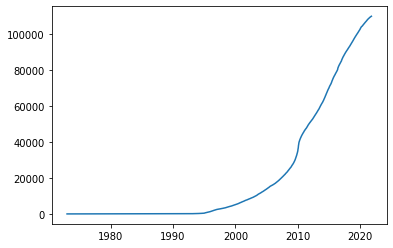

In [79]:
# Plot the number of total toyota failures by date... 

sub = df[df.MAKETXT=='TOYOTA'].sort_values('fail_date')
plt.plot(sub.fail_date, np.cumsum(sub['count'].values))

In [ ]:
df.FAILDATE.max()

In [15]:
list(datefinder.find_dates('20614.0'))

[]

In [18]:
datetime.datetime.now().year

2021

In [37]:
parse_garbage_datestr('22102')

nan